In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:41,241] A new study created in memory with name: no-name-21fa0c99-a319-4ccd-ad00-40393e67b7d1
[I 2025-05-21 00:03:29,879] Trial 0 finished with value: 0.07387404590845108 and parameters: {'lr': 0.015524332975535508, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1616532554304882}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.06769827753305435, 0.06608016788959503, 0.07001561671495438, 0.07967282086610794, 0.0859033465385437]
Mean Cross Validation Accuracy:
0.07387404590845108
Standard Deviation of Cross Validation Accuracy:
0.0076433237547454515


[I 2025-05-21 00:11:21,621] Trial 1 finished with value: 0.07908440828323364 and parameters: {'lr': 0.003325783779003345, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4538224002742036}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.06521386653184891, 0.08703489601612091, 0.08700674027204514, 0.10403597354888916, 0.0521305650472641]
Mean Cross Validation Accuracy:
0.07908440828323364
Standard Deviation of Cross Validation Accuracy:
0.018261740345345685


[I 2025-05-21 00:16:12,034] Trial 2 finished with value: 0.5613399565219879 and parameters: {'lr': 0.0013126794553306273, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4517965034799992}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.4873981773853302, 0.5718271732330322, 0.5493814945220947, 0.5852969884872437, 0.6127959489822388]
Mean Cross Validation Accuracy:
0.5613399565219879
Standard Deviation of Cross Validation Accuracy:
0.042289553722628104


[I 2025-05-21 00:20:25,352] Trial 3 finished with value: 0.053718775510787964 and parameters: {'lr': 0.029344103994693088, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.10596237524123678}. Best is trial 3 with value: 0.053718775510787964.


Cross Validation Accuracies:
[0.04536982625722885, 0.045690953731536865, 0.06268606334924698, 0.06392054259777069, 0.05092649161815643]
Mean Cross Validation Accuracy:
0.053718775510787964
Standard Deviation of Cross Validation Accuracy:
0.00808004985590797


[I 2025-05-21 00:25:00,923] Trial 4 finished with value: 0.05221516340970993 and parameters: {'lr': 0.6803308834070195, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.14175258524411977}. Best is trial 4 with value: 0.05221516340970993.


Cross Validation Accuracies:
[0.0446542389690876, 0.047669652849435806, 0.05587378889322281, 0.06205186992883682, 0.050826266407966614]
Mean Cross Validation Accuracy:
0.05221516340970993
Standard Deviation of Cross Validation Accuracy:
0.006162866461377507


[I 2025-05-21 00:33:05,187] Trial 5 finished with value: 0.05097220689058304 and parameters: {'lr': 0.010726536523698699, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19674752066258916}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.041854068636894226, 0.04566595330834389, 0.05632556974887848, 0.06266410648822784, 0.048351336270570755]
Mean Cross Validation Accuracy:
0.05097220689058304
Standard Deviation of Cross Validation Accuracy:
0.007530268855668256


[I 2025-05-21 00:38:58,112] Trial 6 finished with value: 0.05533843860030174 and parameters: {'lr': 0.4288648973580419, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30745475641998055}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.05343715846538544, 0.04791872575879097, 0.05531175434589386, 0.06478908658027649, 0.05523546785116196]
Mean Cross Validation Accuracy:
0.05533843860030174
Standard Deviation of Cross Validation Accuracy:
0.005440460772175822


[I 2025-05-21 00:44:23,176] Trial 7 finished with value: 0.1665387272834778 and parameters: {'lr': 0.003806746084890382, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4820756013096701}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.18102459609508514, 0.17135611176490784, 0.14513100683689117, 0.18904009461402893, 0.14614182710647583]
Mean Cross Validation Accuracy:
0.1665387272834778
Standard Deviation of Cross Validation Accuracy:
0.01796487212180037


[I 2025-05-21 00:48:42,541] Trial 8 finished with value: 0.05360446348786354 and parameters: {'lr': 0.566274085312406, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.44983095173739496}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.044544391334056854, 0.05156449228525162, 0.0545550137758255, 0.06373224407434464, 0.053626175969839096]
Mean Cross Validation Accuracy:
0.05360446348786354
Standard Deviation of Cross Validation Accuracy:
0.006159908227066223


[I 2025-05-21 00:53:38,348] Trial 9 finished with value: 0.05203729271888733 and parameters: {'lr': 0.008862349098603494, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32378264436947835}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.044947754591703415, 0.04638190567493439, 0.05644574016332626, 0.06382768601179123, 0.04858337715268135]
Mean Cross Validation Accuracy:
0.05203729271888733
Standard Deviation of Cross Validation Accuracy:
0.0071080555580822335


[I 2025-05-21 00:59:03,493] Trial 10 finished with value: 0.1865100681781769 and parameters: {'lr': 0.10742478359617455, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2193179670401441}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.20622287690639496, 0.16123712062835693, 0.19221912324428558, 0.18002577126026154, 0.1928454488515854]
Mean Cross Validation Accuracy:
0.1865100681781769
Standard Deviation of Cross Validation Accuracy:
0.015113524872482968


[I 2025-05-21 01:04:36,240] Trial 11 finished with value: 0.05107788145542145 and parameters: {'lr': 0.009809579758169413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3138307382279395}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.043878473341464996, 0.04375145956873894, 0.05617889016866684, 0.06259516626596451, 0.04898541793227196]
Mean Cross Validation Accuracy:
0.05107788145542145
Standard Deviation of Cross Validation Accuracy:
0.007328771762695916


[I 2025-05-21 01:10:18,913] Trial 12 finished with value: 0.12709570527076722 and parameters: {'lr': 0.0776091947847699, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24785008802921454}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.1449107974767685, 0.10324318706989288, 0.12303885817527771, 0.12626107037067413, 0.13802461326122284]
Mean Cross Validation Accuracy:
0.12709570527076722
Standard Deviation of Cross Validation Accuracy:
0.01430325689112692


[I 2025-05-21 01:13:47,510] Trial 13 finished with value: 0.05221505537629127 and parameters: {'lr': 0.007101902381075397, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3413669329079371}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.04403107985854149, 0.04332626238465309, 0.0558757521212101, 0.06323636323213577, 0.054605819284915924]
Mean Cross Validation Accuracy:
0.05221505537629127
Standard Deviation of Cross Validation Accuracy:
0.007570650905987741


[I 2025-05-21 01:17:40,305] Trial 14 finished with value: 0.07921741455793381 and parameters: {'lr': 0.04173608594218993, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.37913571686415665}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.06558915227651596, 0.06695466488599777, 0.1004486009478569, 0.07817734777927399, 0.08491730690002441]
Mean Cross Validation Accuracy:
0.07921741455793381
Standard Deviation of Cross Validation Accuracy:
0.012809670951799147


[I 2025-05-21 01:21:15,512] Trial 15 finished with value: 0.06271235495805741 and parameters: {'lr': 0.0013898927460065371, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.24225968039637602}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.04785239323973656, 0.06012542545795441, 0.058833979070186615, 0.09472832083702087, 0.052021656185388565]
Mean Cross Validation Accuracy:
0.06271235495805741
Standard Deviation of Cross Validation Accuracy:
0.016624473389836913


[I 2025-05-21 01:26:03,330] Trial 16 finished with value: 0.050674207508563995 and parameters: {'lr': 0.019888902295408864, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19824197325259713}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.041707754135131836, 0.04333742707967758, 0.05747353658080101, 0.06355324387550354, 0.04729907587170601]
Mean Cross Validation Accuracy:
0.050674207508563995
Standard Deviation of Cross Validation Accuracy:
0.008458340266261013


[I 2025-05-21 01:32:38,117] Trial 17 finished with value: 0.10893734097480774 and parameters: {'lr': 0.023198789662977042, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19162922040371844}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.10991870611906052, 0.12571465969085693, 0.08642857521772385, 0.10438673943281174, 0.11823802441358566]
Mean Cross Validation Accuracy:
0.10893734097480774
Standard Deviation of Cross Validation Accuracy:
0.013388776819231065


[I 2025-05-21 01:37:33,553] Trial 18 finished with value: 0.05255071073770523 and parameters: {'lr': 0.18577902978439112, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.26701619567690266}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.043213456869125366, 0.04445834085345268, 0.05977211892604828, 0.06402755528688431, 0.05128208175301552]
Mean Cross Validation Accuracy:
0.05255071073770523
Standard Deviation of Cross Validation Accuracy:
0.0082237081256493


[I 2025-05-21 01:42:31,422] Trial 19 finished with value: 0.050671391934156415 and parameters: {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043001655489206314, 0.04448606073856354, 0.054981574416160583, 0.06251869350671768, 0.04836897552013397]
Mean Cross Validation Accuracy:
0.050671391934156415
Standard Deviation of Cross Validation Accuracy:
0.007229391787102405


[I 2025-05-21 01:48:10,484] Trial 20 finished with value: 0.05307486802339554 and parameters: {'lr': 0.0032310456277363175, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1231629610420311}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04586413875222206, 0.04785628616809845, 0.058151040226221085, 0.0637156143784523, 0.049787260591983795]
Mean Cross Validation Accuracy:
0.05307486802339554
Standard Deviation of Cross Validation Accuracy:
0.006768006841767526


[I 2025-05-21 01:52:00,716] Trial 21 finished with value: 0.05192755535244942 and parameters: {'lr': 0.005058627914826297, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.18501516959302794}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043922729790210724, 0.04604225978255272, 0.05628199875354767, 0.06454144418239594, 0.04884934425354004]
Mean Cross Validation Accuracy:
0.05192755535244942
Standard Deviation of Cross Validation Accuracy:
0.007566514237665614


[I 2025-05-21 01:56:06,390] Trial 22 finished with value: 0.10838790982961655 and parameters: {'lr': 0.017978863057151722, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.20197619769987543}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.06963451206684113, 0.1137394830584526, 0.10091357678174973, 0.142534077167511, 0.11511790007352829]
Mean Cross Validation Accuracy:
0.10838790982961655
Standard Deviation of Cross Validation Accuracy:
0.023654108908367492


[I 2025-05-21 02:00:26,190] Trial 23 finished with value: 0.29966929852962493 and parameters: {'lr': 0.049486224296511734, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.16522917153322395}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.3320649564266205, 0.2045888751745224, 0.353663831949234, 0.30979931354522705, 0.29822951555252075]
Mean Cross Validation Accuracy:
0.29966929852962493
Standard Deviation of Cross Validation Accuracy:
0.05120520554475582


[I 2025-05-21 02:05:31,509] Trial 24 finished with value: 0.05129842609167099 and parameters: {'lr': 0.0022650470510449765, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27630102388783306}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04447760805487633, 0.04471172019839287, 0.05583149567246437, 0.06202320754528046, 0.04944809898734093]
Mean Cross Validation Accuracy:
0.05129842609167099
Standard Deviation of Cross Validation Accuracy:
0.0067661158822566216


[I 2025-05-21 02:12:03,319] Trial 25 finished with value: 0.8921590447425842 and parameters: {'lr': 0.013177522709896658, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.22253671709288997}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.8624765872955322, 0.8383123874664307, 0.7916740775108337, 0.8869822025299072, 1.0813499689102173]
Mean Cross Validation Accuracy:
0.8921590447425842
Standard Deviation of Cross Validation Accuracy:
0.09969728672554294


[I 2025-05-21 02:18:35,558] Trial 26 finished with value: 0.05263207778334618 and parameters: {'lr': 0.006174305087016394, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15620292058346807}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043911080807447433, 0.04556821286678314, 0.05856680870056152, 0.06372914463281631, 0.05138514190912247]
Mean Cross Validation Accuracy:
0.05263207778334618
Standard Deviation of Cross Validation Accuracy:
0.00756141188679564


[I 2025-05-21 02:24:40,707] Trial 27 finished with value: 0.05299435555934906 and parameters: {'lr': 0.0020650931830235556, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.37608538136614555}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04452531784772873, 0.04752706363797188, 0.06011021137237549, 0.06234264746308327, 0.05046653747558594]
Mean Cross Validation Accuracy:
0.05299435555934906
Standard Deviation of Cross Validation Accuracy:
0.007014723236852725


[I 2025-05-21 02:30:22,799] Trial 28 finished with value: 0.053193415701389316 and parameters: {'lr': 0.011893729235290355, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.28144627362183017}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04546767473220825, 0.04463589936494827, 0.05819536745548248, 0.06321270018815994, 0.054455436766147614]
Mean Cross Validation Accuracy:
0.053193415701389316
Standard Deviation of Cross Validation Accuracy:
0.007209943682392395


[I 2025-05-21 02:35:26,890] Trial 29 finished with value: 0.9853140592575074 and parameters: {'lr': 0.014974768704046331, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1342465578964518}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.9309341311454773, 1.0351715087890625, 1.0232640504837036, 1.0134927034378052, 0.923707902431488]
Mean Cross Validation Accuracy:
0.9853140592575074
Standard Deviation of Cross Validation Accuracy:
0.047900935765476264


[I 2025-05-21 02:41:39,171] Trial 30 finished with value: 0.0979040578007698 and parameters: {'lr': 0.05663401817198308, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1743239120140128}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.09757046401500702, 0.10640155524015427, 0.08927646279335022, 0.11371548473834991, 0.08255632221698761]
Mean Cross Validation Accuracy:
0.0979040578007698
Standard Deviation of Cross Validation Accuracy:
0.01124551779608591


[I 2025-05-21 02:45:07,930] Trial 31 finished with value: 0.05226919129490852 and parameters: {'lr': 0.009501088160489977, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3490904485386371}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043285202234983444, 0.04639621824026108, 0.05663338676095009, 0.06384310871362686, 0.051188040524721146]
Mean Cross Validation Accuracy:
0.05226919129490852
Standard Deviation of Cross Validation Accuracy:
0.007339952661951911


[I 2025-05-21 02:48:29,539] Trial 32 finished with value: 0.052954038977622984 and parameters: {'lr': 0.024080493341959466, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23315852545722124}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0484103225171566, 0.04566075652837753, 0.05877893790602684, 0.06246387958526611, 0.04945629835128784]
Mean Cross Validation Accuracy:
0.052954038977622984
Standard Deviation of Cross Validation Accuracy:
0.006487496181973426


[I 2025-05-21 02:52:04,597] Trial 33 finished with value: 0.06207257881760597 and parameters: {'lr': 0.004666822428957471, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2113798942500311}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.05683763325214386, 0.0592268668115139, 0.05982150137424469, 0.0661821961402893, 0.0682946965098381]
Mean Cross Validation Accuracy:
0.06207257881760597
Standard Deviation of Cross Validation Accuracy:
0.004385744740995878


[I 2025-05-21 02:56:20,647] Trial 34 finished with value: 0.05179336965084076 and parameters: {'lr': 0.0024410806320678755, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2583631918211632}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04565289244055748, 0.045477744191884995, 0.05502438172698021, 0.062494102865457535, 0.05031772702932358]
Mean Cross Validation Accuracy:
0.05179336965084076
Standard Deviation of Cross Validation Accuracy:
0.0063986754382578


[I 2025-05-21 03:01:10,106] Trial 35 finished with value: 0.051098570227622986 and parameters: {'lr': 0.034518863309777374, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2887494306906915}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043297380208969116, 0.04515424370765686, 0.05579446256160736, 0.06262483447790146, 0.04862193018198013]
Mean Cross Validation Accuracy:
0.051098570227622986
Standard Deviation of Cross Validation Accuracy:
0.007172635523688903


[I 2025-05-21 03:06:55,485] Trial 36 finished with value: 0.05274360477924347 and parameters: {'lr': 0.019346046358263362, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4084463150881136}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044273022562265396, 0.047240570187568665, 0.05760999023914337, 0.06548389792442322, 0.049110542982816696]
Mean Cross Validation Accuracy:
0.05274360477924347
Standard Deviation of Cross Validation Accuracy:
0.007761830553392024


[I 2025-05-21 03:10:30,025] Trial 37 finished with value: 0.05109274387359619 and parameters: {'lr': 0.008548008765055922, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10962887327848561}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042564816772937775, 0.045111119747161865, 0.05645136535167694, 0.062289778143167496, 0.04904663935303688]
Mean Cross Validation Accuracy:
0.05109274387359619
Standard Deviation of Cross Validation Accuracy:
0.007304523421996006


[I 2025-05-21 03:15:21,613] Trial 38 finished with value: 0.06986216530203819 and parameters: {'lr': 0.0032886074800059627, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3205100940737995}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.06784044206142426, 0.055281683802604675, 0.0931474044919014, 0.07110154628753662, 0.061939749866724014]
Mean Cross Validation Accuracy:
0.06986216530203819
Standard Deviation of Cross Validation Accuracy:
0.01283106309939299


[I 2025-05-21 03:21:33,675] Trial 39 finished with value: 0.051115934550762174 and parameters: {'lr': 0.01138068854398832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15536627353140384}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04212162643671036, 0.04547997564077377, 0.056647028774023056, 0.06269394606351852, 0.04863709583878517]
Mean Cross Validation Accuracy:
0.051115934550762174
Standard Deviation of Cross Validation Accuracy:
0.007529270967918213


[I 2025-05-21 03:26:26,557] Trial 40 finished with value: 0.05242310613393784 and parameters: {'lr': 0.005134929323902792, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.31100904927194567}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04231565073132515, 0.04865733161568642, 0.060177747160196304, 0.06298550963401794, 0.047979291528463364]
Mean Cross Validation Accuracy:
0.05242310613393784
Standard Deviation of Cross Validation Accuracy:
0.007845865482285302


[I 2025-05-21 03:30:24,966] Trial 41 finished with value: 0.05114869102835655 and parameters: {'lr': 0.007793471458092996, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10027922946710649}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0426861010491848, 0.045239873230457306, 0.05641091242432594, 0.06273174285888672, 0.048674825578927994]
Mean Cross Validation Accuracy:
0.05114869102835655
Standard Deviation of Cross Validation Accuracy:
0.007409556409329397


[I 2025-05-21 03:34:13,998] Trial 42 finished with value: 0.05145261138677597 and parameters: {'lr': 0.028943382553566585, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11608376614142316}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043721746653318405, 0.045783981680870056, 0.056793924421072006, 0.06261290609836578, 0.0483504980802536]
Mean Cross Validation Accuracy:
0.05145261138677597
Standard Deviation of Cross Validation Accuracy:
0.00713588876337181


[I 2025-05-21 03:37:17,517] Trial 43 finished with value: 0.6398820877075195 and parameters: {'lr': 0.0011667967669798968, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.141784278465414}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.6389440894126892, 0.609154224395752, 0.6656836271286011, 0.6462313532829285, 0.639397144317627]
Mean Cross Validation Accuracy:
0.6398820877075195
Standard Deviation of Cross Validation Accuracy:
0.018173327732938043


[I 2025-05-21 03:41:11,658] Trial 44 finished with value: 0.051081998646259306 and parameters: {'lr': 0.007955810679971783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19443344510352775}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042516350746154785, 0.045391906052827835, 0.05651072412729263, 0.062454141676425934, 0.04853687062859535]
Mean Cross Validation Accuracy:
0.051081998646259306
Standard Deviation of Cross Validation Accuracy:
0.007362361737155743


[I 2025-05-21 03:45:56,533] Trial 45 finished with value: 0.05127199217677116 and parameters: {'lr': 0.01642403963170496, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1879158044078066}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043027013540267944, 0.045263901352882385, 0.05636725574731827, 0.06305944919586182, 0.048642341047525406]
Mean Cross Validation Accuracy:
0.05127199217677116
Standard Deviation of Cross Validation Accuracy:
0.00742829384120322


[I 2025-05-21 03:50:50,416] Trial 46 finished with value: 0.05111916735768318 and parameters: {'lr': 0.0062389199443043915, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2263376445086637}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04256874695420265, 0.04544118791818619, 0.05643117055296898, 0.0626596212387085, 0.048495110124349594]
Mean Cross Validation Accuracy:
0.05111916735768318
Standard Deviation of Cross Validation Accuracy:
0.007397760062102797


[I 2025-05-21 03:57:37,661] Trial 47 finished with value: 0.053034707903862 and parameters: {'lr': 0.003711572931888908, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2046020240713431}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04527507349848747, 0.04677236080169678, 0.057058654725551605, 0.06603438407182693, 0.05003306642174721]
Mean Cross Validation Accuracy:
0.053034707903862
Standard Deviation of Cross Validation Accuracy:
0.007663191207531793


[I 2025-05-21 04:01:49,427] Trial 48 finished with value: 0.05280239805579186 and parameters: {'lr': 0.009880918571755985, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2497289173455265}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04249958693981171, 0.050197962671518326, 0.058122482150793076, 0.06273504346609116, 0.05045691505074501]
Mean Cross Validation Accuracy:
0.05280239805579186
Standard Deviation of Cross Validation Accuracy:
0.007005612474495123


[I 2025-05-21 04:05:18,463] Trial 49 finished with value: 0.4888059735298157 and parameters: {'lr': 0.0017099447769669894, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.17353695256563045}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.49011480808258057, 0.48879051208496094, 0.4903451204299927, 0.47787049412727356, 0.49690893292427063]
Mean Cross Validation Accuracy:
0.4888059735298157
Standard Deviation of Cross Validation Accuracy:
0.006153453027930276


[I 2025-05-21 04:08:18,165] Trial 50 finished with value: 0.05218746587634086 and parameters: {'lr': 0.024804677213068737, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2956173357130293}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044346701353788376, 0.04495859891176224, 0.05667627975344658, 0.06303610652685165, 0.051919642835855484]
Mean Cross Validation Accuracy:
0.05218746587634086
Standard Deviation of Cross Validation Accuracy:
0.0070943398432542085


[I 2025-05-21 04:12:01,271] Trial 51 finished with value: 0.05123885795474052 and parameters: {'lr': 0.007830299257543692, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.143769695786021}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04276903346180916, 0.04553778097033501, 0.0565369687974453, 0.0626954585313797, 0.04865504801273346]
Mean Cross Validation Accuracy:
0.05123885795474052
Standard Deviation of Cross Validation Accuracy:
0.00735173387458806


[I 2025-05-21 04:16:00,363] Trial 52 finished with value: 0.05122939646244049 and parameters: {'lr': 0.013478854553690295, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.33721579427156906}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04277685657143593, 0.04531242325901985, 0.05659262835979462, 0.06264877319335938, 0.04881630092859268]
Mean Cross Validation Accuracy:
0.05122939646244049
Standard Deviation of Cross Validation Accuracy:
0.007368113108007313


[I 2025-05-21 04:21:01,387] Trial 53 finished with value: 0.0521443635225296 and parameters: {'lr': 0.004610024765419823, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11858140549185478}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04286988824605942, 0.045715633779764175, 0.05612802878022194, 0.06655174493789673, 0.04945652186870575]
Mean Cross Validation Accuracy:
0.0521443635225296
Standard Deviation of Cross Validation Accuracy:
0.008461810428609414


[I 2025-05-21 04:25:46,410] Trial 54 finished with value: 0.051056123524904254 and parameters: {'lr': 0.009365455663626954, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19139390712290272}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04226866364479065, 0.04520560801029205, 0.05669233947992325, 0.0625327080488205, 0.04858129844069481]
Mean Cross Validation Accuracy:
0.051056123524904254
Standard Deviation of Cross Validation Accuracy:
0.007497355063686941


[I 2025-05-21 04:29:55,593] Trial 55 finished with value: 0.057318984717130664 and parameters: {'lr': 0.2661554839888501, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.20007094893136557}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04681336507201195, 0.05685824155807495, 0.06327438354492188, 0.06766953319311142, 0.05197940021753311]
Mean Cross Validation Accuracy:
0.057318984717130664
Standard Deviation of Cross Validation Accuracy:
0.00750589261802416


[I 2025-05-21 04:33:59,770] Trial 56 finished with value: 0.052896414697170255 and parameters: {'lr': 0.019492465790707507, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2416576559870302}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042691200971603394, 0.04767657816410065, 0.058652784675359726, 0.06444296985864639, 0.05101853981614113]
Mean Cross Validation Accuracy:
0.052896414697170255
Standard Deviation of Cross Validation Accuracy:
0.007763739126324105


[I 2025-05-21 04:38:07,786] Trial 57 finished with value: 1.7390945911407472 and parameters: {'lr': 0.8962379891696303, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1744479095313076}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[1.8614718914031982, 0.9307683706283569, 2.446193218231201, 1.6561694145202637, 1.8008700609207153]
Mean Cross Validation Accuracy:
1.7390945911407472
Standard Deviation of Cross Validation Accuracy:
0.48560245971466215


[I 2025-05-21 04:45:02,253] Trial 58 finished with value: 0.39339337944984437 and parameters: {'lr': 0.006053150089756487, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2676351990645747}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.2539961636066437, 0.4044705629348755, 0.41551682353019714, 0.5580567121505737, 0.33492663502693176]
Mean Cross Validation Accuracy:
0.39339337944984437
Standard Deviation of Cross Validation Accuracy:
0.10057445788697914


[I 2025-05-21 04:49:46,100] Trial 59 finished with value: 0.05067396312952042 and parameters: {'lr': 0.010808013534690636, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21074593516662452}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04294862598180771, 0.044675812125205994, 0.05518430471420288, 0.060580525547266006, 0.04998054727911949]
Mean Cross Validation Accuracy:
0.05067396312952042
Standard Deviation of Cross Validation Accuracy:
0.00655168123774624


[I 2025-05-21 04:54:27,755] Trial 60 finished with value: 0.05222513750195503 and parameters: {'lr': 0.0028470073951580117, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21733680221615498}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0426219142973423, 0.04628616198897362, 0.057364895939826965, 0.06531836837530136, 0.04953434690833092]
Mean Cross Validation Accuracy:
0.05222513750195503
Standard Deviation of Cross Validation Accuracy:
0.008155776990361697


[I 2025-05-21 04:58:48,767] Trial 61 finished with value: 0.05231343656778335 and parameters: {'lr': 0.010173238112616247, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19503335500848237}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04509994760155678, 0.04439626634120941, 0.05807929113507271, 0.06479907035827637, 0.049192607402801514]
Mean Cross Validation Accuracy:
0.05231343656778335
Standard Deviation of Cross Validation Accuracy:
0.007919491299077928


[I 2025-05-21 05:03:01,902] Trial 62 finished with value: 0.05221983268857002 and parameters: {'lr': 0.012461480165159917, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1823238823247958}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04333619028329849, 0.04521537199616432, 0.05540817603468895, 0.06405295431613922, 0.05308647081255913]
Mean Cross Validation Accuracy:
0.05221983268857002
Standard Deviation of Cross Validation Accuracy:
0.007468881232952272


[I 2025-05-21 05:07:15,096] Trial 63 finished with value: 0.06784534454345703 and parameters: {'lr': 0.037550731876902055, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.23119863171785943}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04315154254436493, 0.08359787613153458, 0.060837507247924805, 0.080072320997715, 0.07156747579574585]
Mean Cross Validation Accuracy:
0.06784534454345703
Standard Deviation of Cross Validation Accuracy:
0.01463139847339715


[I 2025-05-21 05:11:26,874] Trial 64 finished with value: 0.05210520401597023 and parameters: {'lr': 0.006848685204490321, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16244639108123685}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042589038610458374, 0.04524160921573639, 0.059672415256500244, 0.06410402059555054, 0.048918936401605606]
Mean Cross Validation Accuracy:
0.05210520401597023
Standard Deviation of Cross Validation Accuracy:
0.008355272876291014


[I 2025-05-21 05:16:12,692] Trial 65 finished with value: 0.05303057283163071 and parameters: {'lr': 0.01555914064011992, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2107435510997795}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04180166870355606, 0.04791552200913429, 0.05971194803714752, 0.06417792290449142, 0.051545802503824234]
Mean Cross Validation Accuracy:
0.05303057283163071
Standard Deviation of Cross Validation Accuracy:
0.008041899825841532


[I 2025-05-21 05:20:40,853] Trial 66 finished with value: 0.0518891915678978 and parameters: {'lr': 0.004205789129573437, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19161619882875774}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044007573276758194, 0.045726992189884186, 0.05893568694591522, 0.06261395663022995, 0.04816174879670143]
Mean Cross Validation Accuracy:
0.0518891915678978
Standard Deviation of Cross Validation Accuracy:
0.007465388408231725


[I 2025-05-21 05:24:57,145] Trial 67 finished with value: 0.051464059948921205 and parameters: {'lr': 0.022034657264011583, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3606339742342332}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04227763041853905, 0.0459294430911541, 0.05678734555840492, 0.0627346932888031, 0.04959118738770485]
Mean Cross Validation Accuracy:
0.051464059948921205
Standard Deviation of Cross Validation Accuracy:
0.0074012791931085545


[I 2025-05-21 05:29:33,591] Trial 68 finished with value: 0.05114353522658348 and parameters: {'lr': 0.005777016756702183, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24050872436164264}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0425758883357048, 0.0452645868062973, 0.05670608580112457, 0.06264428794384003, 0.0485268272459507]
Mean Cross Validation Accuracy:
0.05114353522658348
Standard Deviation of Cross Validation Accuracy:
0.0074568498763068446


[I 2025-05-21 05:34:09,390] Trial 69 finished with value: 0.08496112674474716 and parameters: {'lr': 0.009688557688376863, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1509936488919463}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.08812704682350159, 0.08114631474018097, 0.096891850233078, 0.07422825694084167, 0.08441216498613358]
Mean Cross Validation Accuracy:
0.08496112674474716
Standard Deviation of Cross Validation Accuracy:
0.007515502069326551


[I 2025-05-21 05:40:29,146] Trial 70 finished with value: 0.3057011216878891 and parameters: {'lr': 0.05259514181126559, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.21696835653558008}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.23957762122154236, 0.41799432039260864, 0.38497212529182434, 0.2223994880914688, 0.26356205344200134]
Mean Cross Validation Accuracy:
0.3057011216878891
Standard Deviation of Cross Validation Accuracy:
0.07997604020467573


[I 2025-05-21 05:44:31,179] Trial 71 finished with value: 0.051163019984960555 and parameters: {'lr': 0.008268070044453135, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16962675273105232}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042406000196933746, 0.04532299190759659, 0.056491706520318985, 0.06282997876405716, 0.0487644225358963]
Mean Cross Validation Accuracy:
0.051163019984960555
Standard Deviation of Cross Validation Accuracy:
0.007497431834704464


[I 2025-05-21 05:48:33,979] Trial 72 finished with value: 0.051120925694704056 and parameters: {'lr': 0.012312273552337664, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25482760613144123}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04228052496910095, 0.04553113877773285, 0.05657128989696503, 0.06282667070627213, 0.048395004123449326]
Mean Cross Validation Accuracy:
0.051120925694704056
Standard Deviation of Cross Validation Accuracy:
0.007530736848305839


[I 2025-05-21 05:52:25,626] Trial 73 finished with value: 0.05101354271173477 and parameters: {'lr': 0.007197457498589799, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.12824849038332733}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04230708256363869, 0.04529150575399399, 0.056457821279764175, 0.06246861442923546, 0.04854268953204155]
Mean Cross Validation Accuracy:
0.05101354271173477
Standard Deviation of Cross Validation Accuracy:
0.007423046650414171


[I 2025-05-21 05:56:11,241] Trial 74 finished with value: 0.051103779673576356 and parameters: {'lr': 0.007219397819545133, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1282521286722716}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042590901255607605, 0.04539846256375313, 0.05664300546050072, 0.062426842749118805, 0.04845968633890152]
Mean Cross Validation Accuracy:
0.051103779673576356
Standard Deviation of Cross Validation Accuracy:
0.007360784626335325


[I 2025-05-21 05:59:54,828] Trial 75 finished with value: 0.050766167044639585 and parameters: {'lr': 0.02874513973691634, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20060103860926917}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04249891638755798, 0.04439564421772957, 0.05581478029489517, 0.062354400753974915, 0.0487670935690403]
Mean Cross Validation Accuracy:
0.050766167044639585
Standard Deviation of Cross Validation Accuracy:
0.0073851600595907785


[I 2025-05-21 06:04:47,611] Trial 76 finished with value: 0.131893128156662 and parameters: {'lr': 0.07324571199921642, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.49885116154668285}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.12778018414974213, 0.1327480971813202, 0.10938027501106262, 0.15865661203861237, 0.13090047240257263]
Mean Cross Validation Accuracy:
0.131893128156662
Standard Deviation of Cross Validation Accuracy:
0.015759094340336


[I 2025-05-21 06:09:39,420] Trial 77 finished with value: 0.05183955430984497 and parameters: {'lr': 0.030663242588586756, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.180362881799506}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04319358244538307, 0.0463288277387619, 0.058204904198646545, 0.06265921145677567, 0.04881124570965767]
Mean Cross Validation Accuracy:
0.05183955430984497
Standard Deviation of Cross Validation Accuracy:
0.007373930427991177


[I 2025-05-21 06:14:40,027] Trial 78 finished with value: 0.05268464908003807 and parameters: {'lr': 0.01737336151993094, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4200640685910999}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04449401795864105, 0.04499217867851257, 0.05904250219464302, 0.06364922970533371, 0.05124531686306]
Mean Cross Validation Accuracy:
0.05268464908003807
Standard Deviation of Cross Validation Accuracy:
0.007602322550266789


[I 2025-05-21 06:18:50,632] Trial 79 finished with value: 0.05124735087156296 and parameters: {'lr': 0.02540111322850021, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.30748676637822064}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04190654680132866, 0.04625461995601654, 0.05704112350940704, 0.06256900727748871, 0.04846545681357384]
Mean Cross Validation Accuracy:
0.05124735087156296
Standard Deviation of Cross Validation Accuracy:
0.007505526262378997


[I 2025-05-21 06:23:15,984] Trial 80 finished with value: 0.05324907973408699 and parameters: {'lr': 0.01423288647663265, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.20618707271835476}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04828152433037758, 0.047643695026636124, 0.05807075649499893, 0.06282111257314682, 0.0494283102452755]
Mean Cross Validation Accuracy:
0.05324907973408699
Standard Deviation of Cross Validation Accuracy:
0.006092086725463411


[I 2025-05-21 06:26:48,455] Trial 81 finished with value: 0.05132632404565811 and parameters: {'lr': 0.010345391577811822, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16254346020953475}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042536064982414246, 0.04558948054909706, 0.05713936313986778, 0.06258855015039444, 0.04877816140651703]
Mean Cross Validation Accuracy:
0.05132632404565811
Standard Deviation of Cross Validation Accuracy:
0.007447178269432048


[I 2025-05-21 06:30:20,869] Trial 82 finished with value: 0.051301445066928866 and parameters: {'lr': 0.02056439068612767, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1973627577626896}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042905330657958984, 0.045099008828401566, 0.05729204788804054, 0.06258288025856018, 0.048627957701683044]
Mean Cross Validation Accuracy:
0.051301445066928866
Standard Deviation of Cross Validation Accuracy:
0.0074735612568162715


[I 2025-05-21 06:33:56,536] Trial 83 finished with value: 0.05106395781040192 and parameters: {'lr': 0.005675927849509636, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2255116667664154}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04245680943131447, 0.04517800360918045, 0.05656364932656288, 0.062454596161842346, 0.048666730523109436]
Mean Cross Validation Accuracy:
0.05106395781040192
Standard Deviation of Cross Validation Accuracy:
0.007409013531796016


[I 2025-05-21 06:37:33,313] Trial 84 finished with value: 0.0946330964565277 and parameters: {'lr': 0.0037725304508546176, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22304498042051965}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.07953399419784546, 0.12619638442993164, 0.12833930552005768, 0.06644273549318314, 0.07265306264162064]
Mean Cross Validation Accuracy:
0.0946330964565277
Standard Deviation of Cross Validation Accuracy:
0.02697462104976705


[I 2025-05-21 06:41:26,687] Trial 85 finished with value: 0.05383219867944718 and parameters: {'lr': 0.005102306491675698, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23330051663361534}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042356085032224655, 0.045310478657484055, 0.056666914373636246, 0.06245546042919159, 0.062372054904699326]
Mean Cross Validation Accuracy:
0.05383219867944718
Standard Deviation of Cross Validation Accuracy:
0.008481111922338472


[I 2025-05-21 06:46:51,280] Trial 86 finished with value: 0.059154698997735976 and parameters: {'lr': 0.0030104937544528218, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.26384219691250127}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.05678686127066612, 0.05050002411007881, 0.06086030974984169, 0.06709486246109009, 0.060531437397003174]
Mean Cross Validation Accuracy:
0.059154698997735976
Standard Deviation of Cross Validation Accuracy:
0.005447215167317661


[I 2025-05-21 06:52:31,849] Trial 87 finished with value: 0.05114425048232078 and parameters: {'lr': 0.0055570904814673736, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27809813576533243}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042555782943964005, 0.045380886644124985, 0.05663175508379936, 0.06251572072505951, 0.04863710701465607]
Mean Cross Validation Accuracy:
0.05114425048232078
Standard Deviation of Cross Validation Accuracy:
0.007384943439039


[I 2025-05-21 06:58:33,798] Trial 88 finished with value: 0.05233125612139702 and parameters: {'lr': 0.011117549705580152, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.18247554242503614}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04125552996993065, 0.04741800203919411, 0.05577804893255234, 0.06522248685359955, 0.05198221281170845]
Mean Cross Validation Accuracy:
0.05233125612139702
Standard Deviation of Cross Validation Accuracy:
0.00806223067351106


[I 2025-05-21 07:02:41,005] Trial 89 finished with value: 0.07089330330491066 and parameters: {'lr': 0.045064062807841206, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3263621746840987}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04480963200330734, 0.07552135735750198, 0.09504293650388718, 0.08808794617652893, 0.051004644483327866]
Mean Cross Validation Accuracy:
0.07089330330491066
Standard Deviation of Cross Validation Accuracy:
0.019880624083427143


[I 2025-05-21 07:06:41,773] Trial 90 finished with value: 0.2899917662143707 and parameters: {'lr': 0.004247238081627003, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2105127726913175}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.3043126165866852, 0.3336889147758484, 0.25111839175224304, 0.25151342153549194, 0.3093254864215851]
Mean Cross Validation Accuracy:
0.2899917662143707
Standard Deviation of Cross Validation Accuracy:
0.033106019199355026


[I 2025-05-21 07:10:47,187] Trial 91 finished with value: 0.05129086598753929 and parameters: {'lr': 0.006875531894283323, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1498843450575688}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04275815561413765, 0.04553941264748573, 0.05676780641078949, 0.06257884204387665, 0.04881011322140694]
Mean Cross Validation Accuracy:
0.05129086598753929
Standard Deviation of Cross Validation Accuracy:
0.007341059541702684


[I 2025-05-21 07:14:48,553] Trial 92 finished with value: 0.05106589198112488 and parameters: {'lr': 0.008762822577779314, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1901755269674051}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04237811639904976, 0.045348115265369415, 0.05642509087920189, 0.06262335926294327, 0.04855477809906006]
Mean Cross Validation Accuracy:
0.05106589198112488
Standard Deviation of Cross Validation Accuracy:
0.007440056059787279


[I 2025-05-21 07:18:38,028] Trial 93 finished with value: 0.05106682777404785 and parameters: {'lr': 0.008817034685930359, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.18683896153771518}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04267627000808716, 0.04498543590307236, 0.056341830641031265, 0.0625835731625557, 0.04874702915549278]
Mean Cross Validation Accuracy:
0.05106682777404785
Standard Deviation of Cross Validation Accuracy:
0.007392257191593647


[I 2025-05-21 07:22:43,428] Trial 94 finished with value: 0.05104079470038414 and parameters: {'lr': 0.01458943178300617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17707535847001313}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04258827865123749, 0.04497753083705902, 0.056287601590156555, 0.06249142065644264, 0.048859141767024994]
Mean Cross Validation Accuracy:
0.05104079470038414
Standard Deviation of Cross Validation Accuracy:
0.007370395146573141


[I 2025-05-21 07:26:45,848] Trial 95 finished with value: 0.05126149877905846 and parameters: {'lr': 0.014810035958760936, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13353686365218687}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043110426515340805, 0.04522302746772766, 0.05683703348040581, 0.0625641942024231, 0.04857281222939491]
Mean Cross Validation Accuracy:
0.05126149877905846
Standard Deviation of Cross Validation Accuracy:
0.007334434691613667


[I 2025-05-21 07:31:39,766] Trial 96 finished with value: 0.05121463835239411 and parameters: {'lr': 0.01726509837099257, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20140373442654796}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04237036034464836, 0.04615294560790062, 0.056359365582466125, 0.0624273382127285, 0.04876318201422691]
Mean Cross Validation Accuracy:
0.05121463835239411
Standard Deviation of Cross Validation Accuracy:
0.0072393988911467035


[I 2025-05-21 07:36:47,619] Trial 97 finished with value: 0.051184392720460894 and parameters: {'lr': 0.01240602506093688, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.17470629985841543}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04254767671227455, 0.045321423560380936, 0.056841667741537094, 0.06258177012205124, 0.04862942546606064]
Mean Cross Validation Accuracy:
0.051184392720460894
Standard Deviation of Cross Validation Accuracy:
0.007448491132404516


[I 2025-05-21 07:41:07,819] Trial 98 finished with value: 0.05175010338425636 and parameters: {'lr': 0.026978781100931392, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21547731245718568}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04259475693106651, 0.046335794031620026, 0.057243071496486664, 0.06310513615608215, 0.04947175830602646]
Mean Cross Validation Accuracy:
0.05175010338425636
Standard Deviation of Cross Validation Accuracy:
0.007448965547922642


[I 2025-05-21 07:46:42,347] Trial 99 finished with value: 0.47673025727272034 and parameters: {'lr': 0.002592284559183651, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1649184069958379}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.48520800471305847, 0.4774390161037445, 0.47744056582450867, 0.46600601077079773, 0.4775576889514923]
Mean Cross Validation Accuracy:
0.47673025727272034
Standard Deviation of Cross Validation Accuracy:
0.006141224392553863
Number of finished trials: 100
Best trial: {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}
Best hyperparameters:  {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}
Fold 1:
Epoch 1/100
84/84 [==============================] - 25s 166ms/step - loss: 0.1525 - val_loss: 0.2126
Epoch 2/100
84/84 [==============================] - 11s 128ms/step - loss: 0.0735 - val_loss: 0.2624
Epoch 3/100
84/84 [==============================] - 11s 133ms/step - loss: 0.0639 - val_loss: 0.2557
Epoch 4/100
84/84 [==============================] - 11s 130ms/step - loss: 0.0610 - val_lo

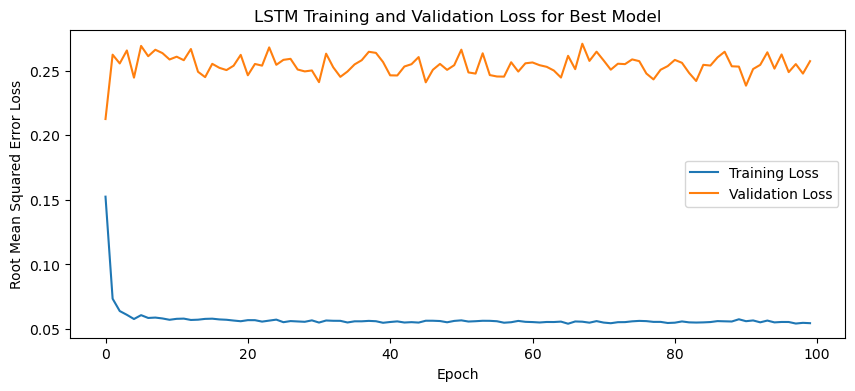

1/1 - 3s - loss: 0.0429 - 3s/epoch - 3s/step
Test Loss: 0.04292501509189606
1/1 [==============================] - 0s 63ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

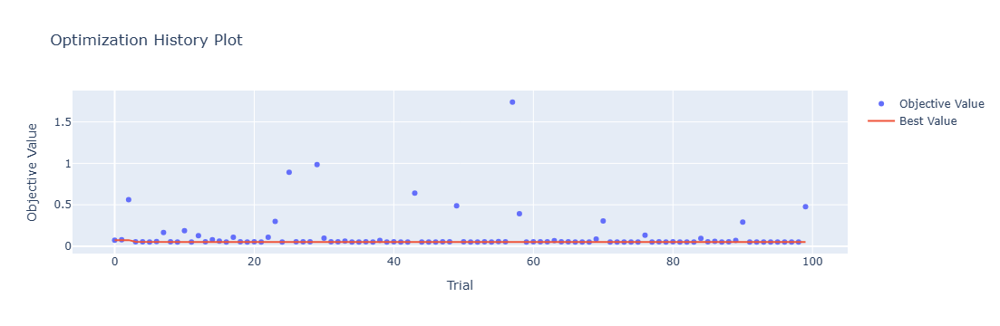

In [4]:
optuna.visualization.plot_optimization_history(study)

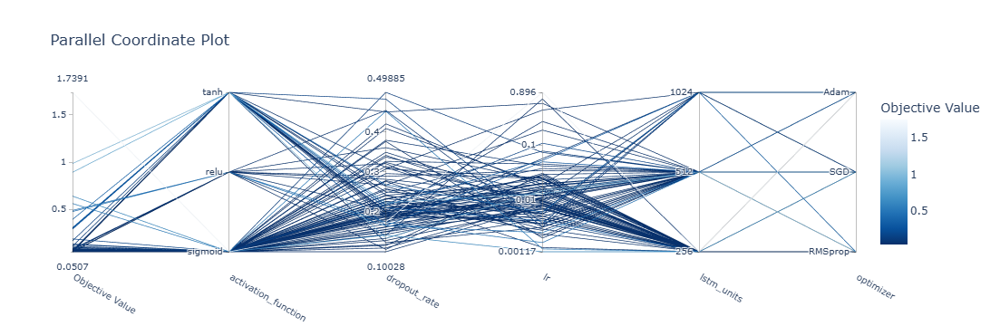

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

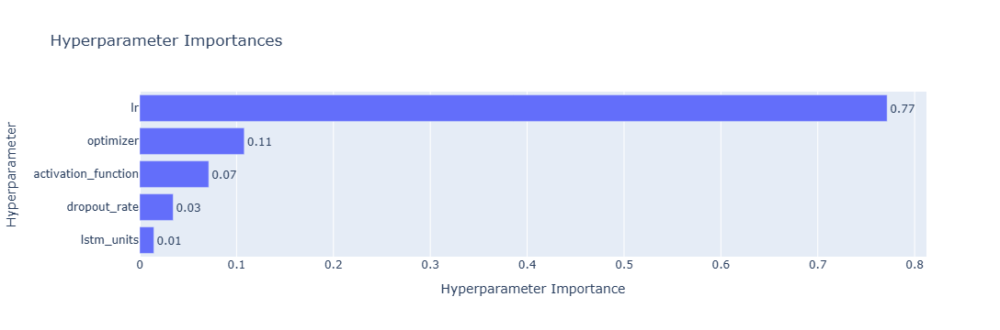

In [6]:
optuna.visualization.plot_param_importances(study)

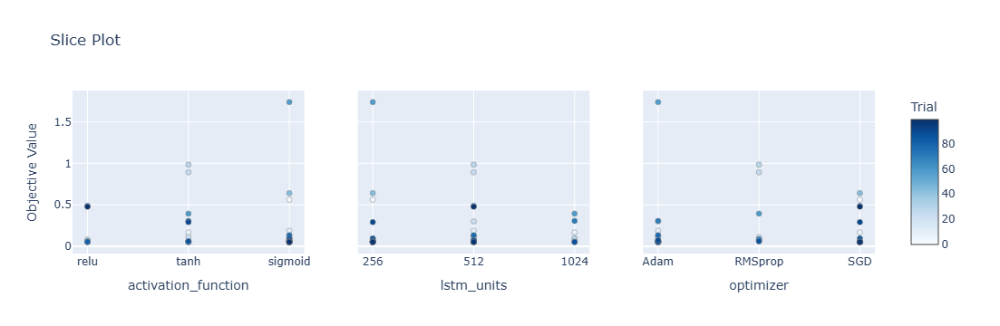

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

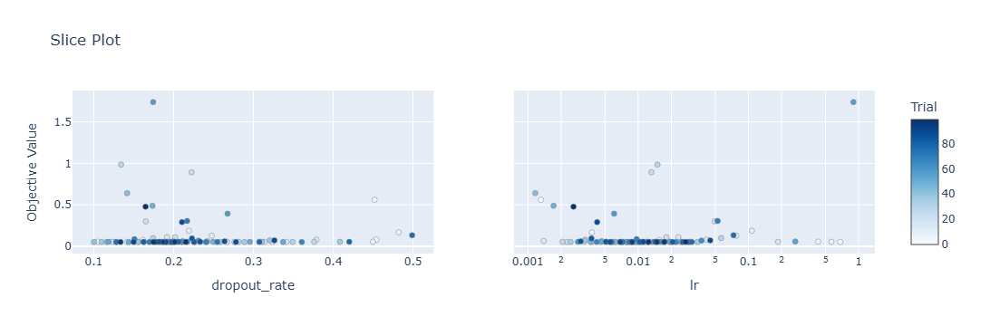

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 35s 153ms/step - loss: 0.1454 - accuracy: 0.2143 - mae: 0.1185 - rmse: 0.1454 - mape: inf - pearson: 0.5847 - val_loss: 0.0942 - val_accuracy: 0.4000 - val_mae: 0.0782 - val_rmse: 0.0942 - val_mape: 15.7679 - val_pearson: 0.8051
Epoch 2/100
84/84 [==============================] - 6s 77ms/step - loss: 0.0777 - accuracy: 0.4762 - mae: 0.0630 - rmse: 0.0777 - mape: inf - pearson: 0.7946 - val_loss: 0.0689 - val_accuracy: 0.4000 - val_mae: 0.0552 - val_rmse: 0.0689 - val_mape: 12.0463 - val_pearson: 0.8042
Epoch 3/100
84/84 [==============================] - 7s 86ms/step - loss: 0.0637 - accuracy: 0.4643 - mae: 0.0503 - rmse: 0.0637 - mape: inf - pearson: 0.8297 - val_loss: 0.0708 - val_accuracy: 0.4000 - val_mae: 0.0561 - val_rmse: 0.0708 - val_mape: 12.6746 - val_pearson: 0.7738
Epoch 4/100
84/84 [==============================] - 7s 79ms/step - loss: 0.0618 - accuracy: 0.4762 - mae: 0.0489 - rmse: 0.0618 - mape: inf - pearson: 0.8358

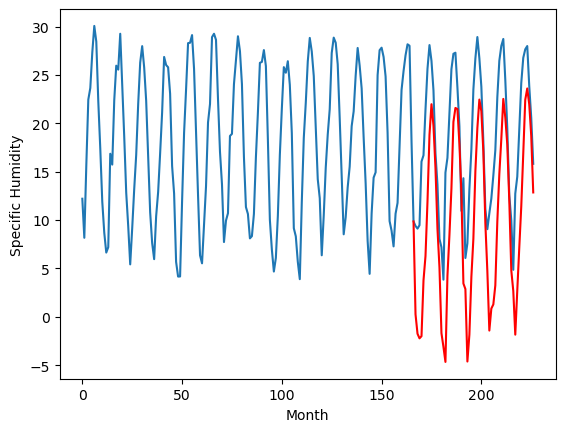

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.95		-0.73		0.22
-1.85		-2.73		-0.88
-2.23		-3.21		-0.98
-1.48		-2.99		-1.51
4.35		2.78		-1.57
4.84		5.30		0.46
7.61		10.93		3.32
11.36		17.83		6.47
11.84		21.00		9.16
12.47		18.79		6.32
9.49		14.41		4.92
6.86		8.13		1.27
3.44		4.13		0.69
-3.77		-2.67		1.10
-3.11		-4.09		-0.98
-3.20		-5.65		-2.45
1.86		3.25		1.39
3.26		7.48		4.22
7.28		12.29		5.01
10.76		19.18		8.42
11.98		20.61		8.63
12.32		20.51		8.19
10.19		16.90		6.71
7.56		11.85		4.29
2.05		2.46		0.41
1.81		1.89		0.08
-4.87		-5.61		-0.74
-2.10		-2.83		-0.73
1.76		3.16		1.40
4.73		7.09		2.36
9.04		14.08		5.04
12.73		18.54		5.81
12.87		21.48		8.61
12.32		20.27		7.95
11.30		16.10		4.80
5.70		8.71		3.01
3.01		3.76		0.75
-0.84		-2.40		-1.56
-0.05		-0.13		-0.08
1.05		0.30		-0.75
2.64		2.27		-0.37
4.79		8.88		4.09
7.97		13.76		5.79
11.05		17.40		6.35
12.88		21.55		8.67
14.47		19.63		5.16
11.09		16.82		5.73
5.98		11.01		5.03
0.74		3.82		3.08
-

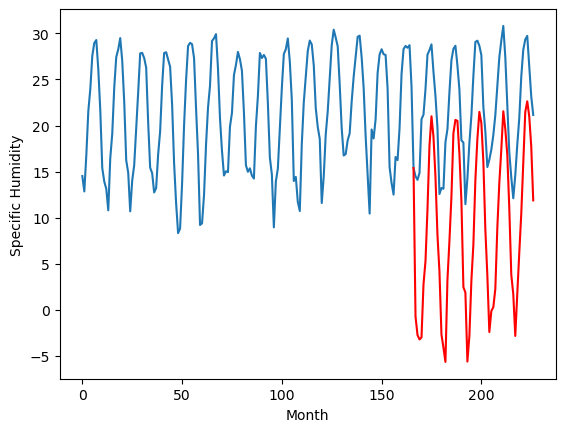

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-3.10		-2.11		0.99
-3.21		-4.11		-0.90
-3.83		-4.59		-0.76
-3.21		-4.37		-1.16
3.04		1.40		-1.64
2.80		3.92		1.12
6.49		9.55		3.06
10.21		16.45		6.24
12.58		19.62		7.04
11.82		17.41		5.59
8.43		13.03		4.60
4.71		6.75		2.04
-0.22		2.75		2.97
-7.22		-4.05		3.17
-6.40		-5.47		0.93
-5.54		-7.03		-1.49
0.44		1.87		1.43
2.08		6.10		4.02
6.06		10.91		4.85
10.20		17.80		7.60
11.96		19.23		7.27
12.24		19.13		6.89
8.67		15.52		6.85
4.79		10.47		5.68
-3.57		1.08		4.65
-1.39		0.51		1.90
-7.40		-6.99		0.41
-3.45		-4.21		-0.76
0.05		1.78		1.73
2.79		5.71		2.92
8.55		12.70		4.15
12.33		17.16		4.83
13.25		20.10		6.85
12.02		18.89		6.87
8.90		14.72		5.82
1.76		7.33		5.57
-0.72		2.38		3.10
-5.24		-3.78		1.46
-3.29		-1.51		1.78
-0.51		-1.08		-0.57
-0.53		0.89		1.42
2.54		7.50		4.96
5.95		12.38		6.43
9.27		16.02		6.75
12.37		20.17		7.80
11.98		18.25		6.27
8.53		15.44		6.91
2.55		9.63		7.08
-2.54		2.44		4.98
-5.5

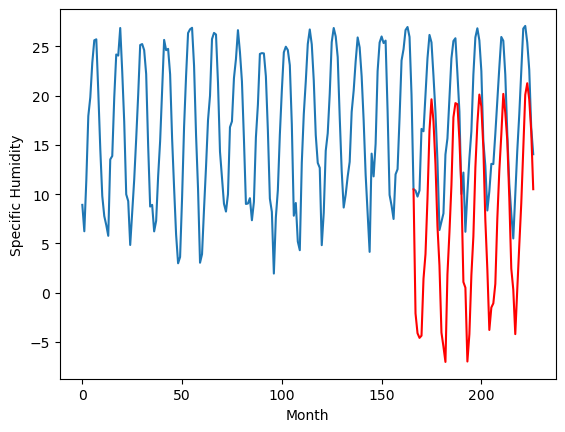

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.49		-3.31		-0.82
-2.51		-5.31		-2.80
-2.47		-5.79		-3.32
-2.47		-5.57		-3.10
4.45		0.20		-4.25
4.53		2.72		-1.81
7.42		8.35		0.93
10.33		15.25		4.92
11.30		18.42		7.12
11.64		16.21		4.57
9.31		11.83		2.52
5.25		5.55		0.30
2.41		1.55		-0.86
-5.05		-5.25		-0.20
-4.96		-6.67		-1.71
-6.53		-8.23		-1.70
1.38		0.67		-0.71
3.17		4.90		1.73
7.14		9.71		2.57
10.42		16.60		6.18
11.05		18.03		6.98
11.10		17.93		6.83
8.59		14.32		5.73
6.28		9.27		2.99
-1.81		-0.12		1.69
0.96		-0.69		-1.65
-6.39		-8.19		-1.80
-3.95		-5.41		-1.46
-0.16		0.58		0.74
4.63		4.51		-0.12
9.15		11.50		2.35
11.58		15.96		4.38
11.56		18.90		7.34
10.37		17.69		7.32
9.13		13.52		4.39
3.51		6.13		2.62
-0.60		1.18		1.78
-2.78		-4.98		-2.20
-1.34		-2.71		-1.37
-0.93		-2.28		-1.35
2.59		-0.31		-2.90
4.01		6.30		2.29
8.44		11.18		2.74
12.19		14.82		2.63
13.31		18.97		5.66
14.84		17.05		2.21
11.40		14.24		2.84
5.15		8.43		3.28
-0.71		1.

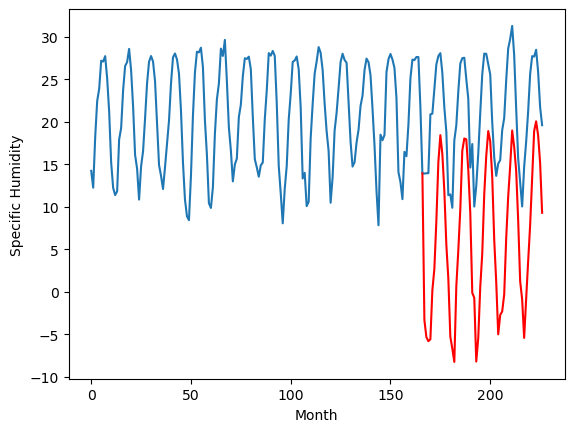

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.32		3.61		-1.71
3.27		1.61		-1.66
4.01		1.13		-2.88
3.34		1.35		-1.99
11.09		7.12		-3.97
11.34		9.64		-1.70
16.32		15.27		-1.05
20.52		22.17		1.65
22.13		25.34		3.21
22.62		23.13		0.51
16.91		18.75		1.84
12.03		12.47		0.44
9.51		8.47		-1.04
3.04		1.67		-1.37
2.16		0.25		-1.91
-0.93		-1.31		-0.38
8.97		7.59		-1.38
10.90		11.82		0.92
14.76		16.63		1.87
19.96		23.52		3.56
20.39		24.95		4.56
21.15		24.85		3.70
19.14		21.24		2.10
14.79		16.19		1.40
7.22		6.80		-0.42
9.55		6.23		-3.32
1.10		-1.27		-2.37
0.87		1.51		0.64
7.36		7.50		0.14
13.40		11.43		-1.97
18.11		18.42		0.31
22.45		22.88		0.43
24.81		25.82		1.01
22.45		24.61		2.16
19.50		20.44		0.94
13.58		13.05		-0.53
6.65		8.10		1.45
3.92		1.94		-1.98
4.89		4.21		-0.68
5.02		4.64		-0.38
9.74		6.61		-3.13
11.24		13.22		1.98
16.77		18.10		1.33
21.32		21.74		0.42
24.31		25.89		1.58
26.05		23.97		-2.08
21.57		21.16		-0.41
13.91		15.35		1.44
7.55		8

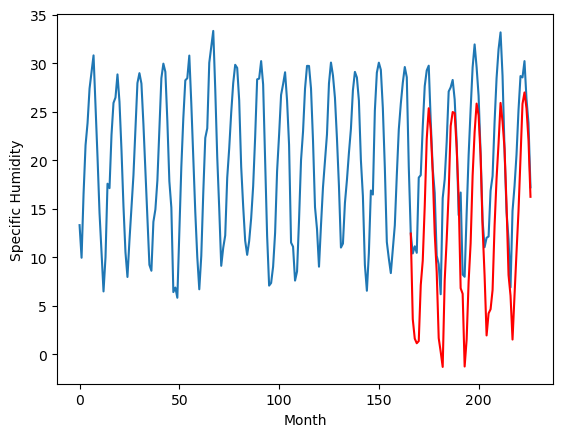

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.85		5.92		0.07
5.28		3.92		-1.36
4.75		3.44		-1.31
4.44		3.66		-0.78
8.03		9.43		1.40
10.00		11.95		1.95
13.69		17.58		3.89
18.04		24.48		6.44
21.78		27.65		5.87
20.93		25.44		4.51
17.90		21.06		3.16
13.81		14.78		0.97
9.69		10.78		1.09
2.94		3.98		1.04
1.16		2.56		1.40
1.81		1.00		-0.81
6.71		9.90		3.19
10.08		14.13		4.05
13.59		18.94		5.35
18.16		25.83		7.67
20.15		27.26		7.11
20.63		27.16		6.53
17.62		23.55		5.93
14.02		18.50		4.48
5.85		9.11		3.26
6.90		8.54		1.64
0.52		1.04		0.52
4.13		3.82		-0.31
8.05		9.81		1.76
10.92		13.74		2.82
15.55		20.73		5.18
19.12		25.19		6.07
21.26		28.13		6.87
20.41		26.92		6.51
17.76		22.75		4.99
11.20		15.36		4.16
9.51		10.41		0.90
2.99		4.25		1.26
4.68		6.52		1.84
6.17		6.95		0.78
7.08		8.92		1.84
11.76		15.53		3.77
13.28		20.41		7.13
17.10		24.05		6.95
20.93		28.20		7.27
20.45		26.28		5.83
16.93		23.47		6.54
12.58		17.66		5.08
7.14		10.47		3.33
5.00		8.

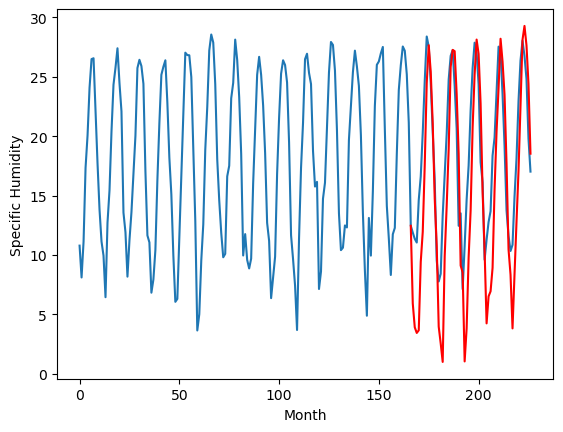

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.20		0.31		1.51
-1.56		-1.69		-0.13
-2.03		-2.17		-0.14
-0.92		-1.95		-1.03
4.50		3.82		-0.68
5.74		6.34		0.60
8.08		11.97		3.89
13.33		18.87		5.54
16.40		22.04		5.64
15.37		19.83		4.46
11.48		15.45		3.97
7.48		9.17		1.69
3.30		5.17		1.87
-3.63		-1.63		2.00
-4.21		-3.05		1.16
-3.57		-4.61		-1.04
3.41		4.29		0.88
4.44		8.52		4.08
8.15		13.33		5.18
12.48		20.22		7.74
14.10		21.65		7.55
14.04		21.55		7.51
9.99		17.94		7.95
6.76		12.89		6.13
-1.89		3.50		5.39
0.05		2.93		2.88
-6.60		-4.57		2.03
-2.62		-1.79		0.83
1.72		4.20		2.48
4.64		8.13		3.49
9.71		15.12		5.41
13.62		19.58		5.96
14.72		22.52		7.80
13.43		21.31		7.88
10.37		17.14		6.77
3.43		9.75		6.32
1.20		4.80		3.60
-5.31		-1.36		3.95
-2.12		0.91		3.03
0.88		1.34		0.46
1.36		3.31		1.95
4.92		9.92		5.00
7.61		14.80		7.19
10.96		18.44		7.48
14.67		22.59		7.92
13.98		20.67		6.69
10.47		17.86		7.39
5.26		12.05		6.79
-0.61		4.86		5.47
-2.90		2

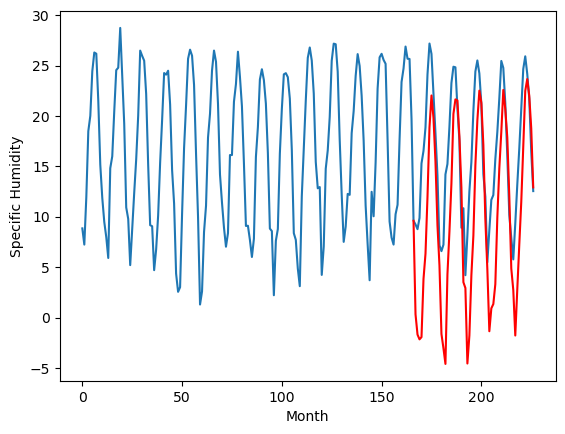

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.01		5.63		1.62
3.64		3.63		-0.01
3.52		3.15		-0.37
4.56		3.37		-1.19
10.14		9.14		-1.00
11.04		11.66		0.62
14.16		17.29		3.13
19.68		24.19		4.51
22.94		27.36		4.42
21.57		25.15		3.58
16.70		20.77		4.07
12.86		14.49		1.63
8.63		10.49		1.86
1.70		3.69		1.99
0.76		2.27		1.51
1.38		0.71		-0.67
7.90		9.61		1.71
11.53		13.84		2.31
14.55		18.65		4.10
19.34		25.54		6.20
21.46		26.97		5.51
21.41		26.87		5.46
16.90		23.26		6.36
13.05		18.21		5.16
3.55		8.82		5.27
5.61		8.25		2.64
-1.57		0.75		2.32
2.67		3.53		0.86
7.51		9.52		2.01
10.83		13.45		2.62
15.81		20.44		4.63
19.81		24.90		5.09
21.68		27.84		6.16
20.00		26.63		6.63
16.30		22.46		6.16
9.11		15.07		5.96
6.91		10.12		3.21
-0.26		3.96		4.22
2.91		6.23		3.32
5.88		6.66		0.78
6.56		8.63		2.07
11.18		15.24		4.06
13.47		20.12		6.65
17.22		23.76		6.54
21.36		27.91		6.55
20.22		25.99		5.77
16.46		23.18		6.72
11.07		17.37		6.30
4.62		10.18		5.56
3.03		

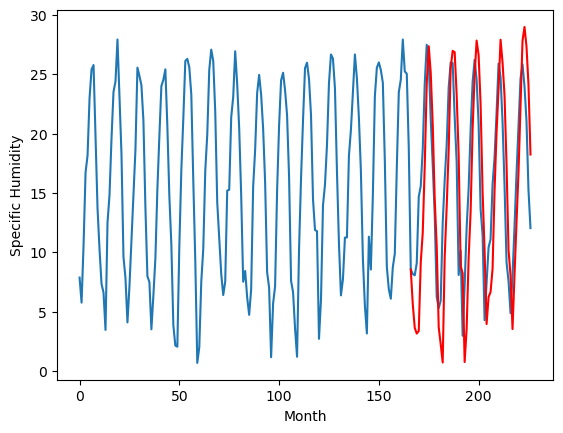

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.48		4.70		0.22
4.32		2.70		-1.62
3.13		2.22		-0.91
3.63		2.44		-1.19
10.20		8.21		-1.99
12.48		10.73		-1.75
17.36		16.36		-1.00
23.29		23.26		-0.03
26.03		26.43		0.40
23.02		24.22		1.20
19.46		19.84		0.38
12.20		13.56		1.36
9.34		9.56		0.22
2.63		2.76		0.13
1.84		1.34		-0.50
-2.43		-0.22		2.21
10.04		8.68		-1.36
12.64		12.91		0.27
17.33		17.72		0.39
23.52		24.61		1.09
24.09		26.04		1.95
24.03		25.94		1.91
20.29		22.33		2.04
16.33		17.28		0.95
6.29		7.89		1.60
8.09		7.32		-0.77
-0.42		-0.18		0.24
1.62		2.60		0.98
8.84		8.59		-0.25
12.79		12.52		-0.27
19.63		19.51		-0.12
24.15		23.97		-0.18
26.48		26.91		0.43
23.60		25.70		2.10
19.96		21.53		1.57
13.40		14.14		0.74
7.43		9.19		1.76
2.14		3.03		0.89
4.70		5.30		0.60
6.31		5.73		-0.58
8.13		7.70		-0.43
13.91		14.31		0.40
19.50		19.19		-0.31
23.37		22.83		-0.54
24.86		26.98		2.12
23.60		25.06		1.46
20.43		22.25		1.82
14.83		16.44		1.61
7.84		9.2

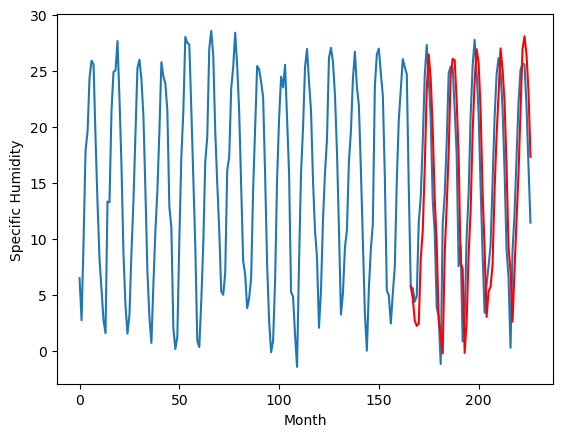

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.26		2.19		2.45
-0.08		0.19		0.27
-1.36		-0.29		1.07
-2.23		-0.07		2.16
4.96		5.70		0.74
6.62		8.22		1.60
11.71		13.85		2.14
18.69		20.75		2.06
21.32		23.92		2.60
18.94		21.71		2.77
15.27		17.33		2.06
8.88		11.05		2.17
5.20		7.05		1.85
-2.31		0.25		2.56
-3.90		-1.17		2.73
-6.07		-2.73		3.34
4.68		6.17		1.49
7.74		10.40		2.66
12.21		15.21		3.00
18.69		22.10		3.41
19.70		23.53		3.83
20.30		23.43		3.13
16.44		19.82		3.38
11.97		14.77		2.80
1.31		5.38		4.07
2.54		4.81		2.27
-6.43		-2.69		3.74
-2.85		0.09		2.94
4.13		6.08		1.95
6.86		10.01		3.15
15.03		17.00		1.97
18.93		21.46		2.53
20.96		24.40		3.44
19.05		23.19		4.14
15.32		19.02		3.70
8.28		11.63		3.35
3.26		6.68		3.42
-2.45		0.52		2.97
-0.56		2.79		3.35
1.48		3.22		1.74
1.82		5.19		3.37
8.10		11.80		3.70
13.06		16.68		3.62
16.90		20.32		3.42
19.73		24.47		4.74
18.93		22.55		3.62
16.32		19.74		3.42
9.74		13.93		4.19
3.24		6.74		3.50
0.81		4

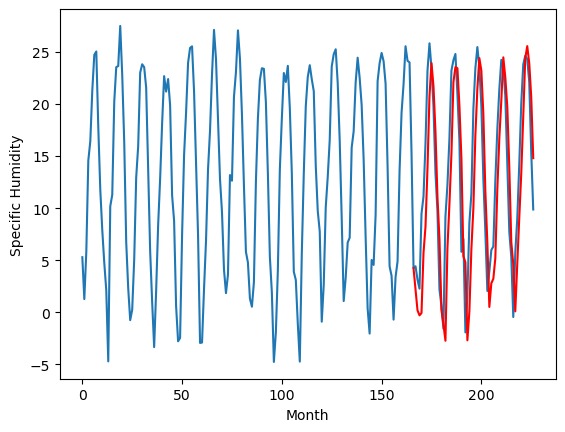

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.50		0.25		1.75
-2.17		-1.75		0.42
-3.20		-2.23		0.97
-4.66		-2.01		2.65
1.48		3.76		2.28
4.13		6.28		2.15
10.56		11.91		1.35
18.52		18.81		0.29
21.68		21.98		0.30
18.99		19.77		0.78
14.16		15.39		1.23
7.41		9.11		1.70
3.93		5.11		1.18
-3.10		-1.69		1.41
-4.71		-3.11		1.60
-9.02		-4.67		4.35
2.71		4.23		1.52
6.68		8.46		1.78
11.83		13.27		1.44
19.14		20.16		1.02
19.73		21.59		1.86
20.44		21.49		1.05
16.39		17.88		1.49
12.04		12.83		0.79
1.18		3.44		2.26
0.28		2.87		2.59
-8.67		-4.63		4.04
-5.43		-1.85		3.58
1.48		4.14		2.66
5.09		8.07		2.98
14.41		15.06		0.65
19.17		19.52		0.35
20.28		22.46		2.18
19.16		21.25		2.09
15.32		17.08		1.76
8.08		9.69		1.61
3.05		4.74		1.69
-3.13		-1.42		1.71
-2.00		0.85		2.85
-1.59		1.28		2.87
0.27		3.25		2.98
7.12		9.86		2.74
12.14		14.74		2.60
17.65		18.38		0.73
20.11		22.53		2.42
18.30		20.61		2.31
15.92		17.80		1.88
9.96		11.99		2.03
2.32		4.80		2.48
1.64		2

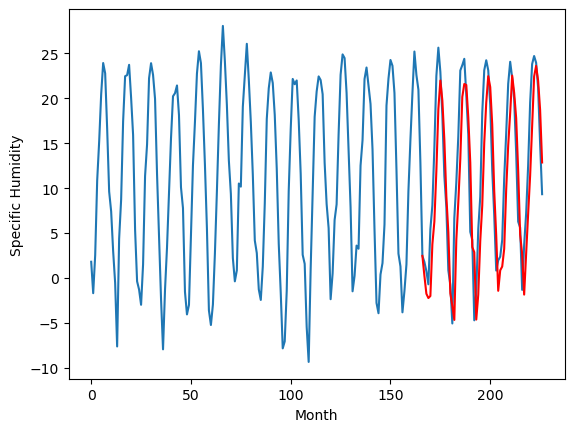

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[0.2546831130981442, -0.7253168869018554, -2.1053168869018553, -3.3053168869018554, 3.6146831130981454, 5.924683113098144, 0.3146831130981447, 5.634683113098145, 4.704683113098145, 2.1946831130981437, 0.2546831130981442]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   0.254683
1                 1   -0.95  -0.725317
2                 2   -3.10  -2.105317
3                 3   -2.49  -3.305317
4                 4    5.32   3.614683
5                 5    5.85   5.924683
6                 6   -1.20   0.314683
7                 7    4.01   5.634683
8                 8    4.48   4.704683
9                 9   -0.26   2.194683
10               10   -1.50   0.254683


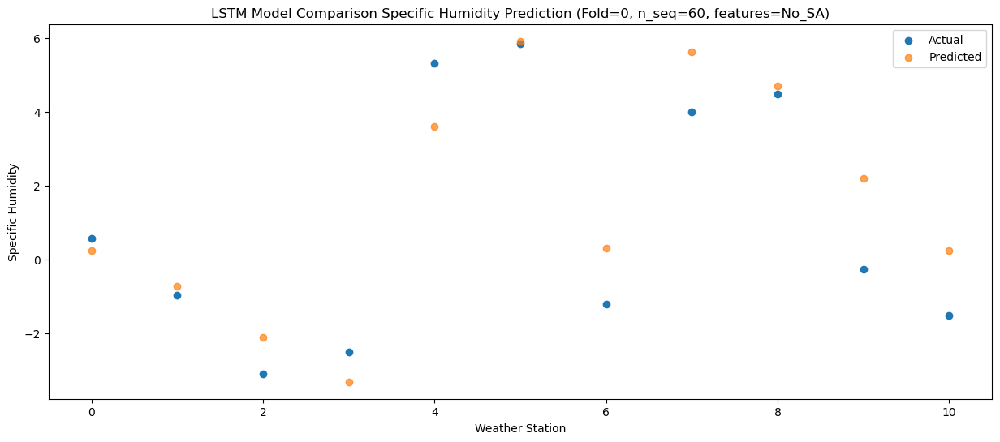

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11  -1.753856
1                 1   -1.85  -2.733856
2                 2   -3.21  -4.113856
3                 3   -2.51  -5.313856
4                 4    3.27   1.606144
5                 5    5.28   3.916144
6                 6   -1.56  -1.693856
7                 7    3.64   3.626144
8                 8    4.32   2.696144
9                 9   -0.08   0.186144
10               10   -2.17  -1.753856


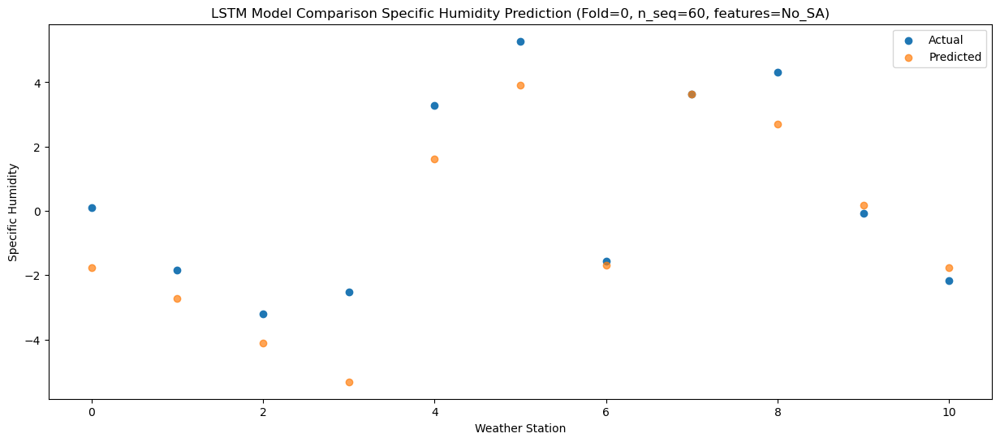

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -2.228012
1                 1   -2.23  -3.208012
2                 2   -3.83  -4.588012
3                 3   -2.47  -5.788012
4                 4    4.01   1.131988
5                 5    4.75   3.441988
6                 6   -2.03  -2.168012
7                 7    3.52   3.151988
8                 8    3.13   2.221988
9                 9   -1.36  -0.288012
10               10   -3.20  -2.228012


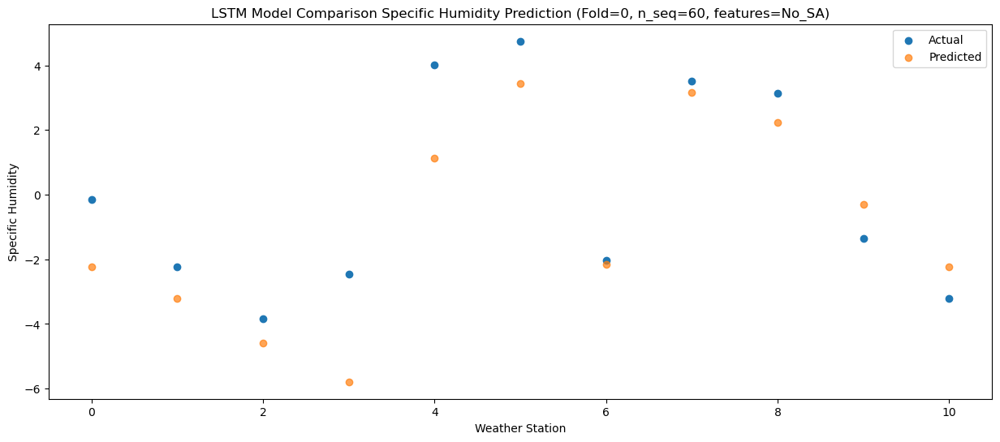

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -2.005767
1                 1   -1.48  -2.985767
2                 2   -3.21  -4.365767
3                 3   -2.47  -5.565767
4                 4    3.34   1.354233
5                 5    4.44   3.664233
6                 6   -0.92  -1.945767
7                 7    4.56   3.374233
8                 8    3.63   2.444233
9                 9   -2.23  -0.065767
10               10   -4.66  -2.005767


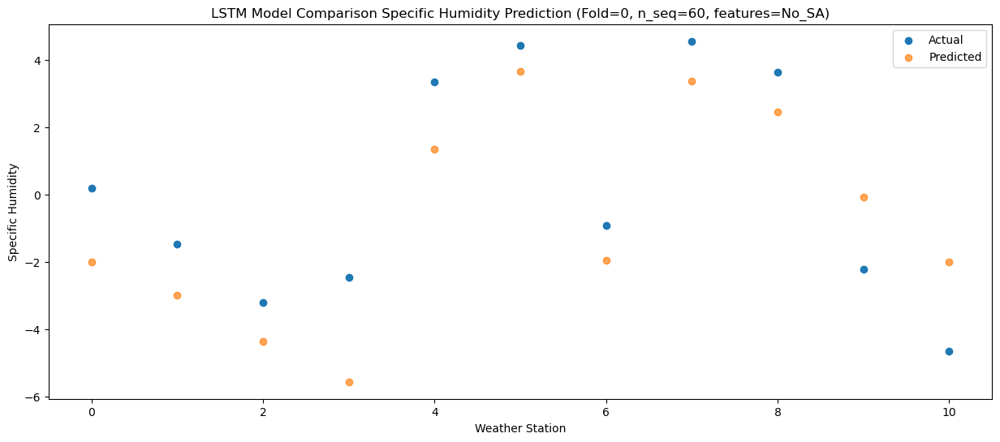

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   3.759630
1                 1    4.35   2.779630
2                 2    3.04   1.399630
3                 3    4.45   0.199630
4                 4   11.09   7.119632
5                 5    8.03   9.429630
6                 6    4.50   3.819630
7                 7   10.14   9.139630
8                 8   10.20   8.209630
9                 9    4.96   5.699632
10               10    1.48   3.759632


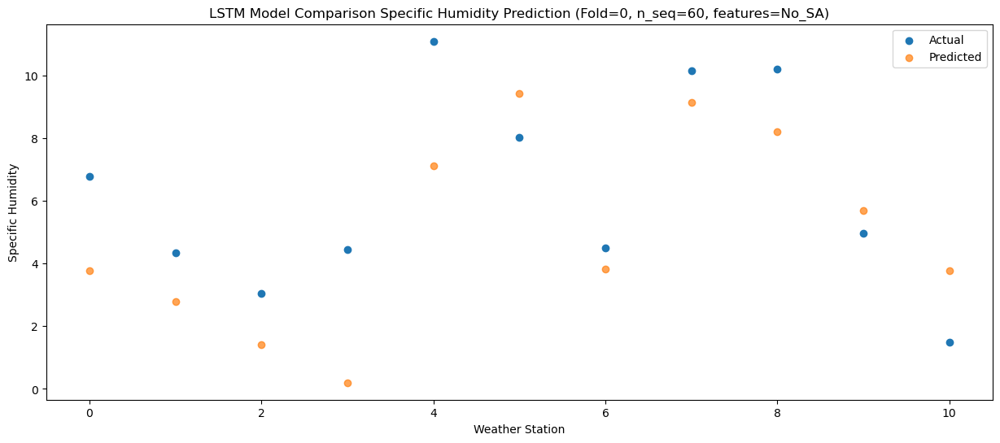

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   6.276923
1                 1    4.84   5.296923
2                 2    2.80   3.916923
3                 3    4.53   2.716923
4                 4   11.34   9.636925
5                 5   10.00  11.946923
6                 6    5.74   6.336923
7                 7   11.04  11.656923
8                 8   12.48  10.726923
9                 9    6.62   8.216925
10               10    4.13   6.276925


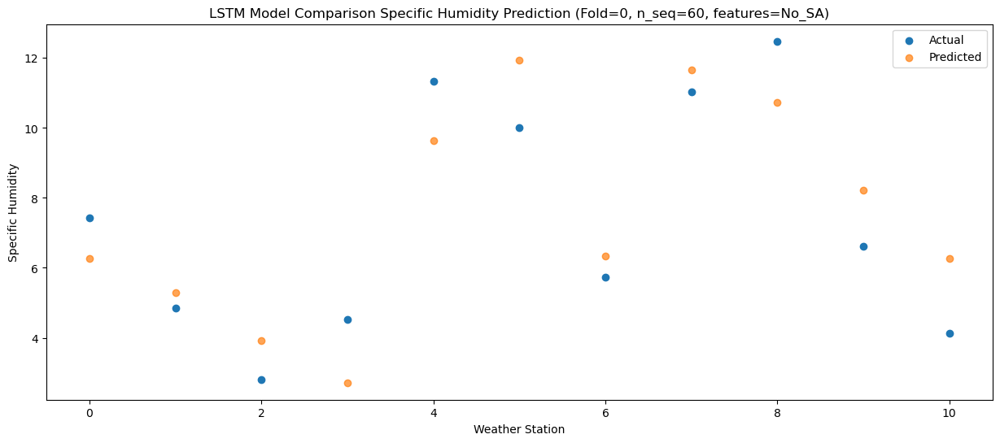

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  11.909399
1                 1    7.61  10.929399
2                 2    6.49   9.549399
3                 3    7.42   8.349399
4                 4   16.32  15.269400
5                 5   13.69  17.579399
6                 6    8.08  11.969399
7                 7   14.16  17.289399
8                 8   17.36  16.359399
9                 9   11.71  13.849400
10               10   10.56  11.909400


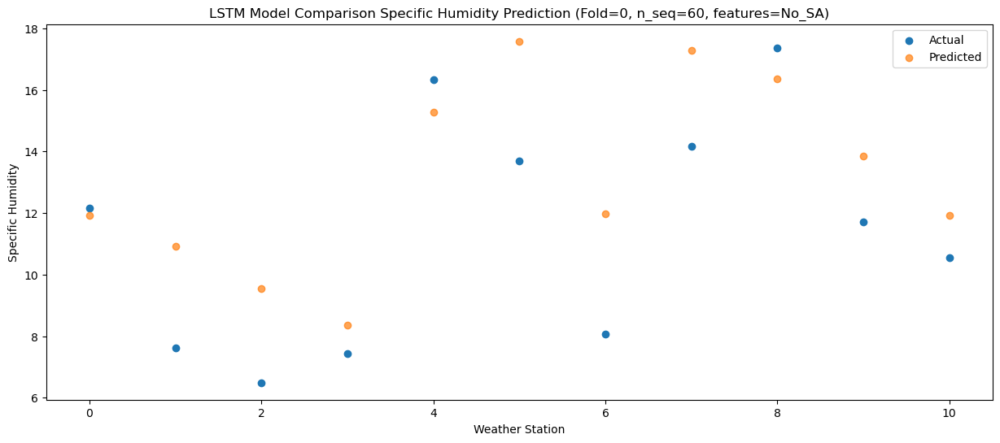

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  18.811149
1                 1   11.36  17.831149
2                 2   10.21  16.451149
3                 3   10.33  15.251149
4                 4   20.52  22.171151
5                 5   18.04  24.481149
6                 6   13.33  18.871149
7                 7   19.68  24.191149
8                 8   23.29  23.261149
9                 9   18.69  20.751151
10               10   18.52  18.811151


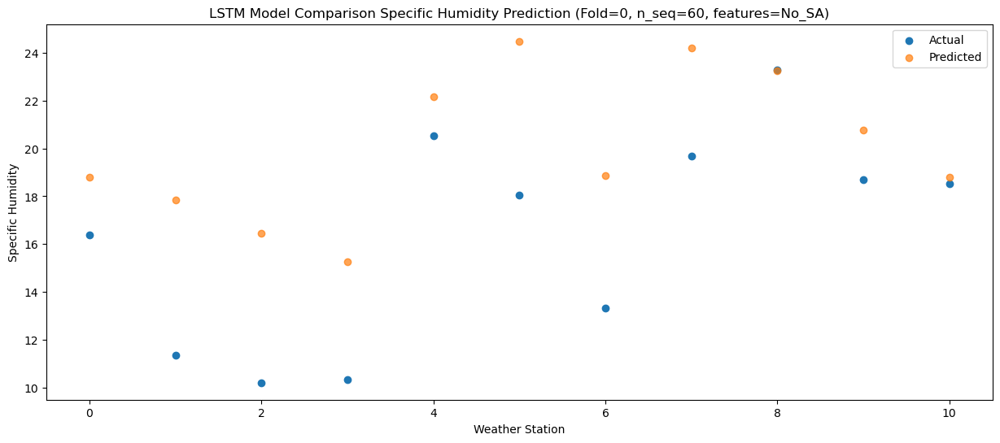

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  21.983809
1                 1   11.84  21.003809
2                 2   12.58  19.623809
3                 3   11.30  18.423809
4                 4   22.13  25.343811
5                 5   21.78  27.653809
6                 6   16.40  22.043809
7                 7   22.94  27.363809
8                 8   26.03  26.433809
9                 9   21.32  23.923811
10               10   21.68  21.983811


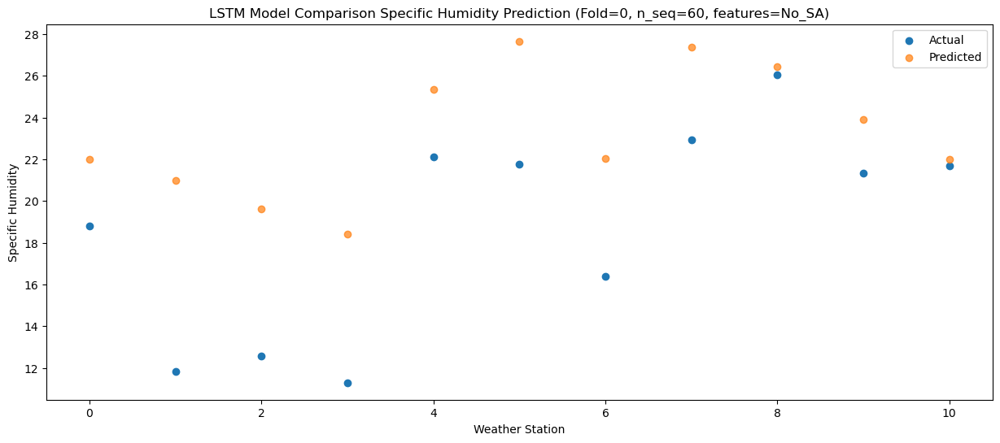

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  19.766728
1                 1   12.47  18.786727
2                 2   11.82  17.406728
3                 3   11.64  16.206728
4                 4   22.62  23.126730
5                 5   20.93  25.436727
6                 6   15.37  19.826728
7                 7   21.57  25.146727
8                 8   23.02  24.216728
9                 9   18.94  21.706730
10               10   18.99  19.766730


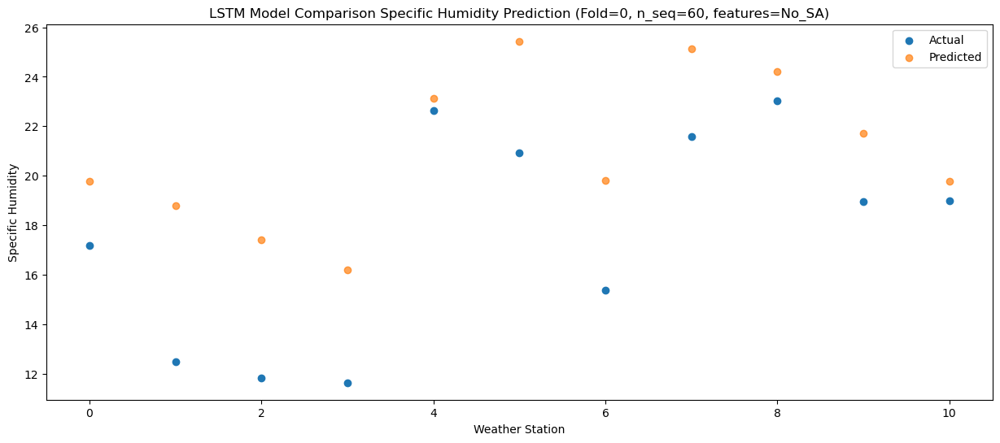

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  15.393925
1                 1    9.49  14.413924
2                 2    8.43  13.033925
3                 3    9.31  11.833925
4                 4   16.91  18.753927
5                 5   17.90  21.063924
6                 6   11.48  15.453925
7                 7   16.70  20.773924
8                 8   19.46  19.843925
9                 9   15.27  17.333927
10               10   14.16  15.393927


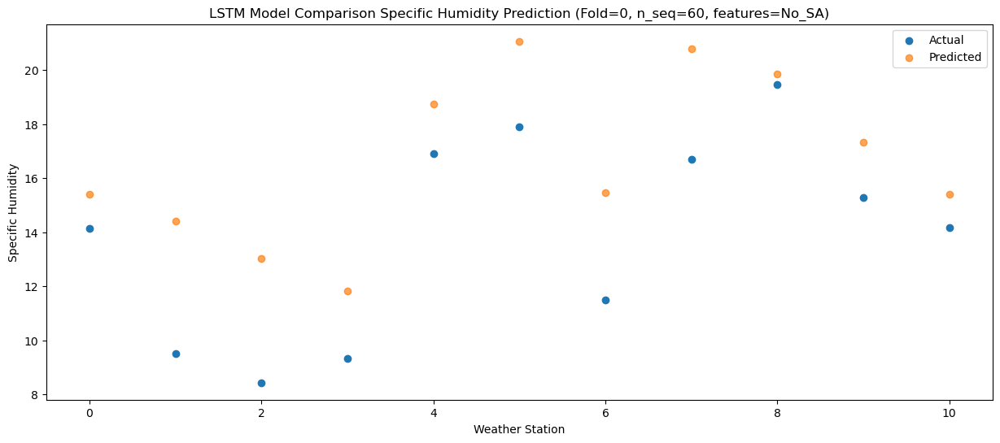

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   9.106469
1                 1    6.86   8.126468
2                 2    4.71   6.746469
3                 3    5.25   5.546469
4                 4   12.03  12.466471
5                 5   13.81  14.776468
6                 6    7.48   9.166469
7                 7   12.86  14.486468
8                 8   12.20  13.556469
9                 9    8.88  11.046471
10               10    7.41   9.106471


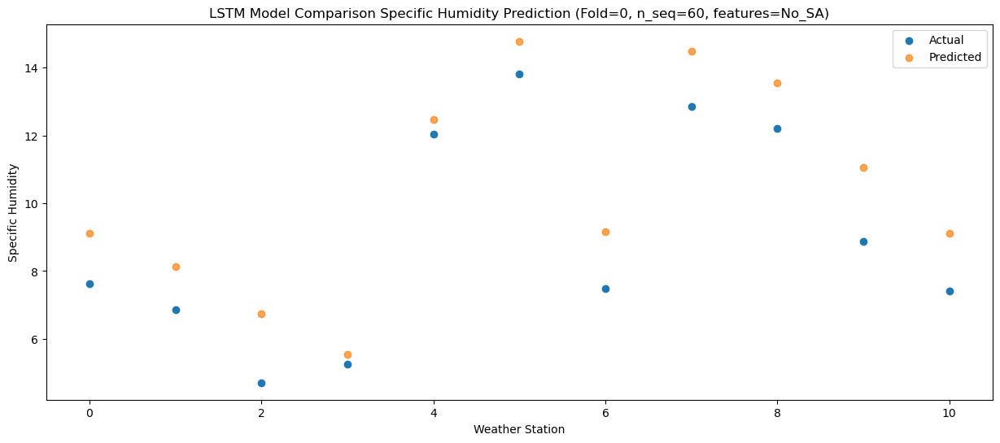

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.111703
1                 1    3.44   4.131702
2                 2   -0.22   2.751703
3                 3    2.41   1.551703
4                 4    9.51   8.471705
5                 5    9.69  10.781702
6                 6    3.30   5.171703
7                 7    8.63  10.491702
8                 8    9.34   9.561703
9                 9    5.20   7.051705
10               10    3.93   5.111705


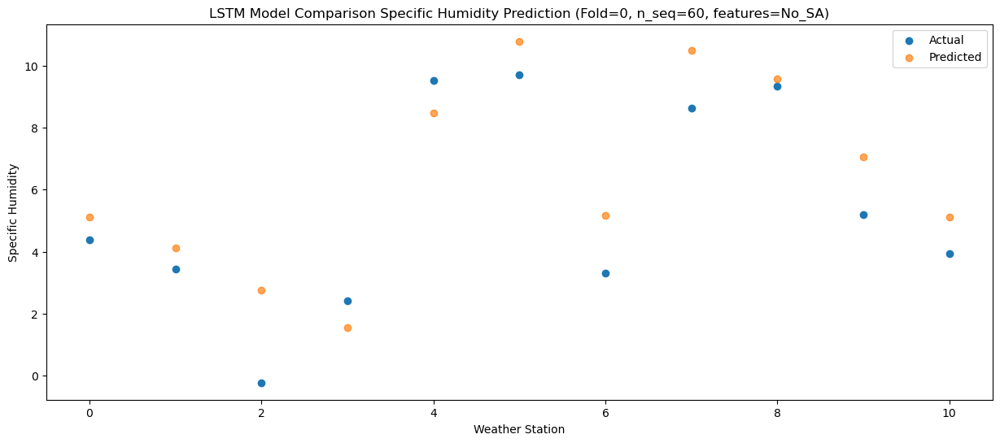

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -1.694433
1                 1   -3.77  -2.674434
2                 2   -7.22  -4.054433
3                 3   -5.05  -5.254433
4                 4    3.04   1.665568
5                 5    2.94   3.975566
6                 6   -3.63  -1.634433
7                 7    1.70   3.685566
8                 8    2.63   2.755567
9                 9   -2.31   0.245568
10               10   -3.10  -1.694432


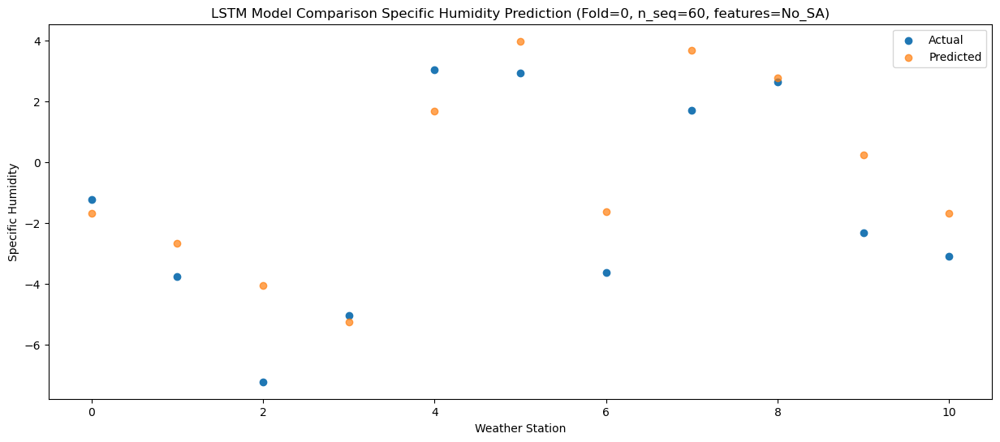

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -3.113925
1                 1   -3.11  -4.093926
2                 2   -6.40  -5.473925
3                 3   -4.96  -6.673925
4                 4    2.16   0.246077
5                 5    1.16   2.556074
6                 6   -4.21  -3.053925
7                 7    0.76   2.266074
8                 8    1.84   1.336075
9                 9   -3.90  -1.173923
10               10   -4.71  -3.113923


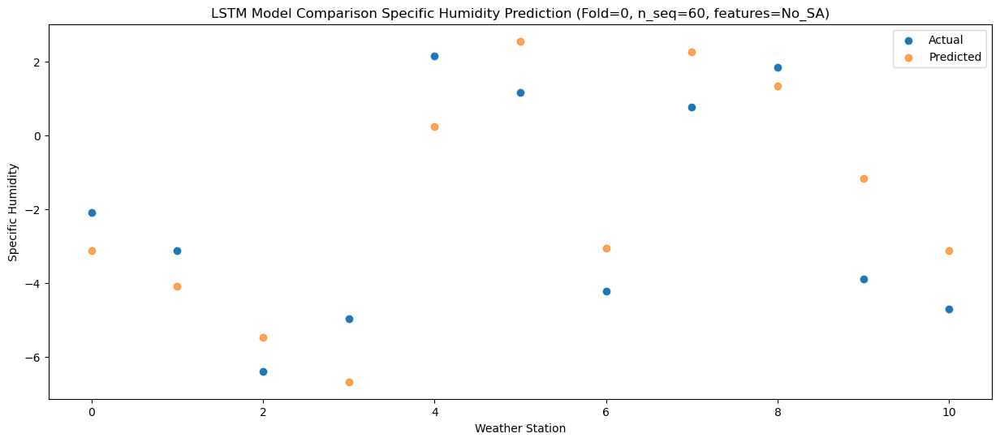

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -4.667373
1                 1   -3.20  -5.647374
2                 2   -5.54  -7.027373
3                 3   -6.53  -8.227373
4                 4   -0.93  -1.307371
5                 5    1.81   1.002626
6                 6   -3.57  -4.607373
7                 7    1.38   0.712626
8                 8   -2.43  -0.217373
9                 9   -6.07  -2.727371
10               10   -9.02  -4.667371


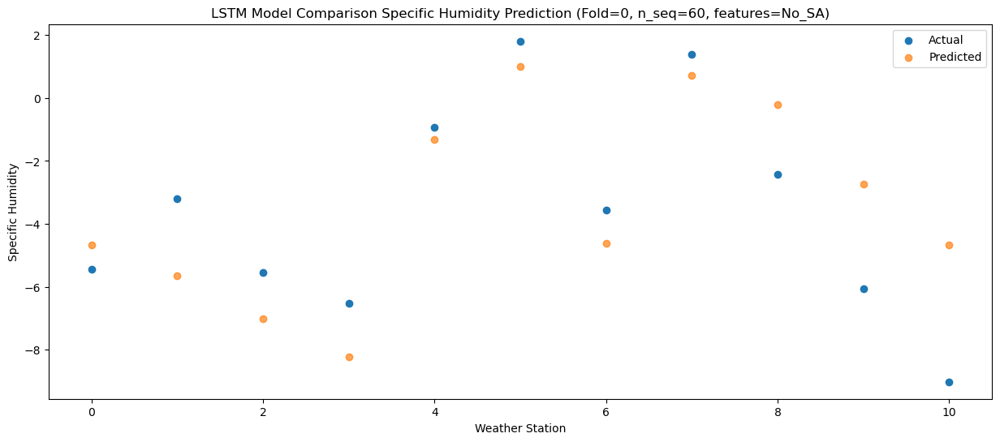

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   4.226340
1                 1    1.86   3.246339
2                 2    0.44   1.866340
3                 3    1.38   0.666340
4                 4    8.97   7.586342
5                 5    6.71   9.896339
6                 6    3.41   4.286340
7                 7    7.90   9.606339
8                 8   10.04   8.676340
9                 9    4.68   6.166342
10               10    2.71   4.226342


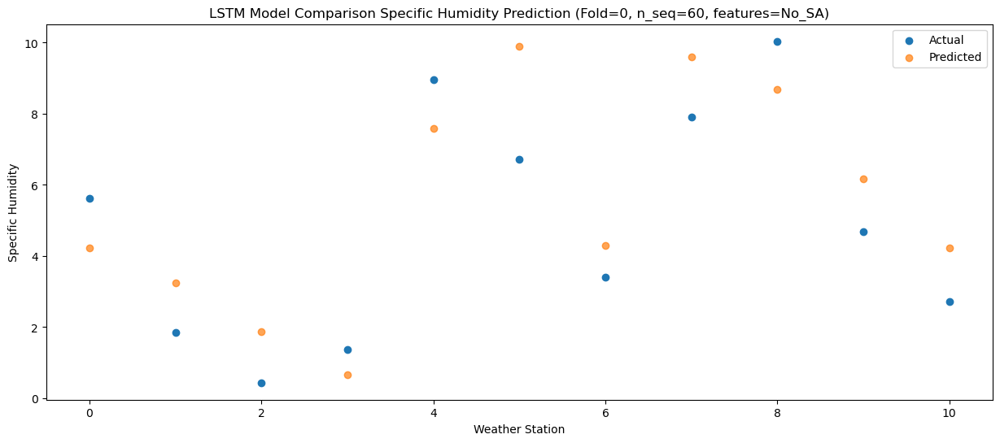

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   8.459841
1                 1    3.26   7.479840
2                 2    2.08   6.099841
3                 3    3.17   4.899841
4                 4   10.90  11.819842
5                 5   10.08  14.129840
6                 6    4.44   8.519841
7                 7   11.53  13.839840
8                 8   12.64  12.909841
9                 9    7.74  10.399842
10               10    6.68   8.459842


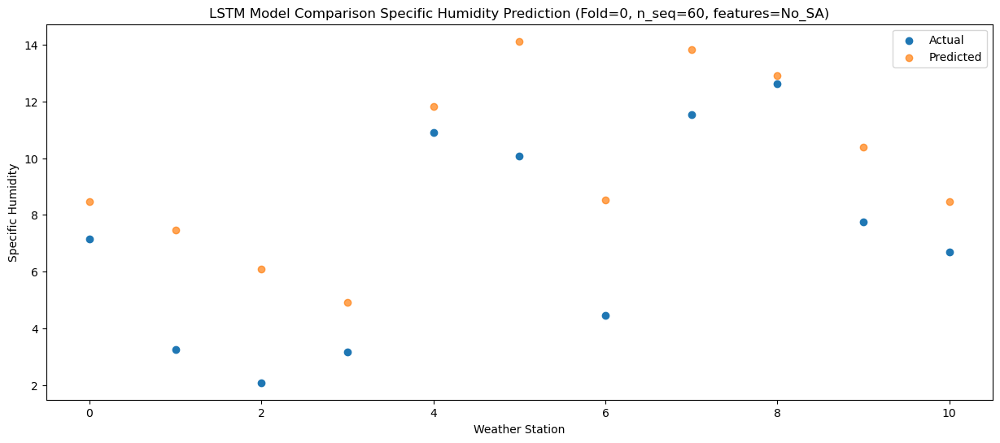

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  13.273751
1                 1    7.28  12.293750
2                 2    6.06  10.913751
3                 3    7.14   9.713751
4                 4   14.76  16.633753
5                 5   13.59  18.943750
6                 6    8.15  13.333751
7                 7   14.55  18.653750
8                 8   17.33  17.723751
9                 9   12.21  15.213753
10               10   11.83  13.273753


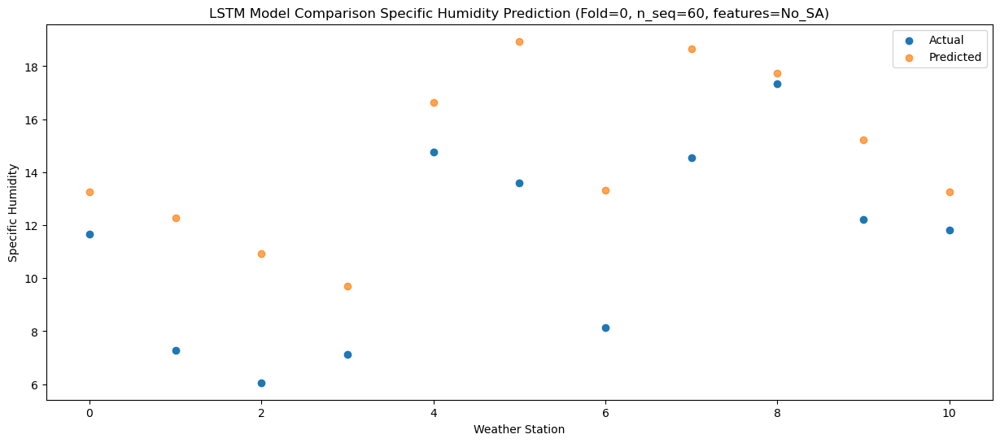

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  20.157096
1                 1   10.76  19.177095
2                 2   10.20  17.797096
3                 3   10.42  16.597096
4                 4   19.96  23.517098
5                 5   18.16  25.827095
6                 6   12.48  20.217096
7                 7   19.34  25.537095
8                 8   23.52  24.607096
9                 9   18.69  22.097098
10               10   19.14  20.157098


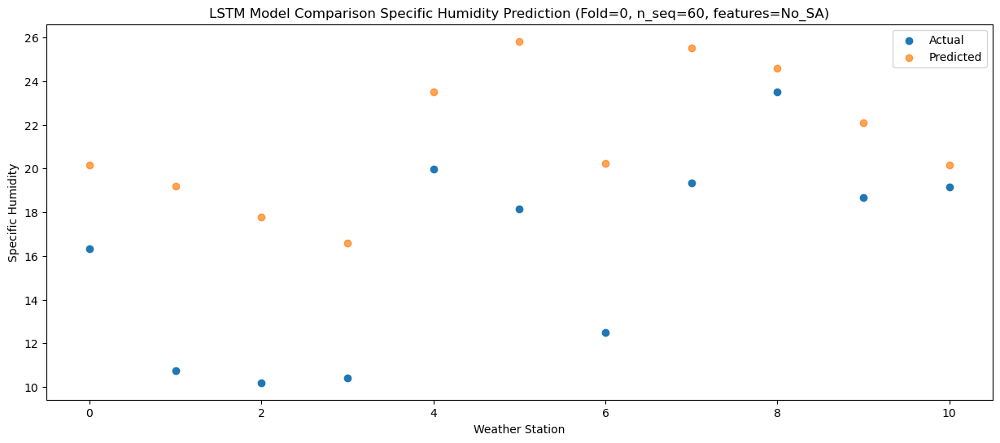

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  21.594371
1                 1   11.98  20.614368
2                 2   11.96  19.234369
3                 3   11.05  18.034371
4                 4   20.39  24.954373
5                 5   20.15  27.264368
6                 6   14.10  21.654371
7                 7   21.46  26.974368
8                 8   24.09  26.044371
9                 9   19.70  23.534373
10               10   19.73  21.594371


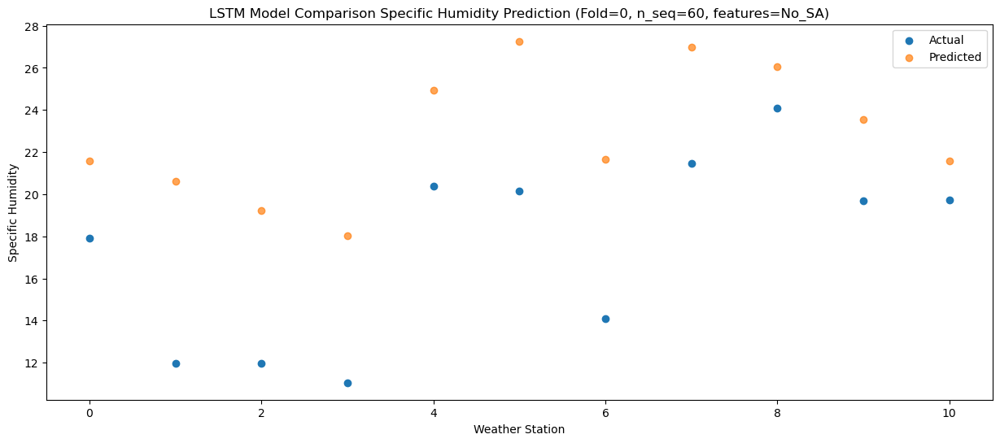

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  21.486229
1                 1   12.32  20.506226
2                 2   12.24  19.126227
3                 3   11.10  17.926229
4                 4   21.15  24.846231
5                 5   20.63  27.156226
6                 6   14.04  21.546229
7                 7   21.41  26.866226
8                 8   24.03  25.936229
9                 9   20.30  23.426231
10               10   20.44  21.486229


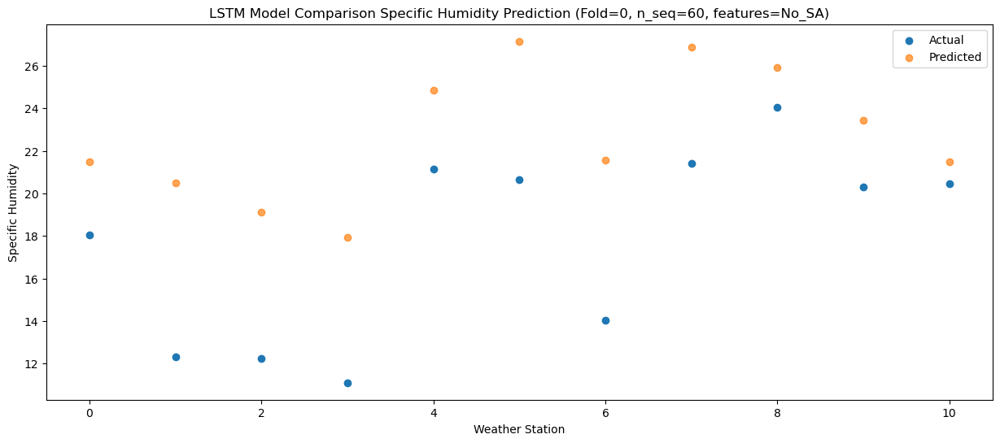

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  17.884945
1                 1   10.19  16.904942
2                 2    8.67  15.524943
3                 3    8.59  14.324945
4                 4   19.14  21.244947
5                 5   17.62  23.554942
6                 6    9.99  17.944945
7                 7   16.90  23.264942
8                 8   20.29  22.334945
9                 9   16.44  19.824947
10               10   16.39  17.884945


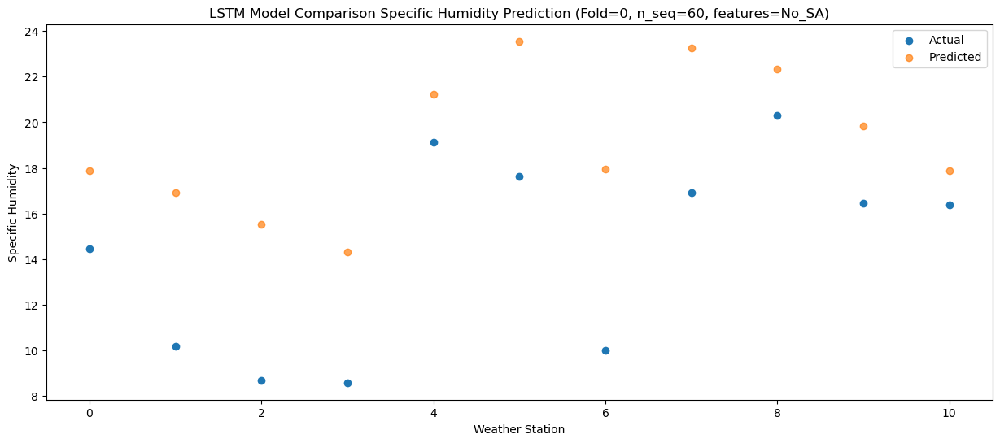

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  12.832099
1                 1    7.56  11.852096
2                 2    4.79  10.472097
3                 3    6.28   9.272099
4                 4   14.79  16.192101
5                 5   14.02  18.502096
6                 6    6.76  12.892099
7                 7   13.05  18.212096
8                 8   16.33  17.282099
9                 9   11.97  14.772101
10               10   12.04  12.832099


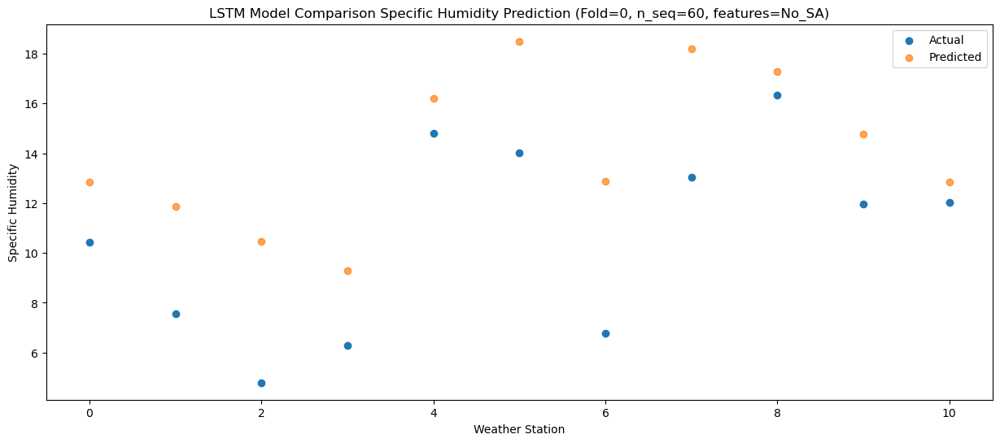

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   3.442482
1                 1    2.05   2.462479
2                 2   -3.57   1.082480
3                 3   -1.81  -0.117518
4                 4    7.22   6.802484
5                 5    5.85   9.112479
6                 6   -1.89   3.502483
7                 7    3.55   8.822479
8                 8    6.29   7.892482
9                 9    1.31   5.382484
10               10    1.18   3.442482


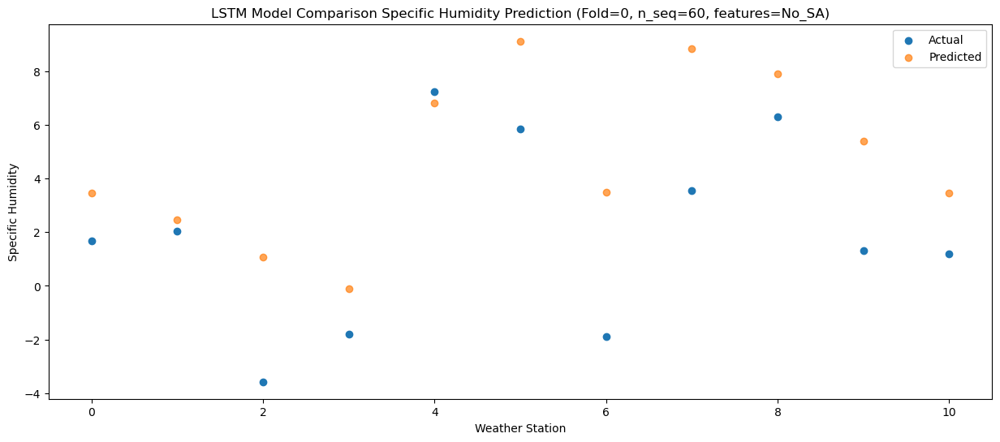

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   2.868587
1                 1    1.81   1.888583
2                 2   -1.39   0.508585
3                 3    0.96  -0.691413
4                 4    9.55   6.228589
5                 5    6.90   8.538583
6                 6    0.05   2.928588
7                 7    5.61   8.248583
8                 8    8.09   7.318587
9                 9    2.54   4.808589
10               10    0.28   2.868587


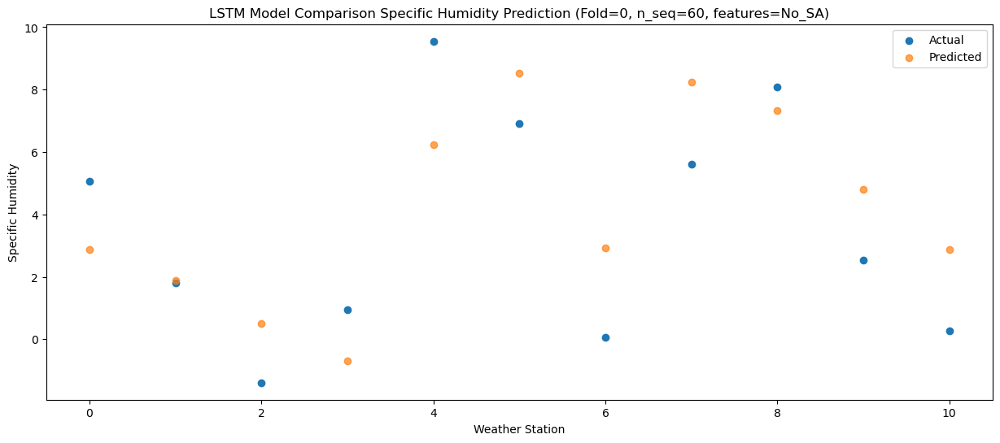

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -4.626276
1                 1   -4.87  -5.606280
2                 2   -7.40  -6.986278
3                 3   -6.39  -8.186276
4                 4    1.10  -1.266274
5                 5    0.52   1.043720
6                 6   -6.60  -4.566275
7                 7   -1.57   0.753720
8                 8   -0.42  -0.176276
9                 9   -6.43  -2.686274
10               10   -8.67  -4.626276


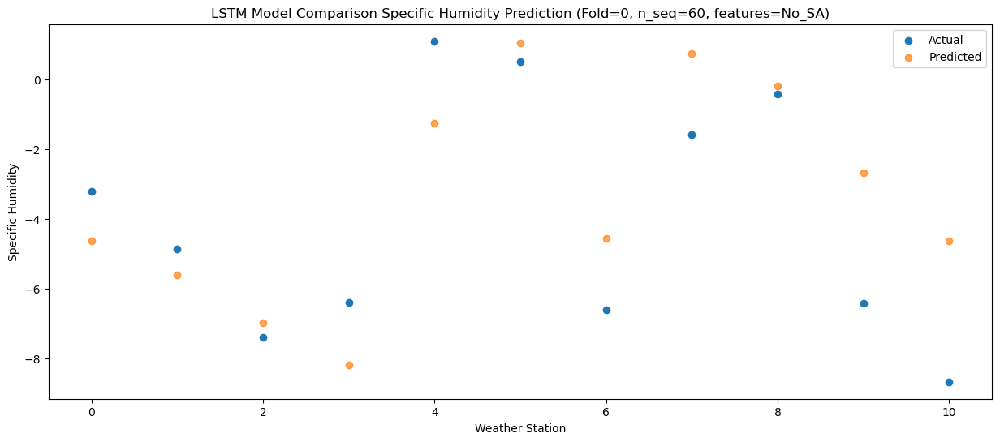

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -1.846262
1                 1   -2.10  -2.826266
2                 2   -3.45  -4.206264
3                 3   -3.95  -5.406262
4                 4    0.87   1.513740
5                 5    4.13   3.823734
6                 6   -2.62  -1.786261
7                 7    2.67   3.533733
8                 8    1.62   2.603738
9                 9   -2.85   0.093740
10               10   -5.43  -1.846262


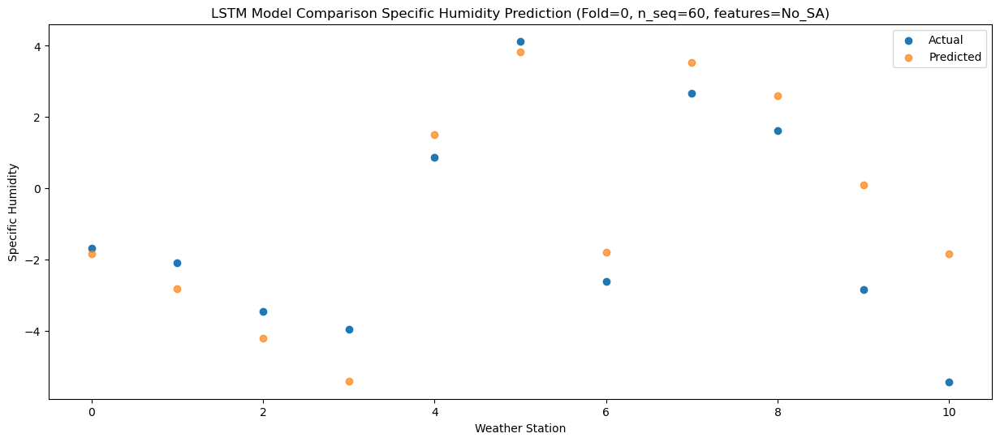

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   4.138539
1                 1    1.76   3.158536
2                 2    0.05   1.778538
3                 3   -0.16   0.578539
4                 4    7.36   7.498541
5                 5    8.05   9.808536
6                 6    1.72   4.198540
7                 7    7.51   9.518535
8                 8    8.84   8.588539
9                 9    4.13   6.078541
10               10    1.48   4.138539


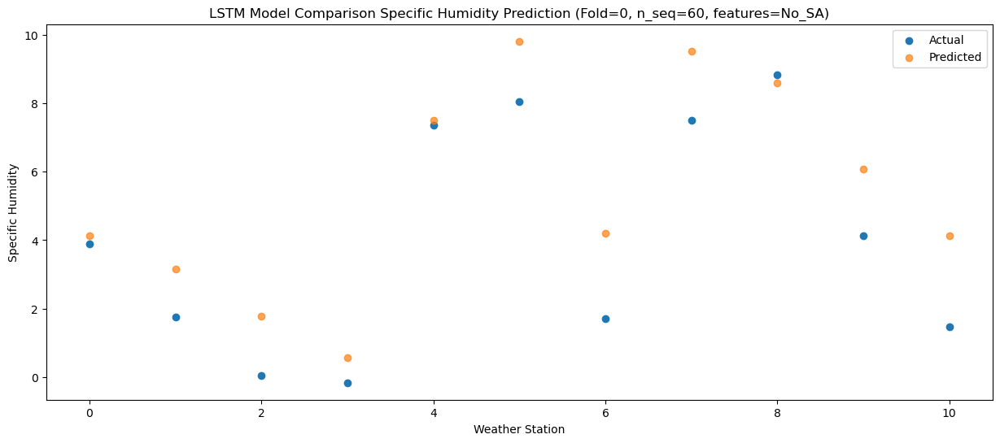

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   8.072318
1                 1    4.73   7.092314
2                 2    2.79   5.712316
3                 3    4.63   4.512318
4                 4   13.40  11.432320
5                 5   10.92  13.742314
6                 6    4.64   8.132319
7                 7   10.83  13.452313
8                 8   12.79  12.522318
9                 9    6.86  10.012320
10               10    5.09   8.072318


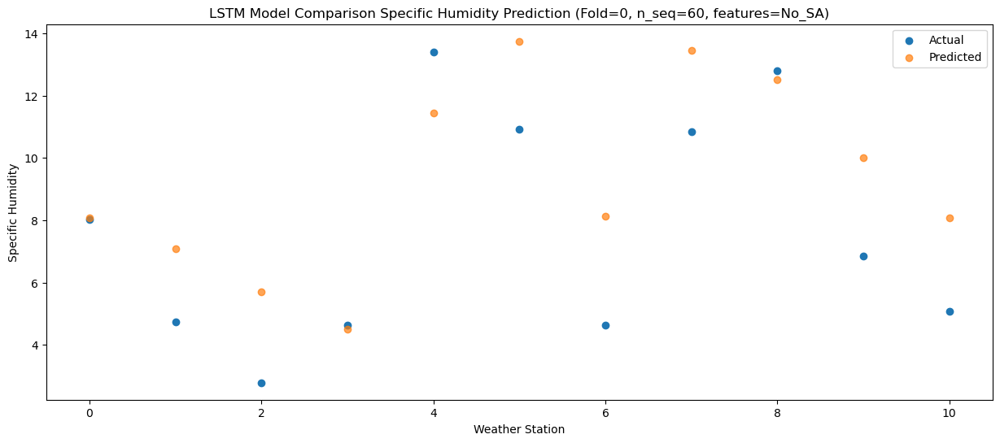

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  15.055192
1                 1    9.04  14.075188
2                 2    8.55  12.695190
3                 3    9.15  11.495192
4                 4   18.11  18.415194
5                 5   15.55  20.725188
6                 6    9.71  15.115193
7                 7   15.81  20.435188
8                 8   19.63  19.505192
9                 9   15.03  16.995194
10               10   14.41  15.055192


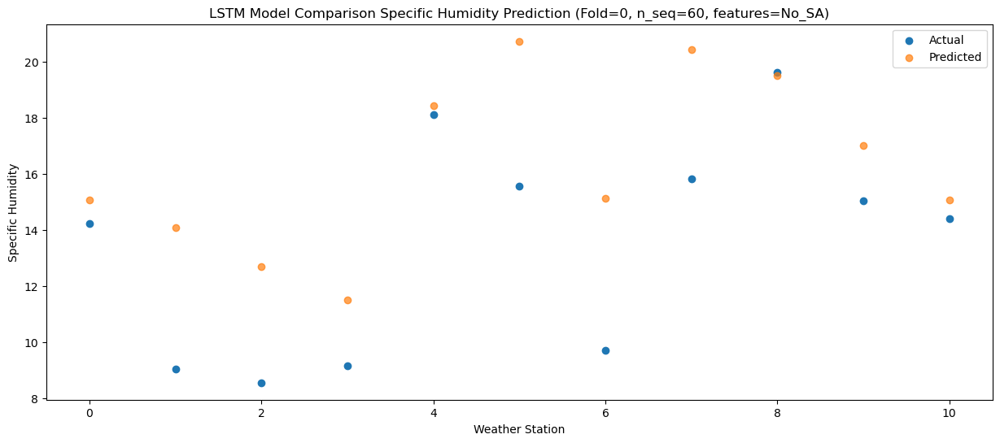

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  19.523435
1                 1   12.73  18.543429
2                 2   12.33  17.163433
3                 3   11.58  15.963433
4                 4   22.45  22.883436
5                 5   19.12  25.193429
6                 6   13.62  19.583434
7                 7   19.81  24.903428
8                 8   24.15  23.973435
9                 9   18.93  21.463435
10               10   19.17  19.523435


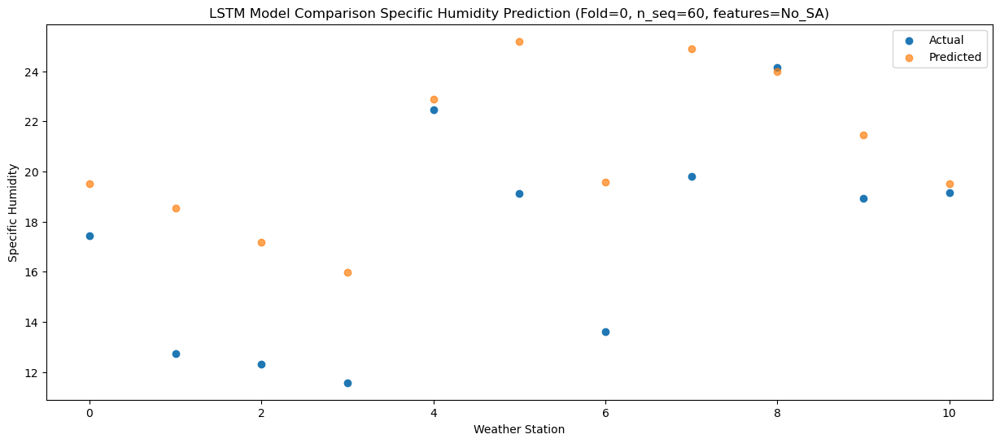

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  22.462591
1                 1   12.87  21.482586
2                 2   13.25  20.102589
3                 3   11.56  18.902589
4                 4   24.81  25.822593
5                 5   21.26  28.132586
6                 6   14.72  22.522590
7                 7   21.68  27.842585
8                 8   26.48  26.912591
9                 9   20.96  24.402591
10               10   20.28  22.462591


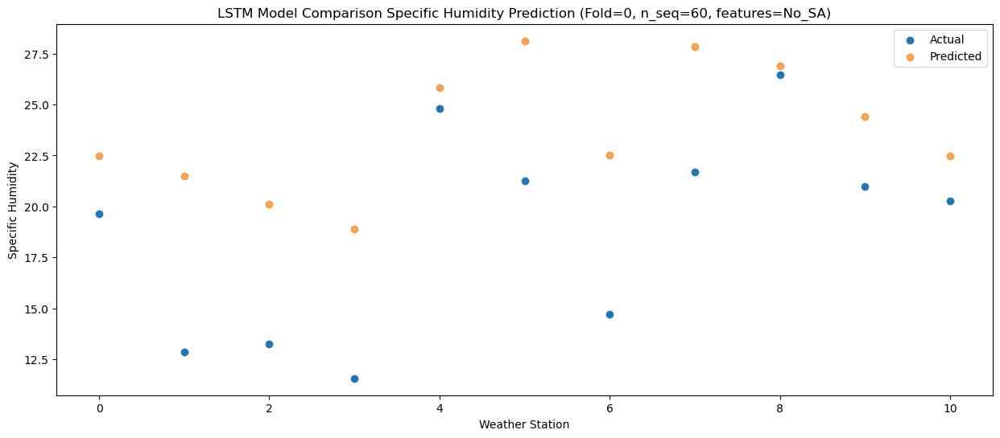

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  21.252537
1                 1   12.32  20.272531
2                 2   12.02  18.892535
3                 3   10.37  17.692535
4                 4   22.45  24.612539
5                 5   20.41  26.922531
6                 6   13.43  21.312536
7                 7   20.00  26.632530
8                 8   23.60  25.702537
9                 9   19.05  23.192537
10               10   19.16  21.252537


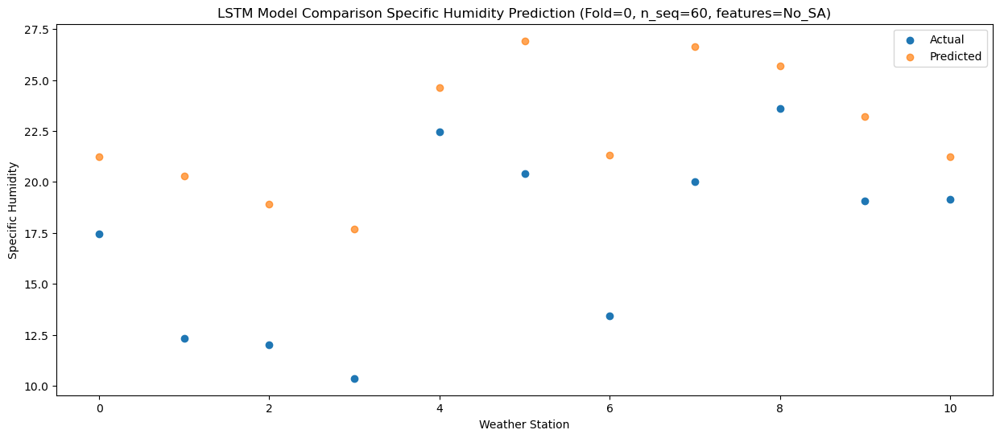

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  17.079496
1                 1   11.30  16.099489
2                 2    8.90  14.719493
3                 3    9.13  13.519493
4                 4   19.50  20.439498
5                 5   17.76  22.749489
6                 6   10.37  17.139494
7                 7   16.30  22.459488
8                 8   19.96  21.529496
9                 9   15.32  19.019495
10               10   15.32  17.079495


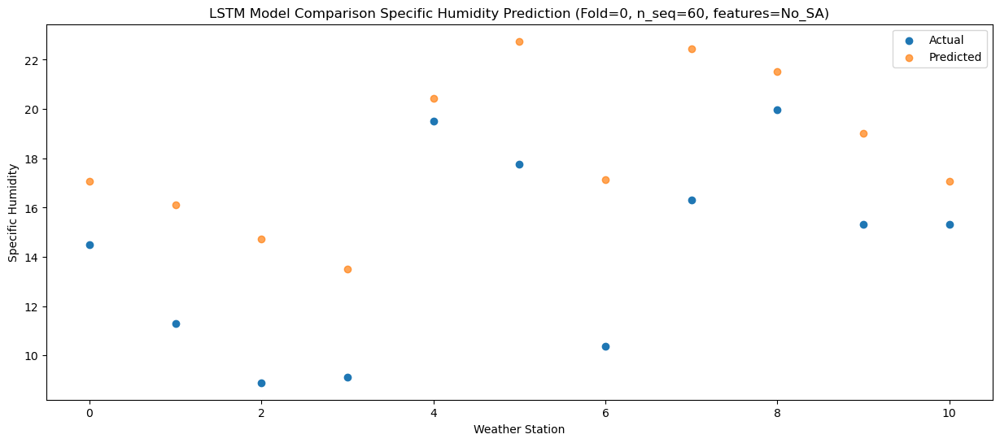

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   9.687071
1                 1    5.70   8.707064
2                 2    1.76   7.327068
3                 3    3.51   6.127068
4                 4   13.58  13.047073
5                 5   11.20  15.357064
6                 6    3.43   9.747069
7                 7    9.11  15.067063
8                 8   13.40  14.137071
9                 9    8.28  11.627070
10               10    8.08   9.687070


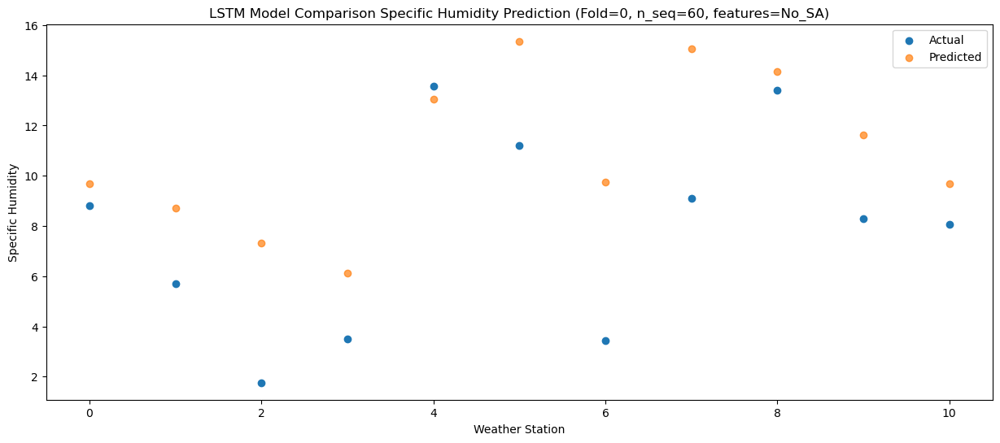

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   4.737563
1                 1    3.01   3.757557
2                 2   -0.72   2.377561
3                 3   -0.60   1.177561
4                 4    6.65   8.097565
5                 5    9.51  10.407557
6                 6    1.20   4.797561
7                 7    6.91  10.117556
8                 8    7.43   9.187563
9                 9    3.26   6.677562
10               10    3.05   4.737562


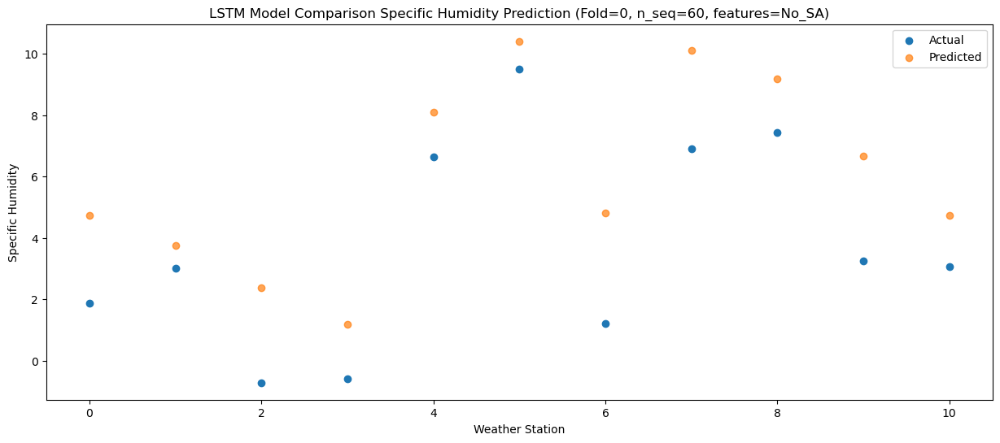

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22  -1.423862
1                 1   -0.84  -2.403869
2                 2   -5.24  -3.783865
3                 3   -2.78  -4.983865
4                 4    3.92   1.936140
5                 5    2.99   4.246131
6                 6   -5.31  -1.363864
7                 7   -0.26   3.956130
8                 8    2.14   3.026138
9                 9   -2.45   0.516137
10               10   -3.13  -1.423863


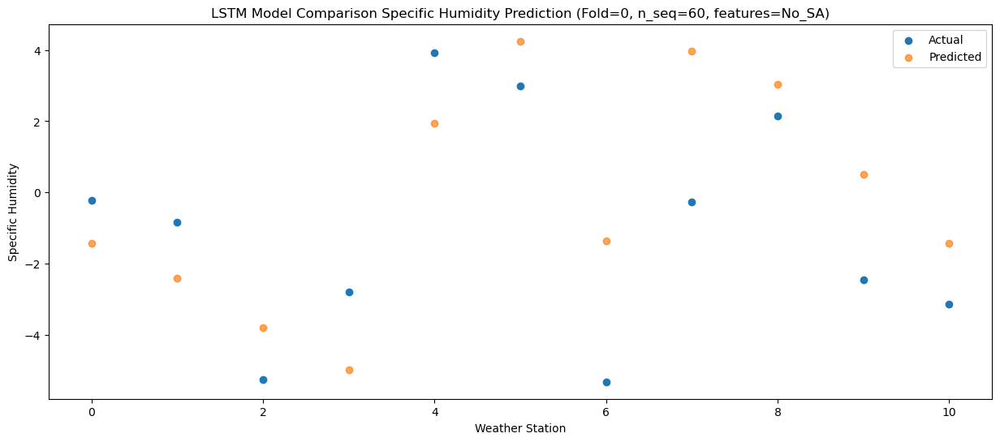

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42   0.850948
1                 1   -0.05  -0.129059
2                 2   -3.29  -1.509055
3                 3   -1.34  -2.709055
4                 4    4.89   4.210950
5                 5    4.68   6.520941
6                 6   -2.12   0.910946
7                 7    2.91   6.230940
8                 8    4.70   5.300948
9                 9   -0.56   2.790947
10               10   -2.00   0.850947


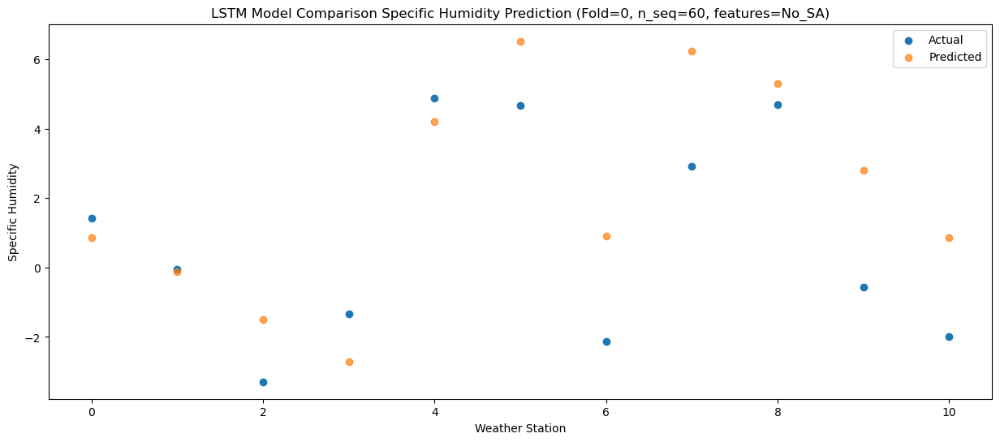

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95   1.277966
1                 1    1.05   0.297958
2                 2   -0.51  -1.082036
3                 3   -0.93  -2.282036
4                 4    5.02   4.637968
5                 5    6.17   6.947958
6                 6    0.88   1.337963
7                 7    5.88   6.657957
8                 8    6.31   5.727966
9                 9    1.48   3.217964
10               10   -1.59   1.277966


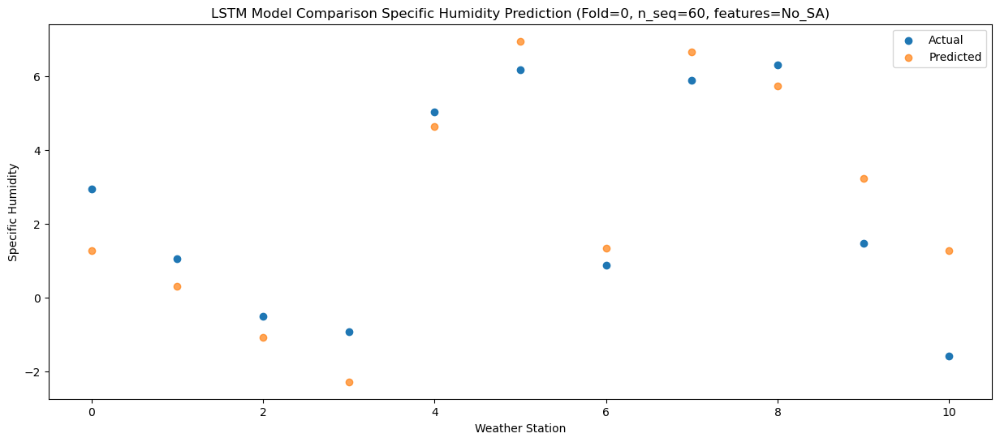

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   3.250592
1                 1    2.64   2.270582
2                 2   -0.53   0.890587
3                 3    2.59  -0.309411
4                 4    9.74   6.610594
5                 5    7.08   8.920582
6                 6    1.36   3.310586
7                 7    6.56   8.630581
8                 8    8.13   7.700592
9                 9    1.82   5.190587
10               10    0.27   3.250591


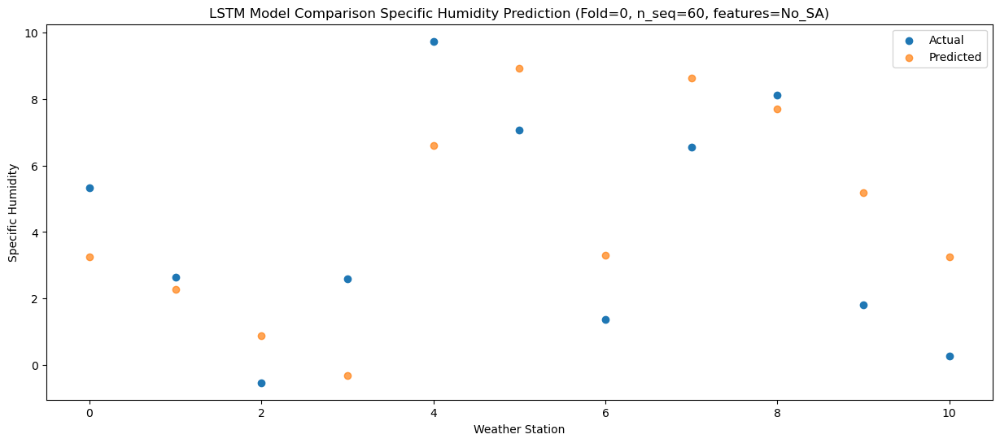

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94   9.855146
1                 1    4.79   8.875135
2                 2    2.54   7.495141
3                 3    4.01   6.295143
4                 4   11.24  13.215148
5                 5   11.76  15.525135
6                 6    4.92   9.915140
7                 7   11.18  15.235134
8                 8   13.91  14.305146
9                 9    8.10  11.795141
10               10    7.12   9.855145


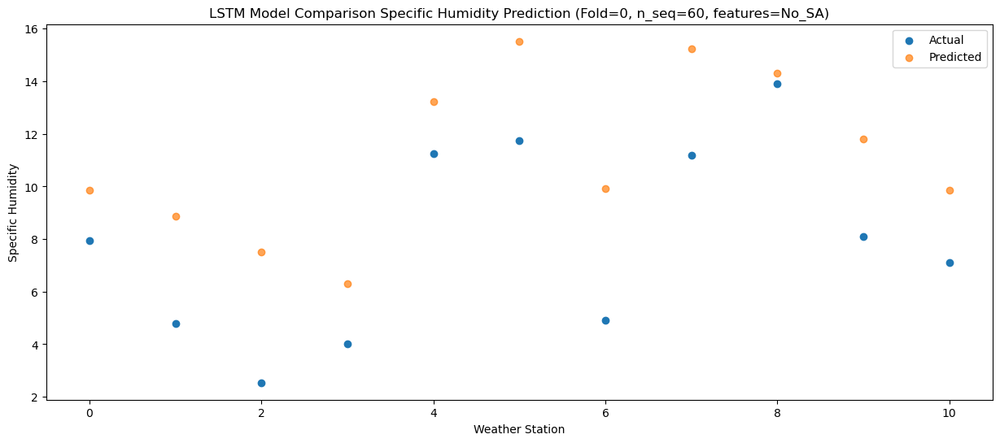

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41  14.740684
1                 1    7.97  13.760673
2                 2    5.95  12.380679
3                 3    8.44  11.180681
4                 4   16.77  18.100686
5                 5   13.28  20.410673
6                 6    7.61  14.800678
7                 7   13.47  20.120672
8                 8   19.50  19.190684
9                 9   13.06  16.680679
10               10   12.14  14.740683


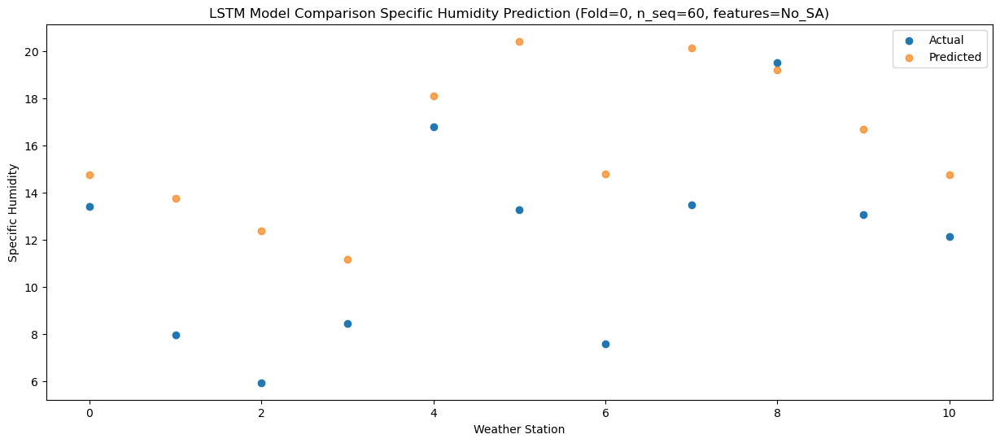

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  18.378520
1                 1   11.05  17.398509
2                 2    9.27  16.018515
3                 3   12.19  14.818517
4                 4   21.32  21.738522
5                 5   17.10  24.048509
6                 6   10.96  18.438514
7                 7   17.22  23.758508
8                 8   23.37  22.828520
9                 9   16.90  20.318515
10               10   17.65  18.378519


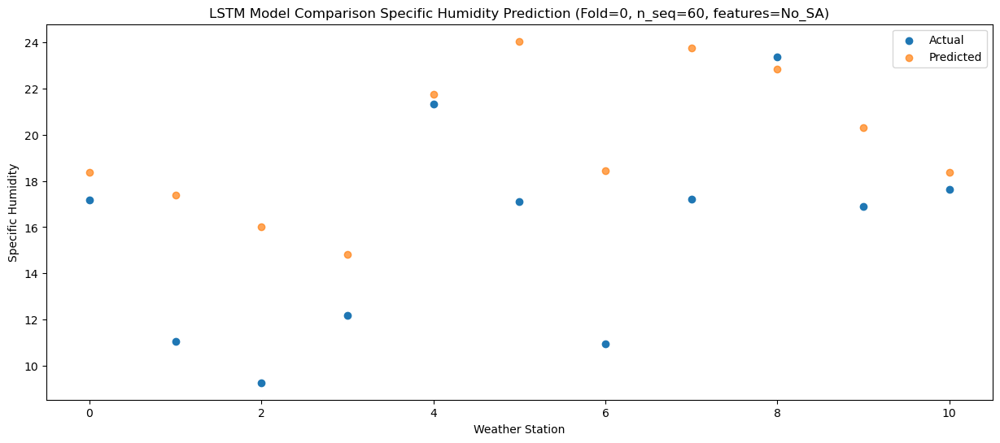

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  22.531922
1                 1   12.88  21.551911
2                 2   12.37  20.171917
3                 3   13.31  18.971919
4                 4   24.31  25.891924
5                 5   20.93  28.201911
6                 6   14.67  22.591916
7                 7   21.36  27.911910
8                 8   24.86  26.981922
9                 9   19.73  24.471917
10               10   20.11  22.531921


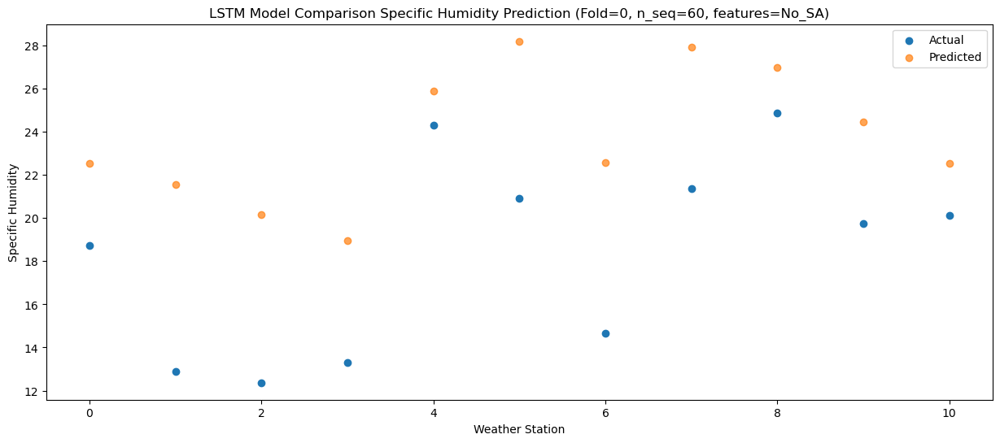

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  20.606989
1                 1   14.47  19.626979
2                 2   11.98  18.246984
3                 3   14.84  17.046986
4                 4   26.05  23.966991
5                 5   20.45  26.276979
6                 6   13.98  20.666983
7                 7   20.22  25.986978
8                 8   23.60  25.056989
9                 9   18.93  22.546984
10               10   18.30  20.606988


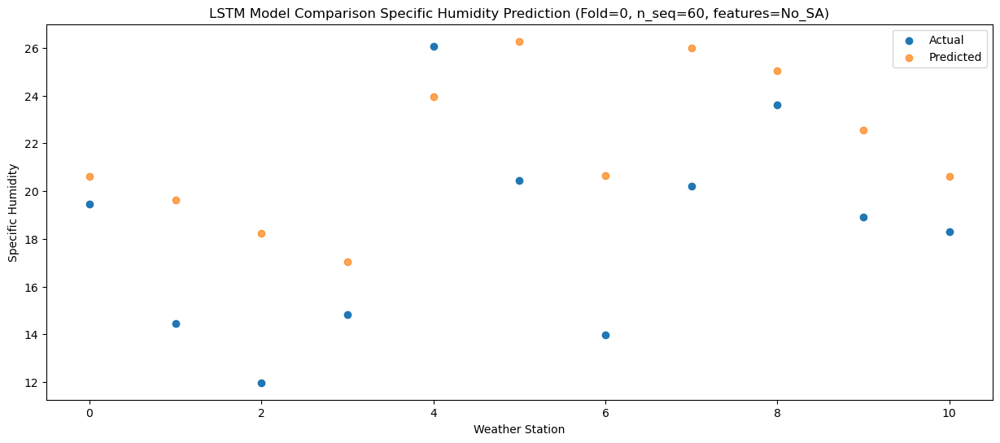

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  17.803345
1                 1   11.09  16.823334
2                 2    8.53  15.443340
3                 3   11.40  14.243342
4                 4   21.57  21.163347
5                 5   16.93  23.473334
6                 6   10.47  17.863339
7                 7   16.46  23.183333
8                 8   20.43  22.253345
9                 9   16.32  19.743340
10               10   15.92  17.803344


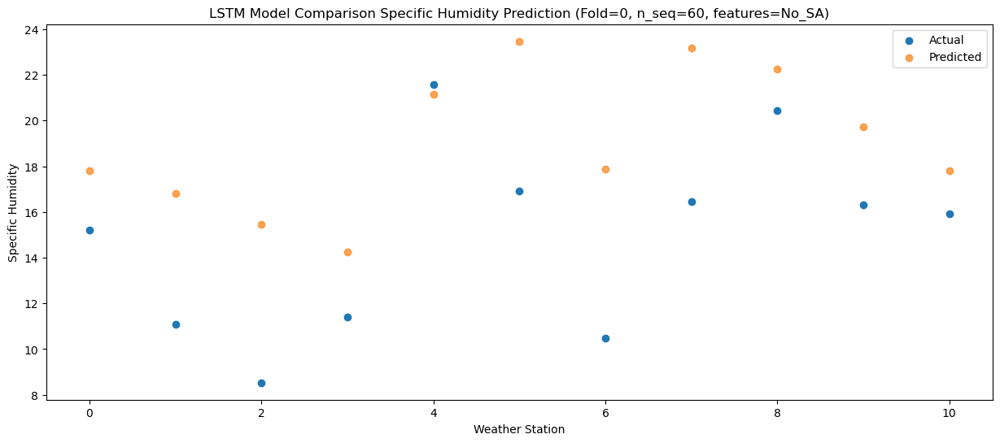

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16  11.989634
1                 1    5.98  11.009623
2                 2    2.55   9.629629
3                 3    5.15   8.429631
4                 4   13.91  15.349636
5                 5   12.58  17.659623
6                 6    5.26  12.049628
7                 7   11.07  17.369622
8                 8   14.83  16.439634
9                 9    9.74  13.929629
10               10    9.96  11.989633


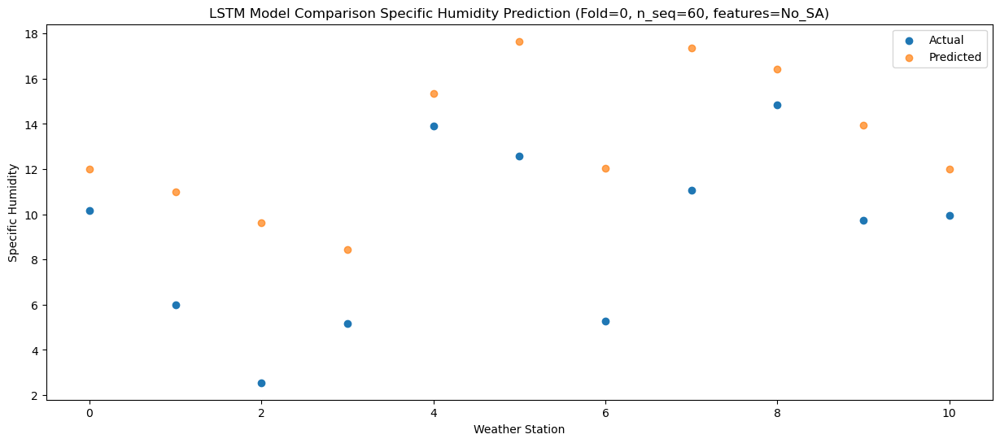

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30   4.804296
1                 1    0.74   3.824285
2                 2   -2.54   2.444291
3                 3   -0.71   1.244293
4                 4    7.55   8.164298
5                 5    7.14  10.474285
6                 6   -0.61   4.864290
7                 7    4.62  10.184284
8                 8    7.84   9.254296
9                 9    3.24   6.744291
10               10    2.32   4.804295


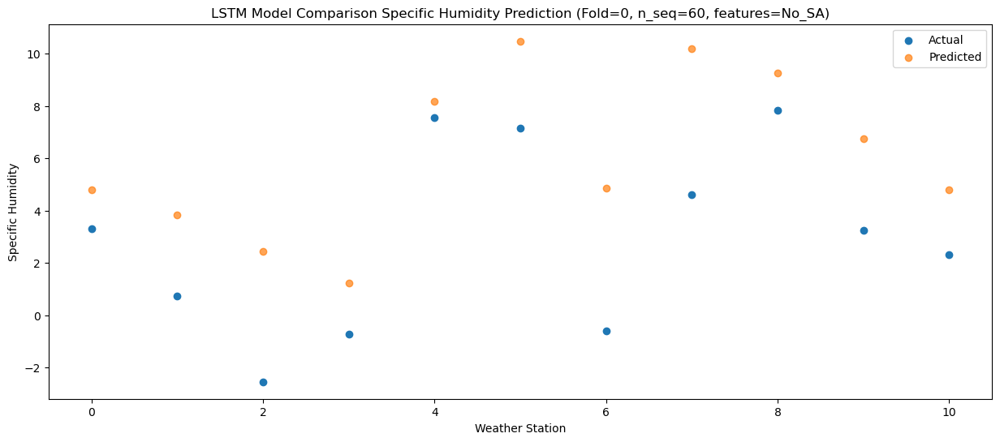

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70   2.673683
1                 1   -1.96   1.693672
2                 2   -5.57   0.313678
3                 3   -3.50  -0.886320
4                 4    4.76   6.033684
5                 5    5.00   8.343672
6                 6   -2.90   2.733677
7                 7    3.03   8.053671
8                 8    5.28   7.123683
9                 9    0.81   4.613678
10               10    1.64   2.673682


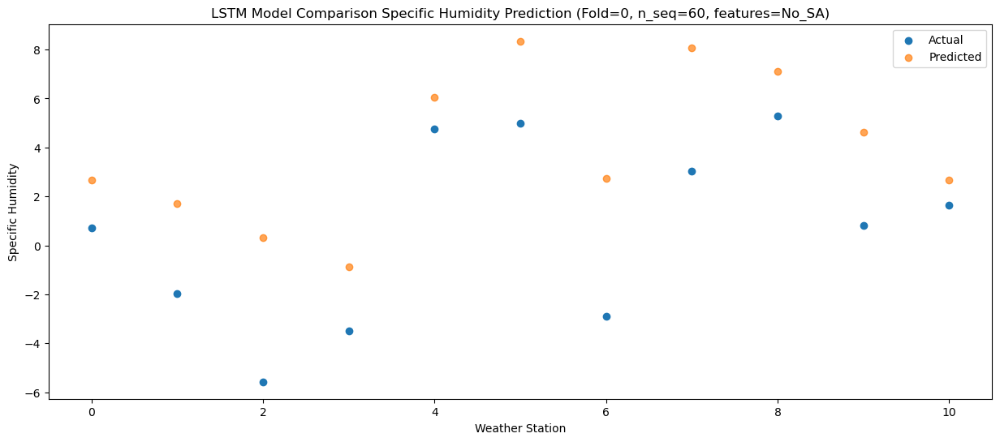

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -1.846789
1                 1   -4.23  -2.826800
2                 2   -8.08  -4.206794
3                 3   -6.38  -5.406792
4                 4   -0.22   1.513213
5                 5    3.73   3.823200
6                 6   -5.03  -1.786795
7                 7    0.33   3.533199
8                 8   -0.98   2.603211
9                 9   -4.95   0.093206
10               10   -5.28  -1.846790


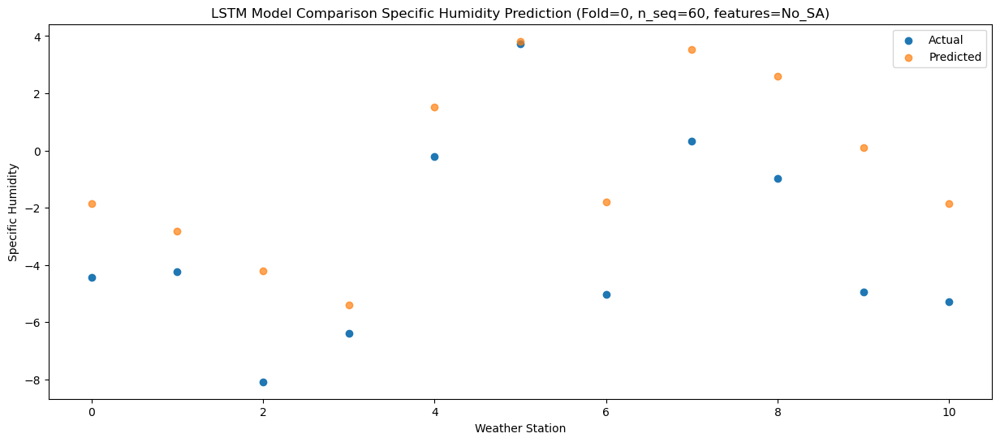

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46   2.713841
1                 1   -1.73   1.733830
2                 2   -3.57   0.353836
3                 3   -1.73  -0.846162
4                 4    7.65   6.073843
5                 5    4.25   8.383830
6                 6   -1.47   2.773835
7                 7    3.47   8.093829
8                 8    7.64   7.163841
9                 9    1.19   4.653836
10               10   -0.27   2.713840


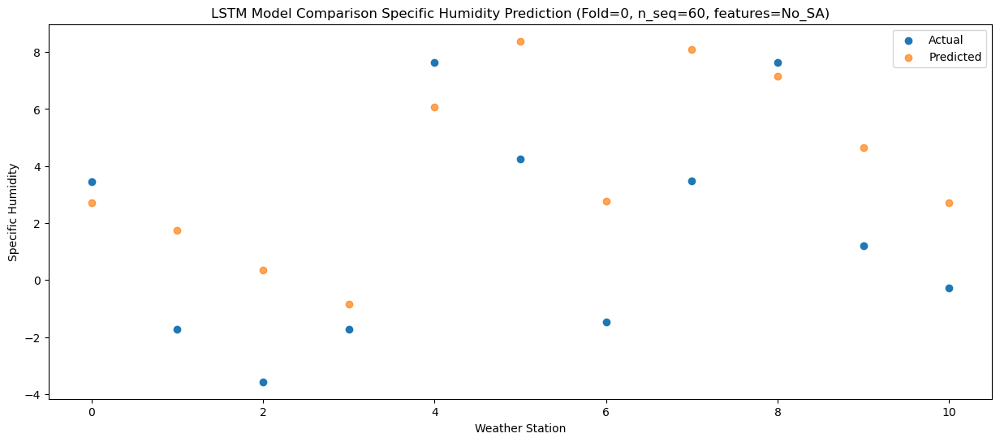

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   7.138519
1                 1    1.57   6.158508
2                 2    0.81   4.778514
3                 3    1.21   3.578516
4                 4   10.20  10.498521
5                 5    8.30  12.808508
6                 6    2.37   7.198513
7                 7    7.62  12.518507
8                 8   10.92  11.588519
9                 9    4.51   9.078514
10               10    3.23   7.138518


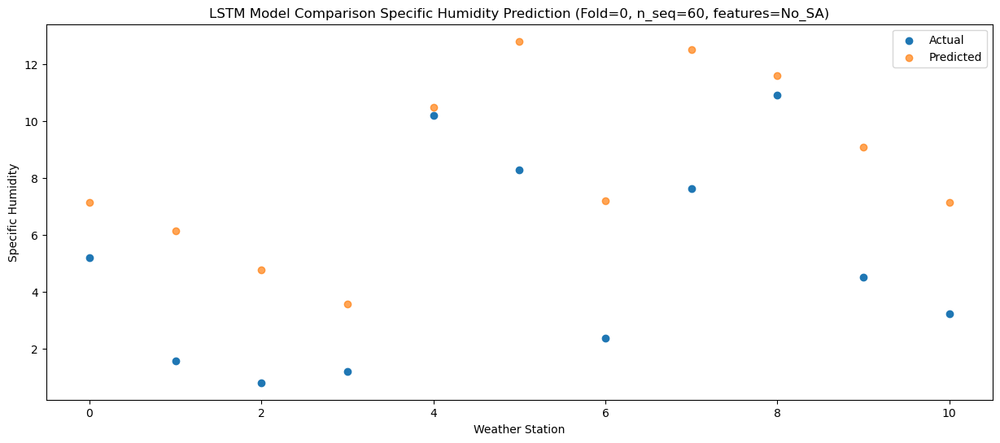

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98  11.405847
1                 1    4.45  10.425836
2                 2    4.50   9.045842
3                 3    4.78   7.845844
4                 4   13.47  14.765849
5                 5   11.52  17.075836
6                 6    5.96  11.465841
7                 7   12.10  16.785835
8                 8   15.80  15.855847
9                 9    9.73  13.345842
10               10    8.57  11.405846


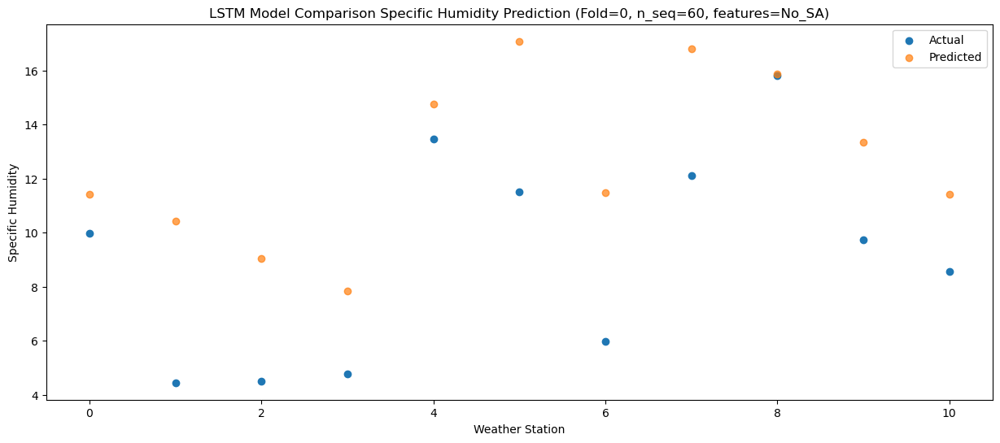

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89  16.881779
1                 1    8.94  15.901768
2                 2    8.98  14.521774
3                 3    9.17  13.321776
4                 4   18.05  20.241781
5                 5   16.33  22.551768
6                 6    9.96  16.941773
7                 7   16.06  22.261767
8                 8   20.87  21.331779
9                 9   15.53  18.821774
10               10   15.54  16.881778


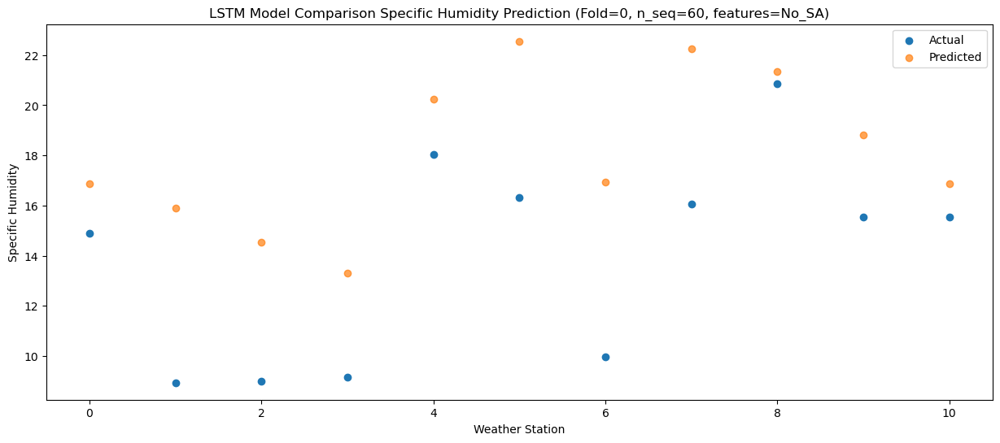

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  22.438349
1                 1   11.87  21.458338
2                 2   13.22  20.078344
3                 3   11.29  18.878346
4                 4   21.55  25.798351
5                 5   19.76  28.108338
6                 6   13.87  22.498343
7                 7   20.08  27.818337
8                 8   23.80  26.888349
9                 9   19.29  24.378344
10               10   19.86  22.438348


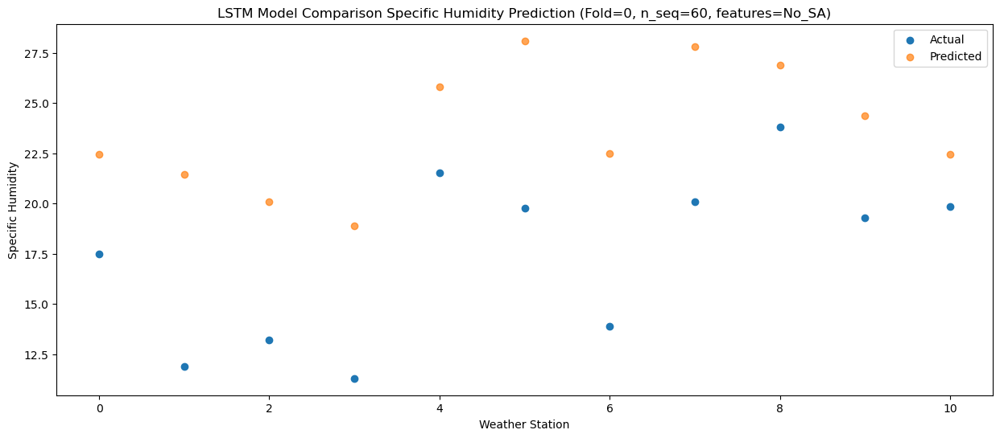

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  23.611261
1                 1   13.00  22.631250
2                 2   13.49  21.251256
3                 3   11.23  20.051258
4                 4   21.41  26.971263
5                 5   21.42  29.281250
6                 6   15.13  23.671255
7                 7   21.30  28.991249
8                 8   24.35  28.061261
9                 9   20.13  25.551256
10               10   20.75  23.611260


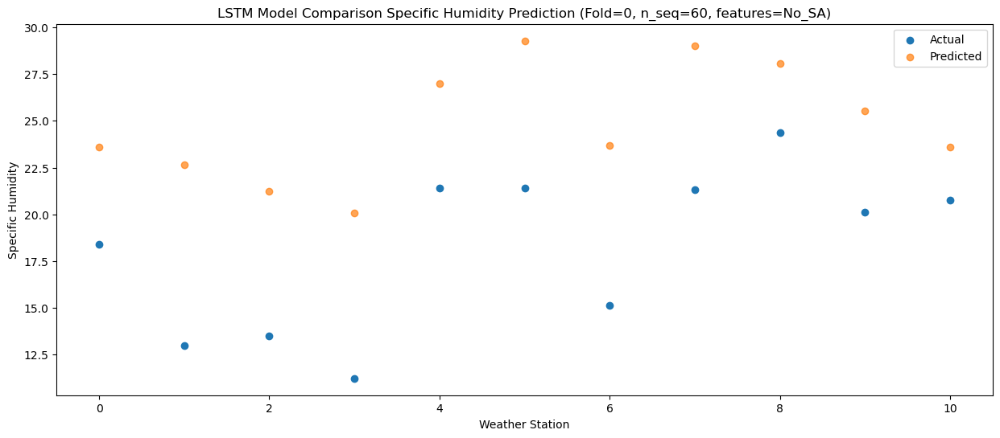

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  21.969176
1                 1   13.39  20.989165
2                 2   11.81  19.609171
3                 3   12.04  18.409172
4                 4   23.09  25.329178
5                 5   20.15  27.639165
6                 6   13.38  22.029169
7                 7   19.46  27.349164
8                 8   24.29  26.419175
9                 9   19.80  23.909170
10               10   20.00  21.969174


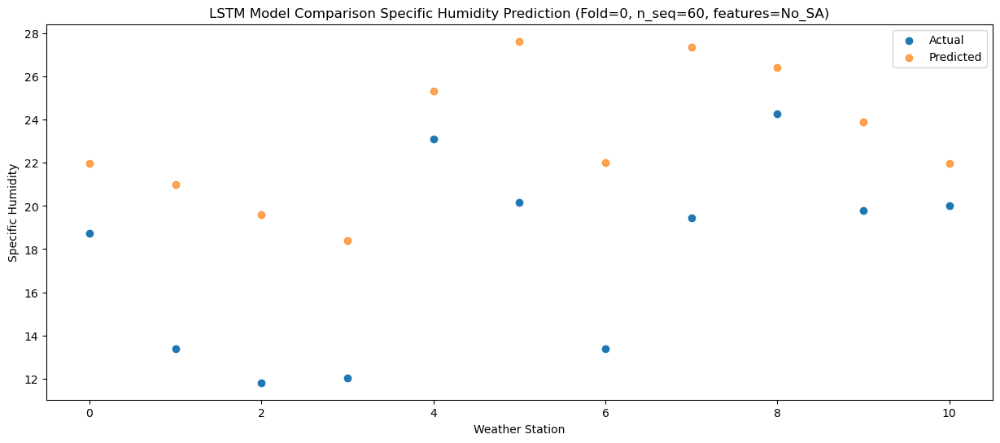

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  18.721028
1                 1   10.15  17.741017
2                 2    9.04  16.361023
3                 3    9.45  15.161024
4                 4   19.17  22.081030
5                 5   18.21  24.391017
6                 6   10.95  18.781021
7                 7   16.53  24.101016
8                 8   20.67  23.171027
9                 9   17.61  20.661022
10               10   17.22  18.721026


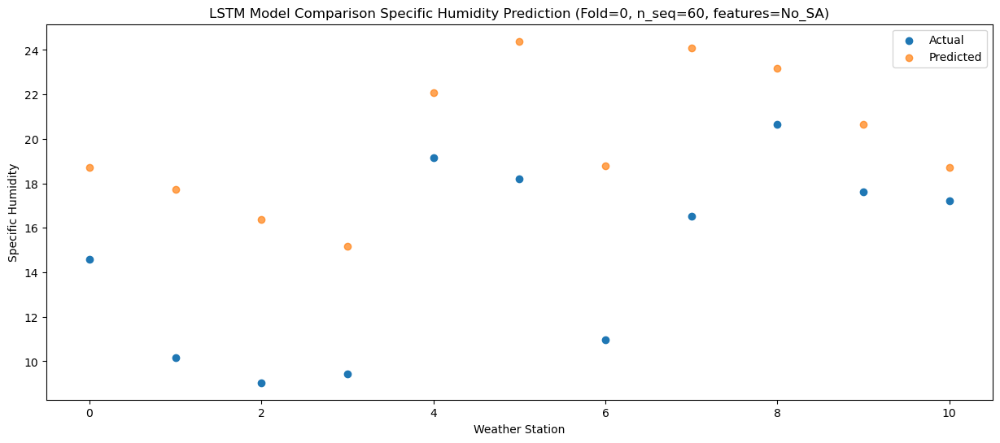

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31  12.859136
1                 1    6.83  11.879124
2                 2    3.14  10.499131
3                 3    5.31   9.299132
4                 4   16.72  16.219138
5                 5   13.18  18.529124
6                 6    5.68  12.919129
7                 7   10.70  18.239123
8                 8   15.24  17.309135
9                 9   10.87  14.799130
10               10   10.99  12.859134


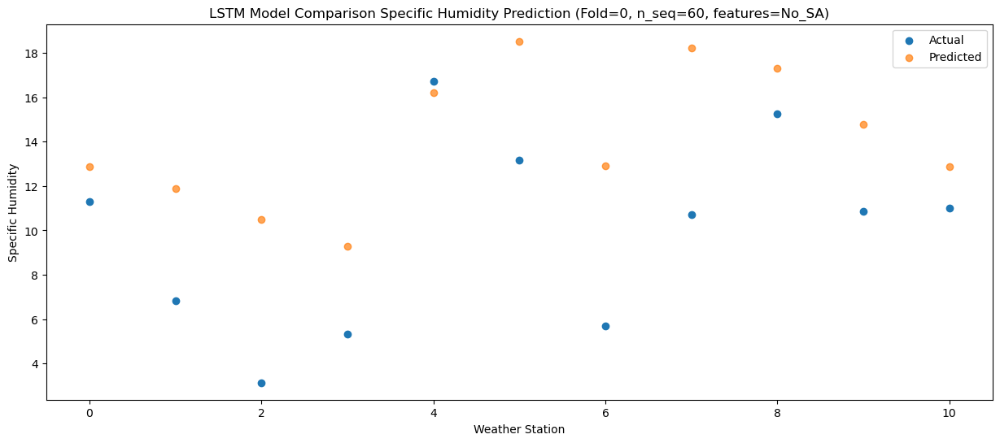

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (1, 1, 512)               4767744   
                                                                 
 dropout (Dropout)           (1, 1, 512)               0         
                                                                 
 lstm_1 (LSTM)               (1, 512)                  2099200   
                                                                 
 dropout_1 (Dropout)         (1, 512)                  0         
                                                                 
 dense (Dense)               (1, 256)                  131328    
                                                                 
 dense_1 (Dense)             (1, 128)                  32896     
                                                                 
 dense_2 (Dense)             (1, 60)                   7

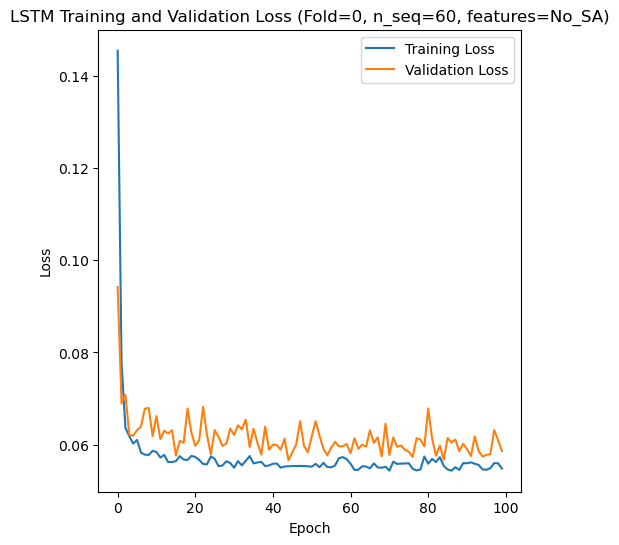

Epoch 1/100
84/84 [==============================] - 38s 163ms/step - loss: 0.1554 - accuracy: 0.1905 - mae: 0.1274 - rmse: 0.1554 - mape: inf - pearson: 0.5510 - val_loss: 0.0843 - val_accuracy: 0.2000 - val_mae: 0.0669 - val_rmse: 0.0843 - val_mape: 13.5414 - val_pearson: 0.8008
Epoch 2/100
84/84 [==============================] - 6s 73ms/step - loss: 0.0719 - accuracy: 0.4881 - mae: 0.0572 - rmse: 0.0719 - mape: inf - pearson: 0.8053 - val_loss: 0.0631 - val_accuracy: 0.6000 - val_mae: 0.0502 - val_rmse: 0.0631 - val_mape: 11.3996 - val_pearson: 0.8508
Epoch 3/100
84/84 [==============================] - 7s 79ms/step - loss: 0.0623 - accuracy: 0.4881 - mae: 0.0495 - rmse: 0.0623 - mape: inf - pearson: 0.8346 - val_loss: 0.0671 - val_accuracy: 0.0000e+00 - val_mae: 0.0521 - val_rmse: 0.0671 - val_mape: 11.7089 - val_pearson: 0.8287
Epoch 4/100
84/84 [==============================] - 7s 87ms/step - loss: 0.0611 - accuracy: 0.5476 - mae: 0.0484 - rmse: 0.0611 - mape: inf - pearson: 0.

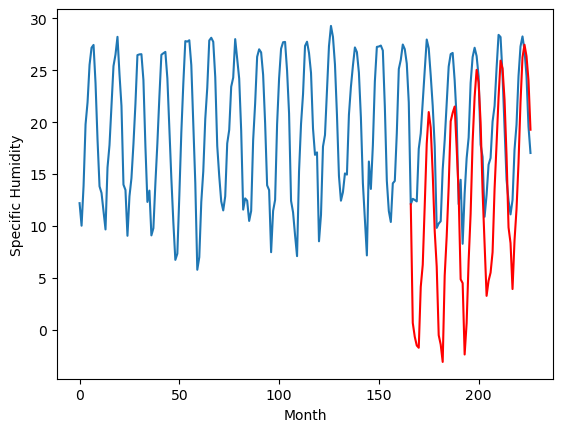

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.99		-0.75		0.24
-1.90		-2.09		-0.19
-3.01		-2.93		0.08
-2.92		-3.15		-0.23
3.08		2.72		-0.36
4.30		4.84		0.54
7.65		10.57		2.92
12.00		16.51		4.51
15.37		19.54		4.17
13.96		18.04		4.08
10.42		13.61		3.19
6.70		8.07		1.37
2.60		4.66		2.06
-4.29		-1.94		2.35
-4.49		-2.84		1.65
-3.83		-4.51		-0.68
2.94		3.79		0.85
5.08		7.56		2.48
8.81		12.37		3.56
12.95		18.65		5.70
14.33		19.46		5.13
14.60		20.07		5.47
10.86		16.11		5.25
7.08		11.70		4.62
-0.58		3.44		4.02
1.05		3.07		2.02
-5.68		-3.80		1.88
-1.45		-0.76		0.69
2.12		5.22		3.10
5.12		9.75		4.63
11.00		16.67		5.67
14.97		20.99		6.02
15.47		23.60		8.13
14.01		22.39		8.38
10.92		18.54		7.62
4.58		11.87		7.29
1.58		6.84		5.26
-4.23		1.85		6.08
-2.04		3.30		5.34
1.33		4.09		2.76
2.10		6.05		3.95
5.37		12.13		6.76
8.65		16.46		7.81
11.84		20.97		9.13
15.44		24.49		9.05
14.90		23.74		8.84
11.39		20.71		9.32
6.38		15.34		8.96
0.76		8.44		7.68
-2.38	

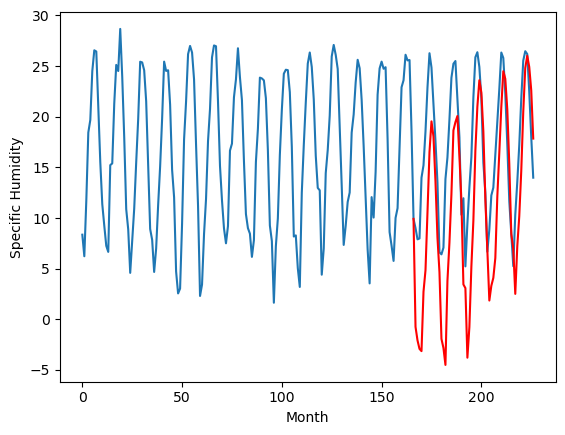

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.90		0.49		1.39
-0.47		-0.85		-0.38
-1.00		-1.69		-0.69
-0.72		-1.91		-1.19
6.38		3.96		-2.42
5.41		6.08		0.67
9.56		11.81		2.25
13.79		17.75		3.96
15.26		20.78		5.52
15.25		19.28		4.03
12.45		14.85		2.40
8.10		9.31		1.21
3.30		5.90		2.60
-3.76		-0.70		3.06
-3.34		-1.60		1.74
-2.85		-3.27		-0.42
4.21		5.03		0.82
5.61		8.80		3.19
9.73		13.61		3.88
13.61		19.89		6.28
14.38		20.70		6.32
15.04		21.31		6.27
12.02		17.35		5.33
8.24		12.94		4.70
0.50		4.68		4.18
3.10		4.31		1.21
-3.79		-2.56		1.23
-0.44		0.48		0.92
3.56		6.46		2.90
7.15		10.99		3.84
12.51		17.91		5.40
15.48		22.23		6.75
16.19		24.84		8.65
14.58		23.63		9.05
12.19		19.78		7.59
5.50		13.11		7.61
2.18		8.08		5.90
-0.98		3.09		4.07
0.02		4.54		4.52
2.61		5.33		2.72
4.04		7.29		3.25
6.73		13.37		6.64
9.97		17.70		7.73
13.72		22.21		8.49
16.09		25.73		9.64
16.53		24.98		8.45
13.57		21.95		8.38
7.53		16.58		9.05
0.97		9.68		8.71
-1.81		8

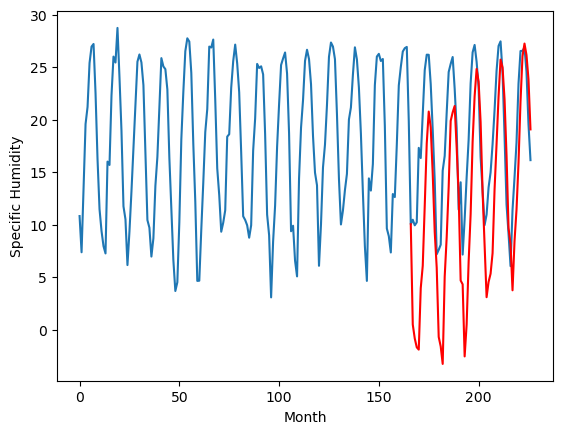

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.19		-0.48		-1.67
-0.23		-1.82		-1.59
0.52		-2.66		-3.18
-0.01		-2.88		-2.87
7.63		2.99		-4.64
7.51		5.11		-2.40
11.26		10.84		-0.42
14.04		16.78		2.74
15.69		19.81		4.12
15.93		18.31		2.38
12.52		13.88		1.36
7.98		8.34		0.36
5.08		4.93		-0.15
-1.10		-1.67		-0.57
-1.20		-2.57		-1.37
-2.79		-4.24		-1.45
4.58		4.06		-0.52
6.92		7.83		0.91
10.81		12.64		1.83
14.70		18.92		4.22
14.58		19.73		5.15
15.55		20.34		4.79
12.54		16.38		3.84
9.85		11.97		2.12
2.69		3.71		1.02
6.06		3.34		-2.72
-1.99		-3.53		-1.54
-2.46		-0.49		1.97
3.38		5.49		2.11
9.38		10.02		0.64
13.81		16.94		3.13
16.81		21.26		4.45
17.75		23.87		6.12
16.11		22.66		6.55
13.34		18.81		5.47
7.78		12.14		4.36
2.73		7.11		4.38
0.64		2.12		1.48
1.35		3.57		2.22
2.35		4.36		2.01
6.18		6.32		0.14
7.02		12.40		5.38
11.61		16.73		5.12
15.76		21.24		5.48
17.48		24.76		7.28
19.45		24.01		4.56
16.37		20.98		4.61
9.11		15.61		6.50
2.83		8.71		5.

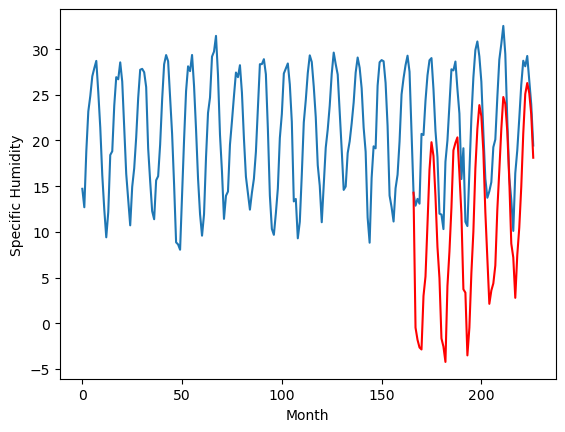

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.60		3.76		-1.84
3.71		2.42		-1.29
4.52		1.58		-2.94
4.14		1.36		-2.78
12.18		7.23		-4.95
11.92		9.35		-2.57
15.72		15.08		-0.64
18.75		21.02		2.27
20.79		24.05		3.26
21.03		22.55		1.52
17.45		18.12		0.67
12.51		12.58		0.07
9.41		9.17		-0.24
3.05		2.57		-0.48
3.04		1.67		-1.37
1.34		-0.00		-1.34
8.95		8.30		-0.65
11.25		12.07		0.82
15.37		16.88		1.51
18.84		23.16		4.32
18.93		23.97		5.04
19.90		24.58		4.68
16.32		20.62		4.30
13.28		16.21		2.93
5.73		7.95		2.22
9.61		7.58		-2.03
1.13		0.71		-0.42
0.82		3.75		2.93
6.60		9.73		3.13
12.87		14.26		1.39
17.49		21.18		3.69
20.86		25.50		4.64
21.95		28.11		6.16
19.94		26.90		6.96
16.76		23.05		6.29
11.37		16.38		5.01
6.37		11.35		4.98
4.35		6.36		2.01
4.83		7.81		2.98
6.01		8.60		2.59
9.83		10.56		0.73
10.79		16.64		5.85
15.43		20.97		5.54
20.32		25.48		5.16
22.27		29.00		6.73
23.70		28.25		4.55
19.85		25.22		5.37
12.45		19.85		7.40
6.25		12.95		6.7

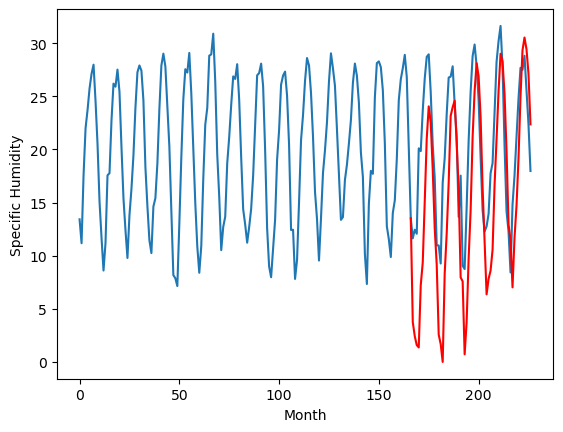

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.73		-0.09		-2.82
0.70		-1.43		-2.13
0.04		-2.27		-2.31
-0.48		-2.49		-2.01
6.87		3.38		-3.49
9.66		5.50		-4.16
14.85		11.23		-3.62
17.57		17.17		-0.40
20.27		20.20		-0.07
20.12		18.70		-1.42
12.59		14.27		1.68
9.75		8.73		-1.02
6.03		5.32		-0.71
-0.72		-1.28		-0.56
-2.23		-2.18		0.05
-1.85		-3.85		-2.00
5.49		4.45		-1.04
7.76		8.22		0.46
13.35		13.03		-0.32
17.62		19.31		1.69
16.96		20.12		3.16
16.37		20.73		4.36
16.01		16.77		0.76
11.69		12.36		0.67
5.22		4.10		-1.12
5.48		3.73		-1.75
-1.84		-3.14		-1.30
-1.95		-0.10		1.85
5.00		5.88		0.88
11.91		10.41		-1.50
17.31		17.33		0.02
19.37		21.65		2.28
20.29		24.26		3.97
17.44		23.05		5.61
14.39		19.20		4.81
8.31		12.53		4.22
1.35		7.50		6.15
0.23		2.51		2.28
0.69		3.96		3.27
0.83		4.75		3.92
5.89		6.71		0.82
9.05		12.79		3.74
13.66		17.12		3.46
20.35		21.63		1.28
21.45		25.15		3.70
20.64		24.40		3.76
18.36		21.37		3.01
10.76		16.00		5.24
4.10		

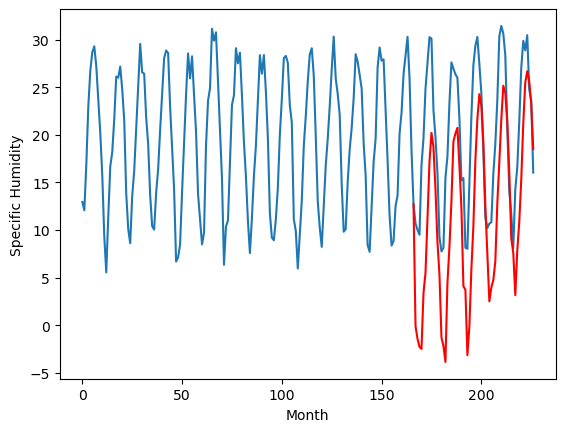

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.75		2.38		0.63
1.02		1.04		0.02
0.21		0.20		-0.01
0.28		-0.02		-0.30
5.95		5.85		-0.10
7.58		7.97		0.39
10.36		13.70		3.34
15.03		19.64		4.61
18.21		22.67		4.46
16.58		21.17		4.59
13.16		16.74		3.58
9.67		11.20		1.53
5.52		7.79		2.27
-1.69		1.19		2.88
-1.89		0.29		2.18
-1.11		-1.38		-0.27
5.17		6.92		1.75
7.74		10.69		2.95
11.51		15.50		3.99
15.52		21.78		6.26
16.88		22.59		5.71
17.14		23.20		6.06
13.81		19.24		5.43
9.86		14.83		4.97
2.26		6.57		4.31
3.78		6.20		2.42
-2.61		-0.67		1.94
1.20		2.37		1.17
5.04		8.35		3.31
7.80		12.88		5.08
13.72		19.80		6.08
17.30		24.12		6.82
18.04		26.73		8.69
16.54		25.52		8.98
13.65		21.67		8.02
7.31		15.00		7.69
4.42		9.97		5.55
-1.59		4.98		6.57
0.54		6.43		5.89
4.13		7.22		3.09
4.80		9.18		4.38
8.06		15.26		7.20
11.06		19.59		8.53
14.34		24.10		9.76
17.79		27.62		9.83
17.37		26.87		9.50
14.20		23.84		9.64
9.19		18.47		9.28
3.50		11.57		8.07
0.76		10.06	

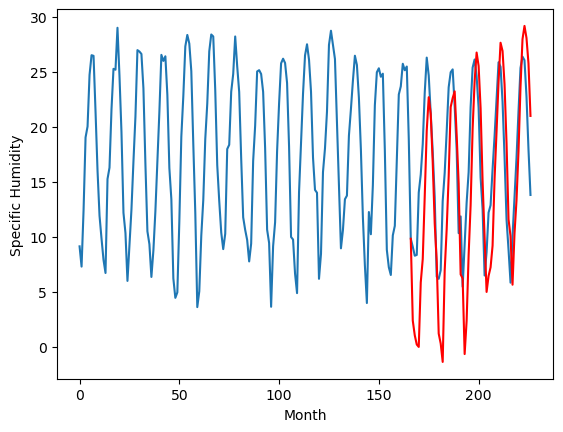

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.51		6.27		-0.24
5.89		4.93		-0.96
5.04		4.09		-0.95
5.72		3.87		-1.85
12.64		9.74		-2.90
13.78		11.86		-1.92
18.28		17.59		-0.69
23.84		23.53		-0.31
26.38		26.56		0.18
24.36		25.06		0.70
21.06		20.63		-0.43
14.29		15.09		0.80
10.62		11.68		1.06
4.02		5.08		1.06
3.71		4.18		0.47
0.71		2.51		1.80
12.03		10.81		-1.22
13.74		14.58		0.84
18.40		19.39		0.99
24.48		25.67		1.19
25.47		26.48		1.01
26.69		27.09		0.40
22.98		23.13		0.15
17.78		18.72		0.94
8.48		10.46		1.98
10.89		10.09		-0.80
2.06		3.22		1.16
4.11		6.26		2.15
10.06		12.24		2.18
15.25		16.77		1.52
20.72		23.69		2.97
24.78		28.01		3.23
28.91		30.62		1.71
26.04		29.41		3.37
22.20		25.56		3.36
15.53		18.89		3.36
8.93		13.86		4.93
5.19		8.87		3.68
6.38		10.32		3.94
7.88		11.11		3.23
10.71		13.07		2.36
15.11		19.15		4.04
20.46		23.48		3.02
24.27		27.99		3.72
26.57		31.51		4.94
27.07		30.76		3.69
23.45		27.73		4.28
17.14		22.36		5.22
9.74		1

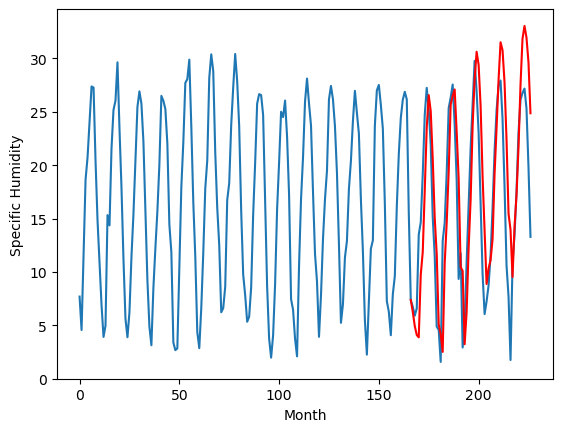

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.17		4.98		-1.19
4.32		3.64		-0.68
4.50		2.80		-1.70
3.99		2.58		-1.41
11.82		8.45		-3.37
13.20		10.57		-2.63
19.31		16.30		-3.01
24.42		22.24		-2.18
26.96		25.27		-1.69
26.03		23.77		-2.26
19.38		19.34		-0.04
13.20		13.80		0.60
10.32		10.39		0.07
3.64		3.79		0.15
3.29		2.89		-0.40
-1.49		1.22		2.71
11.07		9.52		-1.55
12.87		13.29		0.42
17.68		18.10		0.42
23.71		24.38		0.67
25.22		25.19		-0.03
25.61		25.80		0.19
23.10		21.84		-1.26
16.85		17.43		0.58
9.10		9.17		0.07
8.29		8.80		0.51
0.67		1.93		1.26
1.65		4.97		3.32
8.90		10.95		2.05
16.01		15.48		-0.53
21.37		22.40		1.03
25.66		26.72		1.06
29.81		29.33		-0.48
27.14		28.12		0.98
23.31		24.27		0.96
15.08		17.60		2.52
7.23		12.57		5.34
3.60		7.58		3.98
4.46		9.03		4.57
4.83		9.82		4.99
9.26		11.78		2.52
13.59		17.86		4.27
19.28		22.19		2.91
24.21		26.70		2.49
27.09		30.22		3.13
28.90		29.47		0.57
24.26		26.44		2.18
15.68		21.07		5.39
8.56		14

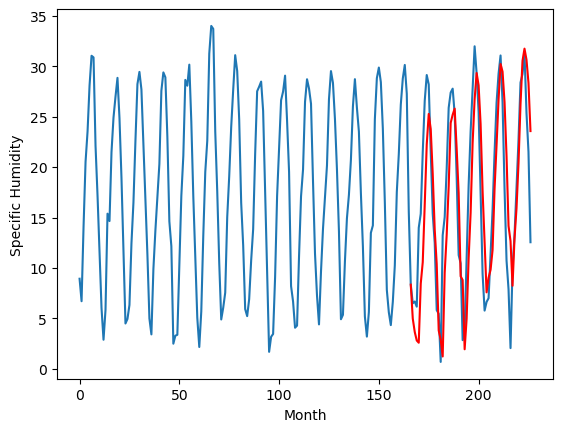

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
8.70		4.51		-4.19
7.34		3.17		-4.17
6.89		2.33		-4.56
5.65		2.11		-3.54
13.61		7.98		-5.63
15.92		10.10		-5.82
22.45		15.83		-6.62
28.83		21.77		-7.06
30.41		24.80		-5.61
29.18		23.30		-5.88
22.43		18.87		-3.56
15.83		13.33		-2.50
12.65		9.92		-2.73
5.38		3.32		-2.06
5.49		2.42		-3.07
1.12		0.75		-0.37
11.83		9.05		-2.78
15.59		12.82		-2.77
20.14		17.63		-2.51
27.25		23.91		-3.34
27.92		24.72		-3.20
27.77		25.33		-2.44
25.82		21.37		-4.45
18.38		16.96		-1.42
12.13		8.70		-3.43
10.52		8.33		-2.19
3.60		1.46		-2.14
3.66		4.50		0.84
10.59		10.48		-0.11
17.07		15.01		-2.06
22.52		21.93		-0.59
27.09		26.25		-0.84
30.69		28.86		-1.83
27.86		27.65		-0.21
25.45		23.80		-1.65
16.91		17.13		0.22
7.92		12.10		4.18
5.57		7.11		1.54
5.85		8.56		2.71
7.00		9.35		2.35
10.73		11.31		0.58
16.08		17.39		1.31
21.19		21.72		0.53
24.42		26.23		1.81
29.04		29.75		0.71
29.44		29.00		-0.44
25.92		25.97		0.05
17.82	

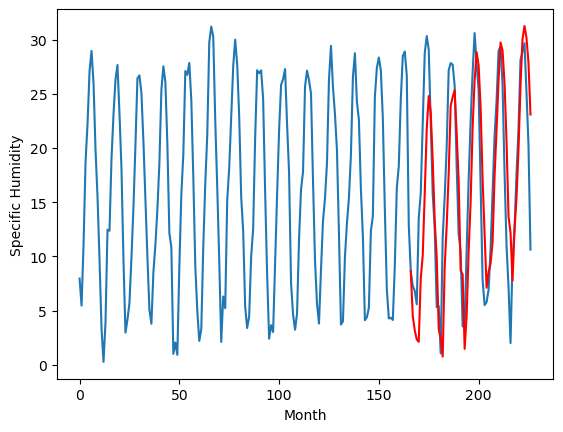

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.40		0.68		1.08
-3.21		-0.66		2.55
-2.87		-1.50		1.37
-2.13		-1.72		0.41
2.19		4.15		1.96
3.82		6.27		2.45
9.28		12.00		2.72
16.60		17.94		1.34
20.47		20.97		0.50
18.28		19.47		1.19
13.75		15.04		1.29
8.21		9.50		1.29
4.01		6.09		2.08
-3.00		-0.51		2.49
-4.84		-1.41		3.43
-5.80		-3.08		2.72
1.42		5.22		3.80
6.07		8.99		2.92
10.61		13.80		3.19
16.70		20.08		3.38
18.93		20.89		1.96
18.71		21.50		2.79
15.01		17.54		2.53
10.59		13.13		2.54
1.27		4.87		3.60
0.50		4.50		4.00
-6.52		-2.37		4.15
-2.62		0.67		3.29
1.94		6.65		4.71
5.29		11.18		5.89
12.27		18.10		5.83
16.66		22.42		5.76
20.60		25.03		4.43
20.06		23.82		3.76
15.15		19.97		4.82
7.05		13.30		6.25
3.54		8.27		4.73
-3.61		3.28		6.89
-0.65		4.73		5.38
-0.97		5.52		6.49
0.15		7.48		7.33
7.37		13.56		6.19
9.93		17.89		7.96
14.30		22.40		8.10
19.44		25.92		6.48
17.70		25.17		7.47
14.51		22.14		7.63
9.16		16.77		7.61
1.22		9.87		8.65
-0.47		8

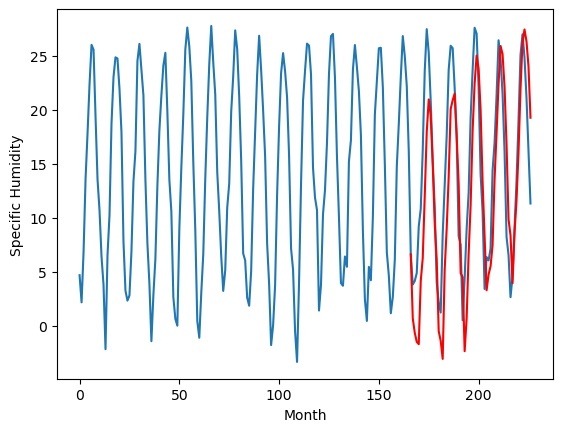

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[0.67541706085205, -0.7545829391479488, 0.4854170608520505, -0.48458293914794925, 3.75541706085205, -0.09458293914794957, 2.375417060852051, 6.265417060852052, 4.975417060852051, 4.50541706085205, 0.67541706085205]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   0.675417
1                 1   -0.99  -0.754583
2                 2   -0.90   0.485417
3                 3    1.19  -0.484583
4                 4    5.60   3.755417
5                 5    2.73  -0.094583
6                 6    1.75   2.375417
7                 7    6.51   6.265417
8                 8    6.17   4.975417
9                 9    8.70   4.505417
10               10   -0.40   0.675417


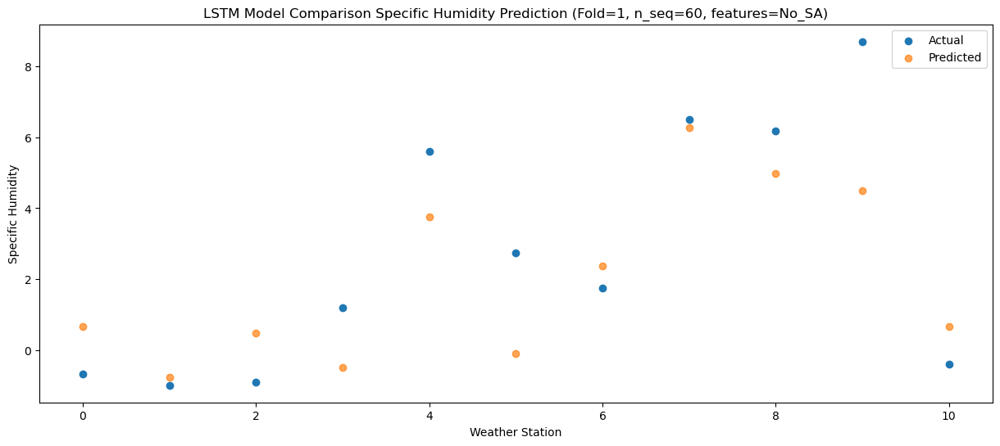

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -0.658495
1                 1   -1.90  -2.088495
2                 2   -0.47  -0.848495
3                 3   -0.23  -1.818495
4                 4    3.71   2.421505
5                 5    0.70  -1.428495
6                 6    1.02   1.041505
7                 7    5.89   4.931505
8                 8    4.32   3.641505
9                 9    7.34   3.171505
10               10   -3.21  -0.658495


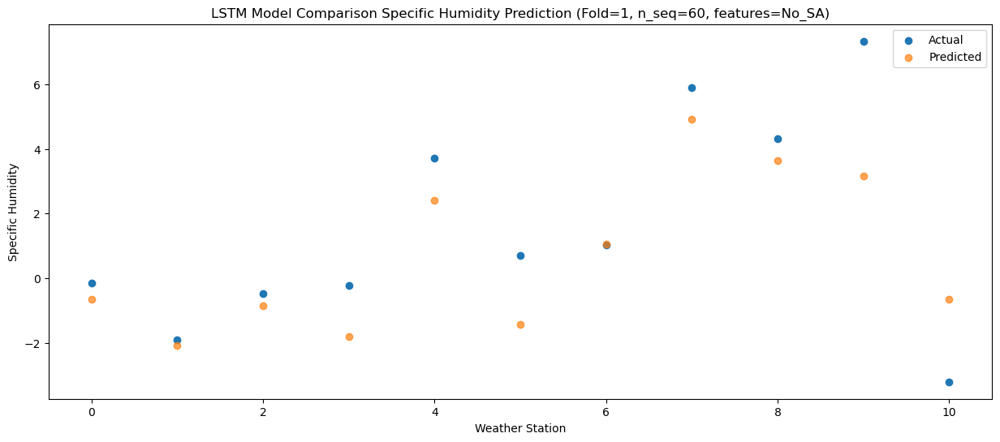

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -1.498523
1                 1   -3.01  -2.928523
2                 2   -1.00  -1.688523
3                 3    0.52  -2.658523
4                 4    4.52   1.581477
5                 5    0.04  -2.268523
6                 6    0.21   0.201477
7                 7    5.04   4.091477
8                 8    4.50   2.801477
9                 9    6.89   2.331477
10               10   -2.87  -1.498523


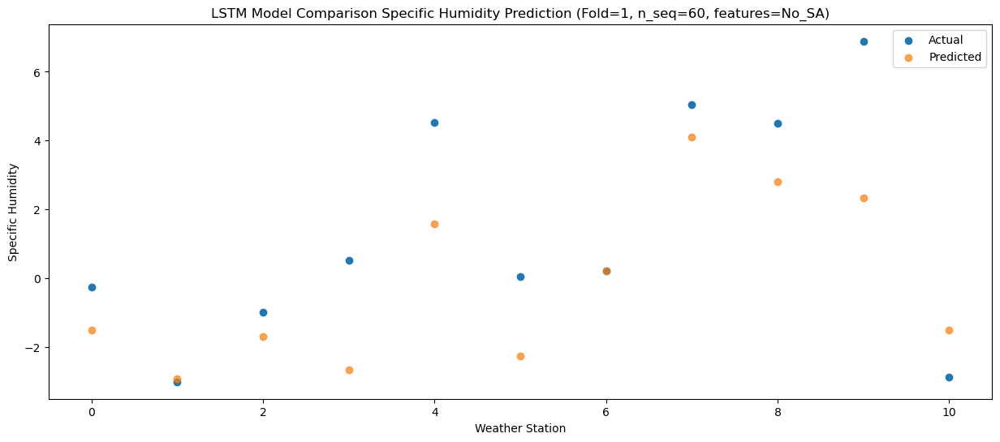

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -1.717595
1                 1   -2.92  -3.147595
2                 2   -0.72  -1.907595
3                 3   -0.01  -2.877595
4                 4    4.14   1.362405
5                 5   -0.48  -2.487595
6                 6    0.28  -0.017595
7                 7    5.72   3.872405
8                 8    3.99   2.582405
9                 9    5.65   2.112405
10               10   -2.13  -1.717595


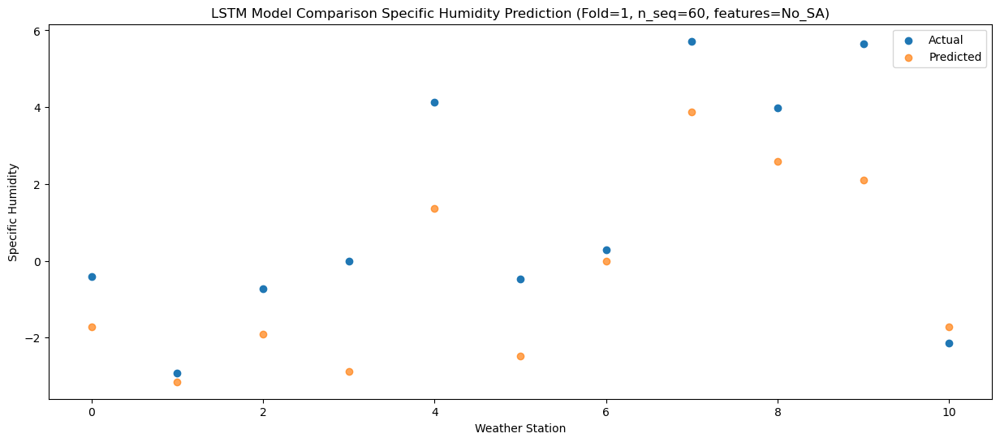

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   4.145201
1                 1    3.08   2.715201
2                 2    6.38   3.955201
3                 3    7.63   2.985201
4                 4   12.18   7.225201
5                 5    6.87   3.375201
6                 6    5.95   5.845201
7                 7   12.64   9.735201
8                 8   11.82   8.445201
9                 9   13.61   7.975201
10               10    2.19   4.145201


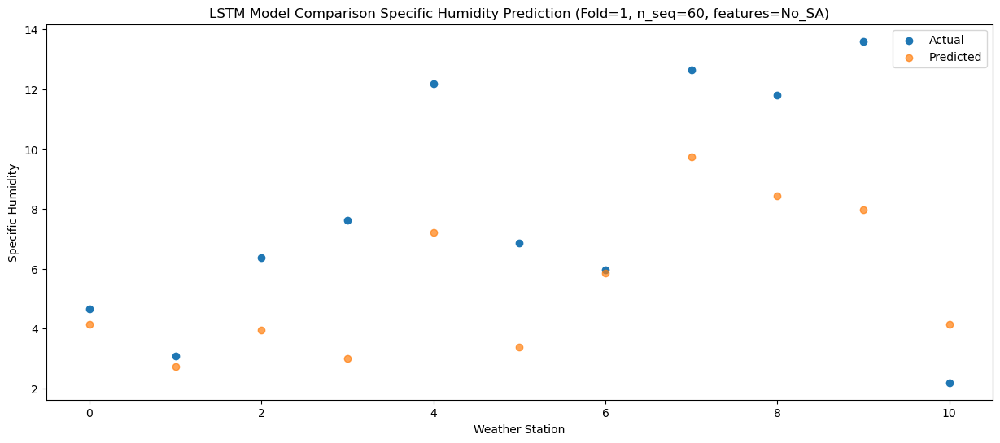

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   6.266475
1                 1    4.30   4.836477
2                 2    5.41   6.076475
3                 3    7.51   5.106477
4                 4   11.92   9.346475
5                 5    9.66   5.496475
6                 6    7.58   7.966475
7                 7   13.78  11.856475
8                 8   13.20  10.566475
9                 9   15.92  10.096475
10               10    3.82   6.266475


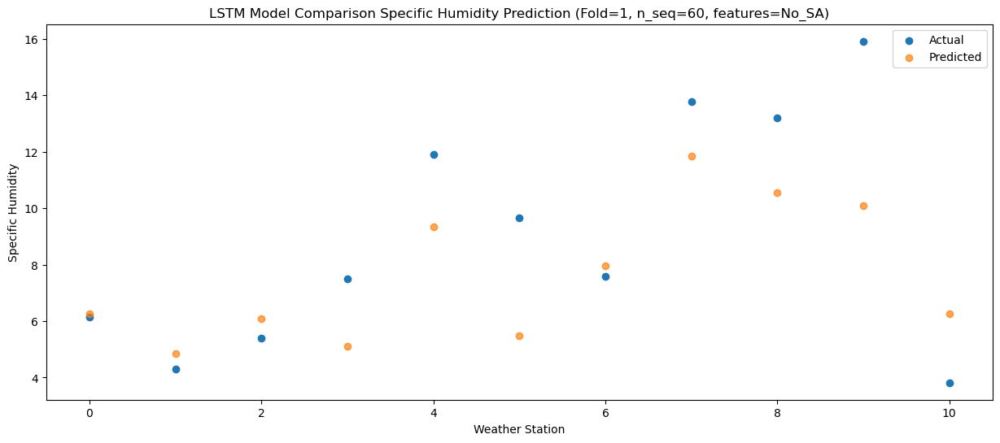

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  12.001148
1                 1    7.65  10.571150
2                 2    9.56  11.811148
3                 3   11.26  10.841150
4                 4   15.72  15.081148
5                 5   14.85  11.231148
6                 6   10.36  13.701148
7                 7   18.28  17.591148
8                 8   19.31  16.301148
9                 9   22.45  15.831148
10               10    9.28  12.001148


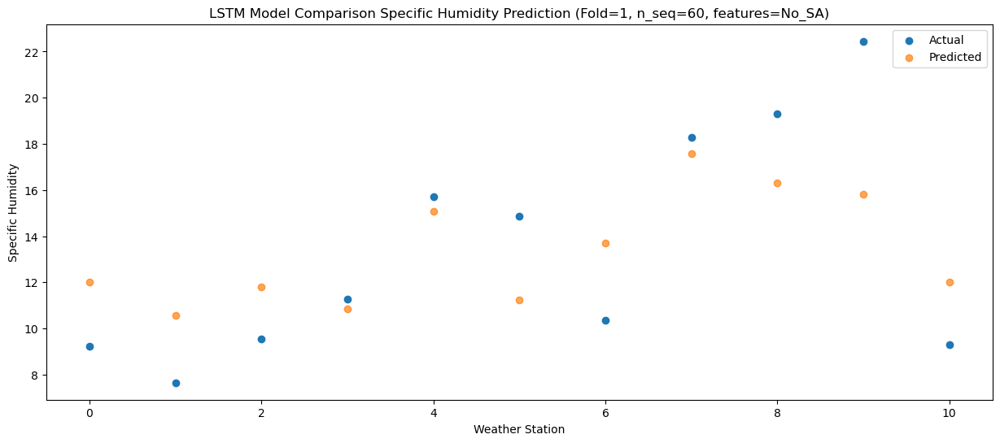

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  17.936170
1                 1   12.00  16.506173
2                 2   13.79  17.746170
3                 3   14.04  16.776173
4                 4   18.75  21.016170
5                 5   17.57  17.166170
6                 6   15.03  19.636170
7                 7   23.84  23.526170
8                 8   24.42  22.236170
9                 9   28.83  21.766170
10               10   16.60  17.936170


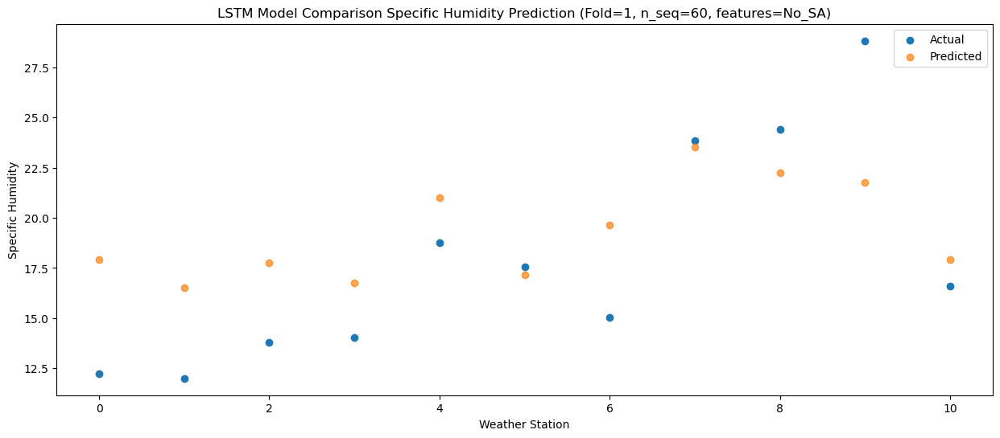

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  20.969972
1                 1   15.37  19.539974
2                 2   15.26  20.779972
3                 3   15.69  19.809974
4                 4   20.79  24.049972
5                 5   20.27  20.199972
6                 6   18.21  22.669972
7                 7   26.38  26.559972
8                 8   26.96  25.269972
9                 9   30.41  24.799972
10               10   20.47  20.969972


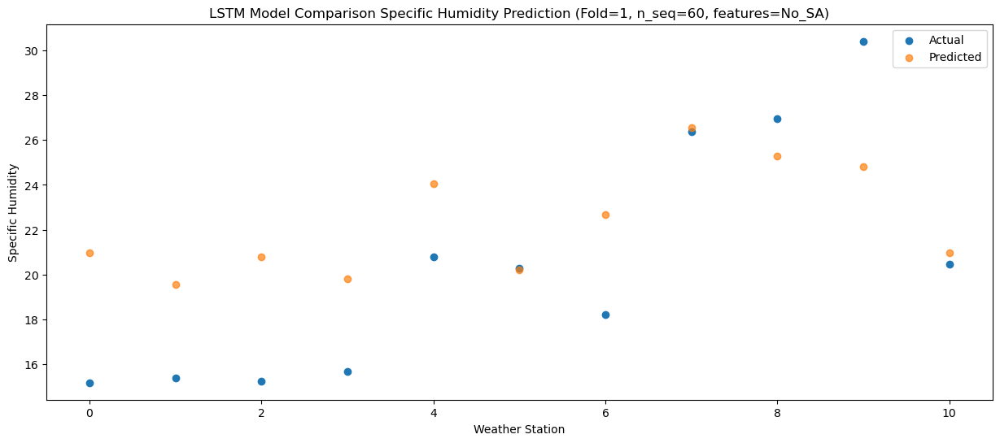

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  19.470309
1                 1   13.96  18.040311
2                 2   15.25  19.280309
3                 3   15.93  18.310311
4                 4   21.03  22.550309
5                 5   20.12  18.700309
6                 6   16.58  21.170309
7                 7   24.36  25.060309
8                 8   26.03  23.770309
9                 9   29.18  23.300309
10               10   18.28  19.470309


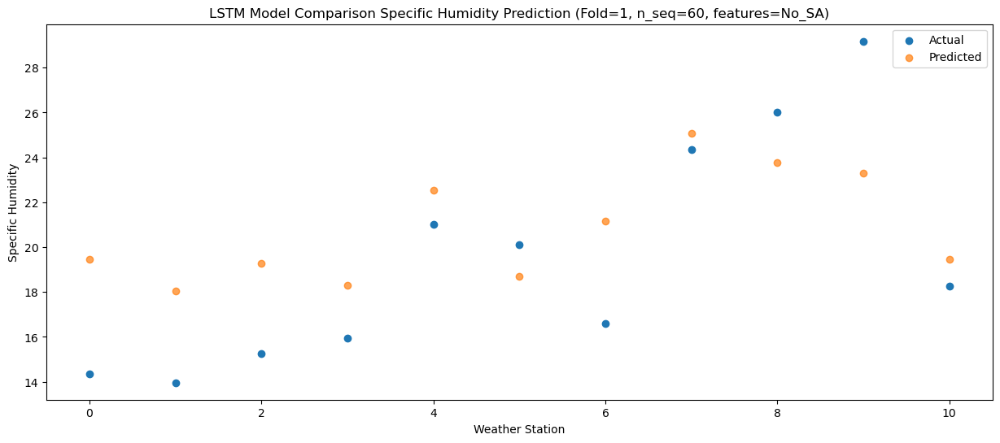

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  15.044013
1                 1   10.42  13.614014
2                 2   12.45  14.854012
3                 3   12.52  13.884014
4                 4   17.45  18.124012
5                 5   12.59  14.274013
6                 6   13.16  16.744012
7                 7   21.06  20.634013
8                 8   19.38  19.344013
9                 9   22.43  18.874013
10               10   13.75  15.044013


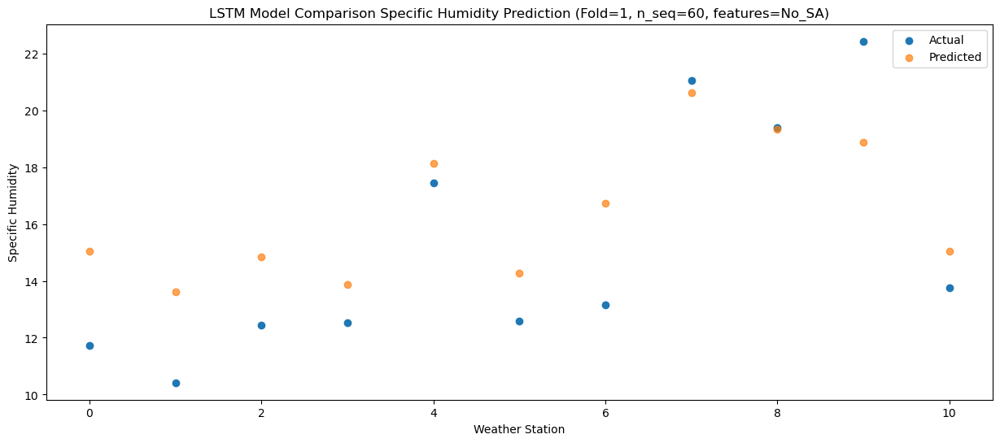

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   9.504105
1                 1    6.70   8.074106
2                 2    8.10   9.314104
3                 3    7.98   8.344106
4                 4   12.51  12.584104
5                 5    9.75   8.734105
6                 6    9.67  11.204104
7                 7   14.29  15.094105
8                 8   13.20  13.804105
9                 9   15.83  13.334105
10               10    8.21   9.504105


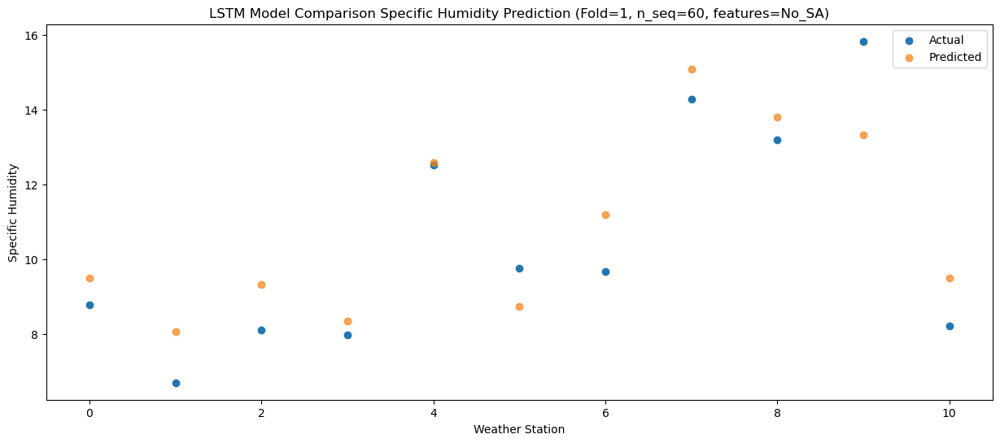

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   6.088616
1                 1    2.60   4.658618
2                 2    3.30   5.898616
3                 3    5.08   4.928618
4                 4    9.41   9.168616
5                 5    6.03   5.318617
6                 6    5.52   7.788616
7                 7   10.62  11.678617
8                 8   10.32  10.388617
9                 9   12.65   9.918617
10               10    4.01   6.088617


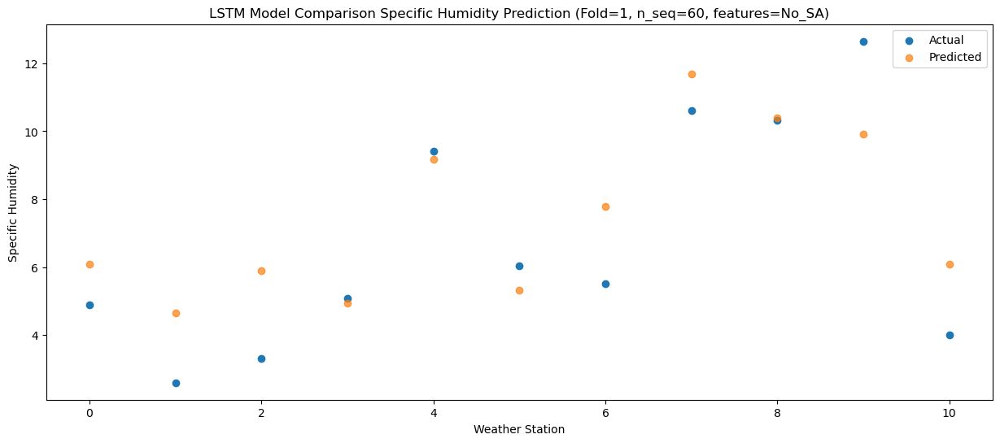

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -0.507866
1                 1   -4.29  -1.937864
2                 2   -3.76  -0.697866
3                 3   -1.10  -1.667864
4                 4    3.05   2.572134
5                 5   -0.72  -1.277865
6                 6   -1.69   1.192135
7                 7    4.02   5.082135
8                 8    3.64   3.792135
9                 9    5.38   3.322135
10               10   -3.00  -0.507865


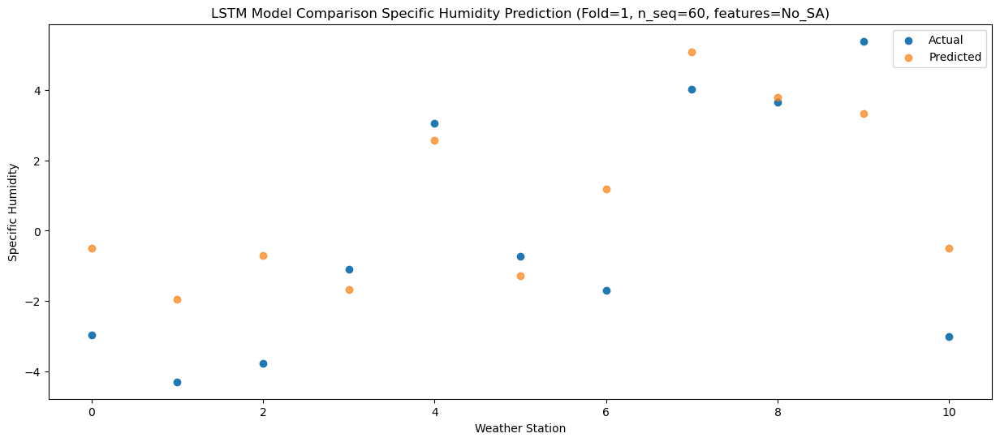

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -1.409046
1                 1   -4.49  -2.839044
2                 2   -3.34  -1.599046
3                 3   -1.20  -2.569044
4                 4    3.04   1.670954
5                 5   -2.23  -2.179045
6                 6   -1.89   0.290955
7                 7    3.71   4.180955
8                 8    3.29   2.890955
9                 9    5.49   2.420955
10               10   -4.84  -1.409045


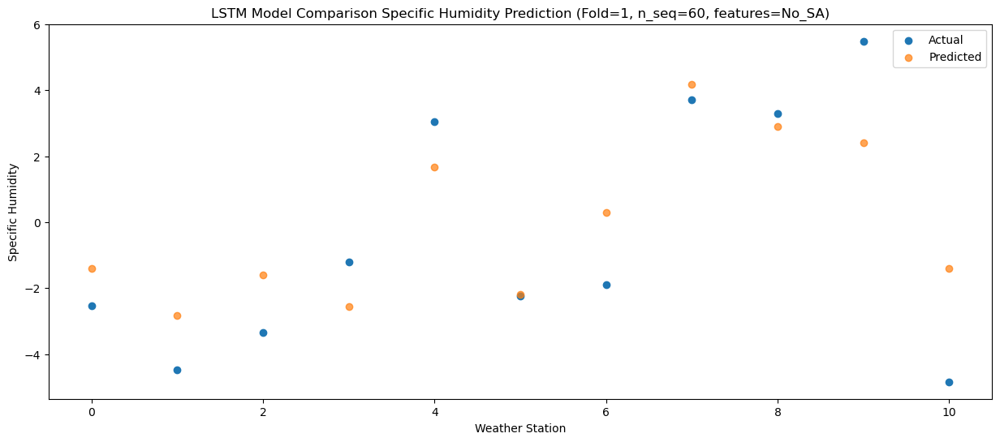

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -3.080560
1                 1   -3.83  -4.510558
2                 2   -2.85  -3.270561
3                 3   -2.79  -4.240558
4                 4    1.34  -0.000560
5                 5   -1.85  -3.850559
6                 6   -1.11  -1.380559
7                 7    0.71   2.509441
8                 8   -1.49   1.219440
9                 9    1.12   0.749441
10               10   -5.80  -3.080559


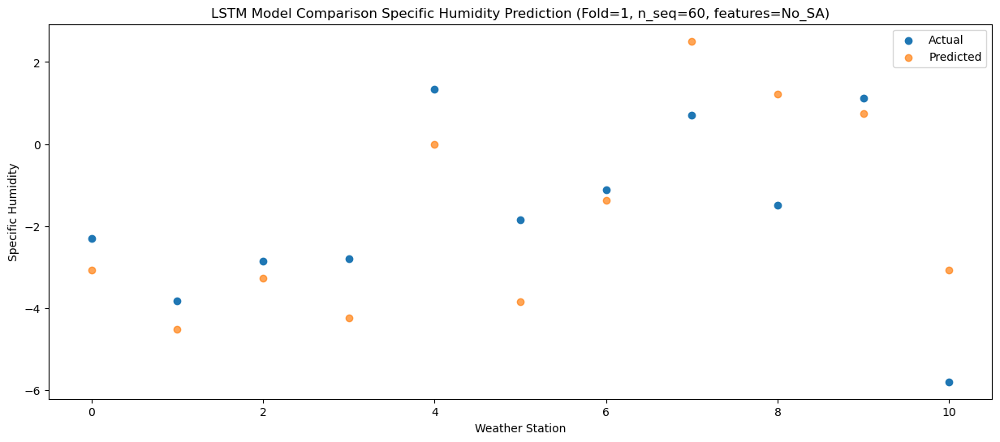

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   5.223263
1                 1    2.94   3.793265
2                 2    4.21   5.033262
3                 3    4.58   4.063265
4                 4    8.95   8.303263
5                 5    5.49   4.453264
6                 6    5.17   6.923264
7                 7   12.03  10.813264
8                 8   11.07   9.523263
9                 9   11.83   9.053264
10               10    1.42   5.223264


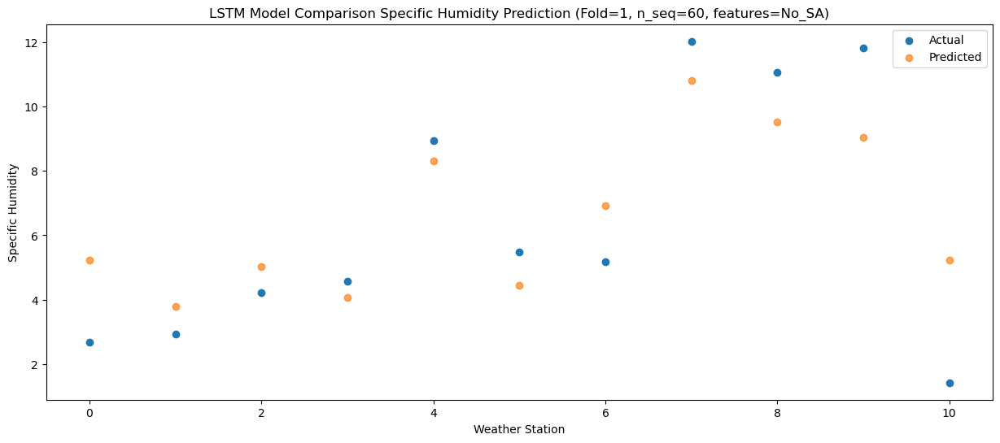

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   8.990003
1                 1    5.08   7.560005
2                 2    5.61   8.800002
3                 3    6.92   7.830005
4                 4   11.25  12.070003
5                 5    7.76   8.220004
6                 6    7.74  10.690004
7                 7   13.74  14.580004
8                 8   12.87  13.290003
9                 9   15.59  12.820004
10               10    6.07   8.990004


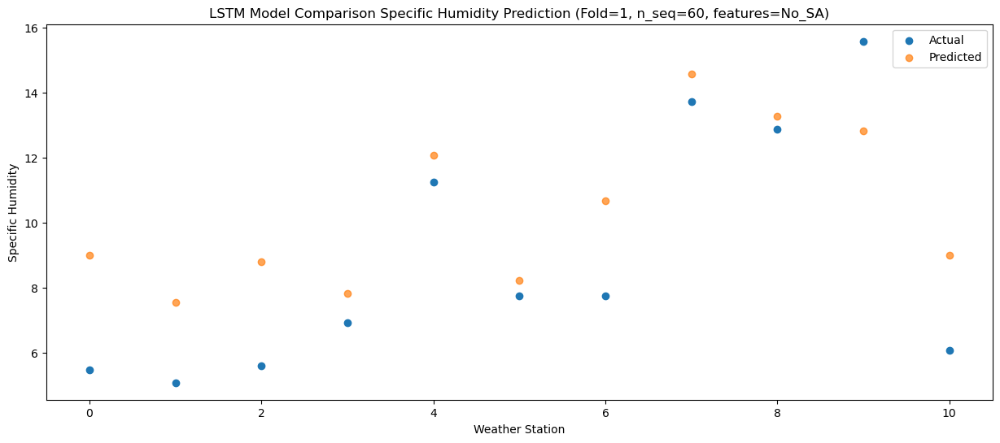

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  13.796684
1                 1    8.81  12.366686
2                 2    9.73  13.606683
3                 3   10.81  12.636686
4                 4   15.37  16.876684
5                 5   13.35  13.026685
6                 6   11.51  15.496685
7                 7   18.40  19.386685
8                 8   17.68  18.096684
9                 9   20.14  17.626685
10               10   10.61  13.796685


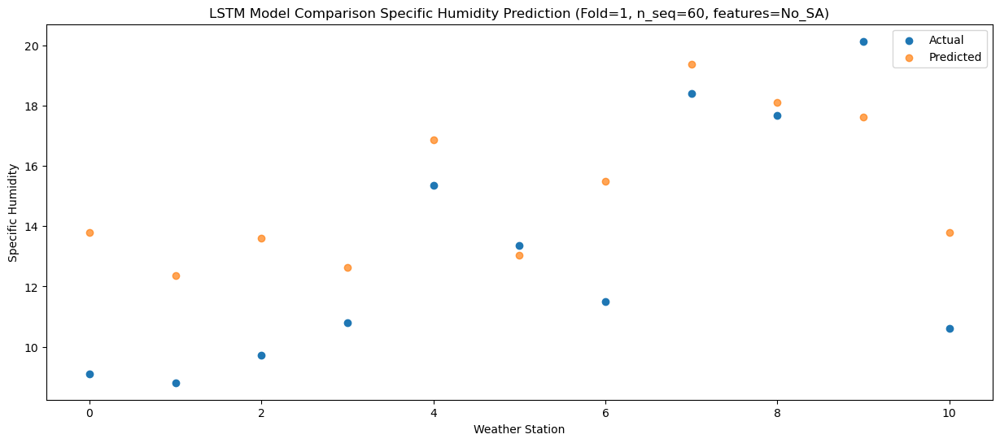

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  20.081317
1                 1   12.95  18.651320
2                 2   13.61  19.891316
3                 3   14.70  18.921320
4                 4   18.84  23.161317
5                 5   17.62  19.311318
6                 6   15.52  21.781318
7                 7   24.48  25.671318
8                 8   23.71  24.381317
9                 9   27.25  23.911318
10               10   16.70  20.081318


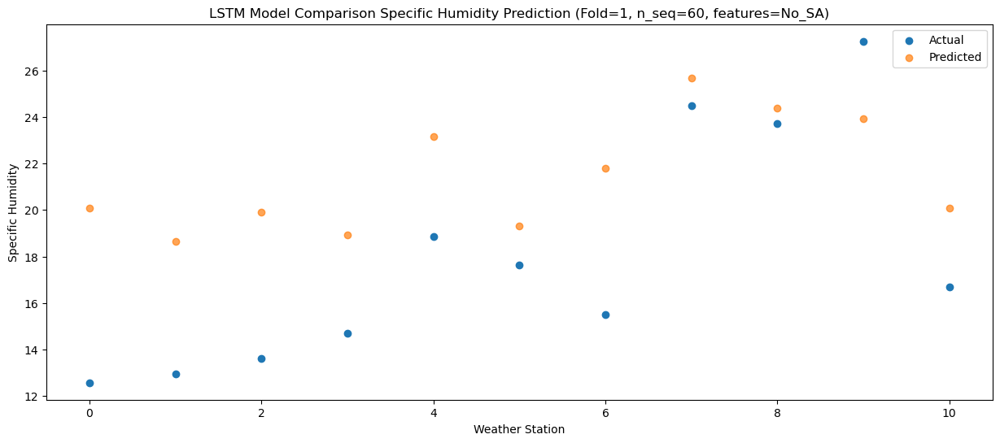

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  20.892721
1                 1   14.33  19.462723
2                 2   14.38  20.702720
3                 3   14.58  19.732723
4                 4   18.93  23.972721
5                 5   16.96  20.122722
6                 6   16.88  22.592722
7                 7   25.47  26.482722
8                 8   25.22  25.192721
9                 9   27.92  24.722722
10               10   18.93  20.892722


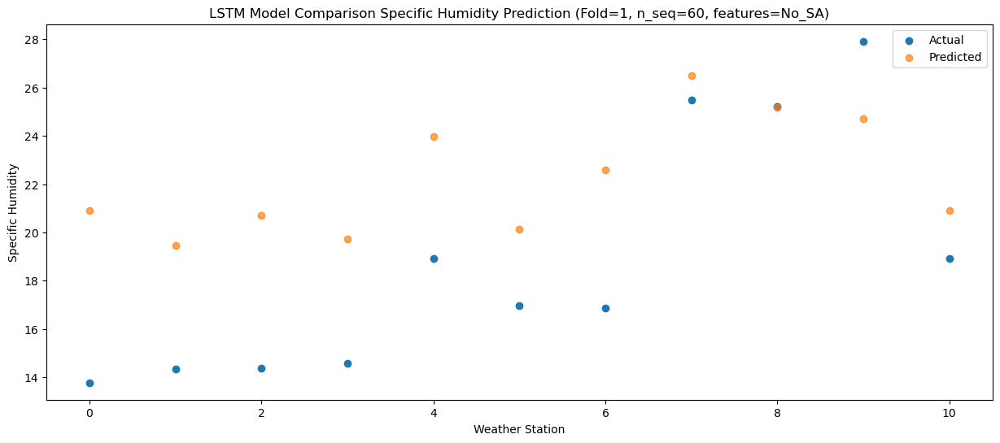

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  21.502174
1                 1   14.60  20.072176
2                 2   15.04  21.312173
3                 3   15.55  20.342176
4                 4   19.90  24.582174
5                 5   16.37  20.732175
6                 6   17.14  23.202175
7                 7   26.69  27.092175
8                 8   25.61  25.802174
9                 9   27.77  25.332175
10               10   18.71  21.502175


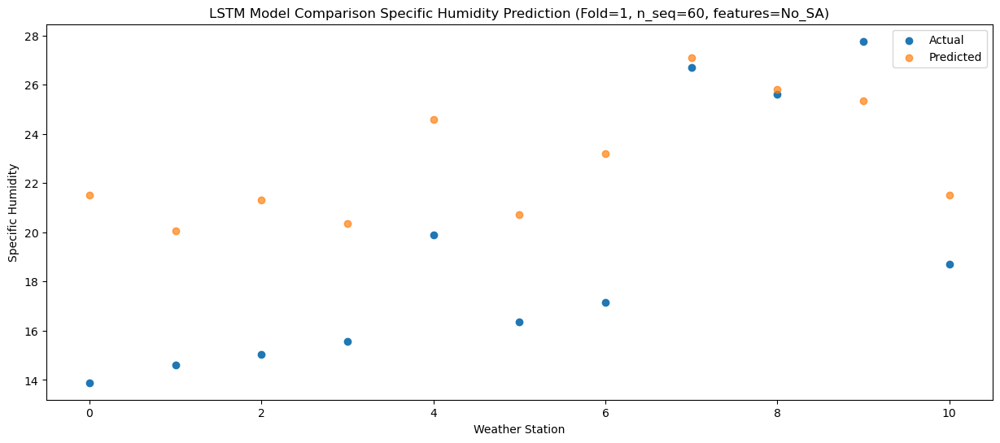

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  17.540375
1                 1   10.86  16.110378
2                 2   12.02  17.350374
3                 3   12.54  16.380378
4                 4   16.32  20.620375
5                 5   16.01  16.770376
6                 6   13.81  19.240376
7                 7   22.98  23.130376
8                 8   23.10  21.840375
9                 9   25.82  21.370376
10               10   15.01  17.540376


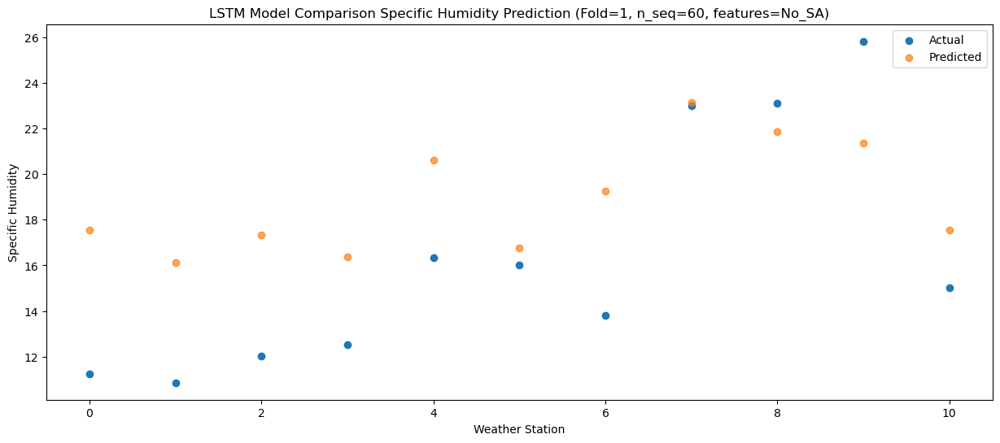

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  13.128259
1                 1    7.08  11.698262
2                 2    8.24  12.938258
3                 3    9.85  11.968262
4                 4   13.28  16.208259
5                 5   11.69  12.358260
6                 6    9.86  14.828260
7                 7   17.78  18.718260
8                 8   16.85  17.428259
9                 9   18.38  16.958260
10               10   10.59  13.128260


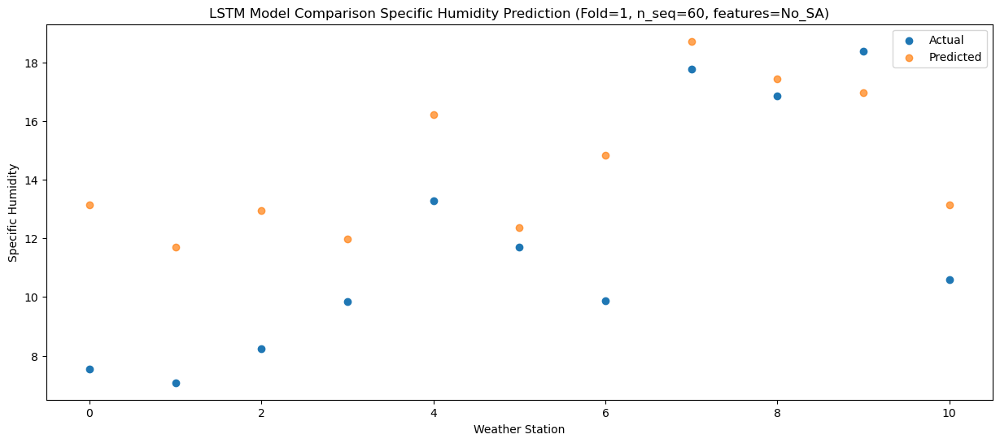

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   4.869635
1                 1   -0.58   3.439637
2                 2    0.50   4.679634
3                 3    2.69   3.709637
4                 4    5.73   7.949635
5                 5    5.22   4.099636
6                 6    2.26   6.569636
7                 7    8.48  10.459636
8                 8    9.10   9.169635
9                 9   12.13   8.699636
10               10    1.27   4.869636


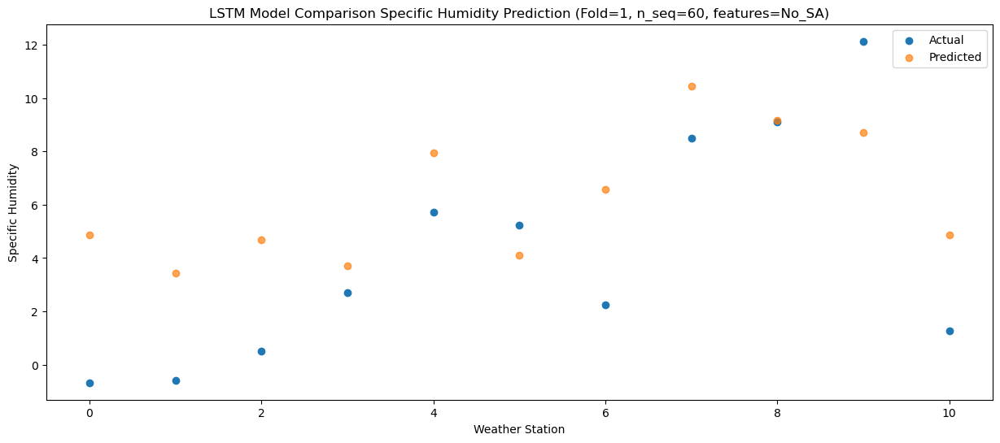

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   4.504794
1                 1    1.05   3.074796
2                 2    3.10   4.314793
3                 3    6.06   3.344796
4                 4    9.61   7.584794
5                 5    5.48   3.734795
6                 6    3.78   6.204796
7                 7   10.89  10.094795
8                 8    8.29   8.804794
9                 9   10.52   8.334795
10               10    0.50   4.504795


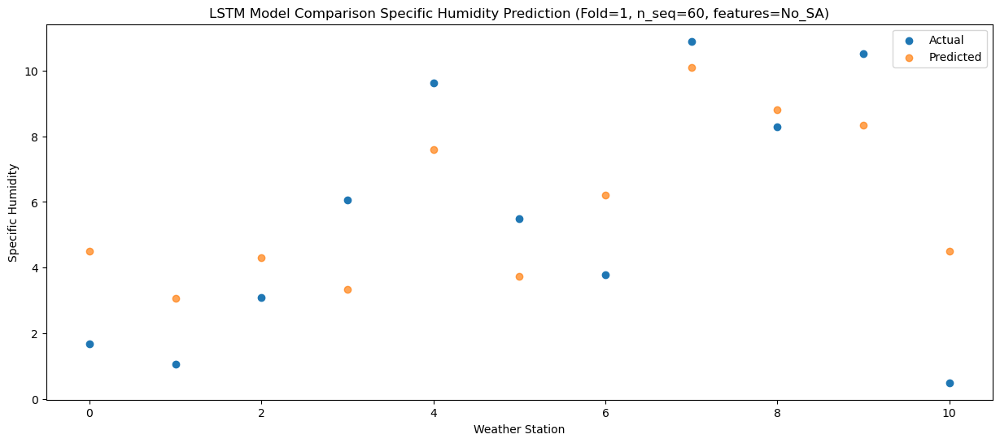

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -2.366566
1                 1   -5.68  -3.796564
2                 2   -3.79  -2.556567
3                 3   -1.99  -3.526564
4                 4    1.13   0.713434
5                 5   -1.84  -3.136565
6                 6   -2.61  -0.666564
7                 7    2.06   3.223435
8                 8    0.67   1.933434
9                 9    3.60   1.463435
10               10   -6.52  -2.366565


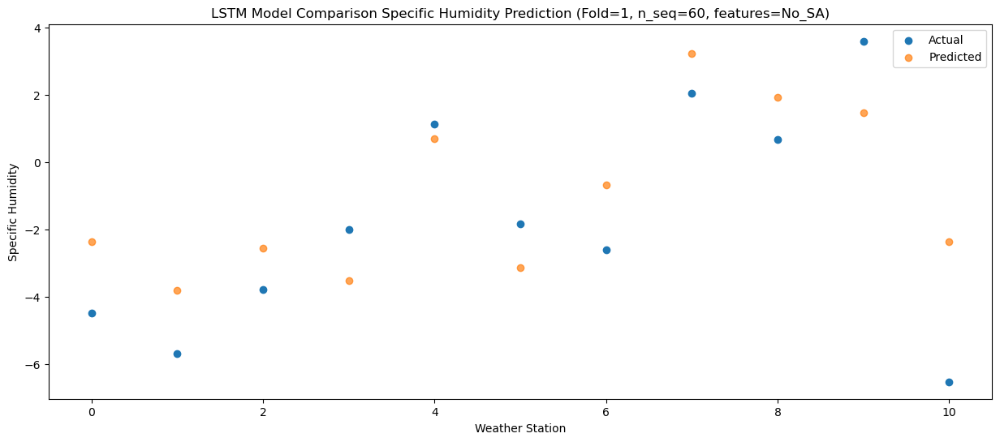

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36   0.669169
1                 1   -1.45  -0.760829
2                 2   -0.44   0.479167
3                 3   -2.46  -0.490829
4                 4    0.82   3.749169
5                 5   -1.95  -0.100830
6                 6    1.20   2.369170
7                 7    4.11   6.259170
8                 8    1.65   4.969168
9                 9    3.66   4.499170
10               10   -2.62   0.669170


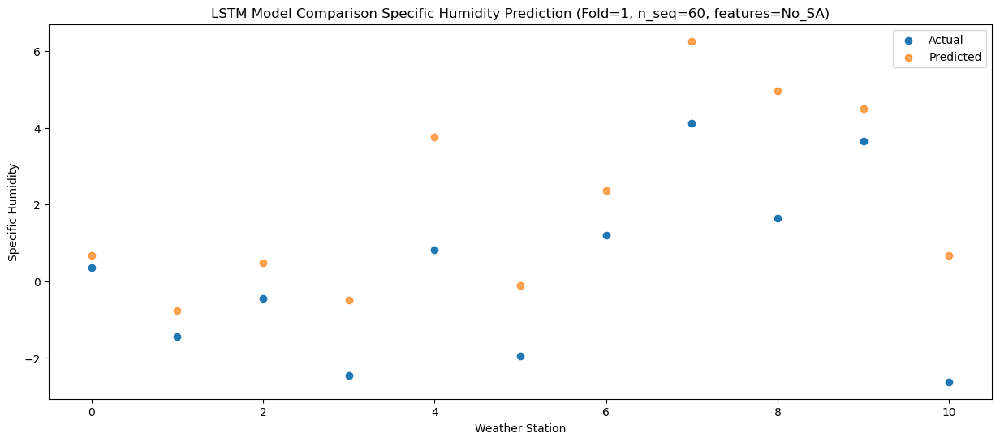

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   6.646566
1                 1    2.12   5.216568
2                 2    3.56   6.456565
3                 3    3.38   5.486568
4                 4    6.60   9.726566
5                 5    5.00   5.876565
6                 6    5.04   8.346568
7                 7   10.06  12.236565
8                 8    8.90  10.946564
9                 9   10.59  10.476567
10               10    1.94   6.646567


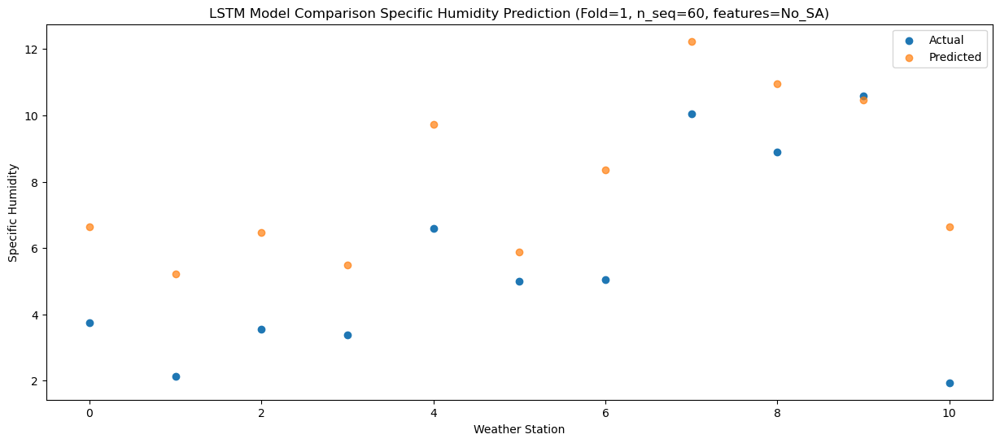

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74  11.177902
1                 1    5.12   9.747904
2                 2    7.15  10.987901
3                 3    9.38  10.017904
4                 4   12.87  14.257902
5                 5   11.91  10.407901
6                 6    7.80  12.877904
7                 7   15.25  16.767901
8                 8   16.01  15.477900
9                 9   17.07  15.007903
10               10    5.29  11.177903


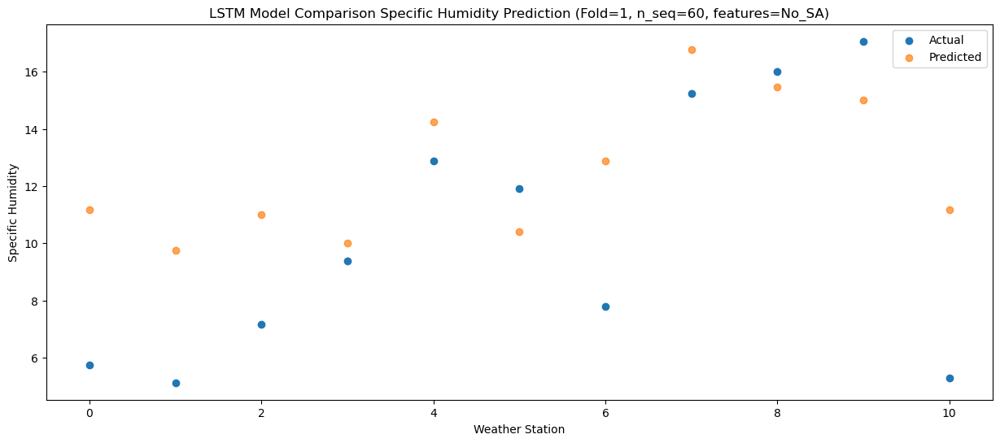

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  18.099141
1                 1   11.00  16.669143
2                 2   12.51  17.909140
3                 3   13.81  16.939143
4                 4   17.49  21.179141
5                 5   17.31  17.329140
6                 6   13.72  19.799143
7                 7   20.72  23.689140
8                 8   21.37  22.399139
9                 9   22.52  21.929142
10               10   12.27  18.099142


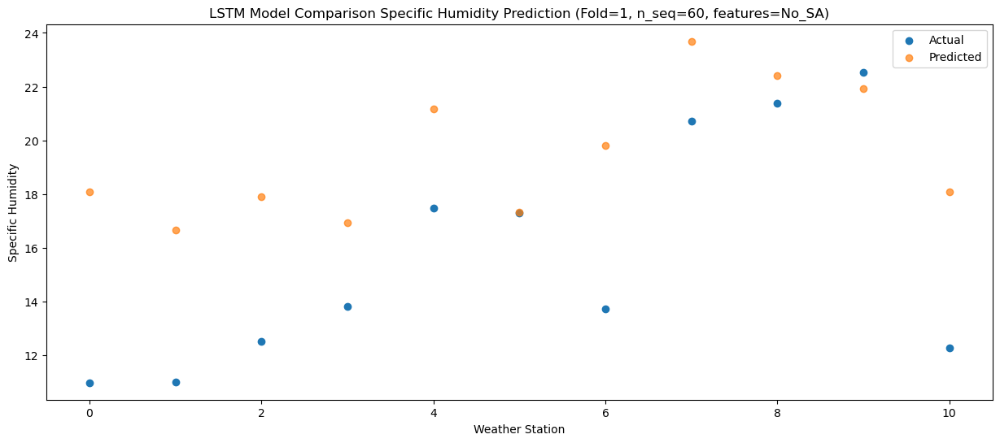

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  22.422054
1                 1   14.97  20.992056
2                 2   15.48  22.232053
3                 3   16.81  21.262056
4                 4   20.86  25.502054
5                 5   19.37  21.652053
6                 6   17.30  24.122056
7                 7   24.78  28.012053
8                 8   25.66  26.722052
9                 9   27.09  26.252055
10               10   16.66  22.422055


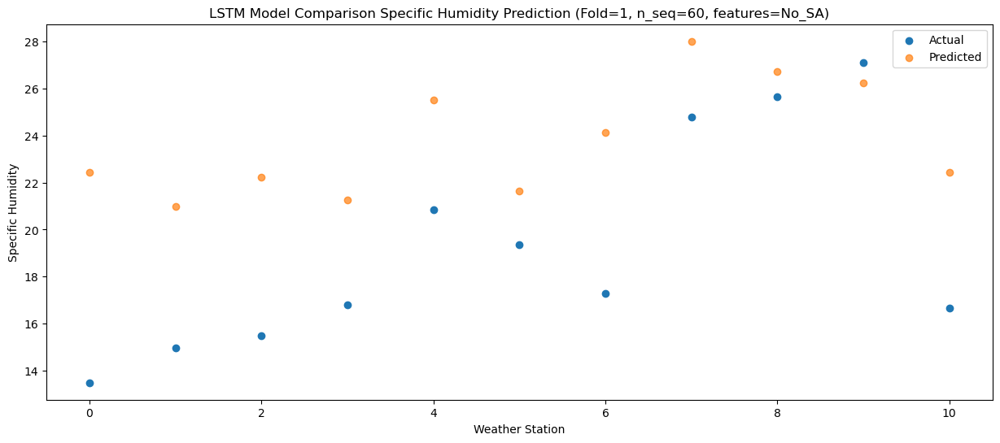

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  25.030883
1                 1   15.47  23.600885
2                 2   16.19  24.840882
3                 3   17.75  23.870885
4                 4   21.95  28.110883
5                 5   20.29  24.260882
6                 6   18.04  26.730885
7                 7   28.91  30.620882
8                 8   29.81  29.330881
9                 9   30.69  28.860884
10               10   20.60  25.030884


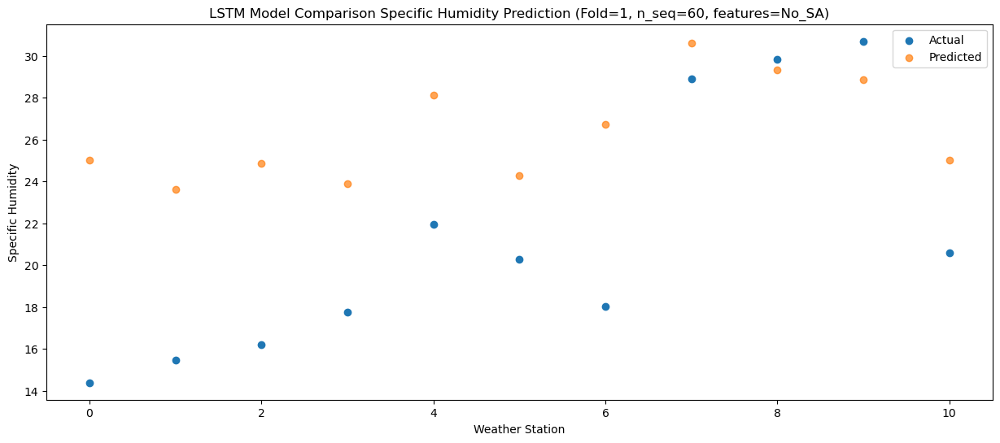

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  23.816832
1                 1   14.01  22.386834
2                 2   14.58  23.626832
3                 3   16.11  22.656834
4                 4   19.94  26.896832
5                 5   17.44  23.046831
6                 6   16.54  25.516834
7                 7   26.04  29.406831
8                 8   27.14  28.116830
9                 9   27.86  27.646833
10               10   20.06  23.816834


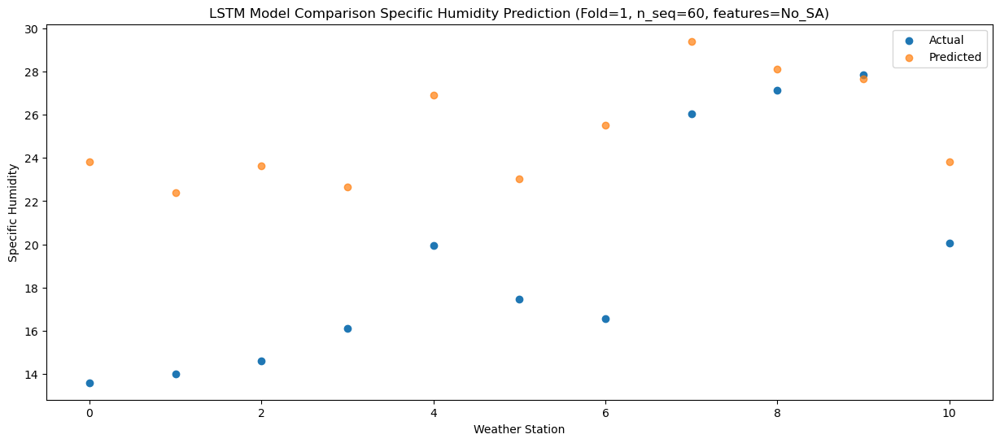

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  19.974918
1                 1   10.92  18.544920
2                 2   12.19  19.784918
3                 3   13.34  18.814920
4                 4   16.76  23.054918
5                 5   14.39  19.204917
6                 6   13.65  21.674920
7                 7   22.20  25.564917
8                 8   23.31  24.274916
9                 9   25.45  23.804919
10               10   15.15  19.974920


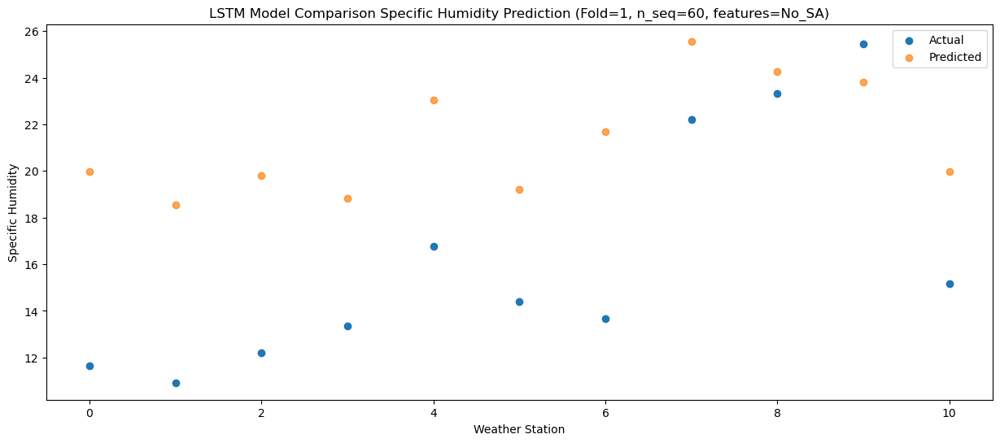

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08  13.299629
1                 1    4.58  11.869631
2                 2    5.50  13.109628
3                 3    7.78  12.139631
4                 4   11.37  16.379629
5                 5    8.31  12.529628
6                 6    7.31  14.999631
7                 7   15.53  18.889628
8                 8   15.08  17.599627
9                 9   16.91  17.129630
10               10    7.05  13.299631


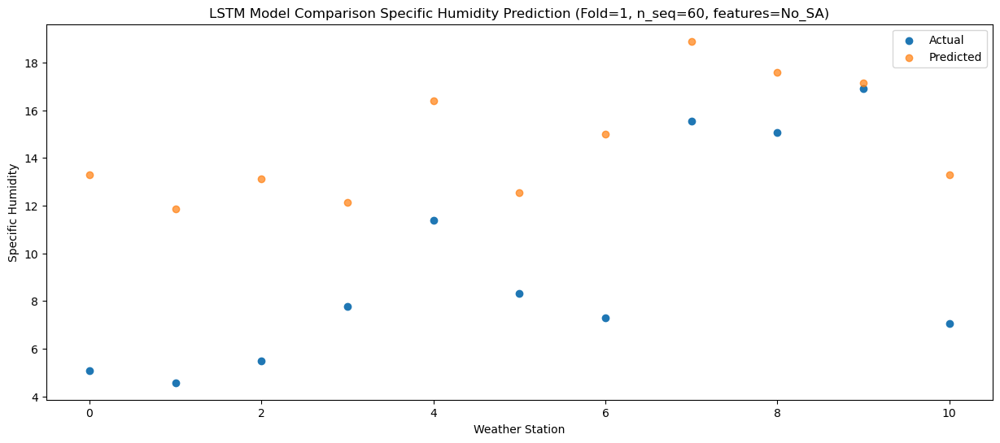

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   8.265755
1                 1    1.58   6.835754
2                 2    2.18   8.075753
3                 3    2.73   7.105754
4                 4    6.37  11.345754
5                 5    1.35   7.495751
6                 6    4.42   9.965756
7                 7    8.93  13.855751
8                 8    7.23  12.565750
9                 9    7.92  12.095753
10               10    3.54   8.265757


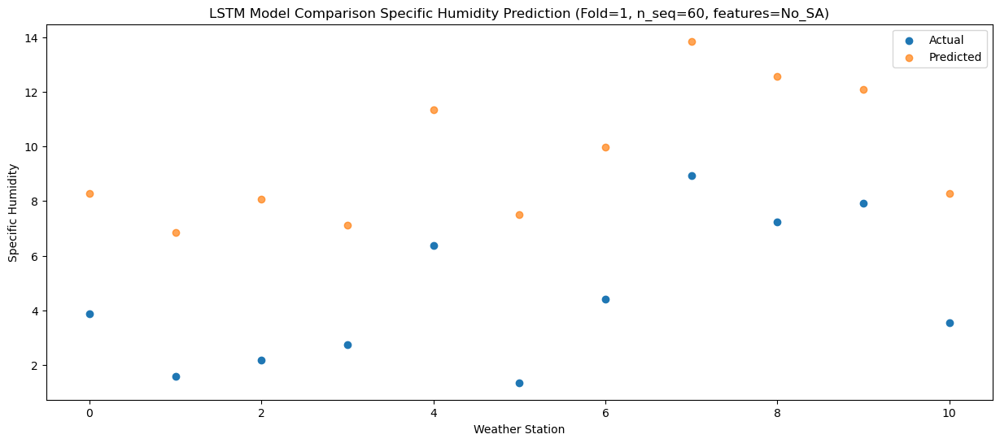

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88   3.278705
1                 1   -4.23   1.848705
2                 2   -0.98   3.088704
3                 3    0.64   2.118705
4                 4    4.35   6.358704
5                 5    0.23   2.508702
6                 6   -1.59   4.978707
7                 7    5.19   8.868702
8                 8    3.60   7.578701
9                 9    5.57   7.108704
10               10   -3.61   3.278708


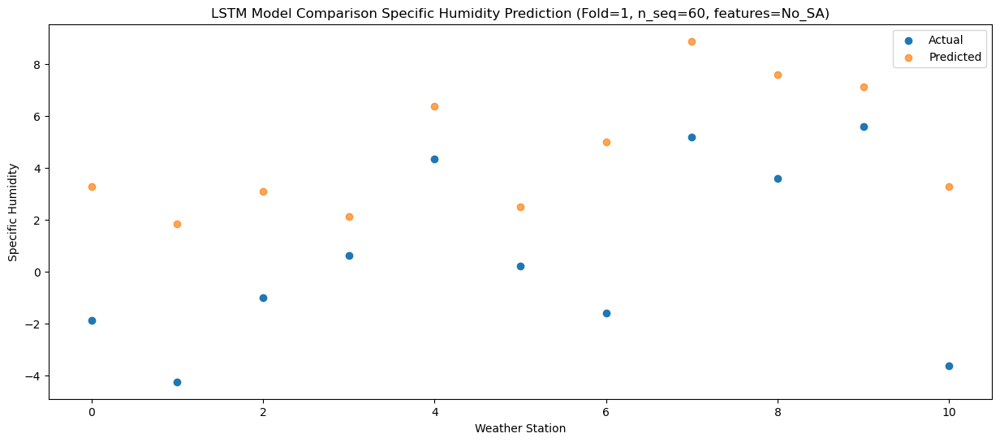

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23   4.734346
1                 1   -2.04   3.304346
2                 2    0.02   4.544345
3                 3    1.35   3.574346
4                 4    4.83   7.814345
5                 5    0.69   3.964343
6                 6    0.54   6.434348
7                 7    6.38  10.324343
8                 8    4.46   9.034342
9                 9    5.85   8.564345
10               10   -0.65   4.734349


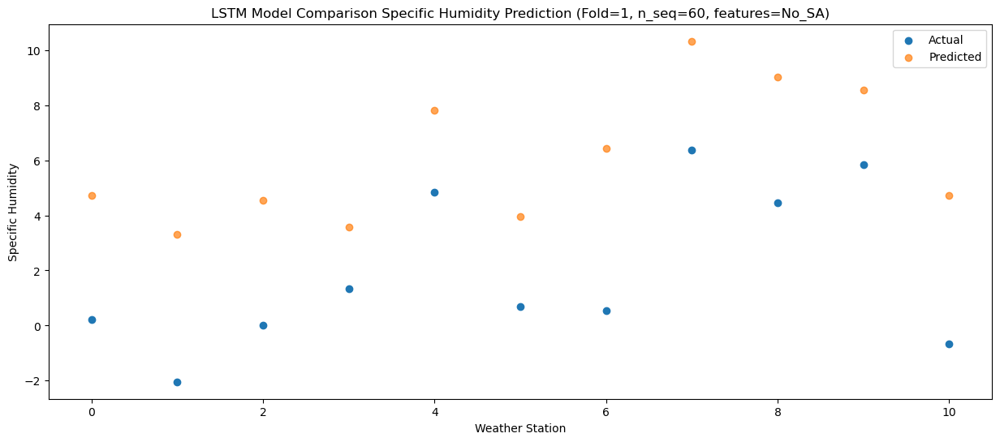

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14   5.515399
1                 1    1.33   4.085399
2                 2    2.61   5.325398
3                 3    2.35   4.355399
4                 4    6.01   8.595398
5                 5    0.83   4.745396
6                 6    4.13   7.215401
7                 7    7.88  11.105396
8                 8    4.83   9.815395
9                 9    7.00   9.345398
10               10   -0.97   5.515402


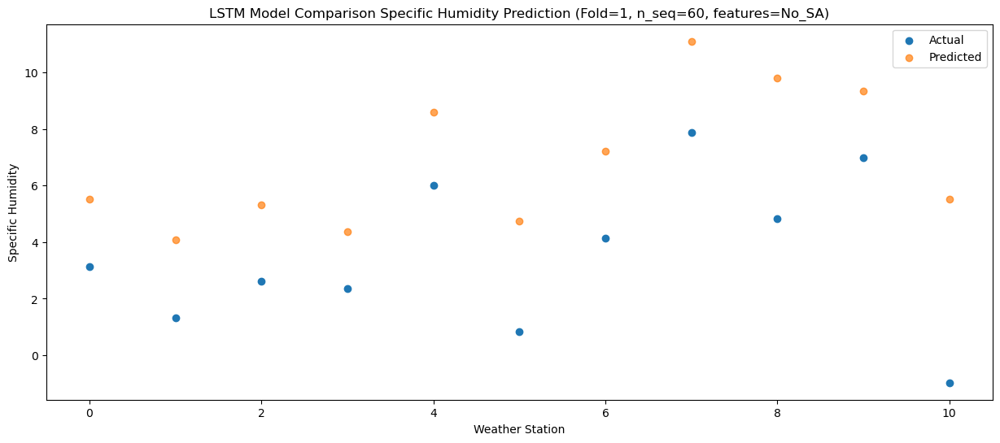

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   7.477787
1                 1    2.10   6.047786
2                 2    4.04   7.287786
3                 3    6.18   6.317786
4                 4    9.83  10.557786
5                 5    5.89   6.707783
6                 6    4.80   9.177789
7                 7   10.71  13.067783
8                 8    9.26  11.777782
9                 9   10.73  11.307785
10               10    0.15   7.477790


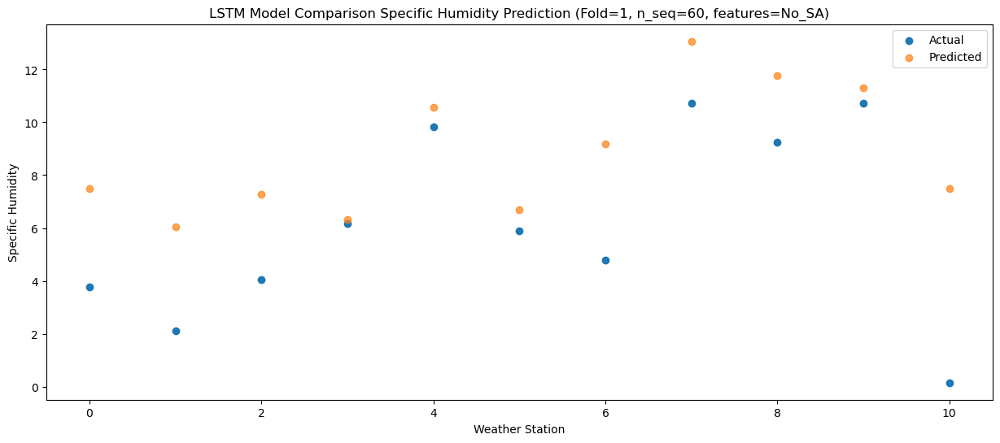

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28  13.562633
1                 1    5.37  12.132633
2                 2    6.73  13.372632
3                 3    7.02  12.402633
4                 4   10.79  16.642632
5                 5    9.05  12.792630
6                 6    8.06  15.262635
7                 7   15.11  19.152630
8                 8   13.59  17.862629
9                 9   16.08  17.392632
10               10    7.37  13.562636


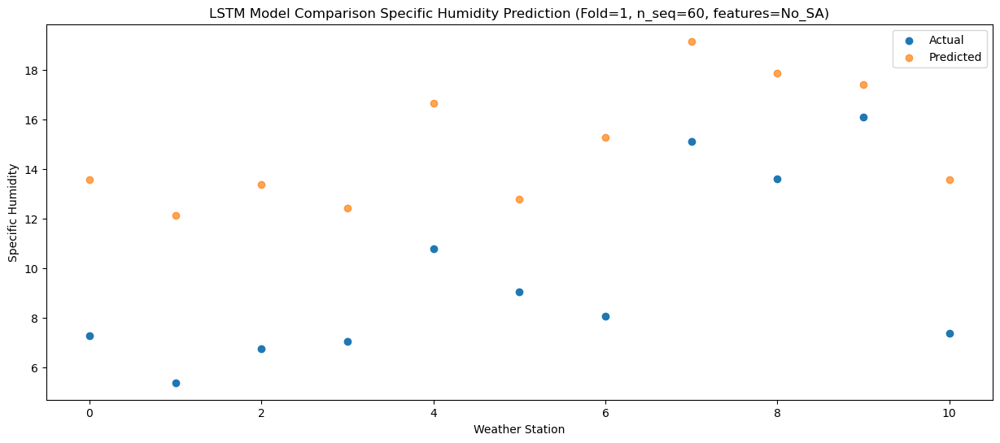

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  17.888175
1                 1    8.65  16.458174
2                 2    9.97  17.698174
3                 3   11.61  16.728174
4                 4   15.43  20.968174
5                 5   13.66  17.118173
6                 6   11.06  19.588179
7                 7   20.46  23.478173
8                 8   19.28  22.188170
9                 9   21.19  21.718173
10               10    9.93  17.888179


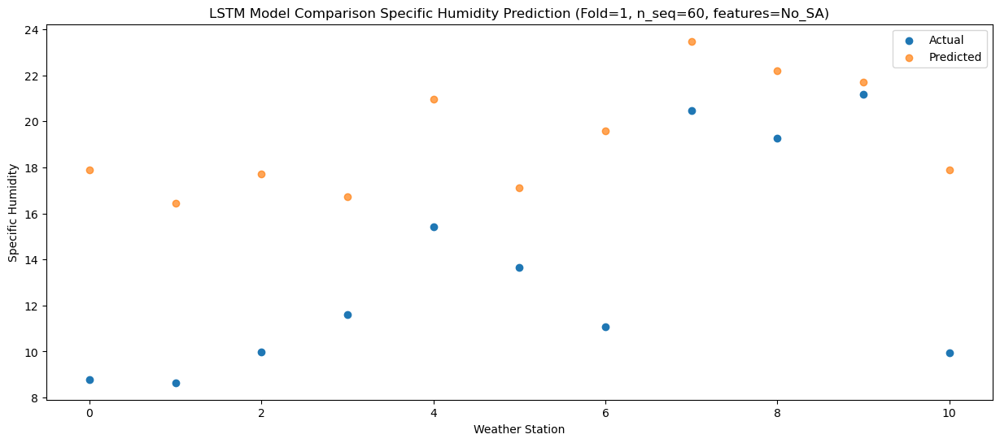

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  22.398035
1                 1   11.84  20.968034
2                 2   13.72  22.208034
3                 3   15.76  21.238034
4                 4   20.32  25.478034
5                 5   20.35  21.628033
6                 6   14.34  24.098039
7                 7   24.27  27.988033
8                 8   24.21  26.698030
9                 9   24.42  26.228033
10               10   14.30  22.398039


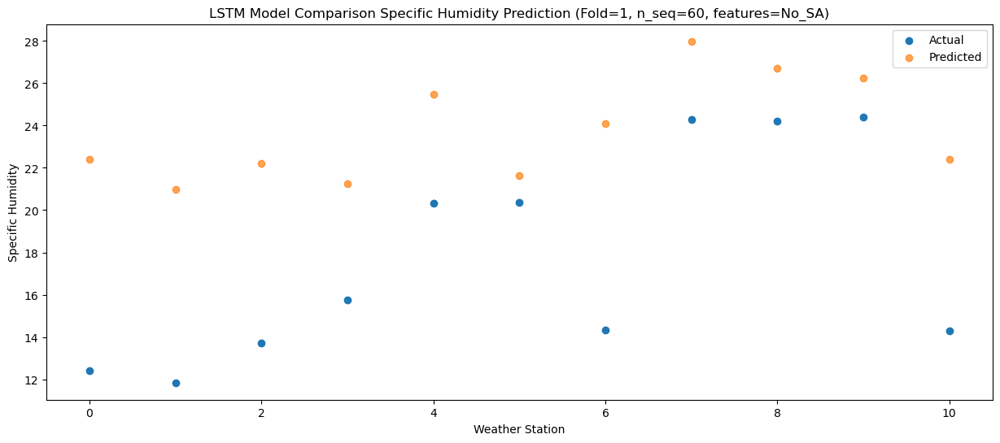

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  25.920355
1                 1   15.44  24.490354
2                 2   16.09  25.730353
3                 3   17.48  24.760354
4                 4   22.27  29.000354
5                 5   21.45  25.150353
6                 6   17.79  27.620358
7                 7   26.57  31.510353
8                 8   27.09  30.220350
9                 9   29.04  29.750353
10               10   19.44  25.920359


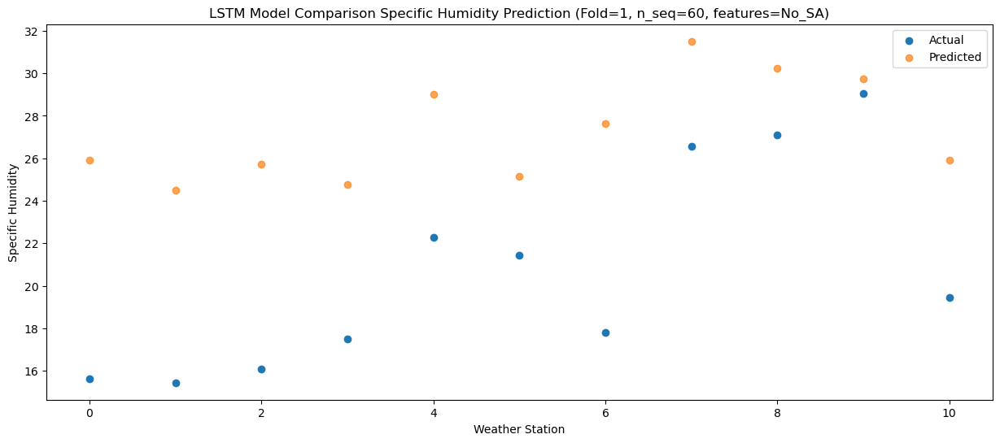

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  25.167945
1                 1   14.90  23.737944
2                 2   16.53  24.977944
3                 3   19.45  24.007944
4                 4   23.70  28.247944
5                 5   20.64  24.397944
6                 6   17.37  26.867949
7                 7   27.07  30.757944
8                 8   28.90  29.467941
9                 9   29.44  28.997944
10               10   17.70  25.167950


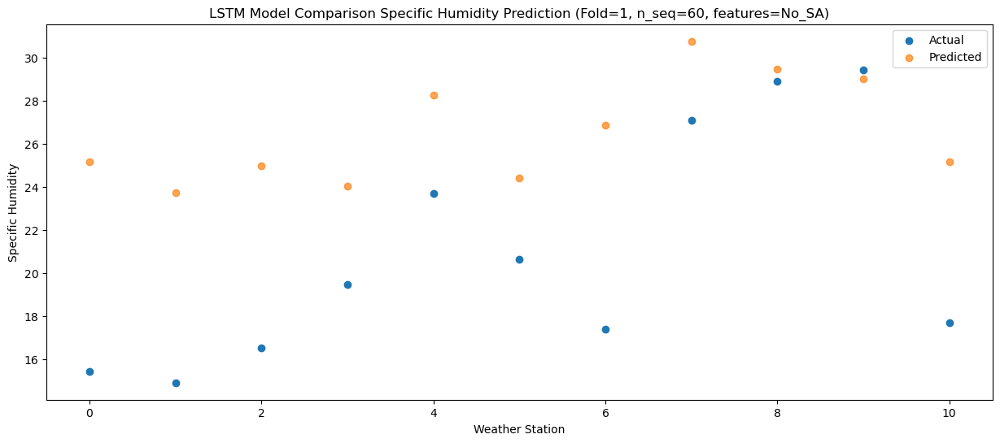

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  22.142284
1                 1   11.39  20.712282
2                 2   13.57  21.952283
3                 3   16.37  20.982282
4                 4   19.85  25.222283
5                 5   18.36  21.372282
6                 6   14.20  23.842287
7                 7   23.45  27.732282
8                 8   24.26  26.442279
9                 9   25.92  25.972282
10               10   14.51  22.142288


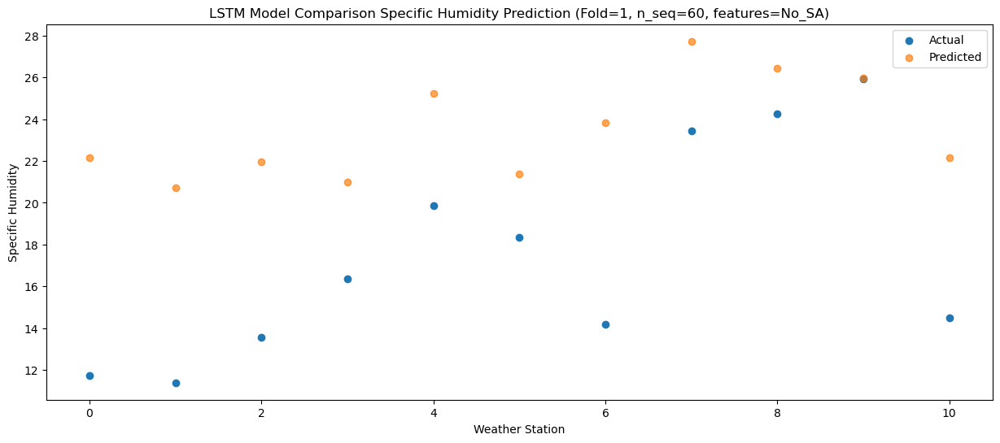

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85  16.774028
1                 1    6.38  15.344027
2                 2    7.53  16.584026
3                 3    9.11  15.614027
4                 4   12.45  19.854027
5                 5   10.76  16.004027
6                 6    9.19  18.474032
7                 7   17.14  22.364027
8                 8   15.68  21.074023
9                 9   17.82  20.604026
10               10    9.16  16.774033


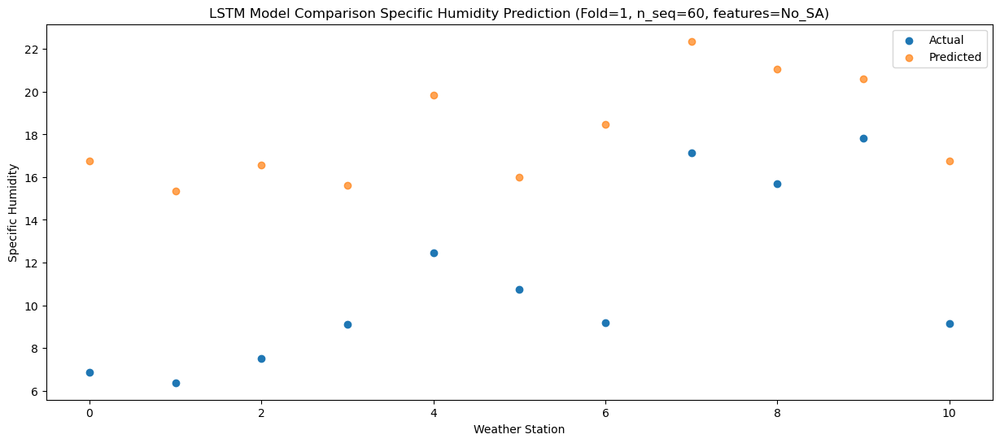

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   9.868971
1                 1    0.76   8.438969
2                 2    0.97   9.678969
3                 3    2.83   8.708969
4                 4    6.25  12.948970
5                 5    4.10   9.098969
6                 6    3.50  11.568974
7                 7    9.74  15.458969
8                 8    8.56  14.168965
9                 9   11.07  13.698968
10               10    1.22   9.868975


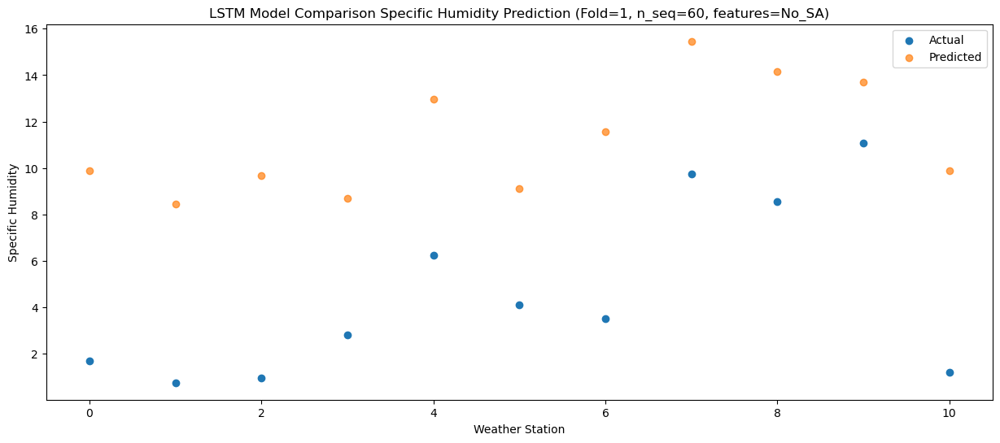

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   8.355369
1                 1   -2.38   6.925367
2                 2   -1.81   8.165367
3                 3    0.43   7.195367
4                 4    4.35  11.435368
5                 5    1.74   7.585367
6                 6    0.76  10.055372
7                 7    6.82  13.945367
8                 8    5.71  12.655363
9                 9    7.24  12.185366
10               10   -0.47   8.355373


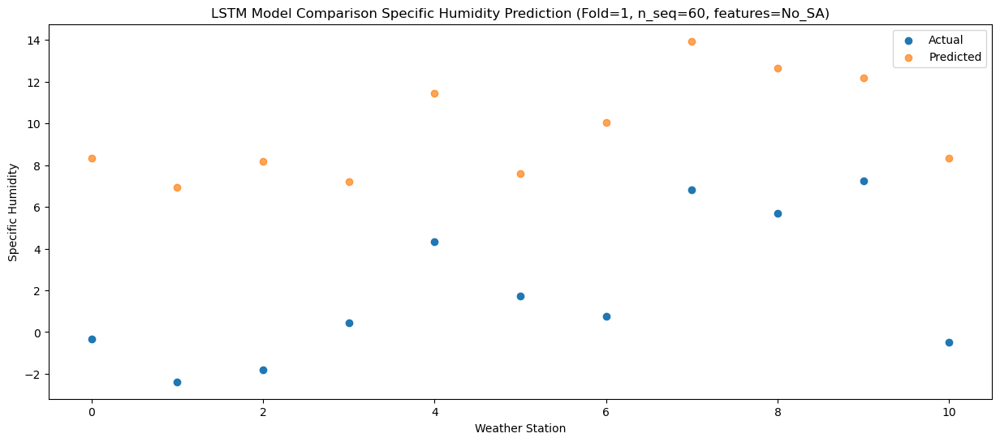

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65   3.934700
1                 1   -5.66   2.504698
2                 2   -4.89   3.744698
3                 3   -2.99   2.774698
4                 4    0.50   7.014699
5                 5   -1.87   3.164698
6                 6   -2.24   5.634703
7                 7    0.89   9.524698
8                 8   -0.12   8.234694
9                 9    2.07   7.764697
10               10   -4.37   3.934704


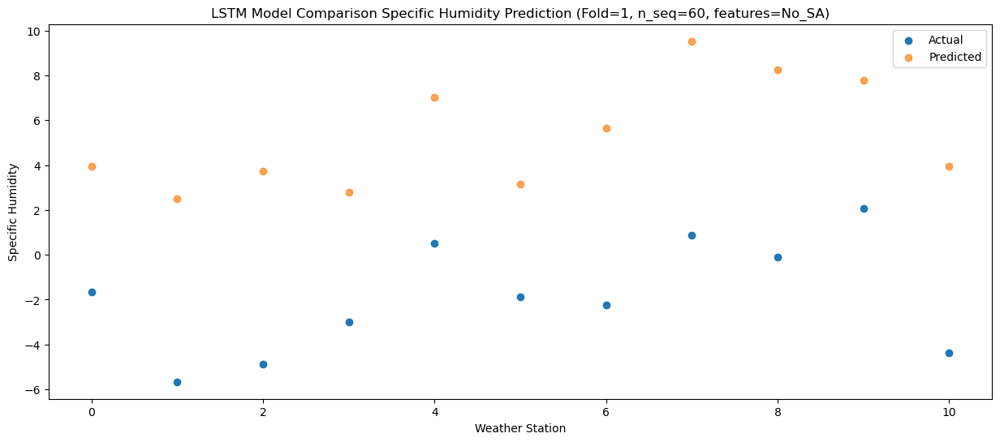

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   8.620490
1                 1   -0.58   7.190488
2                 2    0.45   8.430488
3                 3    3.32   7.460488
4                 4    6.87  11.700489
5                 5    4.25   7.850488
6                 6    1.97  10.320493
7                 7    9.89  14.210488
8                 8    7.83  12.920484
9                 9    9.78  12.450487
10               10   -2.42   8.620494


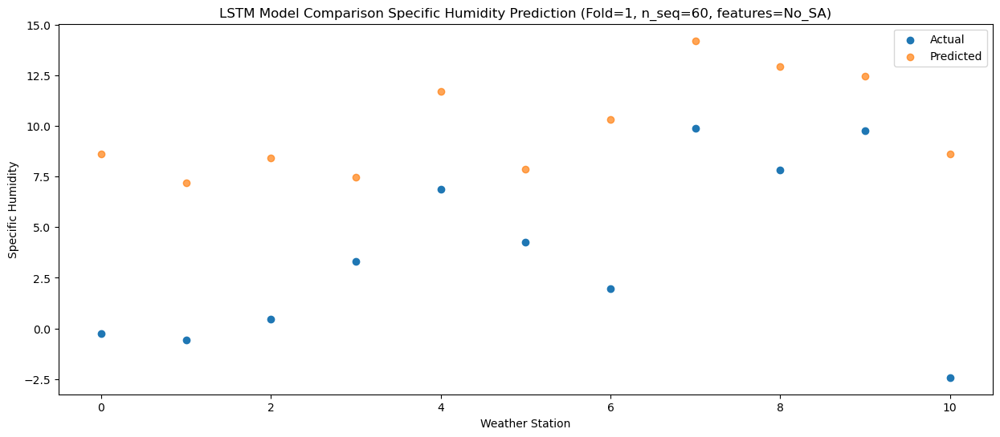

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58  11.611879
1                 1    2.64  10.181878
2                 2    3.55  11.421877
3                 3    5.83  10.451878
4                 4    9.61  14.691878
5                 5    6.60  10.841877
6                 6    5.63  13.311883
7                 7   12.61  17.201877
8                 8   11.07  15.911874
9                 9   12.61  15.441877
10               10    1.98  11.611884


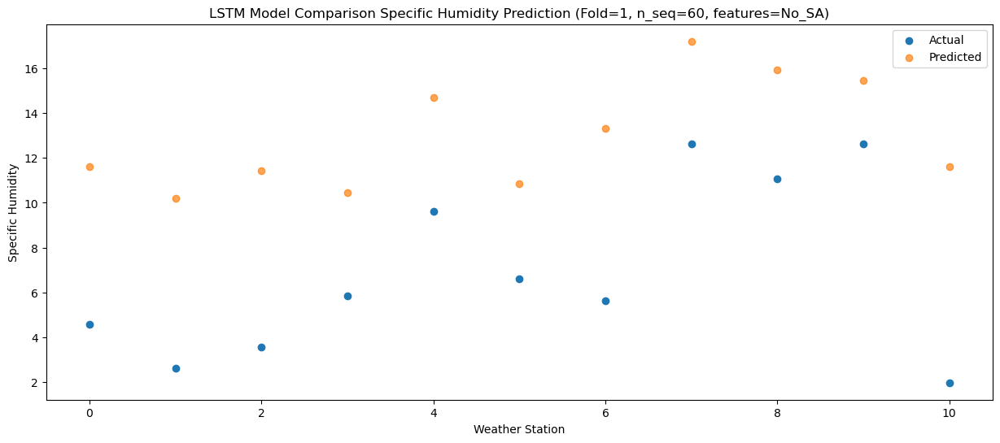

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98  16.077755
1                 1    6.31  14.647754
2                 2    6.89  15.887753
3                 3    9.31  14.917754
4                 4   13.17  19.157755
5                 5   11.40  15.307754
6                 6    9.10  17.777759
7                 7   16.65  21.667754
8                 8   15.75  20.377750
9                 9   17.68  19.907753
10               10    6.37  16.077760


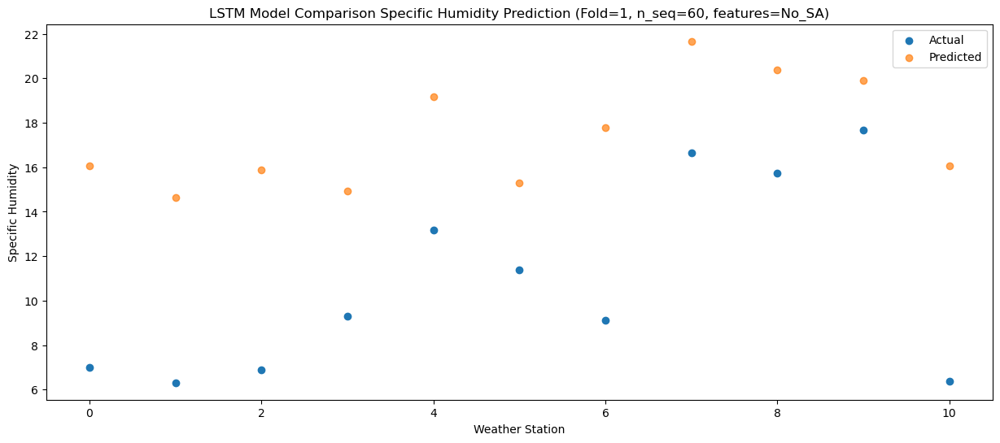

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  21.918085
1                 1   10.88  20.488084
2                 2   12.50  21.728083
3                 3   13.01  20.758084
4                 4   16.87  24.998084
5                 5   17.02  21.148084
6                 6   13.34  23.618089
7                 7   22.19  27.508084
8                 8   20.51  26.218080
9                 9   21.82  25.748083
10               10   11.96  21.918090


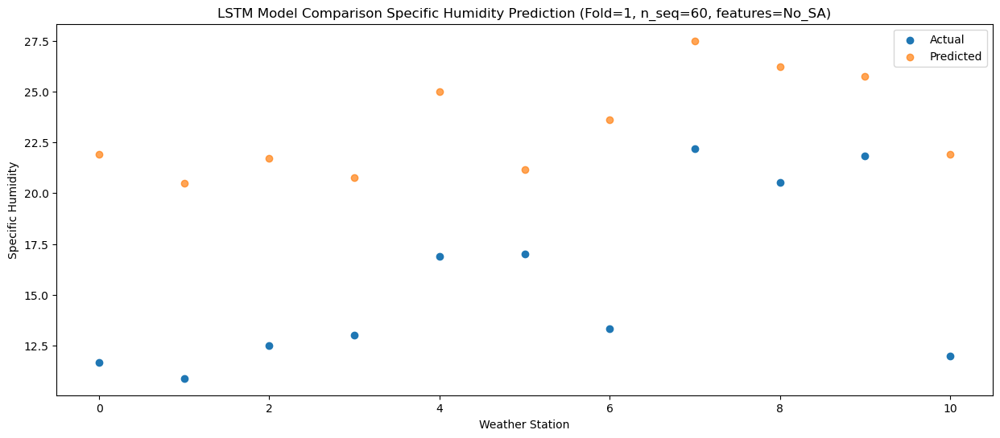

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  26.241609
1                 1   14.64  24.811608
2                 2   15.61  26.051607
3                 3   15.64  25.081608
4                 4   19.76  29.321608
5                 5   19.88  25.471608
6                 6   17.27  27.941613
7                 7   25.26  31.831608
8                 8   26.21  30.541604
9                 9   28.23  30.071607
10               10   18.07  26.241614


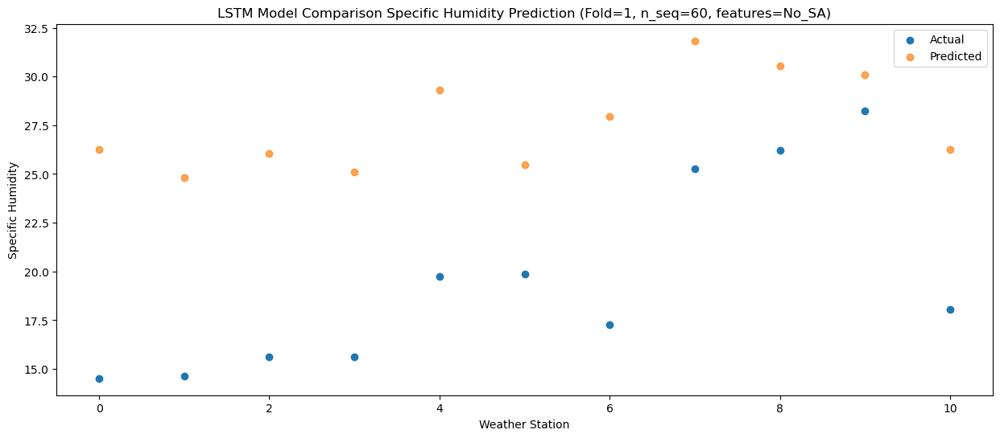

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  27.448640
1                 1   15.57  26.018639
2                 2   15.63  27.258638
3                 3   15.03  26.288639
4                 4   19.57  30.528639
5                 5   18.88  26.678639
6                 6   18.30  29.148644
7                 7   25.90  33.038639
8                 8   27.06  31.748635
9                 9   28.96  31.278638
10               10   20.00  27.448645


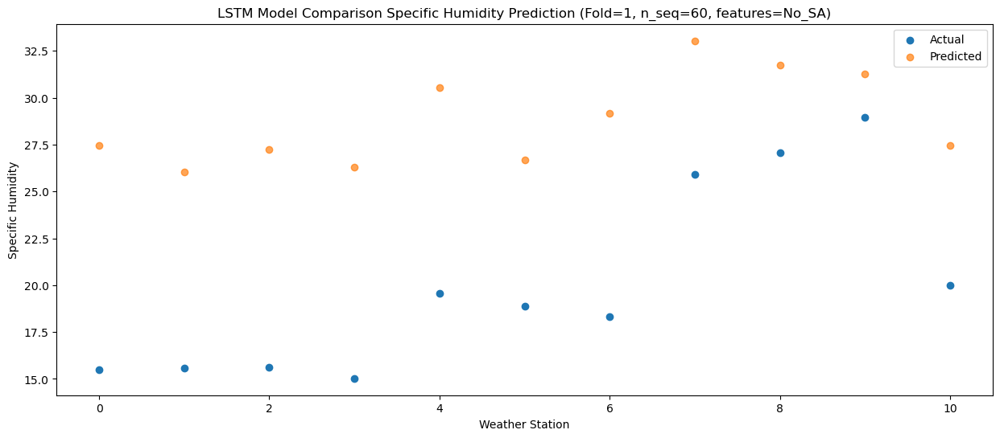

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  26.350770
1                 1   15.29  24.920768
2                 2   15.94  26.160767
3                 3   16.16  25.190768
4                 4   20.89  29.430768
5                 5   20.48  25.580768
6                 6   17.97  28.050773
7                 7   26.31  31.940768
8                 8   29.17  30.650765
9                 9   29.76  30.180768
10               10   17.85  26.350774


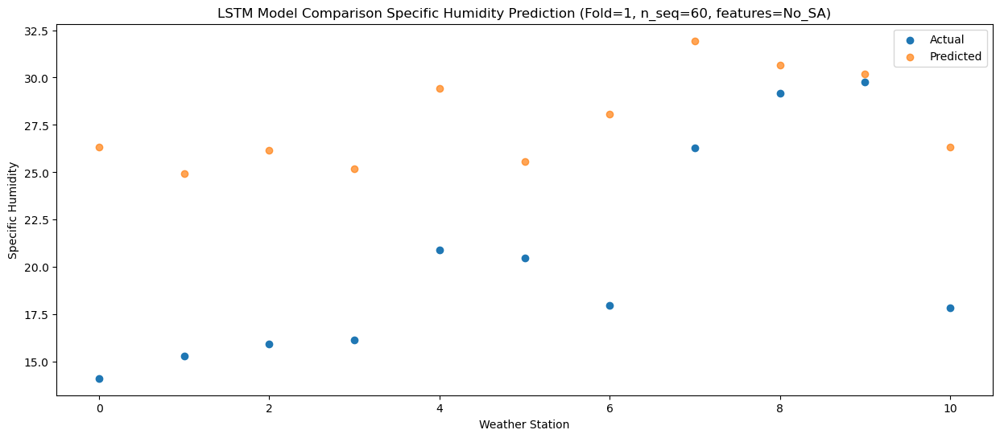

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  24.035275
1                 1   11.57  22.605273
2                 2   13.63  23.845273
3                 3   13.56  22.875273
4                 4   17.60  27.115273
5                 5   14.77  23.265273
6                 6   14.67  25.735278
7                 7   24.44  29.625272
8                 8   23.20  28.335269
9                 9   25.20  27.865272
10               10   14.12  24.035279


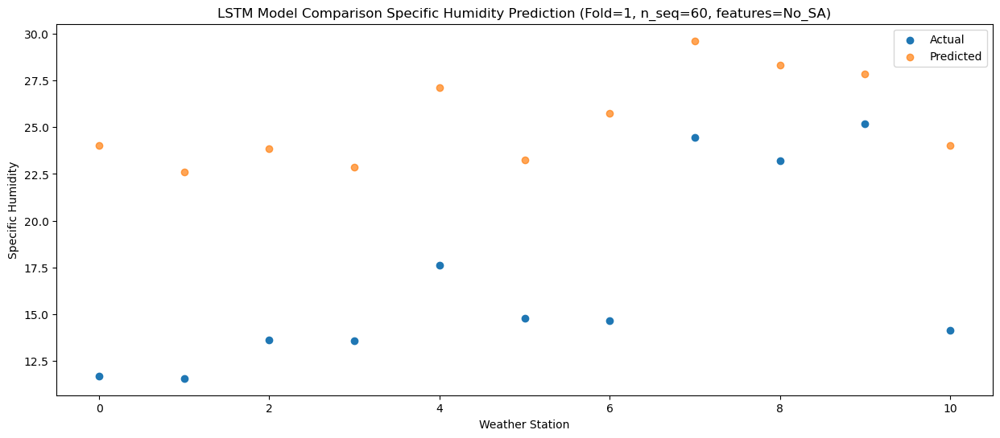

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  19.271340
1                 1    7.12  17.841339
2                 2    8.63  19.081338
3                 3   10.87  18.111339
4                 4   14.45  22.351338
5                 5   13.62  18.501339
6                 6    9.87  20.971343
7                 7   18.97  24.861338
8                 8   19.34  23.571335
9                 9   20.35  23.101338
10               10    9.25  19.271345


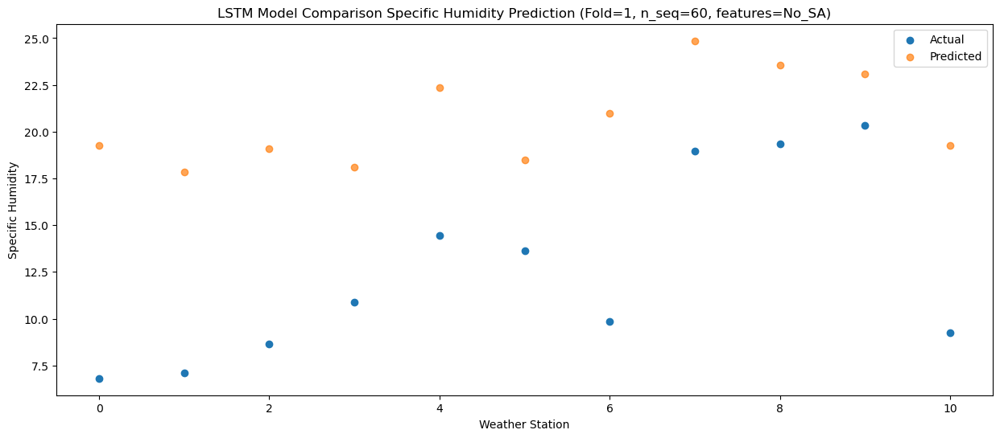

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (1, 1, 512)               4767744   
                                                                 
 dropout_2 (Dropout)         (1, 1, 512)               0         
                                                                 
 lstm_3 (LSTM)               (1, 512)                  2099200   
                                                                 
 dropout_3 (Dropout)         (1, 512)                  0         
                                                                 
 dense_3 (Dense)             (1, 256)                  131328    
                                                                 
 dense_4 (Dense)             (1, 128)                  32896     
                                                                 
 dense_5 (Dense)             (1, 60)                  

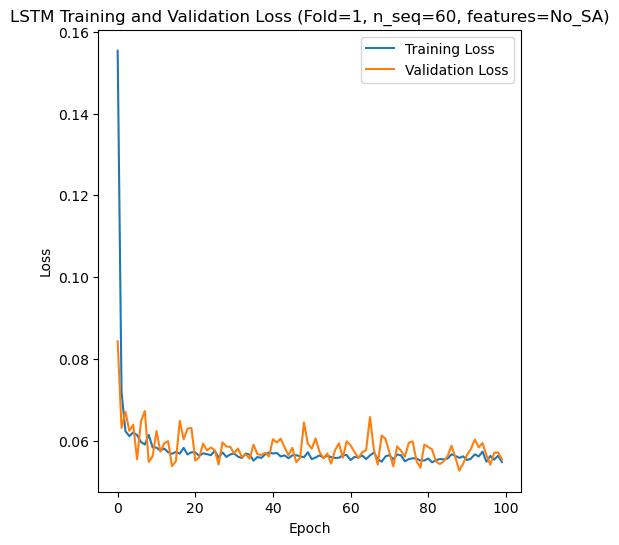

Epoch 1/100
84/84 [==============================] - 19s 115ms/step - loss: 0.1440 - accuracy: 0.2024 - mae: 0.1179 - rmse: 0.1440 - mape: inf - pearson: 0.6031 - val_loss: 0.0668 - val_accuracy: 0.0000e+00 - val_mae: 0.0511 - val_rmse: 0.0668 - val_mape: 12.2702 - val_pearson: 0.8175
Epoch 2/100
84/84 [==============================] - 6s 75ms/step - loss: 0.0748 - accuracy: 0.4643 - mae: 0.0594 - rmse: 0.0748 - mape: inf - pearson: 0.7989 - val_loss: 0.0526 - val_accuracy: 0.6000 - val_mae: 0.0418 - val_rmse: 0.0526 - val_mape: 9.3957 - val_pearson: 0.8944
Epoch 3/100
84/84 [==============================] - 7s 78ms/step - loss: 0.0632 - accuracy: 0.4524 - mae: 0.0500 - rmse: 0.0632 - mape: inf - pearson: 0.8212 - val_loss: 0.0461 - val_accuracy: 0.1000 - val_mae: 0.0361 - val_rmse: 0.0461 - val_mape: 8.1397 - val_pearson: 0.9121
Epoch 4/100
84/84 [==============================] - 7s 83ms/step - loss: 0.0611 - accuracy: 0.5476 - mae: 0.0487 - rmse: 0.0611 - mape: inf - pearson: 0.83

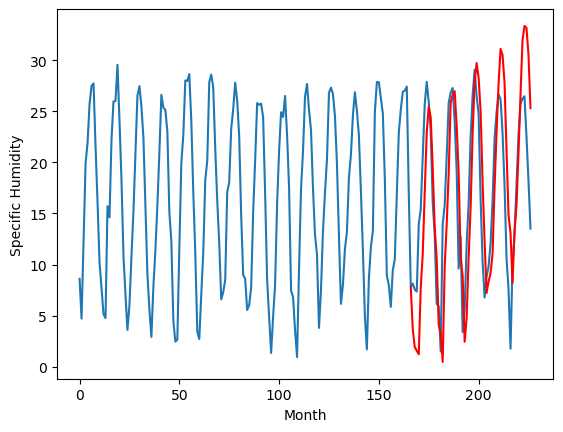

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.57		-1.75		-3.32
-0.71		-3.44		-2.73
-0.95		-3.80		-2.85
-1.68		-4.15		-2.47
6.33		2.39		-3.94
8.56		5.68		-2.88
15.36		11.71		-3.65
22.56		17.59		-4.97
22.59		20.08		-2.51
21.26		19.01		-2.25
15.13		14.13		-1.00
8.14		8.26		0.12
5.02		5.22		0.20
-1.61		-1.26		0.35
-1.69		-2.11		-0.42
-5.73		-4.90		0.83
4.46		4.39		-0.07
8.22		8.57		0.35
13.40		13.54		0.14
20.65		20.48		-0.17
21.34		21.21		-0.13
22.10		21.60		-0.50
19.86		18.22		-1.64
11.60		13.62		2.02
4.89		5.24		0.35
2.50		3.54		1.04
-2.19		-2.92		-0.73
-2.20		-0.60		1.60
4.78		5.30		0.52
11.46		10.23		-1.23
17.26		17.45		0.19
21.06		22.52		1.46
24.30		24.35		0.05
21.99		22.92		0.93
19.23		19.67		0.44
10.85		12.70		1.85
0.86		6.88		6.02
-1.85		1.85		3.70
-2.10		2.98		5.08
-0.50		3.78		4.28
3.57		5.71		2.14
9.43		12.20		2.77
14.92		17.62		2.70
17.53		22.32		4.79
21.63		25.73		4.10
22.12		25.13		3.01
19.25		22.40		3.15
10.21		15.73		5.52
3

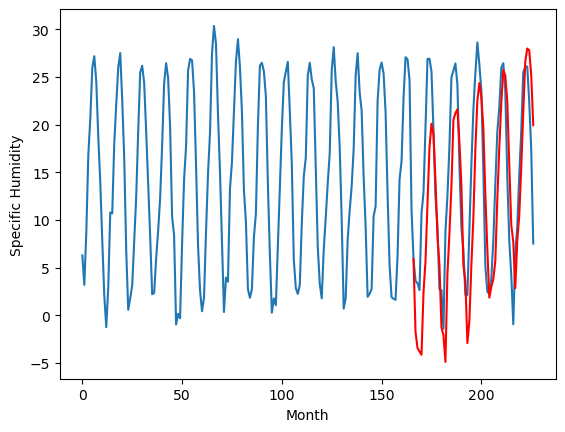

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.66		3.52		-2.14
4.54		1.83		-2.71
3.39		1.47		-1.92
4.43		1.12		-3.31
8.05		7.66		-0.39
9.44		10.95		1.51
10.75		16.98		6.23
13.34		22.86		9.52
13.98		25.35		11.37
13.67		24.28		10.61
12.41		19.40		6.99
11.14		13.53		2.39
7.72		10.49		2.77
0.73		4.01		3.28
1.39		3.16		1.77
4.12		0.37		-3.75
5.93		9.66		3.73
7.74		13.84		6.10
11.32		18.81		7.49
12.54		25.75		13.21
13.33		26.48		13.15
13.38		26.87		13.49
12.10		23.49		11.39
10.96		18.89		7.93
4.11		10.51		6.40
5.01		8.81		3.80
0.75		2.35		1.60
3.08		4.67		1.59
6.55		10.57		4.02
8.36		15.50		7.14
11.12		22.72		11.60
12.93		27.79		14.86
13.11		29.62		16.51
12.54		28.19		15.65
11.13		24.94		13.81
8.50		17.97		9.47
6.74		12.15		5.41
2.64		7.12		4.48
2.44		8.25		5.81
5.50		9.05		3.55
6.52		10.98		4.46
9.06		17.47		8.41
10.04		22.89		12.85
12.45		27.59		15.14
14.36		31.00		16.64
14.54		30.40		15.86
12.59		27.67		15.08
9.01		21.00		11.99
5.03		14.72

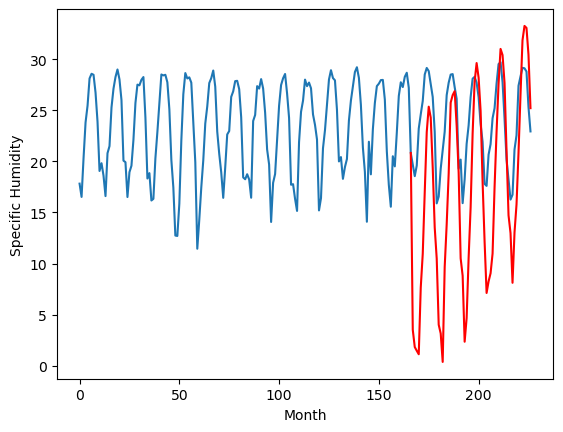

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.01		0.05		0.06
-3.07		-1.64		1.43
-2.80		-2.00		0.80
-2.65		-2.35		0.30
0.90		4.19		3.29
2.13		7.48		5.35
8.02		13.51		5.49
14.08		19.39		5.31
18.36		21.88		3.52
16.51		20.81		4.30
11.93		15.93		4.00
6.71		10.06		3.35
2.75		7.02		4.27
-4.08		0.54		4.62
-7.16		-0.31		6.85
-7.14		-3.10		4.04
-3.03		6.19		9.22
1.47		10.37		8.90
6.73		15.34		8.61
12.30		22.28		9.98
14.30		23.01		8.71
15.36		23.40		8.04
12.19		20.02		7.83
8.36		15.42		7.06
0.28		7.04		6.76
-1.64		5.34		6.98
-7.79		-1.12		6.67
-5.47		1.20		6.67
-1.61		7.10		8.71
2.83		12.03		9.20
8.17		19.25		11.08
12.41		24.32		11.91
17.03		26.15		9.12
16.95		24.72		7.77
11.91		21.47		9.56
6.47		14.50		8.03
2.67		8.68		6.01
-3.50		3.65		7.15
-2.21		4.78		6.99
-4.09		5.58		9.67
-1.65		7.51		9.16
4.07		14.00		9.93
7.70		19.42		11.72
11.49		24.12		12.63
17.06		27.53		10.47
15.05		26.93		11.88
12.63		24.20		11.57
7.61		17.53		9.92
-0.37		11.25		11.

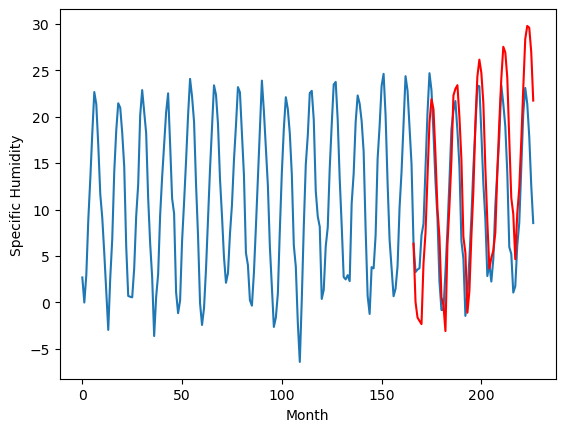

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.32		0.09		0.41
0.03		-1.60		-1.63
0.37		-1.96		-2.33
1.01		-2.31		-3.32
7.70		4.23		-3.47
7.17		7.52		0.35
10.14		13.55		3.41
13.18		19.43		6.25
13.92		21.92		8.00
14.29		20.85		6.56
11.94		15.97		4.03
8.25		10.10		1.85
4.13		7.06		2.93
-2.17		0.58		2.75
-1.82		-0.27		1.55
-2.56		-3.06		-0.50
4.77		6.23		1.46
5.64		10.41		4.77
10.11		15.38		5.27
13.59		22.32		8.73
14.18		23.05		8.87
14.35		23.44		9.09
11.81		20.06		8.25
9.07		15.46		6.39
0.80		7.08		6.28
4.21		5.38		1.17
-3.52		-1.08		2.44
-0.38		1.24		1.62
3.38		7.14		3.76
7.18		12.07		4.89
12.34		19.29		6.95
14.93		24.36		9.43
14.76		26.19		11.43
13.94		24.76		10.82
11.97		21.51		9.54
5.78		14.54		8.76
2.71		8.72		6.01
0.20		3.69		3.49
1.37		4.82		3.45
3.50		5.62		2.12
5.33		7.55		2.22
7.25		14.04		6.79
11.28		19.46		8.18
14.93		24.16		9.23
16.37		27.57		11.20
17.67		26.97		9.30
13.24		24.24		11.00
7.08		17.57		10.49
1.97		11.29		9.32
-0

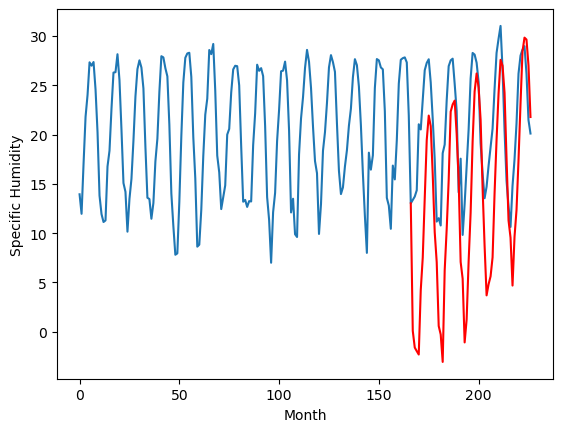

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.39		-2.24		-1.85
-1.82		-3.93		-2.11
-1.45		-4.29		-2.84
-2.21		-4.64		-2.43
5.88		1.90		-3.98
5.85		5.19		-0.66
9.69		11.22		1.53
13.30		17.10		3.80
15.00		19.59		4.59
15.30		18.52		3.22
10.90		13.64		2.74
6.43		7.77		1.34
3.75		4.73		0.98
-2.36		-1.75		0.61
-2.95		-2.60		0.35
-5.30		-5.39		-0.09
3.08		3.90		0.82
5.20		8.08		2.88
9.24		13.05		3.81
13.79		19.99		6.20
13.87		20.72		6.85
14.98		21.11		6.13
12.24		17.73		5.49
8.94		13.13		4.19
1.30		4.75		3.45
4.54		3.05		-1.49
-3.89		-3.41		0.48
-4.27		-1.09		3.18
1.85		4.81		2.96
8.00		9.74		1.74
12.60		16.96		4.36
16.32		22.03		5.71
17.68		23.86		6.18
14.96		22.43		7.47
12.30		19.18		6.88
6.73		12.21		5.48
0.85		6.39		5.54
-1.38		1.36		2.74
-0.62		2.49		3.11
0.57		3.29		2.72
4.37		5.22		0.85
5.29		11.71		6.42
10.37		17.13		6.76
15.29		21.83		6.54
17.45		25.24		7.79
19.15		24.64		5.49
14.67		21.91		7.24
6.78		15.24		8.46
0.50		8.96		8.46
-1

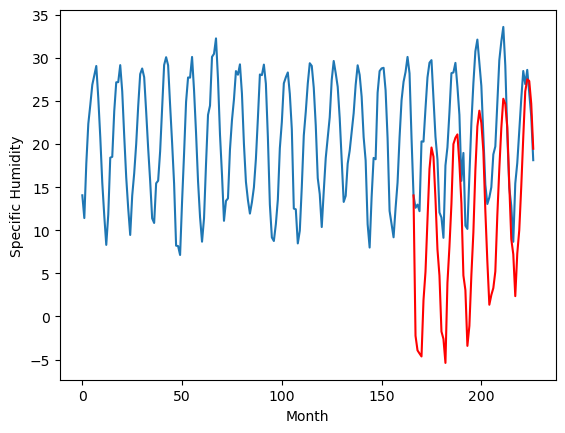

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
10.42		9.30		-1.12
8.61		7.61		-1.00
8.96		7.25		-1.71
8.40		6.90		-1.50
16.05		13.44		-2.61
16.36		16.73		0.37
21.26		22.76		1.50
26.00		28.64		2.64
27.18		31.13		3.95
27.41		30.06		2.65
21.47		25.18		3.71
15.99		19.31		3.32
13.50		16.27		2.77
7.04		9.79		2.75
6.34		8.94		2.60
3.23		6.15		2.92
13.60		15.44		1.84
15.30		19.62		4.32
19.38		24.59		5.21
24.94		31.53		6.59
25.83		32.26		6.43
26.39		32.65		6.26
24.12		29.27		5.15
19.61		24.67		5.06
11.64		16.29		4.65
13.93		14.59		0.66
5.45		8.13		2.68
5.28		10.45		5.17
11.86		16.35		4.49
18.13		21.28		3.15
23.15		28.50		5.35
27.86		33.57		5.71
30.65		35.40		4.75
27.84		33.97		6.13
24.01		30.72		6.71
17.63		23.75		6.12
10.96		17.93		6.97
8.34		12.90		4.56
9.22		14.03		4.81
9.41		14.83		5.42
14.06		16.76		2.70
15.88		23.25		7.37
21.62		28.67		7.05
25.77		33.37		7.60
28.33		36.78		8.45
30.67		36.18		5.51
25.89		33.45		7.56
17.17		26.78		9.61
11.83		

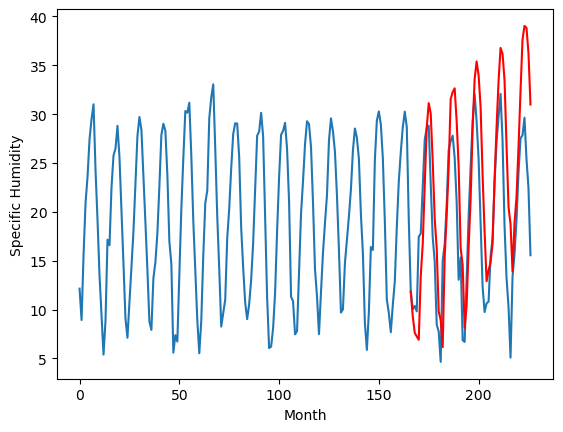

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-3.43		-5.84		-2.41
-7.96		-7.53		0.43
-6.71		-7.89		-1.18
-5.90		-8.24		-2.34
-1.40		-1.70		-0.30
3.58		1.59		-1.99
9.87		7.62		-2.25
13.39		13.50		0.11
15.49		15.99		0.50
15.93		14.92		-1.01
9.68		10.04		0.36
4.08		4.17		0.09
-1.48		1.13		2.61
-9.13		-5.35		3.78
-8.59		-6.20		2.39
-5.67		-8.99		-3.32
-2.57		0.30		2.87
4.09		4.48		0.39
9.10		9.45		0.35
14.09		16.39		2.30
12.89		17.12		4.23
12.37		17.51		5.14
10.19		14.13		3.94
3.63		9.53		5.90
-1.77		1.15		2.92
-5.12		-0.55		4.57
-8.12		-7.01		1.11
-7.15		-4.69		2.46
-2.09		1.21		3.30
5.10		6.14		1.04
9.80		13.36		3.56
13.66		18.43		4.77
14.80		20.26		5.46
11.78		18.83		7.05
10.05		15.58		5.53
1.84		8.61		6.77
-5.05		2.79		7.84
-7.22		-2.24		4.98
-7.93		-1.11		6.82
-6.72		-0.31		6.41
-2.02		1.62		3.64
3.62		8.11		4.49
8.27		13.53		5.26
12.93		18.23		5.30
17.68		21.64		3.96
14.68		21.04		6.36
12.02		18.31		6.29
5.28		11.64		6.36
-1.83		5.36		

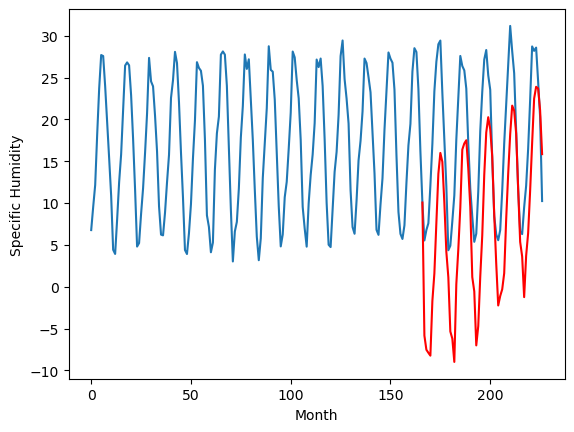

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
9.34		5.42		-3.92
5.80		3.73		-2.07
6.34		3.37		-2.97
8.45		3.02		-5.43
8.52		9.56		1.04
11.73		12.85		1.12
15.78		18.88		3.10
17.07		24.76		7.69
19.48		27.25		7.77
21.88		26.18		4.30
20.28		21.30		1.02
17.04		15.43		-1.61
10.32		12.39		2.07
8.27		5.91		-2.36
8.21		5.06		-3.15
7.29		2.27		-5.02
6.89		11.56		4.67
10.75		15.74		4.99
12.97		20.71		7.74
17.21		27.65		10.44
20.19		28.38		8.19
19.79		28.77		8.98
18.01		25.39		7.38
13.03		20.79		7.76
11.77		12.41		0.64
5.26		10.71		5.45
7.67		4.25		-3.42
8.54		6.57		-1.97
10.33		12.47		2.14
12.45		17.40		4.95
13.41		24.62		11.21
18.33		29.69		11.36
19.14		31.52		12.38
21.18		30.09		8.91
20.77		26.84		6.07
14.50		19.87		5.37
8.27		14.05		5.78
5.57		9.02		3.45
5.23		10.15		4.92
4.91		10.95		6.04
5.92		12.88		6.96
9.76		19.37		9.61
10.97		24.79		13.82
12.93		29.49		16.56
19.85		32.90		13.05
19.48		32.30		12.82
15.98		29.57		13.59
14.39		22.90		8.51
10.

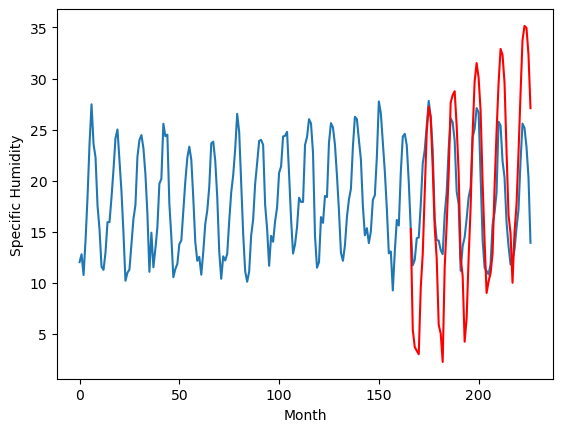

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.05		5.53		1.48
3.64		3.84		0.20
3.35		3.48		0.13
4.39		3.13		-1.26
9.62		9.67		0.05
10.92		12.96		2.04
13.52		18.99		5.47
18.81		24.87		6.06
21.80		27.36		5.56
20.80		26.29		5.49
16.77		21.41		4.64
12.85		15.54		2.69
8.24		12.50		4.26
1.24		6.02		4.78
0.83		5.17		4.34
1.33		2.38		1.05
8.21		11.67		3.46
11.00		15.85		4.85
15.02		20.82		5.80
19.31		27.76		8.45
20.88		28.49		7.61
20.97		28.88		7.91
16.86		25.50		8.64
13.58		20.90		7.32
4.67		12.52		7.85
6.59		10.82		4.23
0.11		4.36		4.25
4.13		6.68		2.55
8.24		12.58		4.34
11.53		17.51		5.98
16.38		24.73		8.35
20.14		29.80		9.66
21.58		31.63		10.05
20.20		30.20		10.00
16.89		26.95		10.06
9.58		19.98		10.40
7.46		14.16		6.70
0.93		9.13		8.20
4.13		10.26		6.13
7.15		11.06		3.91
7.60		12.99		5.39
11.12		19.48		8.36
13.90		24.90		11.00
17.56		29.60		12.04
21.15		33.01		11.86
20.60		32.41		11.81
16.64		29.68		13.04
11.35		23.01		11.66
5.45		16.73		

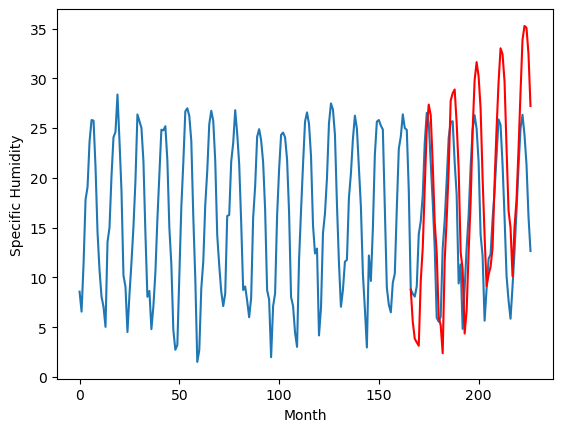

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.65		3.62		1.97
2.25		1.93		-0.32
1.81		1.57		-0.24
1.61		1.22		-0.39
7.65		7.76		0.11
8.08		11.05		2.97
12.12		17.08		4.96
17.49		22.96		5.47
20.78		25.45		4.67
19.52		24.38		4.86
15.57		19.50		3.93
10.91		13.63		2.72
5.86		10.59		4.73
-1.20		4.11		5.31
-0.87		3.26		4.13
0.48		0.47		-0.01
6.69		9.76		3.07
8.66		13.94		5.28
13.57		18.91		5.34
18.98		25.85		6.87
20.29		26.58		6.29
20.37		26.97		6.60
15.88		23.59		7.71
12.12		18.99		6.87
1.90		10.61		8.71
4.00		8.91		4.91
-2.87		2.45		5.32
1.72		4.77		3.05
6.27		10.67		4.40
9.43		15.60		6.17
15.67		22.82		7.15
19.32		27.89		8.57
20.67		29.72		9.05
19.42		28.29		8.87
15.27		25.04		9.77
7.99		18.07		10.08
5.54		12.25		6.71
0.08		7.22		7.14
2.00		8.35		6.35
4.79		9.15		4.36
5.32		11.08		5.76
10.21		17.57		7.36
13.56		22.99		9.43
16.47		27.69		11.22
20.02		31.10		11.08
19.31		30.50		11.19
16.53		27.77		11.24
10.48		21.10		10.62
4.27		14.82		10.55

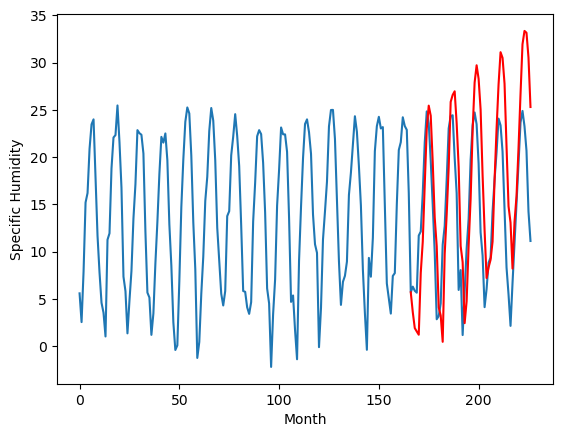

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[3.622425689697266, -1.7475743103027348, 3.5224256896972648, 0.05242568969726591, 0.09242568969726506, -2.237574310302734, 9.302425689697266, -5.837574310302735, 5.422425689697265, 5.532425689697266, 3.622425689697266]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   3.622426
1                 1    1.57  -1.747574
2                 2    5.66   3.522426
3                 3   -0.01   0.052426
4                 4   -0.32   0.092426
5                 5   -0.39  -2.237574
6                 6   10.42   9.302426
7                 7   -3.43  -5.837574
8                 8    9.34   5.422426
9                 9    4.05   5.532426
10               10    1.65   3.622426


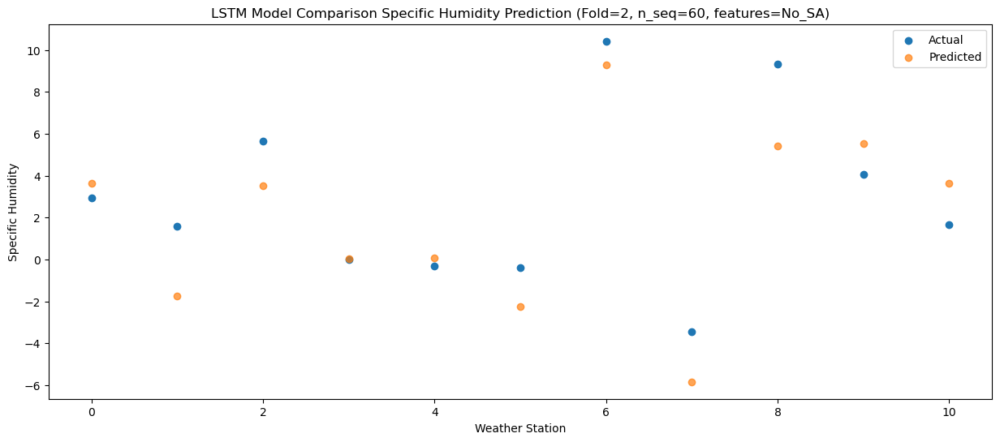

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   1.929963
1                 1   -0.71  -3.440035
2                 2    4.54   1.829964
3                 3   -3.07  -1.640035
4                 4    0.03  -1.600037
5                 5   -1.82  -3.930037
6                 6    8.61   7.609963
7                 7   -7.96  -7.530037
8                 8    5.80   3.729965
9                 9    3.64   3.839964
10               10    2.25   1.929964


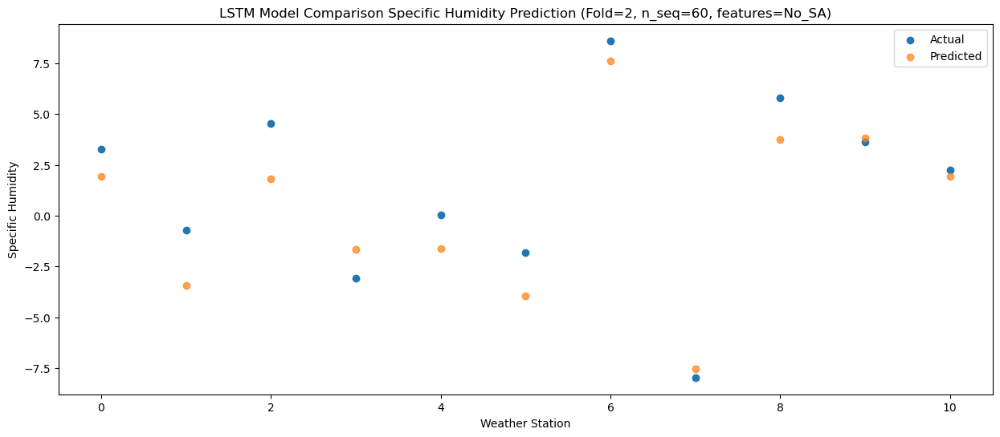

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   1.568326
1                 1   -0.95  -3.801672
2                 2    3.39   1.468327
3                 3   -2.80  -2.001672
4                 4    0.37  -1.961674
5                 5   -1.45  -4.291674
6                 6    8.96   7.248326
7                 7   -6.71  -7.891674
8                 8    6.34   3.368328
9                 9    3.35   3.478327
10               10    1.81   1.568327


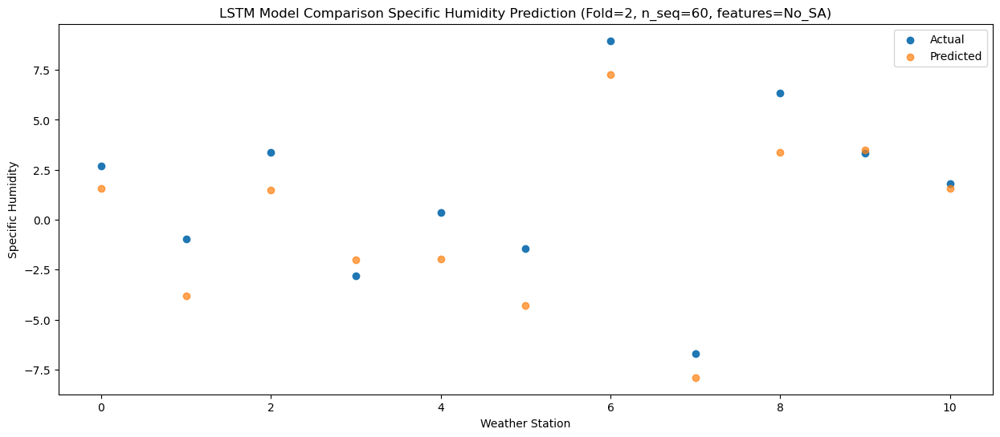

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   1.223859
1                 1   -1.68  -4.146139
2                 2    4.43   1.123860
3                 3   -2.65  -2.346139
4                 4    1.01  -2.306141
5                 5   -2.21  -4.636141
6                 6    8.40   6.903859
7                 7   -5.90  -8.236141
8                 8    8.45   3.023861
9                 9    4.39   3.133860
10               10    1.61   1.223860


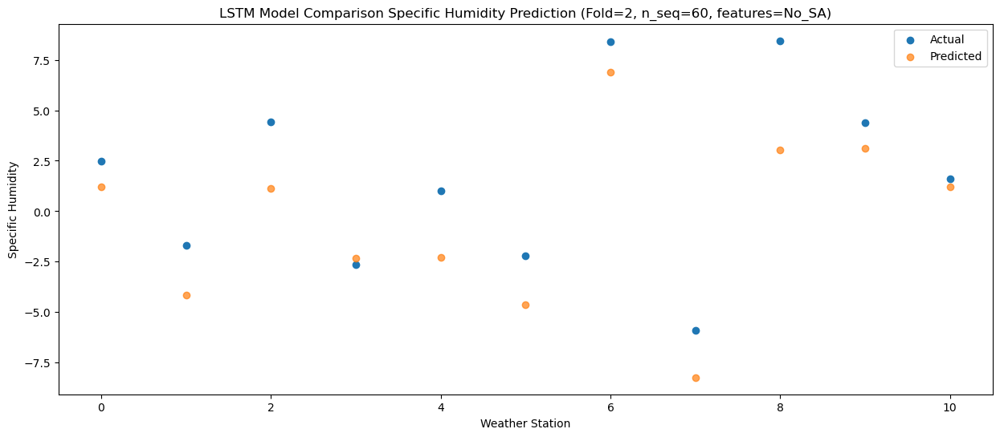

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   7.755408
1                 1    6.33   2.385409
2                 2    8.05   7.655409
3                 3    0.90   4.185409
4                 4    7.70   4.225408
5                 5    5.88   1.895408
6                 6   16.05  13.435408
7                 7   -1.40  -1.704592
8                 8    8.52   9.555409
9                 9    9.62   9.665409
10               10    7.65   7.755409


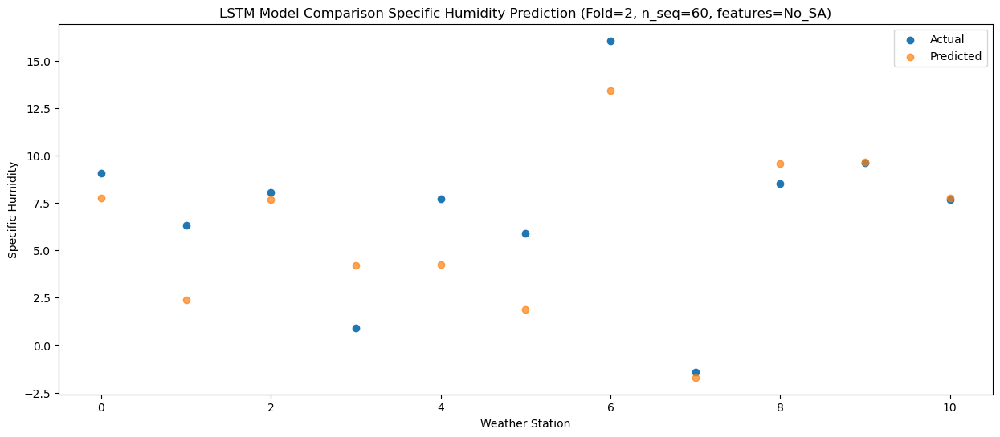

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  11.045193
1                 1    8.56   5.675197
2                 2    9.44  10.945196
3                 3    2.13   7.475195
4                 4    7.17   7.515195
5                 5    5.85   5.185193
6                 6   16.36  16.725193
7                 7    3.58   1.585193
8                 8   11.73  12.845195
9                 9   10.92  12.955194
10               10    8.08  11.045194


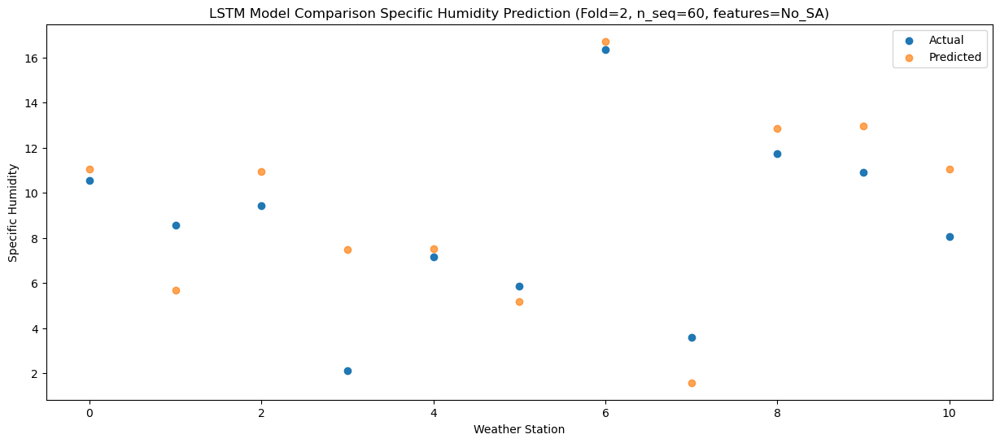

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  17.081482
1                 1   15.36  11.711486
2                 2   10.75  16.981485
3                 3    8.02  13.511484
4                 4   10.14  13.551484
5                 5    9.69  11.221482
6                 6   21.26  22.761484
7                 7    9.87   7.621482
8                 8   15.78  18.881484
9                 9   13.52  18.991483
10               10   12.12  17.081483


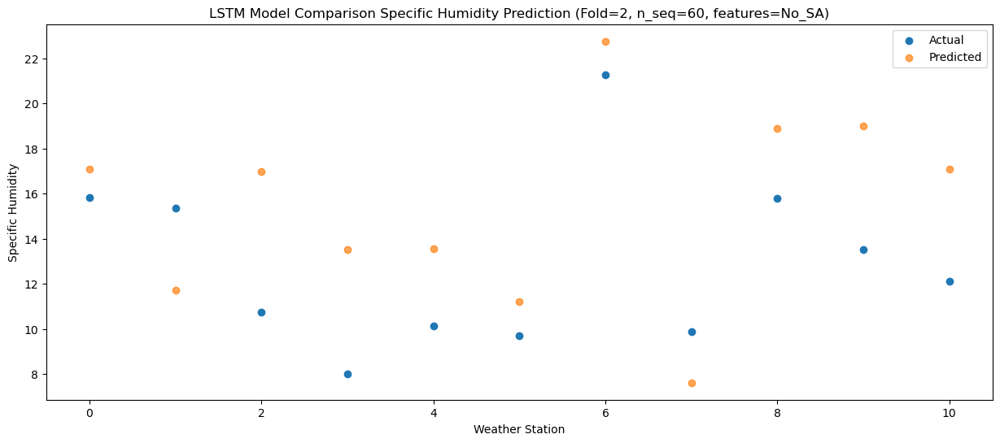

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  22.958760
1                 1   22.56  17.588764
2                 2   13.34  22.858763
3                 3   14.08  19.388761
4                 4   13.18  19.428762
5                 5   13.30  17.098760
6                 6   26.00  28.638761
7                 7   13.39  13.498760
8                 8   17.07  24.758761
9                 9   18.81  24.868761
10               10   17.49  22.958761


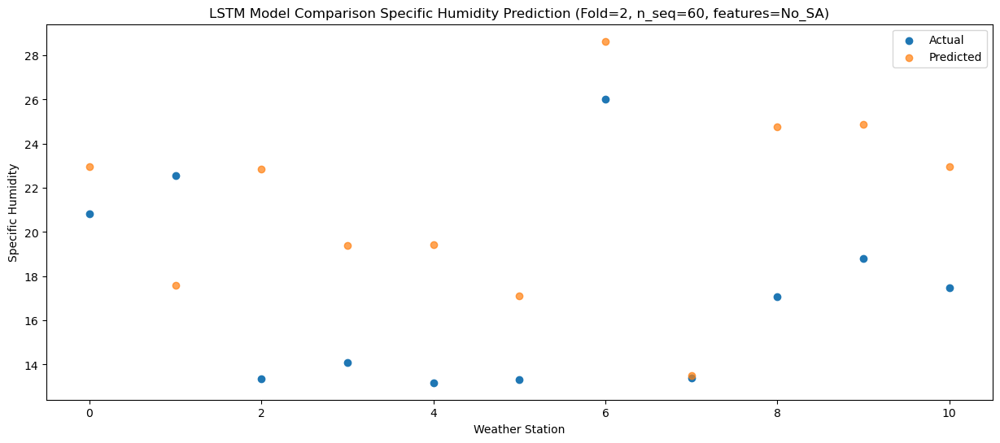

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  25.449757
1                 1   22.59  20.079761
2                 2   13.98  25.349760
3                 3   18.36  21.879759
4                 4   13.92  21.919759
5                 5   15.00  19.589757
6                 6   27.18  31.129759
7                 7   15.49  15.989757
8                 8   19.48  27.249759
9                 9   21.80  27.359758
10               10   20.78  25.449758


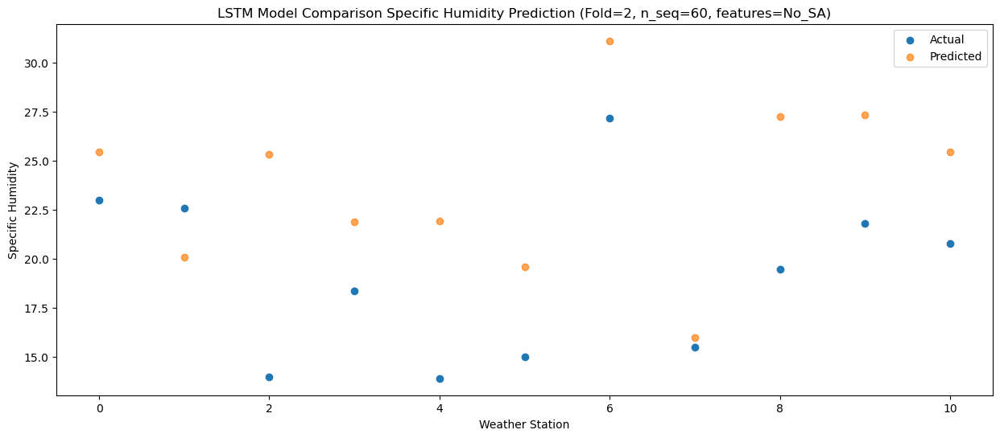

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  24.383953
1                 1   21.26  19.013957
2                 2   13.67  24.283956
3                 3   16.51  20.813955
4                 4   14.29  20.853955
5                 5   15.30  18.523953
6                 6   27.41  30.063955
7                 7   15.93  14.923953
8                 8   21.88  26.183955
9                 9   20.80  26.293954
10               10   19.52  24.383954


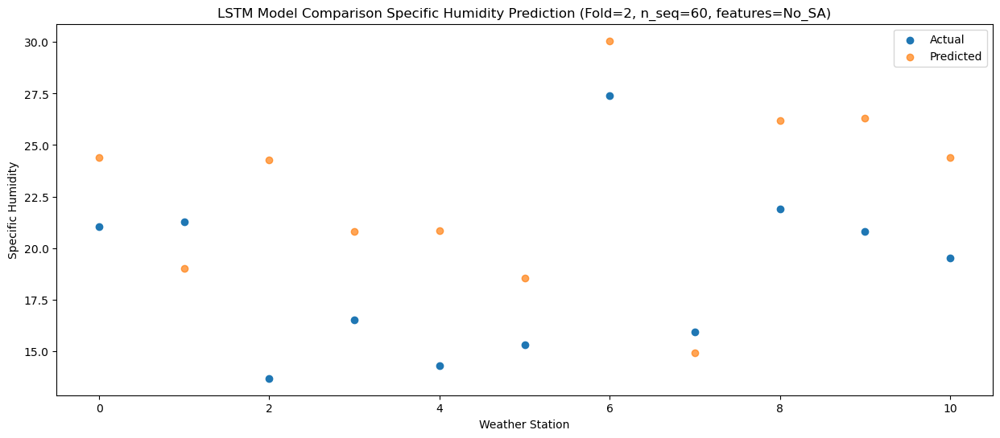

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  19.501920
1                 1   15.13  14.131924
2                 2   12.41  19.401923
3                 3   11.93  15.931921
4                 4   11.94  15.971922
5                 5   10.90  13.641920
6                 6   21.47  25.181921
7                 7    9.68  10.041920
8                 8   20.28  21.301921
9                 9   16.77  21.411920
10               10   15.57  19.501920


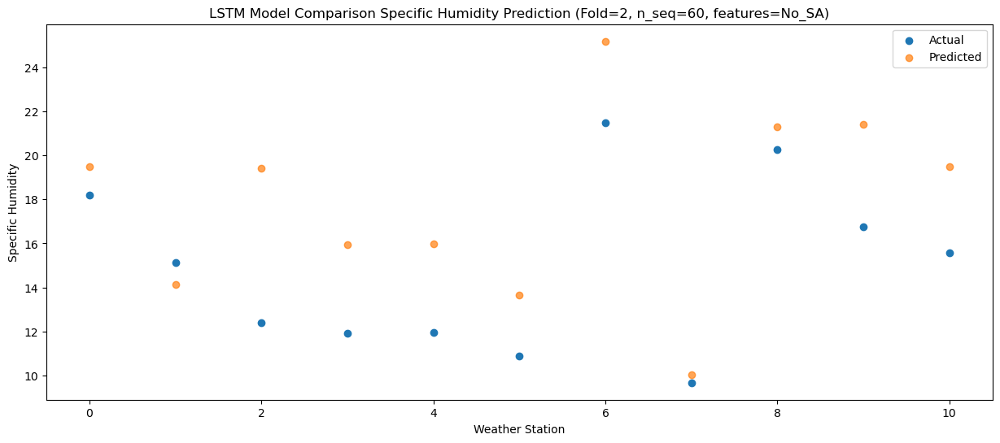

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  13.630315
1                 1    8.14   8.260320
2                 2   11.14  13.530318
3                 3    6.71  10.060317
4                 4    8.25  10.100317
5                 5    6.43   7.770315
6                 6   15.99  19.310317
7                 7    4.08   4.170315
8                 8   17.04  15.430317
9                 9   12.85  15.540316
10               10   10.91  13.630316


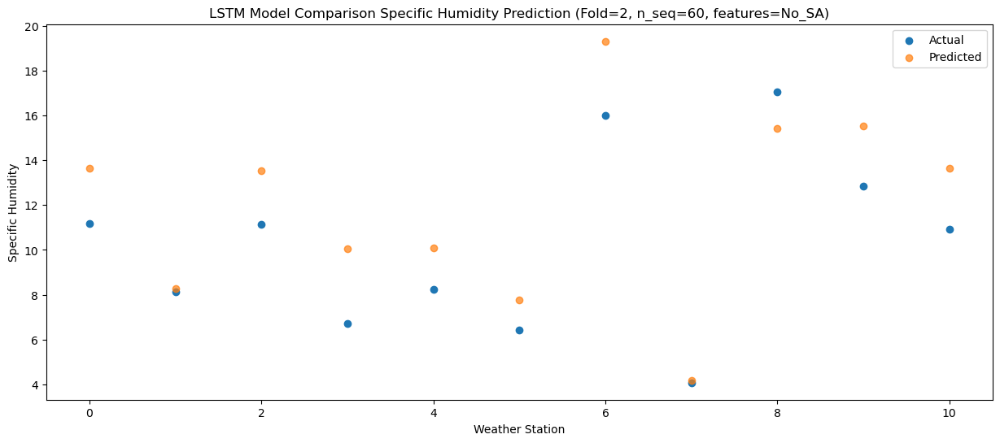

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04  10.591734
1                 1    5.02   5.221740
2                 2    7.72  10.491737
3                 3    2.75   7.021736
4                 4    4.13   7.061736
5                 5    3.75   4.731734
6                 6   13.50  16.271736
7                 7   -1.48   1.131734
8                 8   10.32  12.391736
9                 9    8.24  12.501735
10               10    5.86  10.591735


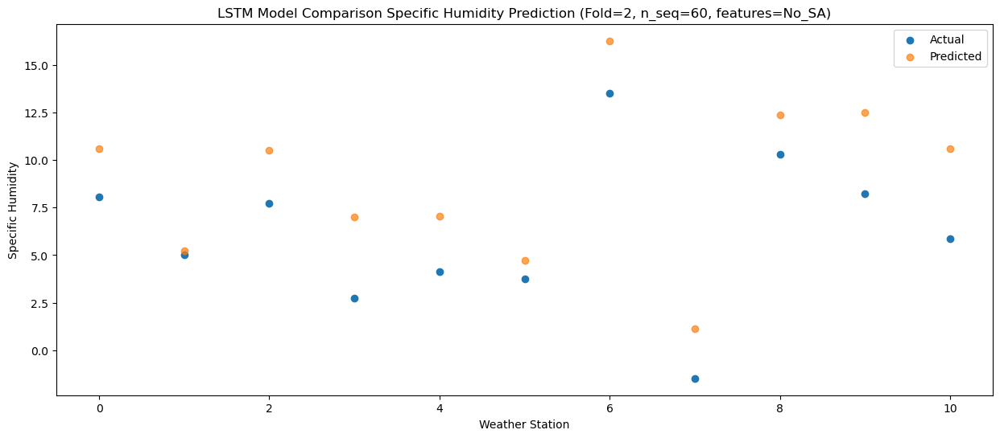

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   4.114941
1                 1   -1.61  -1.255053
2                 2    0.73   4.014944
3                 3   -4.08   0.544943
4                 4   -2.17   0.584943
5                 5   -2.36  -1.745059
6                 6    7.04   9.794943
7                 7   -9.13  -5.345059
8                 8    8.27   5.914943
9                 9    1.24   6.024942
10               10   -1.20   4.114942


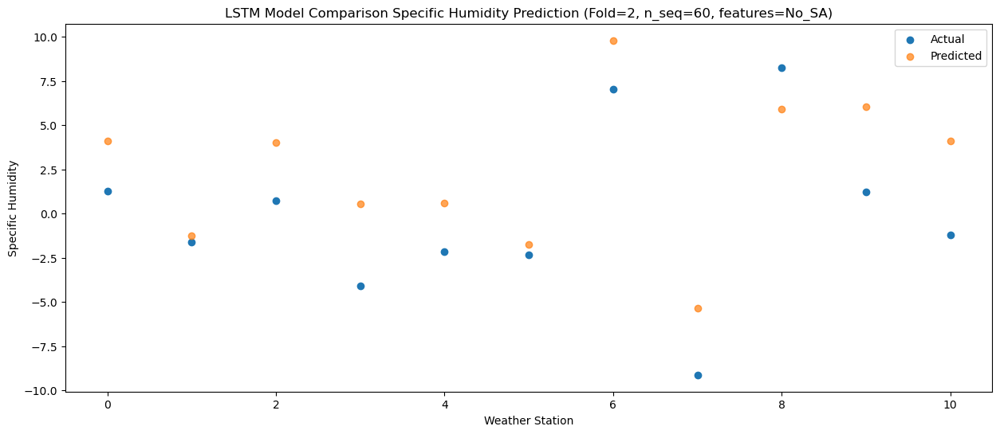

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   3.256740
1                 1   -1.69  -2.113254
2                 2    1.39   3.156744
3                 3   -7.16  -0.313258
4                 4   -1.82  -0.273257
5                 5   -2.95  -2.603260
6                 6    6.34   8.936742
7                 7   -8.59  -6.203260
8                 8    8.21   5.056742
9                 9    0.83   5.166741
10               10   -0.87   3.256741


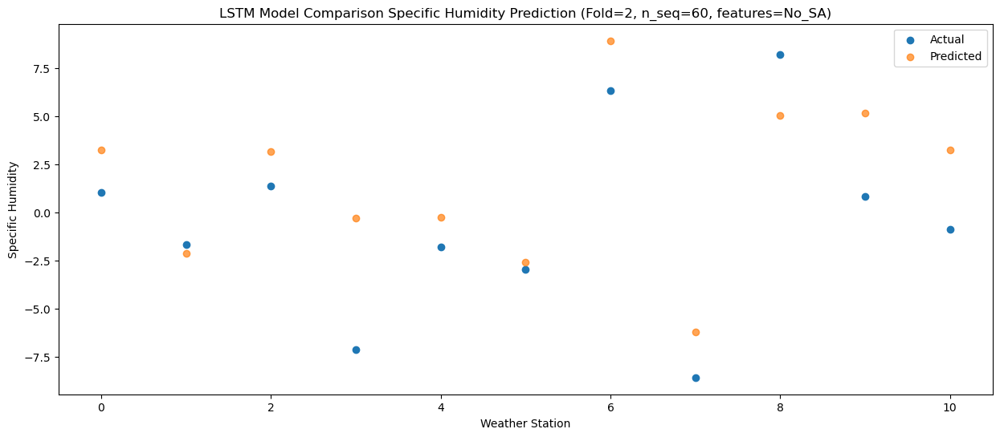

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38   0.474612
1                 1   -5.73  -4.895382
2                 2    4.12   0.374615
3                 3   -7.14  -3.095386
4                 4   -2.56  -3.055386
5                 5   -5.30  -5.385388
6                 6    3.23   6.154614
7                 7   -5.67  -8.985388
8                 8    7.29   2.274614
9                 9    1.33   2.384613
10               10    0.48   0.474613


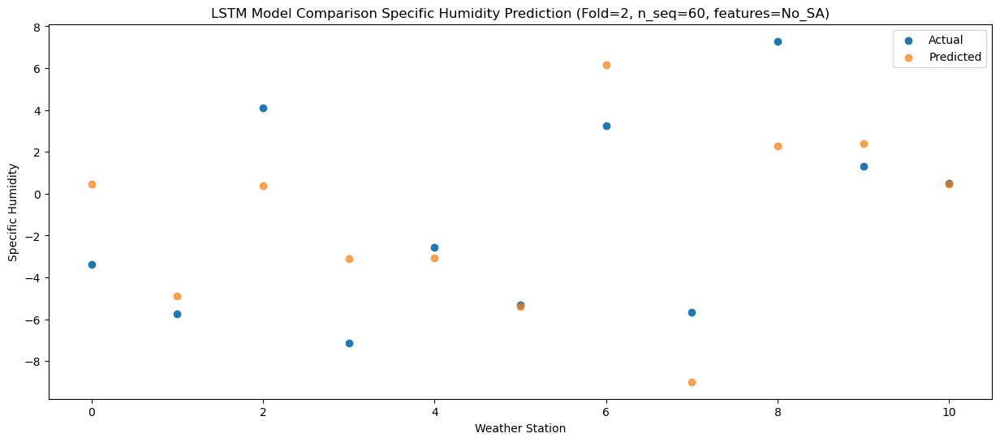

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   9.763796
1                 1    4.46   4.393802
2                 2    5.93   9.663799
3                 3   -3.03   6.193798
4                 4    4.77   6.233798
5                 5    3.08   3.903796
6                 6   13.60  15.443798
7                 7   -2.57   0.303796
8                 8    6.89  11.563798
9                 9    8.21  11.673797
10               10    6.69   9.763797


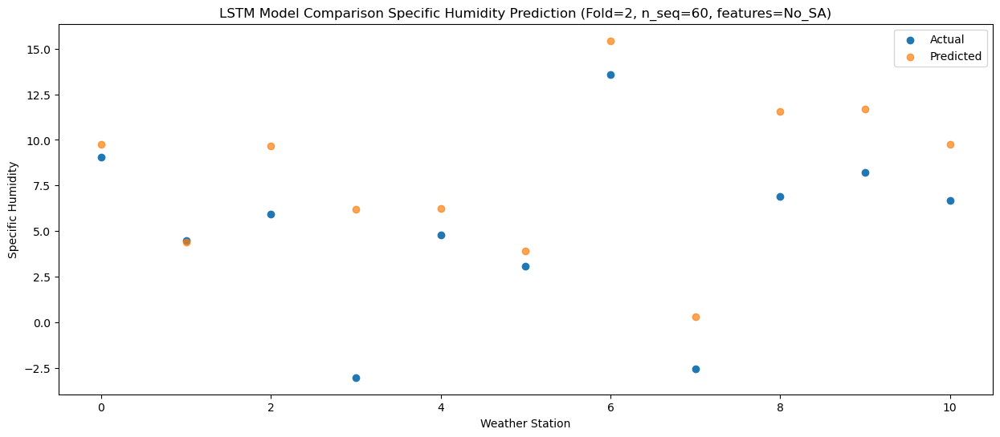

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  13.941427
1                 1    8.22   8.571433
2                 2    7.74  13.841430
3                 3    1.47  10.371429
4                 4    5.64  10.411429
5                 5    5.20   8.081427
6                 6   15.30  19.621429
7                 7    4.09   4.481427
8                 8   10.75  15.741429
9                 9   11.00  15.851428
10               10    8.66  13.941428


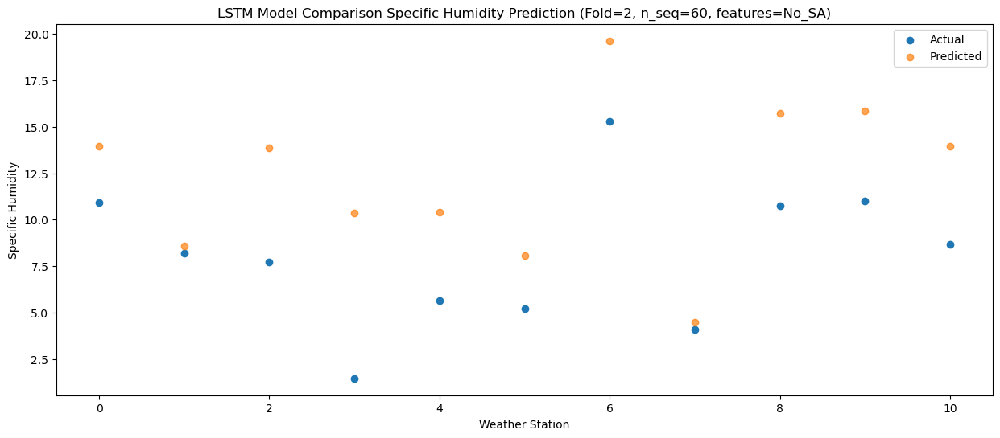

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  18.909573
1                 1   13.40  13.539579
2                 2   11.32  18.809576
3                 3    6.73  15.339575
4                 4   10.11  15.379575
5                 5    9.24  13.049573
6                 6   19.38  24.589575
7                 7    9.10   9.449573
8                 8   12.97  20.709575
9                 9   15.02  20.819574
10               10   13.57  18.909574


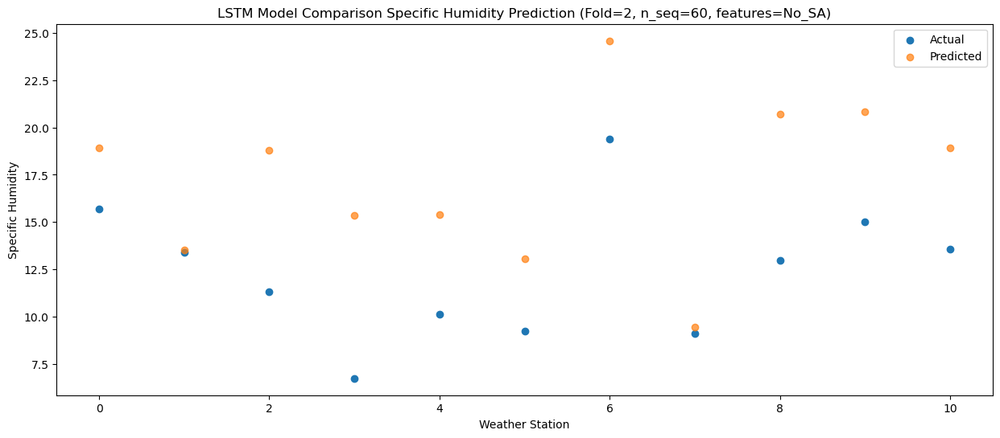

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  25.848695
1                 1   20.65  20.478701
2                 2   12.54  25.748698
3                 3   12.30  22.278697
4                 4   13.59  22.318697
5                 5   13.79  19.988695
6                 6   24.94  31.528697
7                 7   14.09  16.388695
8                 8   17.21  27.648697
9                 9   19.31  27.758696
10               10   18.98  25.848696


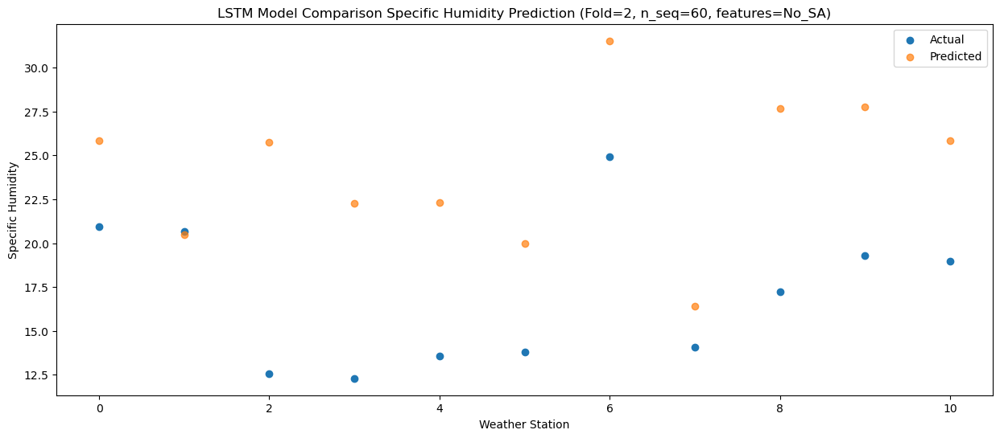

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  26.581614
1                 1   21.34  21.211622
2                 2   13.33  26.481617
3                 3   14.30  23.011618
4                 4   14.18  23.051616
5                 5   13.87  20.721614
6                 6   25.83  32.261616
7                 7   12.89  17.121614
8                 8   20.19  28.381618
9                 9   20.88  28.491617
10               10   20.29  26.581617


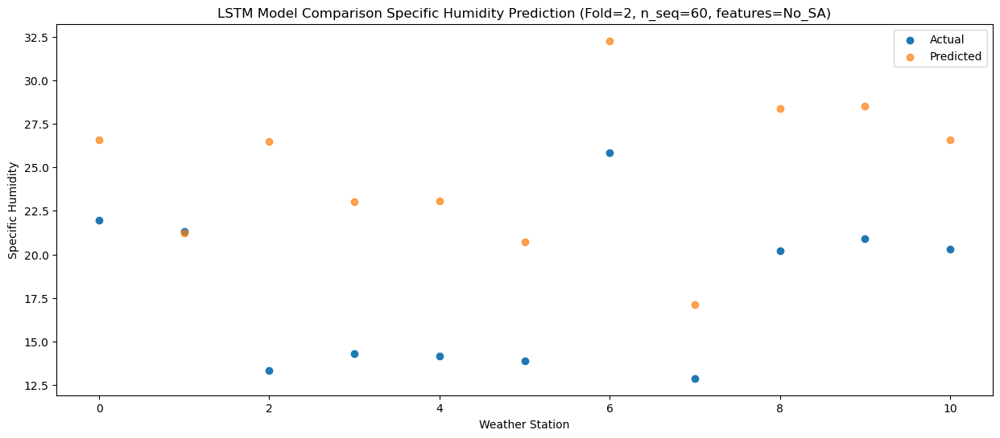

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  26.968074
1                 1   22.10  21.598082
2                 2   13.38  26.868077
3                 3   15.36  23.398078
4                 4   14.35  23.438077
5                 5   14.98  21.108074
6                 6   26.39  32.648076
7                 7   12.37  17.508074
8                 8   19.79  28.768078
9                 9   20.97  28.878077
10               10   20.37  26.968077


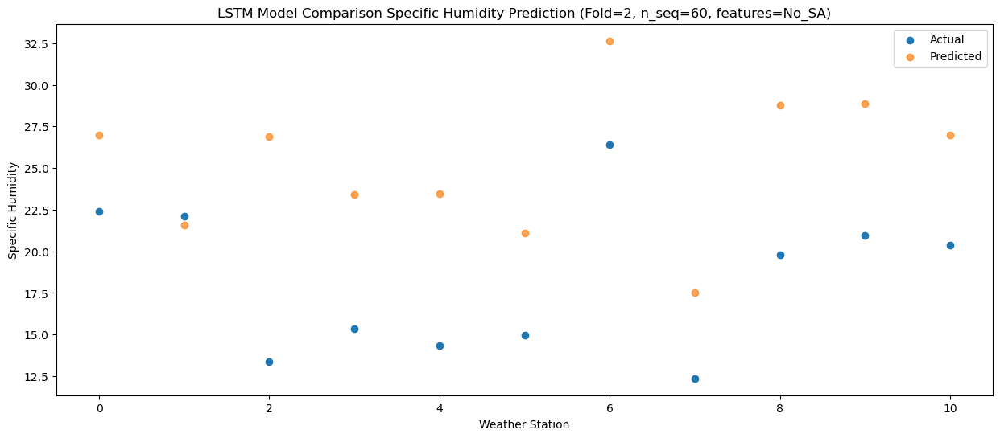

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  23.587803
1                 1   19.86  18.217811
2                 2   12.10  23.487806
3                 3   12.19  20.017807
4                 4   11.81  20.057805
5                 5   12.24  17.727803
6                 6   24.12  29.267804
7                 7   10.19  14.127802
8                 8   18.01  25.387806
9                 9   16.86  25.497806
10               10   15.88  23.587806


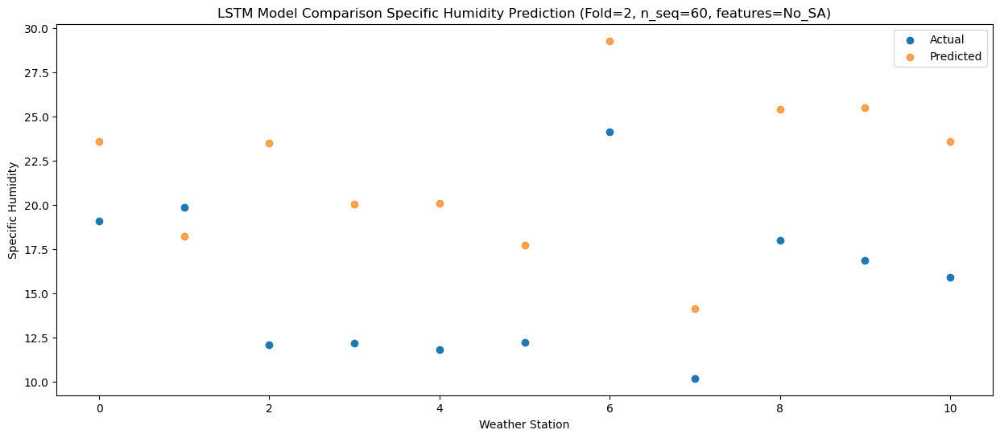

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  18.989006
1                 1   11.60  13.619014
2                 2   10.96  18.889009
3                 3    8.36  15.419010
4                 4    9.07  15.459009
5                 5    8.94  13.129006
6                 6   19.61  24.669007
7                 7    3.63   9.529005
8                 8   13.03  20.789009
9                 9   13.58  20.899009
10               10   12.12  18.989009


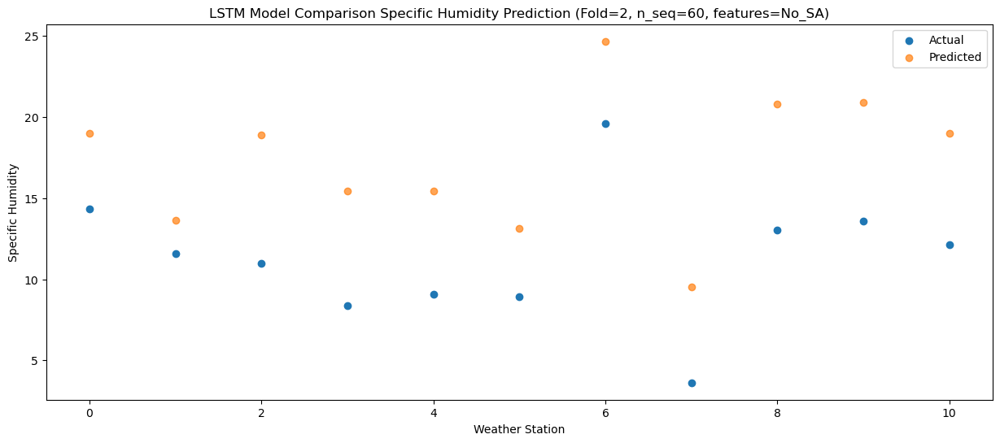

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73  10.607398
1                 1    4.89   5.237407
2                 2    4.11  10.507402
3                 3    0.28   7.037403
4                 4    0.80   7.077401
5                 5    1.30   4.747399
6                 6   11.64  16.287400
7                 7   -1.77   1.147398
8                 8   11.77  12.407402
9                 9    4.67  12.517402
10               10    1.90  10.607402


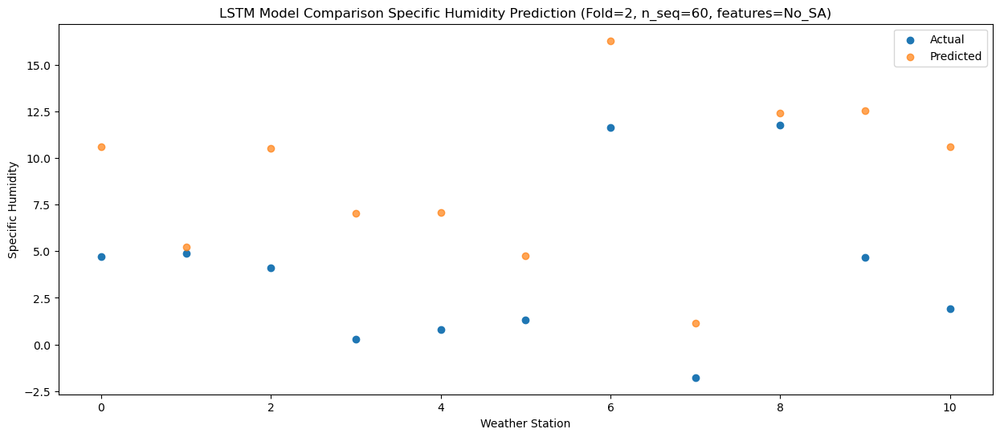

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   8.910092
1                 1    2.50   3.540100
2                 2    5.01   8.810095
3                 3   -1.64   5.340096
4                 4    4.21   5.380095
5                 5    4.54   3.050093
6                 6   13.93  14.590094
7                 7   -5.12  -0.549908
8                 8    5.26  10.710095
9                 9    6.59  10.820095
10               10    4.00   8.910095


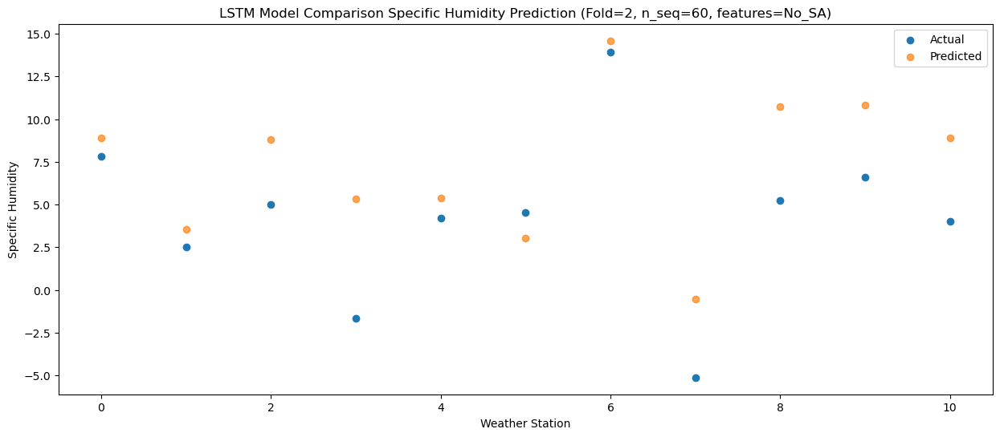

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48   2.450287
1                 1   -2.19  -2.919705
2                 2    0.75   2.350290
3                 3   -7.79  -1.119709
4                 4   -3.52  -1.079710
5                 5   -3.89  -3.409712
6                 6    5.45   8.130289
7                 7   -8.12  -7.009713
8                 8    7.67   4.250290
9                 9    0.11   4.360290
10               10   -2.87   2.450290


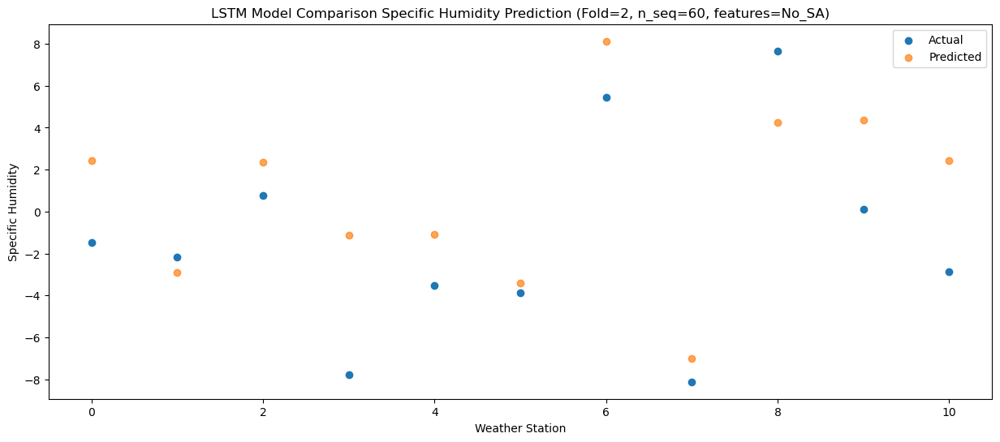

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76   4.769772
1                 1   -2.20  -0.600220
2                 2    3.08   4.669775
3                 3   -5.47   1.199776
4                 4   -0.38   1.239775
5                 5   -4.27  -1.090227
6                 6    5.28  10.449774
7                 7   -7.15  -4.690228
8                 8    8.54   6.569775
9                 9    4.13   6.679775
10               10    1.72   4.769775


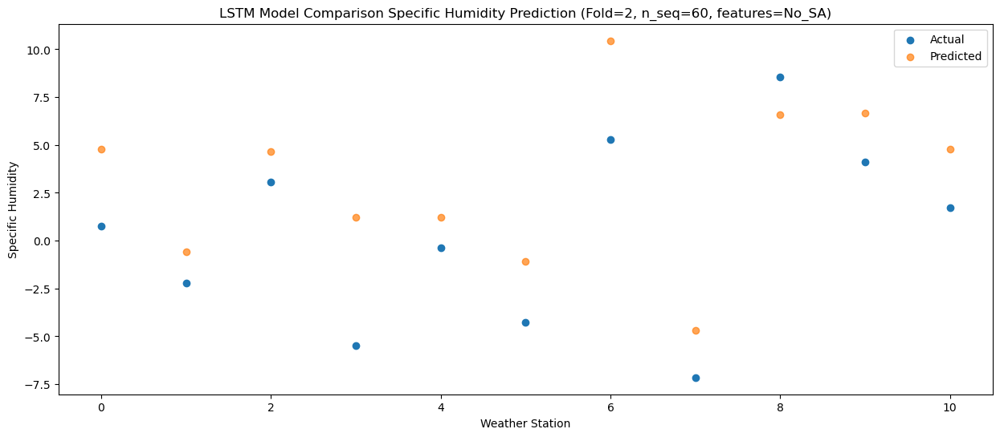

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05  10.673170
1                 1    4.78   5.303178
2                 2    6.55  10.573171
3                 3   -1.61   7.103174
4                 4    3.38   7.143171
5                 5    1.85   4.813171
6                 6   11.86  16.353172
7                 7   -2.09   1.213170
8                 8   10.33  12.473173
9                 9    8.24  12.583173
10               10    6.27  10.673171


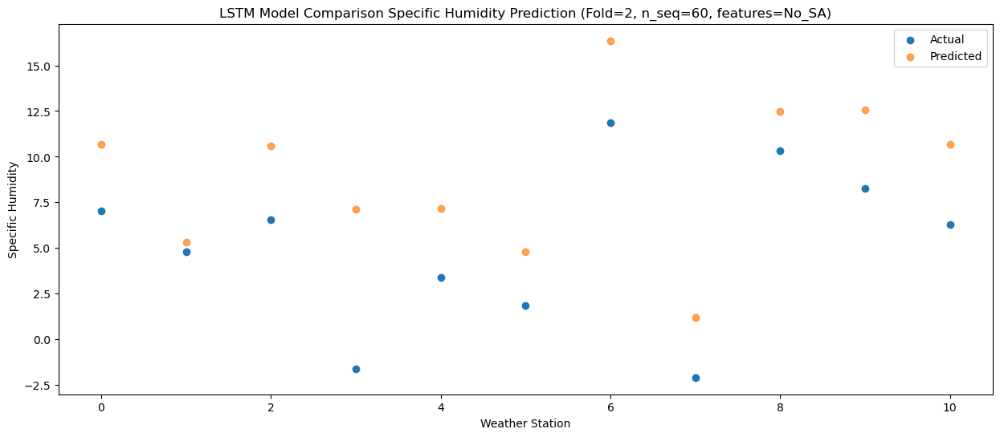

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  15.600978
1                 1   11.46  10.230986
2                 2    8.36  15.500979
3                 3    2.83  12.030981
4                 4    7.18  12.070979
5                 5    8.00   9.740979
6                 6   18.13  21.280980
7                 7    5.10   6.140978
8                 8   12.45  17.400981
9                 9   11.53  17.510981
10               10    9.43  15.600979


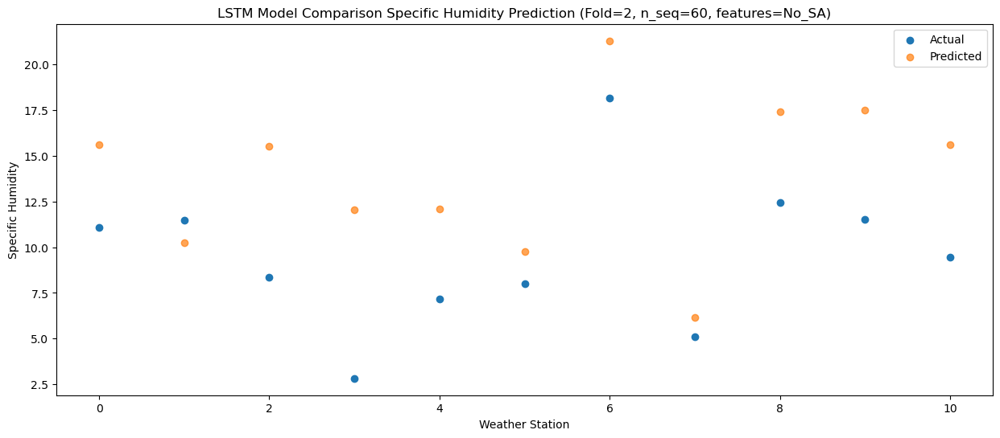

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  22.823180
1                 1   17.26  17.453188
2                 2   11.12  22.723181
3                 3    8.17  19.253184
4                 4   12.34  19.293181
5                 5   12.60  16.963181
6                 6   23.15  28.503182
7                 7    9.80  13.363180
8                 8   13.41  24.623183
9                 9   16.38  24.733183
10               10   15.67  22.823181


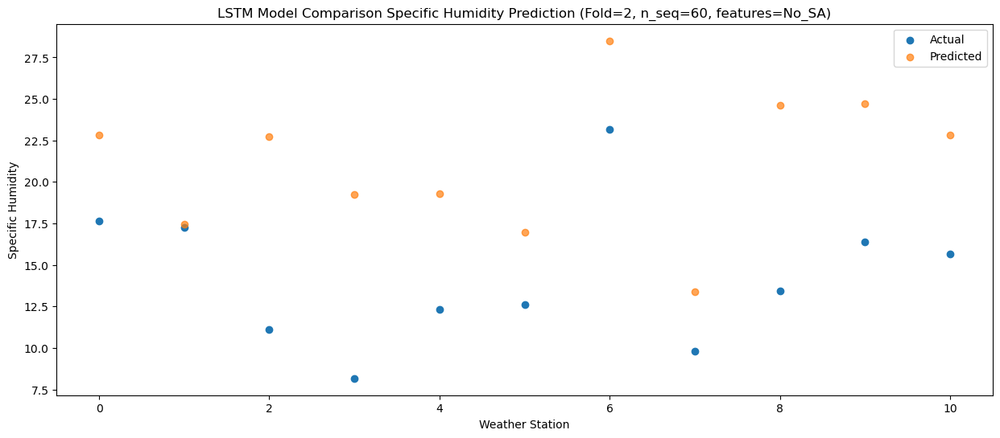

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  27.888678
1                 1   21.06  22.518686
2                 2   12.93  27.788679
3                 3   12.41  24.318682
4                 4   14.93  24.358679
5                 5   16.32  22.028679
6                 6   27.86  33.568680
7                 7   13.66  18.428678
8                 8   18.33  29.688681
9                 9   20.14  29.798681
10               10   19.32  27.888679


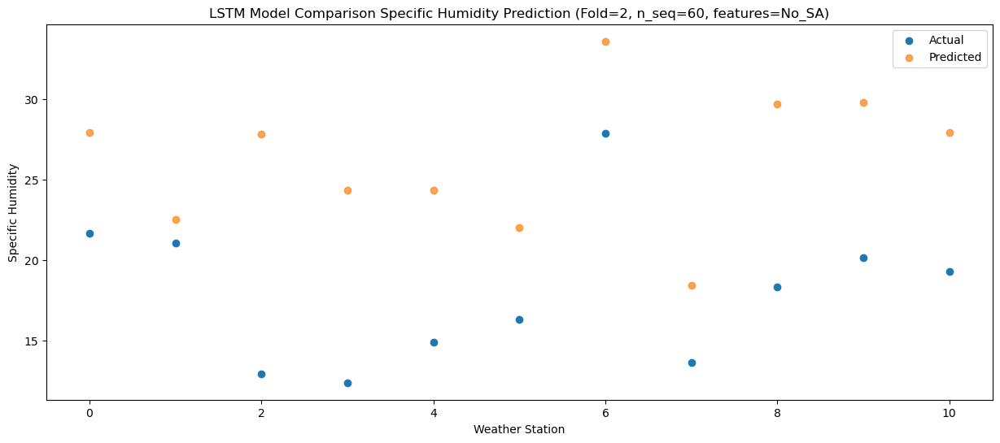

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  29.719618
1                 1   24.30  24.349628
2                 2   13.11  29.619619
3                 3   17.03  26.149622
4                 4   14.76  26.189619
5                 5   17.68  23.859619
6                 6   30.65  35.399620
7                 7   14.80  20.259618
8                 8   19.14  31.519621
9                 9   21.58  31.629621
10               10   20.67  29.719619


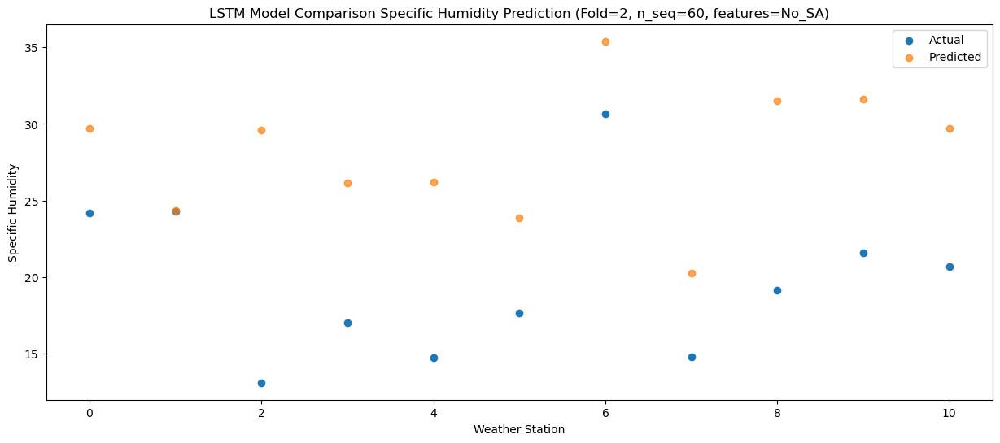

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  28.291116
1                 1   21.99  22.921126
2                 2   12.54  28.191118
3                 3   16.95  24.721120
4                 4   13.94  24.761118
5                 5   14.96  22.431117
6                 6   27.84  33.971118
7                 7   11.78  18.831116
8                 8   21.18  30.091119
9                 9   20.20  30.201119
10               10   19.42  28.291117


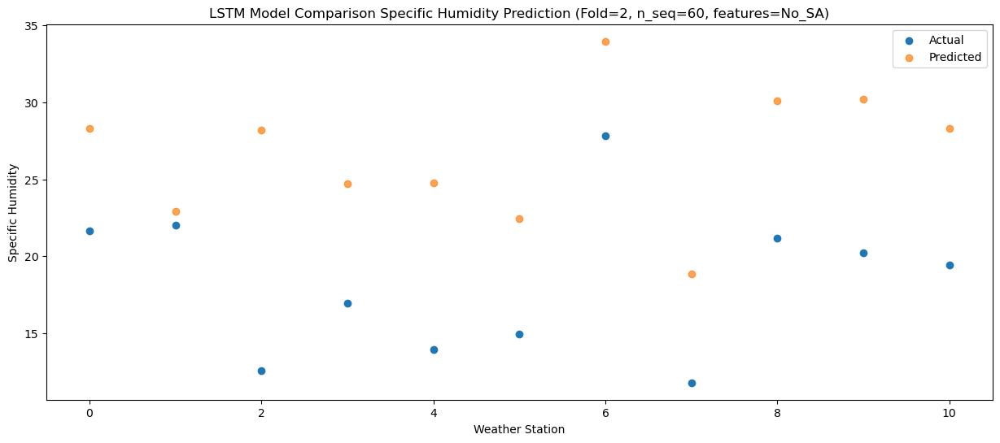

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  25.036233
1                 1   19.23  19.666243
2                 2   11.13  24.936234
3                 3   11.91  21.466237
4                 4   11.97  21.506234
5                 5   12.30  19.176234
6                 6   24.01  30.716235
7                 7   10.05  15.576233
8                 8   20.77  26.836236
9                 9   16.89  26.946236
10               10   15.27  25.036234


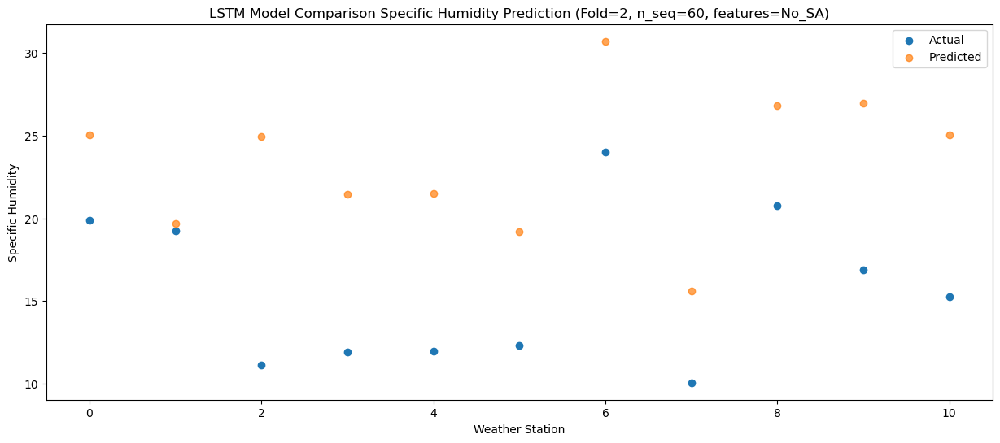

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  18.073448
1                 1   10.85  12.703458
2                 2    8.50  17.973450
3                 3    6.47  14.503452
4                 4    5.78  14.543450
5                 5    6.73  12.213449
6                 6   17.63  23.753450
7                 7    1.84   8.613448
8                 8   14.50  19.873451
9                 9    9.58  19.983450
10               10    7.99  18.073450


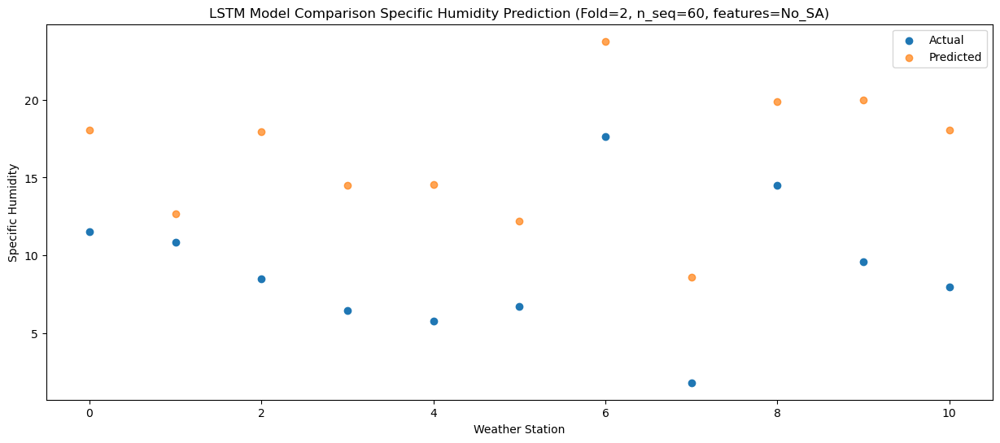

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41  12.252595
1                 1    0.86   6.882605
2                 2    6.74  12.152596
3                 3    2.67   8.682599
4                 4    2.71   8.722596
5                 5    0.85   6.392596
6                 6   10.96  17.932597
7                 7   -5.05   2.792595
8                 8    8.27  14.052598
9                 9    7.46  14.162597
10               10    5.54  12.252596


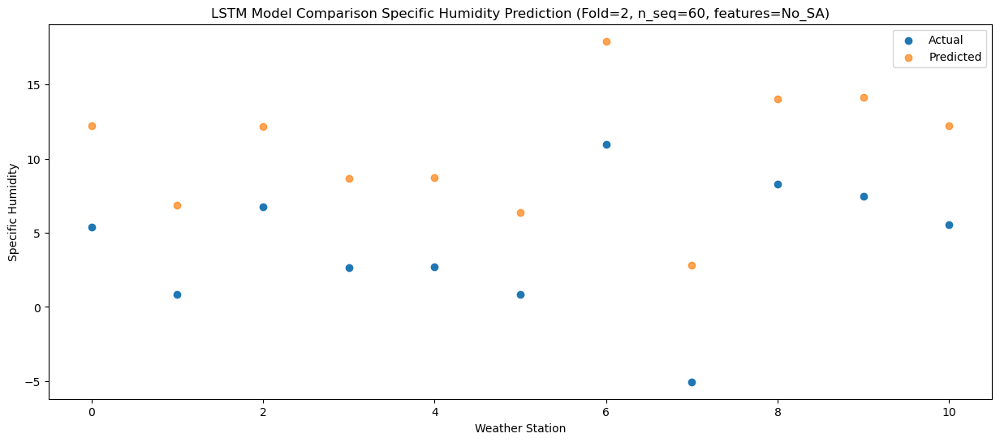

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   7.222084
1                 1   -1.85   1.852094
2                 2    2.64   7.122086
3                 3   -3.50   3.652088
4                 4    0.20   3.692086
5                 5   -1.38   1.362085
6                 6    8.34  12.902086
7                 7   -7.22  -2.237916
8                 8    5.57   9.022087
9                 9    0.93   9.132086
10               10    0.08   7.222085


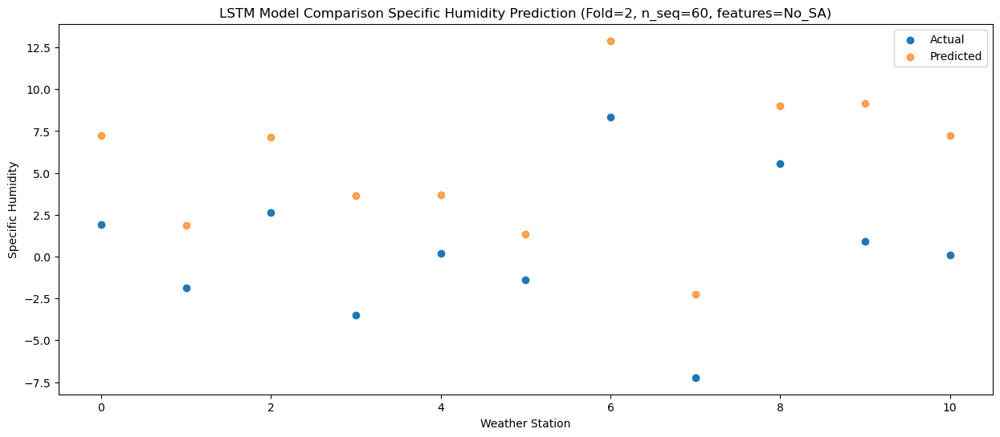

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   8.351814
1                 1   -2.10   2.981824
2                 2    2.44   8.251816
3                 3   -2.21   4.781818
4                 4    1.37   4.821816
5                 5   -0.62   2.491815
6                 6    9.22  14.031816
7                 7   -7.93  -1.108186
8                 8    5.23  10.151817
9                 9    4.13  10.261816
10               10    2.00   8.351815


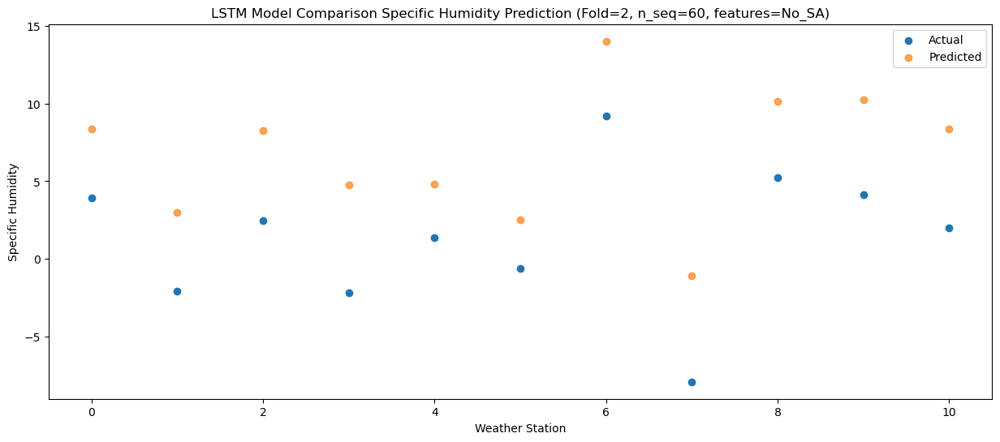

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   9.153630
1                 1   -0.50   3.783640
2                 2    5.50   9.053631
3                 3   -4.09   5.583634
4                 4    3.50   5.623631
5                 5    0.57   3.293631
6                 6    9.41  14.833632
7                 7   -6.72  -0.306370
8                 8    4.91  10.953633
9                 9    7.15  11.063632
10               10    4.79   9.153631


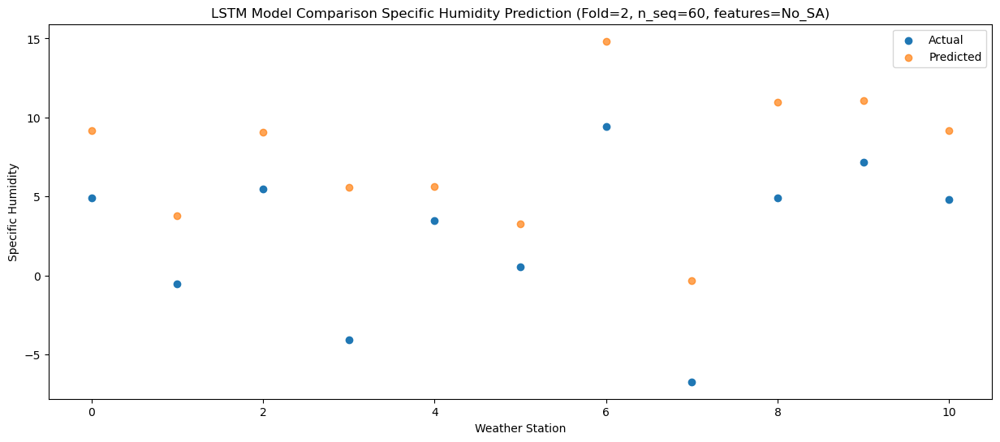

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21  11.076283
1                 1    3.57   5.706293
2                 2    6.52  10.976284
3                 3   -1.65   7.506287
4                 4    5.33   7.546284
5                 5    4.37   5.216284
6                 6   14.06  16.756285
7                 7   -2.02   1.616283
8                 8    5.92  12.876286
9                 9    7.60  12.986285
10               10    5.32  11.076284


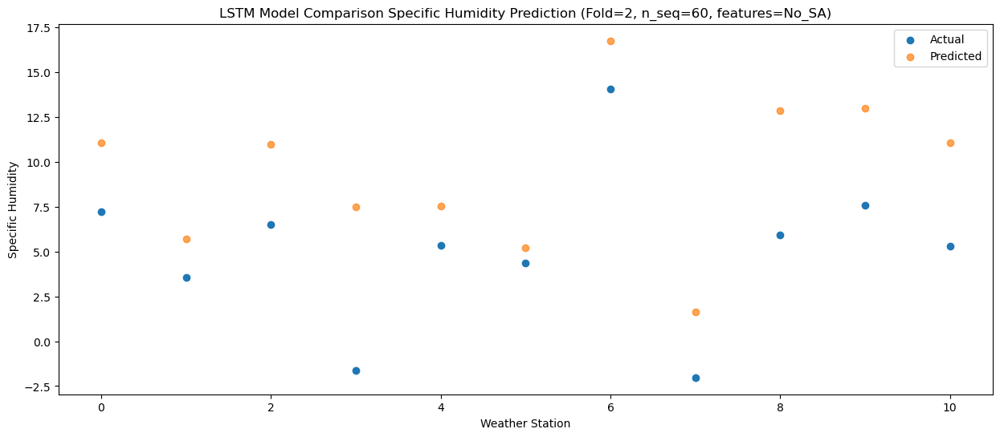

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  17.570636
1                 1    9.43  12.200646
2                 2    9.06  17.470637
3                 3    4.07  14.000640
4                 4    7.25  14.040637
5                 5    5.29  11.710637
6                 6   15.88  23.250638
7                 7    3.62   8.110636
8                 8    9.76  19.370639
9                 9   11.12  19.480638
10               10   10.21  17.570637


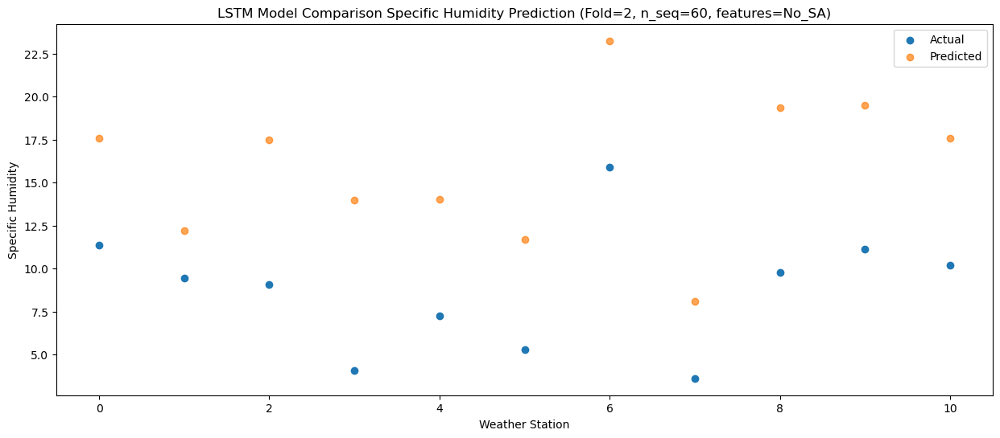

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  22.990736
1                 1   14.92  17.620746
2                 2   10.04  22.890737
3                 3    7.70  19.420740
4                 4   11.28  19.460737
5                 5   10.37  17.130737
6                 6   21.62  28.670738
7                 7    8.27  13.530736
8                 8   10.97  24.790739
9                 9   13.90  24.900738
10               10   13.56  22.990737


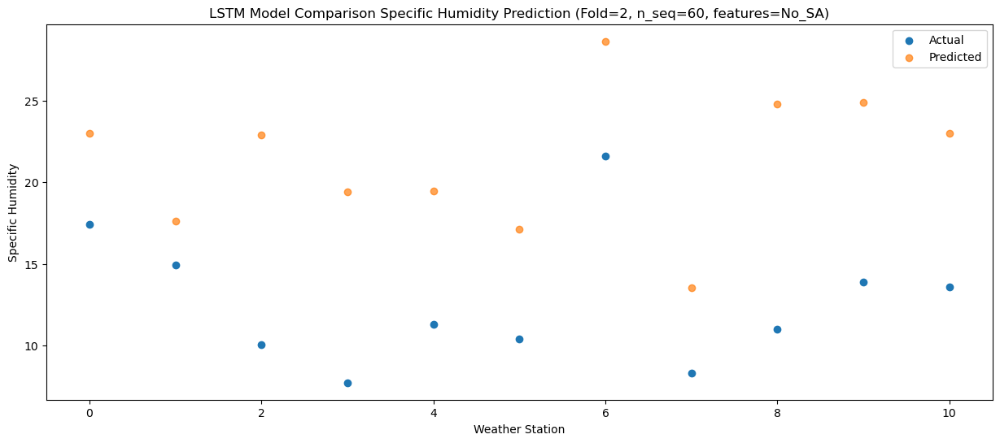

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  27.688038
1                 1   17.53  22.318048
2                 2   12.45  27.588039
3                 3   11.49  24.118042
4                 4   14.93  24.158039
5                 5   15.29  21.828039
6                 6   25.77  33.368040
7                 7   12.93  18.228038
8                 8   12.93  29.488041
9                 9   17.56  29.598040
10               10   16.47  27.688039


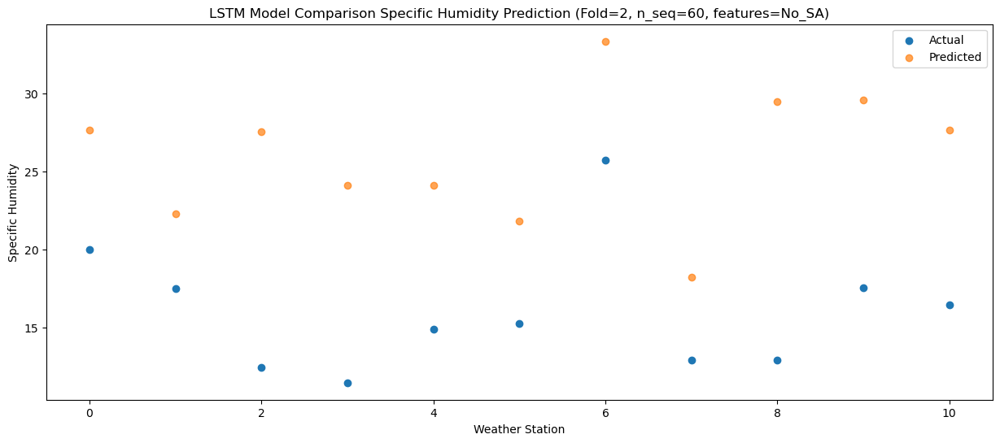

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  31.104799
1                 1   21.63  25.734808
2                 2   14.36  31.004800
3                 3   17.06  27.534802
4                 4   16.37  27.574800
5                 5   17.45  25.244799
6                 6   28.33  36.784800
7                 7   17.68  21.644799
8                 8   19.85  32.904801
9                 9   21.15  33.014800
10               10   20.02  31.104800


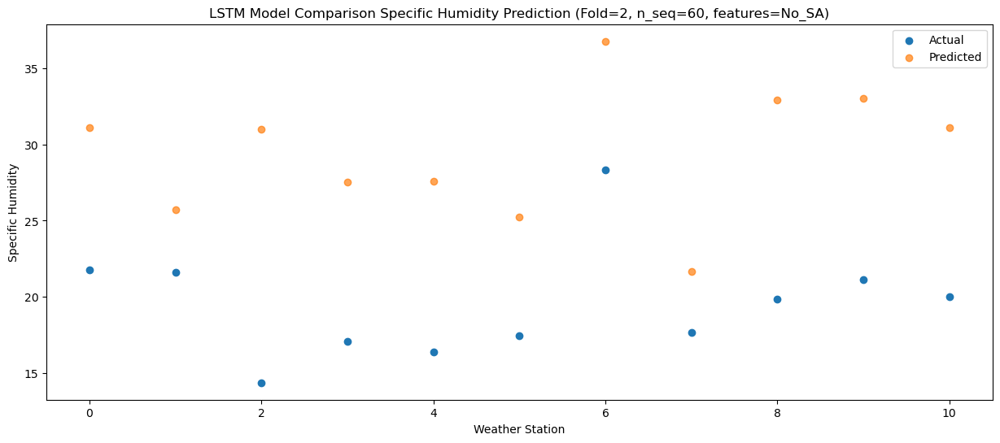

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  30.500658
1                 1   22.12  25.130667
2                 2   14.54  30.400659
3                 3   15.05  26.930661
4                 4   17.67  26.970659
5                 5   19.15  24.640658
6                 6   30.67  36.180659
7                 7   14.68  21.040658
8                 8   19.48  32.300660
9                 9   20.60  32.410659
10               10   19.31  30.500659


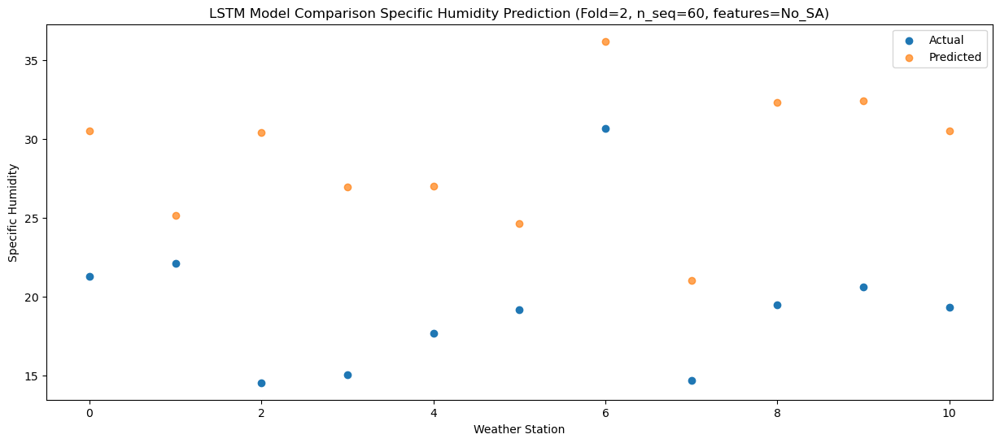

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  27.767282
1                 1   19.25  22.397292
2                 2   12.59  27.667283
3                 3   12.63  24.197286
4                 4   13.24  24.237283
5                 5   14.67  21.907283
6                 6   25.89  33.447284
7                 7   12.02  18.307282
8                 8   15.98  29.567285
9                 9   16.64  29.677284
10               10   16.53  27.767283


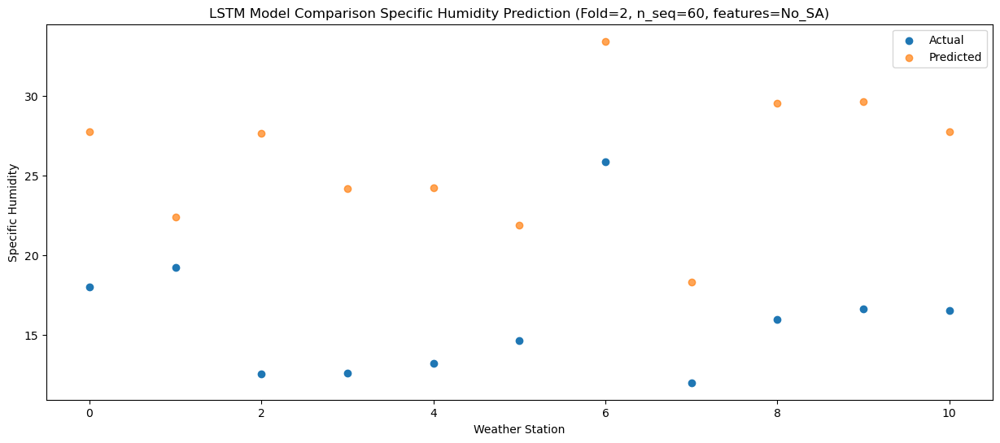

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  21.101108
1                 1   10.21  15.731118
2                 2    9.01  21.001109
3                 3    7.61  17.531112
4                 4    7.08  17.571109
5                 5    6.78  15.241109
6                 6   17.17  26.781110
7                 7    5.28  11.641108
8                 8   14.39  22.901111
9                 9   11.35  23.011110
10               10   10.48  21.101109


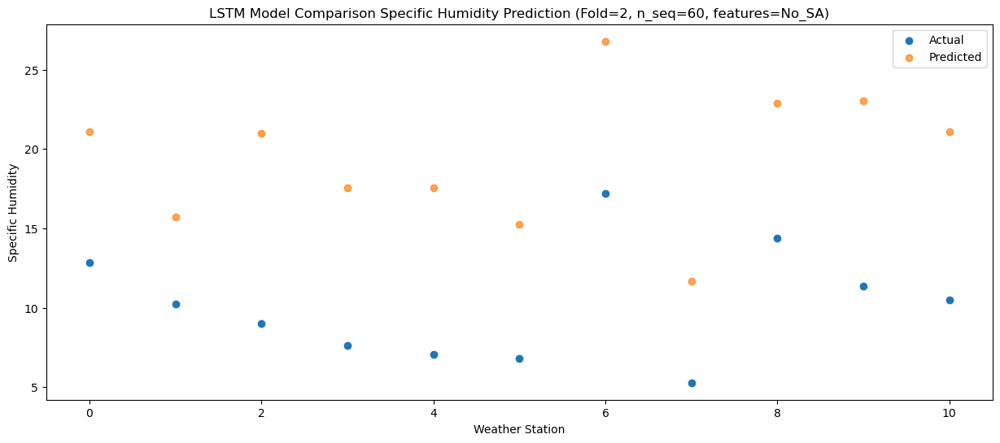

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74  14.818593
1                 1    3.49   9.448603
2                 2    5.03  14.718595
3                 3   -0.37  11.248597
4                 4    1.97  11.288595
5                 5    0.50   8.958594
6                 6   11.83  20.498595
7                 7   -1.83   5.358593
8                 8   10.00  16.618596
9                 9    5.45  16.728595
10               10    4.27  14.818594


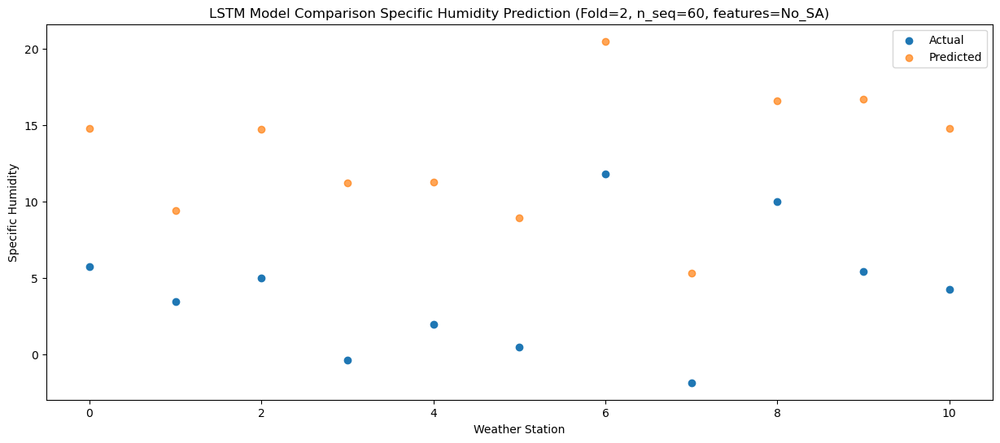

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68  13.075681
1                 1   -0.18   7.705691
2                 2    3.10  12.975682
3                 3   -1.11   9.505685
4                 4   -0.63   9.545682
5                 5   -1.61   7.215682
6                 6    8.85  18.755683
7                 7   -6.87   3.615681
8                 8    7.67  14.875684
9                 9    2.98  14.985683
10               10    1.42  13.075682


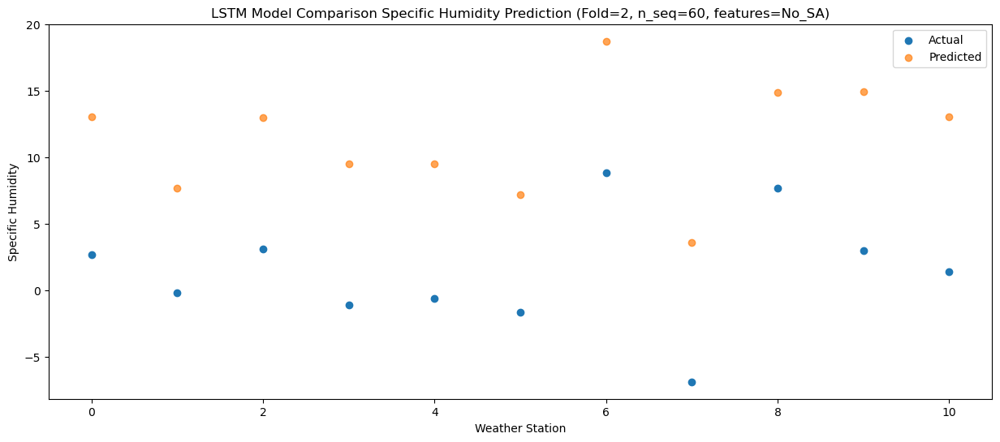

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11   8.216652
1                 1   -5.27   2.846662
2                 2    1.10   8.116653
3                 3   -5.28   4.646656
4                 4   -2.71   4.686653
5                 5   -5.76   2.356653
6                 6    3.67  13.896654
7                 7   -7.20  -1.243348
8                 8    5.87  10.016656
9                 9    1.13  10.126654
10               10   -1.90   8.216653


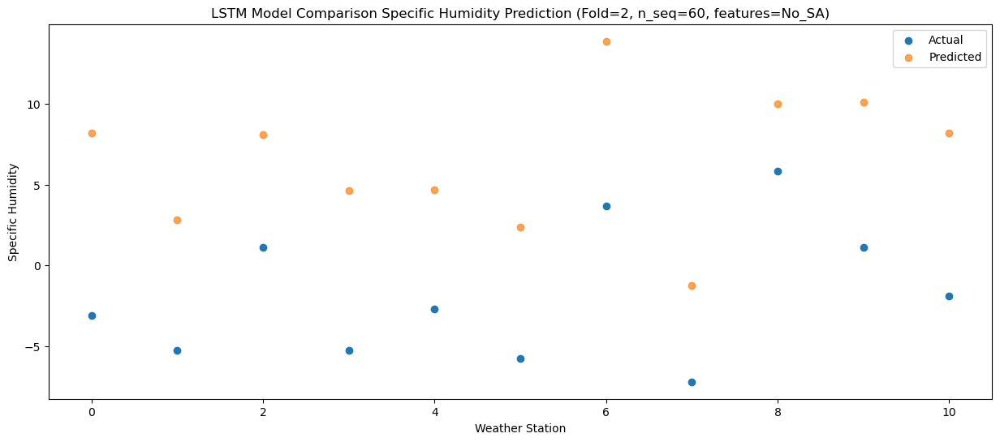

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21  13.162857
1                 1    2.21   7.792868
2                 2    1.58  13.062858
3                 3   -4.60   9.592861
4                 4    1.45   9.632858
5                 5    1.00   7.302858
6                 6   11.93  18.842859
7                 7   -3.99   3.702857
8                 8    6.40  14.962861
9                 9    4.35  15.072859
10               10    2.64  13.162858


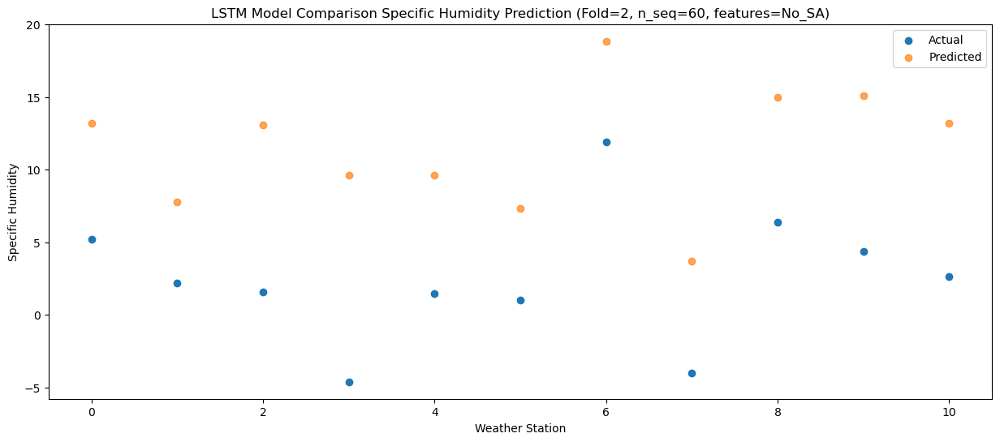

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10  15.874800
1                 1    4.98  10.504811
2                 2    6.00  15.774802
3                 3   -0.20  12.304804
4                 4    4.12  12.344802
5                 5    3.37  10.014801
6                 6   14.28  21.554802
7                 7   -1.42   6.414800
8                 8    7.34  17.674804
9                 9    7.91  17.784802
10               10    6.81  15.874801


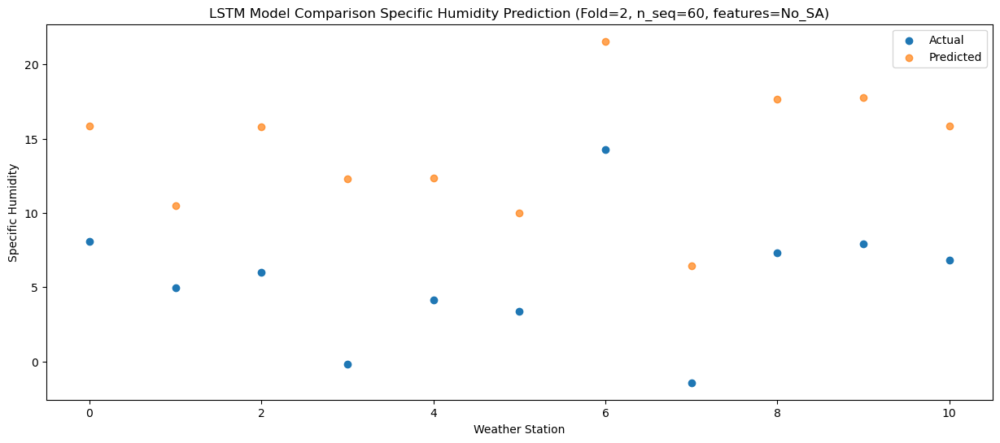

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  20.933552
1                 1   10.39  15.563563
2                 2    7.39  20.833554
3                 3    2.23  17.363556
4                 4    7.78  17.403554
5                 5    7.11  15.073553
6                 6   17.73  26.613554
7                 7    2.99  11.473552
8                 8    9.45  22.733556
9                 9   11.97  22.843554
10               10   10.79  20.933553


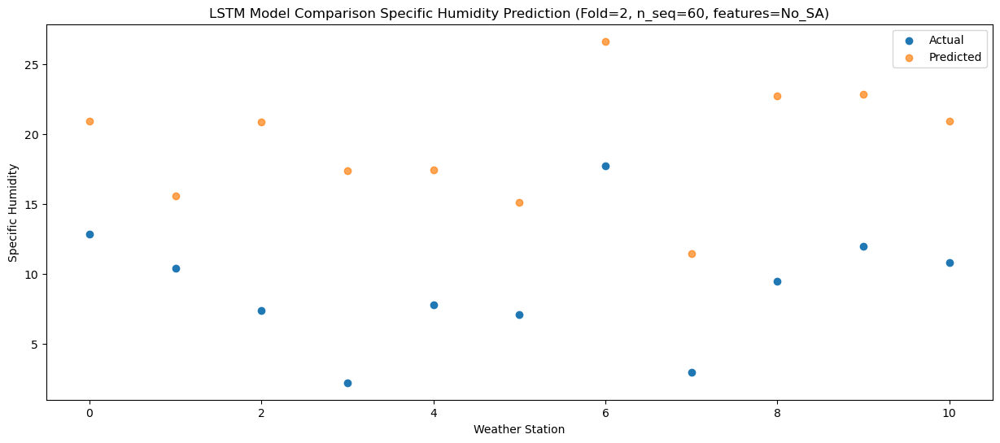

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  26.623400
1                 1   15.00  21.253411
2                 2   12.24  26.523401
3                 3    8.02  23.053404
4                 4   12.83  23.093401
5                 5   10.81  20.763401
6                 6   22.62  32.303402
7                 7    8.81  17.163400
8                 8   11.25  28.423404
9                 9   16.35  28.533402
10               10   15.25  26.623401


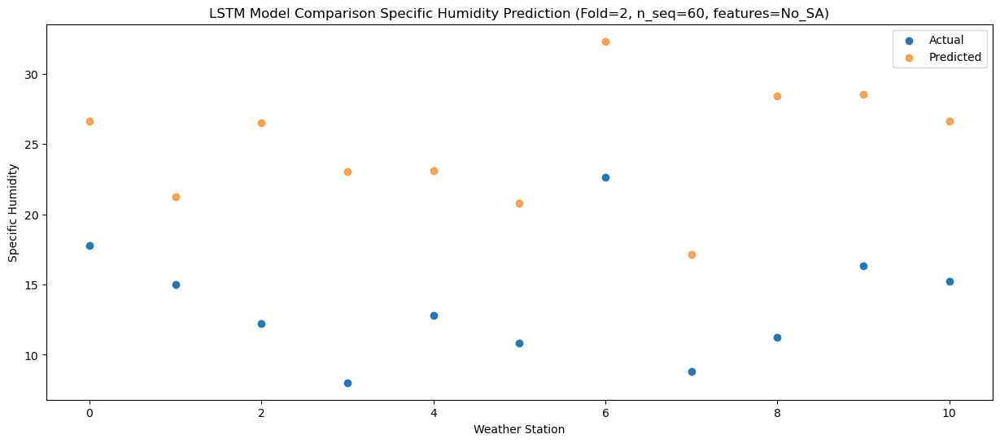

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  31.947867
1                 1   21.17  26.577882
2                 2   13.15  31.847870
3                 3   13.99  28.377875
4                 4   14.66  28.417870
5                 5   14.04  26.087870
6                 6   26.12  37.627871
7                 7   15.23  22.487869
8                 8   15.93  33.747873
9                 9   20.23  33.857873
10               10   19.60  31.947870


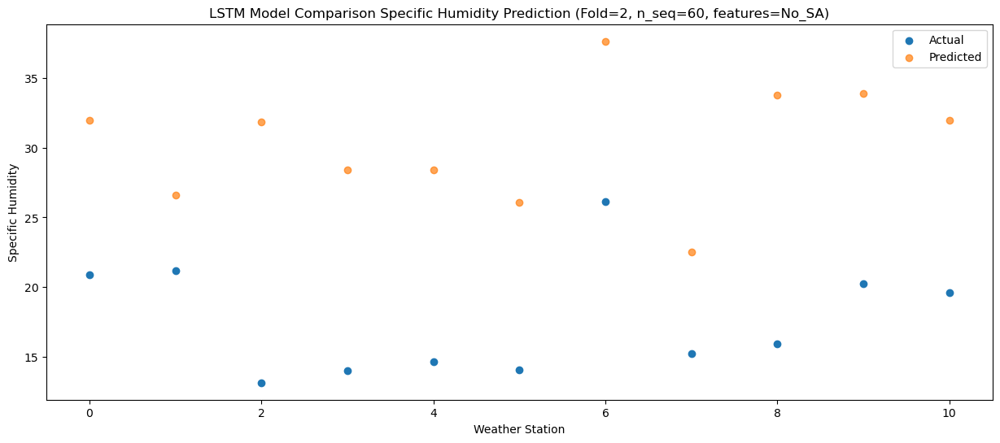

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  33.352427
1                 1   21.72  27.982441
2                 2   13.99  33.252430
3                 3   16.77  29.782434
4                 4   15.27  29.822430
5                 5   12.52  27.492429
6                 6   26.43  39.032430
7                 7   14.70  23.892429
8                 8   19.66  35.152432
9                 9   21.62  35.262432
10               10   20.83  33.352430


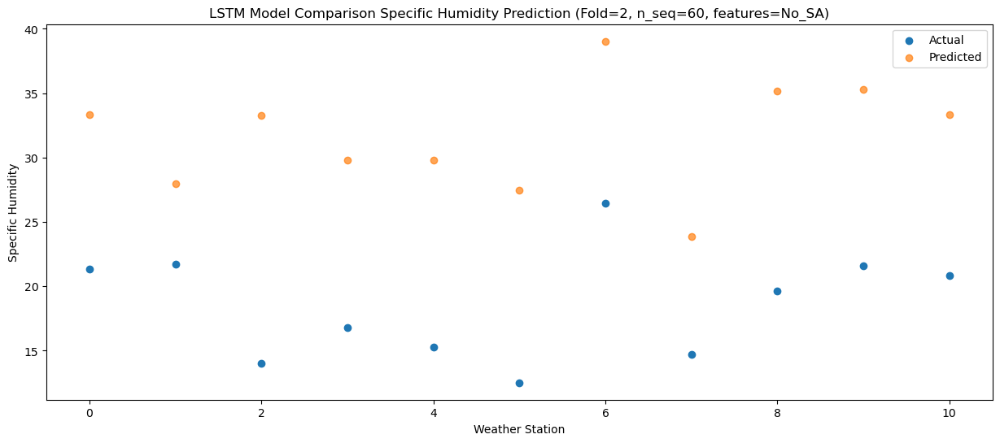

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  33.158365
1                 1   21.77  27.788379
2                 2   13.95  33.058368
3                 3   15.06  29.588372
4                 4   15.62  29.628368
5                 5   14.17  27.298367
6                 6   28.23  38.838368
7                 7   15.09  23.698367
8                 8   19.24  34.958370
9                 9   19.60  35.068370
10               10   19.21  33.158368


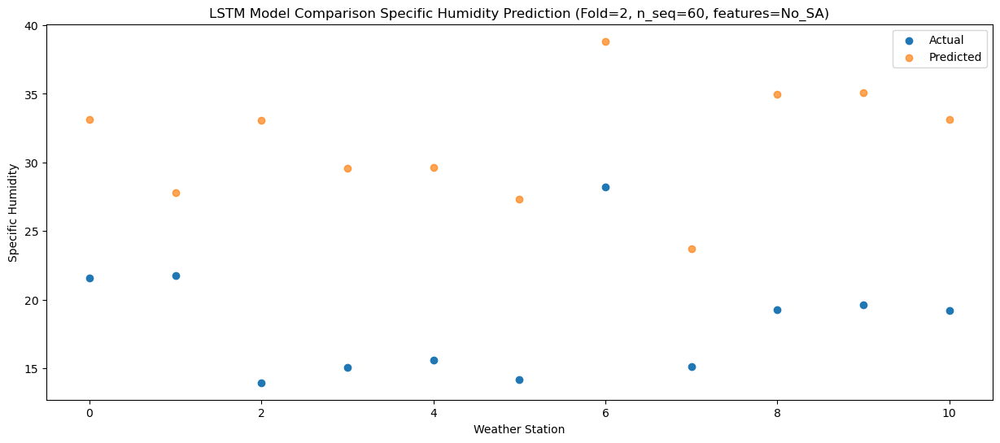

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  30.534084
1                 1   18.04  25.164098
2                 2   13.63  30.434087
3                 3   11.54  26.964091
4                 4   12.82  27.004087
5                 5   11.44  24.674087
6                 6   24.00  36.214088
7                 7   11.06  21.074086
8                 8   17.39  32.334089
9                 9   16.64  32.444089
10               10   16.62  30.534088


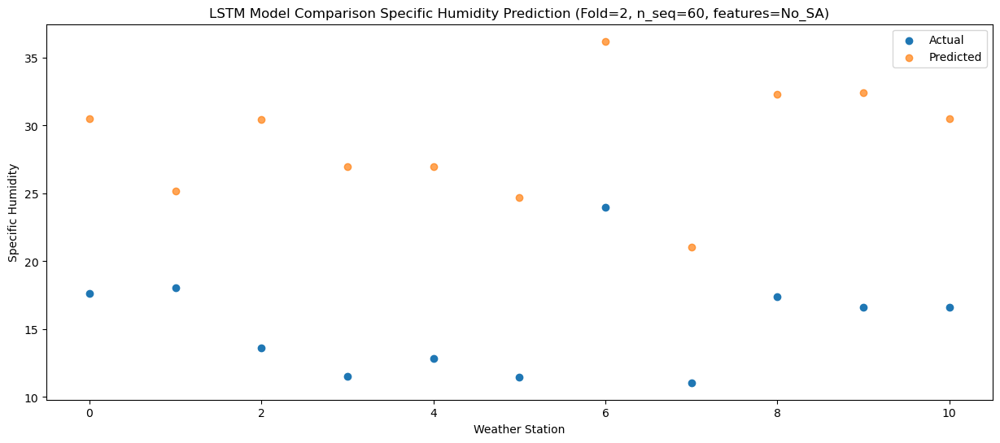

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  25.306197
1                 1   13.07  19.936211
2                 2   10.16  25.206199
3                 3    6.28  21.736204
4                 4    8.13  21.776200
5                 5    8.79  19.446200
6                 6   21.03  30.986201
7                 7    6.80  15.846199
8                 8   14.40  27.106202
9                 9   11.42  27.216202
10               10   10.20  25.306200


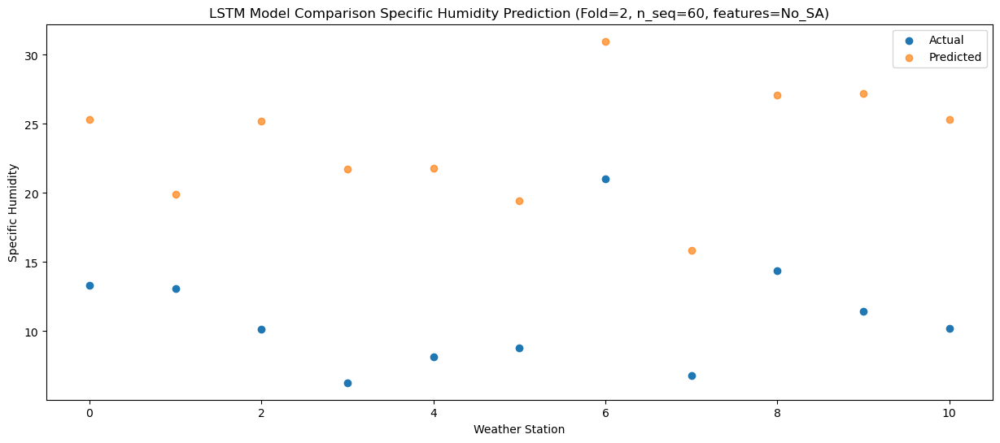

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (1, 1, 512)               4767744   
                                                                 
 dropout_4 (Dropout)         (1, 1, 512)               0         
                                                                 
 lstm_5 (LSTM)               (1, 512)                  2099200   
                                                                 
 dropout_5 (Dropout)         (1, 512)                  0         
                                                                 
 dense_6 (Dense)             (1, 256)                  131328    
                                                                 
 dense_7 (Dense)             (1, 128)                  32896     
                                                                 
 dense_8 (Dense)             (1, 60)                  

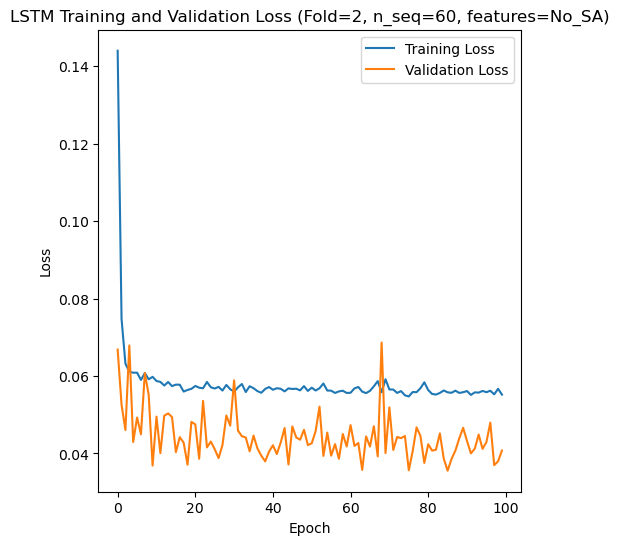

Epoch 1/100
84/84 [==============================] - 7s 38ms/step - loss: 0.1400 - accuracy: 0.2976 - mae: 0.1136 - rmse: 0.1400 - mape: 25.6281 - pearson: 0.6155 - val_loss: 0.0891 - val_accuracy: 0.5000 - val_mae: 0.0705 - val_rmse: 0.0891 - val_mape: 15.7801 - val_pearson: 0.6912
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0727 - accuracy: 0.5357 - mae: 0.0585 - rmse: 0.0727 - mape: 13.4344 - pearson: 0.8344 - val_loss: 0.0920 - val_accuracy: 0.5000 - val_mae: 0.0739 - val_rmse: 0.0920 - val_mape: 16.0486 - val_pearson: 0.7182
Epoch 3/100
84/84 [==============================] - 2s 27ms/step - loss: 0.0633 - accuracy: 0.5595 - mae: 0.0504 - rmse: 0.0633 - mape: 11.8804 - pearson: 0.8439 - val_loss: 0.0891 - val_accuracy: 0.5000 - val_mae: 0.0706 - val_rmse: 0.0891 - val_mape: 15.3257 - val_pearson: 0.6975
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0601 - accuracy: 0.5833 - mae: 0.0478 - rmse: 0.0601 - mape: 11.1754 - p

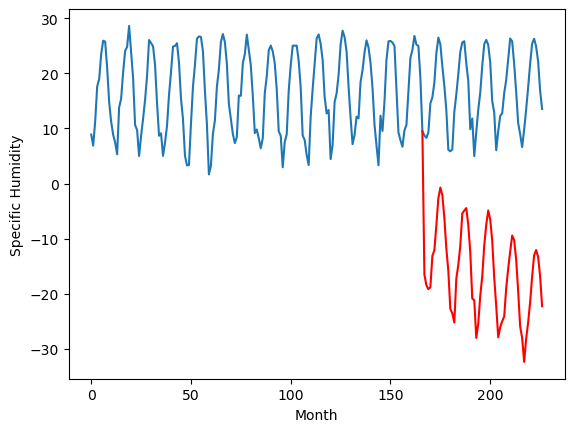

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		1.29		-1.60
1.54		-0.66		-2.20
0.70		-1.36		-2.06
0.85		-1.00		-1.85
8.34		4.68		-3.66
9.26		5.72		-3.54
13.66		10.25		-3.41
20.76		15.12		-5.64
22.62		17.09		-5.53
20.76		15.70		-5.06
17.09		11.60		-5.49
9.98		6.02		-3.96
7.16		1.94		-5.22
0.61		-4.95		-5.56
-0.54		-5.73		-5.19
-4.26		-7.43		-3.17
7.71		0.54		-7.17
9.57		3.05		-6.52
13.79		6.54		-7.25
20.50		12.38		-8.12
21.81		12.91		-8.90
22.38		13.36		-9.02
19.65		10.26		-9.39
13.05		5.33		-7.72
5.34		-3.07		-8.41
6.65		-3.34		-9.99
-2.18		-10.21		-8.03
-0.96		-7.61		-6.65
5.82		-2.56		-8.38
10.67		0.95		-9.72
16.10		6.55		-9.55
21.25		10.34		-10.91
25.29		12.92		-12.37
22.21		11.27		-10.94
18.35		7.41		-10.94
11.80		0.73		-11.07
4.57		-4.42		-8.99
0.52		-10.09		-10.61
1.22		-8.27		-9.49
3.18		-7.17		-10.35
5.78		-6.33		-12.11
10.83		-1.18		-12.01
16.14		2.35		-13.79
20.47		5.46		-15.01
22.73		8.38		-14.35
22.91		7.52		-15.39
18.86	

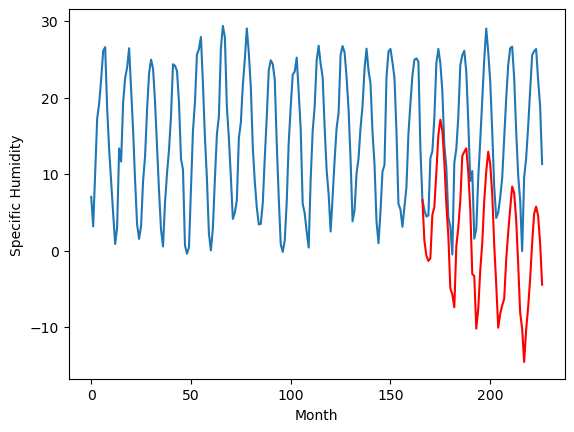

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.73		0.76		-3.97
2.20		-1.19		-3.39
0.98		-1.89		-2.87
3.40		-1.53		-4.93
5.19		4.15		-1.04
9.85		5.19		-4.66
15.04		9.72		-5.32
18.39		14.59		-3.80
21.17		16.56		-4.61
21.70		15.17		-6.53
17.37		11.07		-6.30
11.88		5.49		-6.39
3.23		1.41		-1.82
0.03		-5.48		-5.51
1.29		-6.26		-7.55
3.59		-7.96		-11.55
4.74		0.01		-4.73
10.47		2.52		-7.95
15.27		6.01		-9.26
20.12		11.85		-8.27
23.25		12.38		-10.87
21.05		12.83		-8.22
17.74		9.73		-8.01
9.08		4.80		-4.28
4.74		-3.60		-8.34
0.82		-3.87		-4.69
0.49		-10.74		-11.23
2.19		-8.14		-10.33
6.90		-3.09		-9.99
9.97		0.42		-9.55
14.21		6.02		-8.19
19.60		9.81		-9.79
22.17		12.39		-9.78
22.35		10.74		-11.61
19.53		6.88		-12.65
12.35		0.20		-12.15
1.62		-4.95		-6.57
0.66		-10.62		-11.28
2.05		-8.80		-10.85
1.20		-7.70		-8.90
4.07		-6.86		-10.93
9.70		-1.71		-11.41
14.14		1.82		-12.32
16.94		4.93		-12.01
22.60		7.85		-14.75
20.91		6.99		-13.92
17.14		3.48	

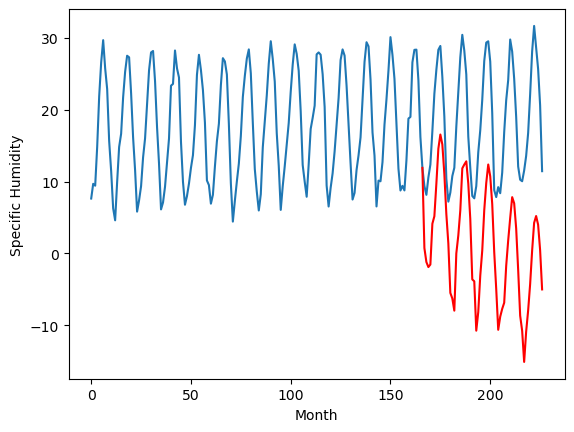

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-7.31		-5.08		2.23
-7.30		-7.03		0.27
-7.85		-7.73		0.12
-8.20		-7.37		0.83
-1.29		-1.69		-0.40
-0.65		-0.65		-0.00
3.92		3.88		-0.04
9.74		8.75		-0.99
13.54		10.72		-2.82
11.12		9.33		-1.79
7.06		5.23		-1.83
1.64		-0.35		-1.99
-2.28		-4.43		-2.15
-9.48		-11.32		-1.84
-10.94		-12.10		-1.16
-12.26		-13.80		-1.54
-2.05		-5.83		-3.78
0.30		-3.32		-3.62
4.37		0.17		-4.20
10.29		6.01		-4.28
11.28		6.54		-4.74
11.80		6.99		-4.81
7.67		3.89		-3.78
4.09		-1.04		-5.13
-5.57		-9.44		-3.87
-4.08		-9.71		-5.63
-13.03		-16.58		-3.55
-8.51		-13.98		-5.47
-2.76		-8.93		-6.17
0.25		-5.42		-5.67
7.03		0.18		-6.85
10.51		3.97		-6.54
12.06		6.55		-5.51
10.99		4.90		-6.09
7.01		1.04		-5.97
-0.26		-5.64		-5.38
-3.38		-10.79		-7.41
-8.65		-16.46		-7.81
-6.90		-14.64		-7.74
-4.56		-13.54		-8.98
-4.32		-12.70		-8.38
1.92		-7.55		-9.47
4.61		-4.02		-8.63
8.35		-0.91		-9.26
11.97		2.01		-9.96
10.86		1.15		-9.71
8.13		

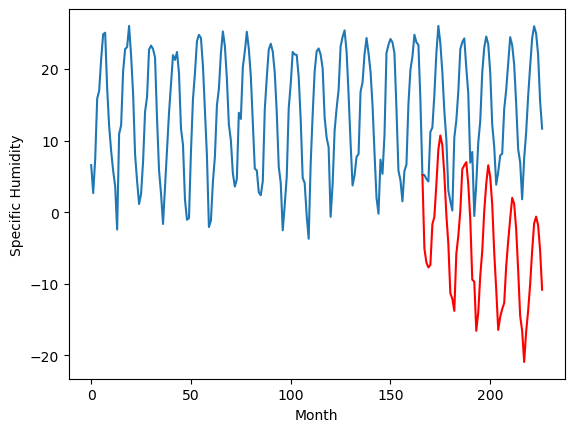

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.64		0.62		-5.02
2.38		-1.33		-3.71
-0.49		-2.03		-1.54
0.66		-1.67		-2.33
8.07		4.01		-4.06
11.10		5.05		-6.05
17.17		9.58		-7.59
24.22		14.45		-9.77
25.68		16.42		-9.26
23.12		15.03		-8.09
19.05		10.93		-8.12
11.32		5.35		-5.97
8.50		1.27		-7.23
1.33		-5.62		-6.95
-0.14		-6.40		-6.26
-4.01		-8.10		-4.09
9.07		-0.13		-9.20
12.36		2.38		-9.98
16.93		5.87		-11.06
24.41		11.71		-12.70
24.41		12.24		-12.17
24.53		12.69		-11.84
21.17		9.59		-11.58
15.75		4.66		-11.09
6.01		-3.74		-9.75
5.65		-4.01		-9.66
-3.82		-10.88		-7.06
-1.30		-8.28		-6.98
7.16		-3.23		-10.39
11.29		0.28		-11.01
18.86		5.88		-12.98
24.31		9.67		-14.64
25.43		12.25		-13.18
23.61		10.60		-13.01
19.29		6.74		-12.55
12.02		0.06		-11.96
6.13		-5.09		-11.22
0.16		-10.76		-10.92
1.88		-8.94		-10.82
8.40		-7.84		-16.24
5.44		-7.00		-12.44
12.65		-1.85		-14.50
18.65		1.68		-16.97
22.75		4.79		-17.96
24.45		7.71		-16.74
23.16		6.85		

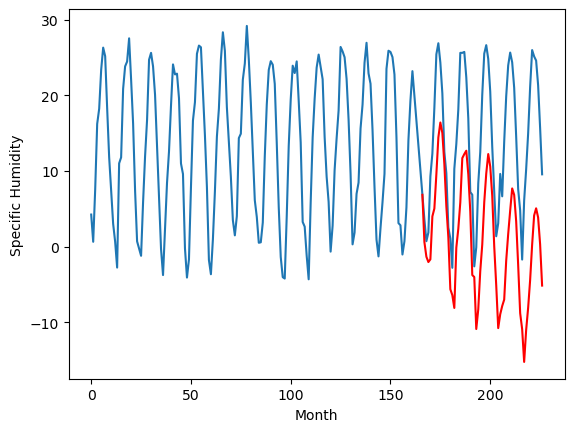

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-3.05		-1.26		1.79
-2.84		-3.21		-0.37
-4.26		-3.91		0.35
-4.67		-3.55		1.12
2.19		2.13		-0.06
4.46		3.17		-1.29
9.87		7.70		-2.17
16.86		12.57		-4.29
18.75		14.54		-4.21
16.24		13.15		-3.09
12.61		9.05		-3.56
6.61		3.47		-3.14
2.67		-0.61		-3.28
-4.94		-7.50		-2.56
-6.39		-8.28		-1.89
-9.11		-9.98		-0.87
2.22		-2.01		-4.23
5.67		0.50		-5.17
9.95		3.99		-5.96
16.66		9.83		-6.83
17.04		10.36		-6.68
17.36		10.81		-6.55
14.10		7.71		-6.39
9.52		2.78		-6.74
-1.33		-5.62		-4.29
-0.28		-5.89		-5.61
-9.10		-12.76		-3.66
-5.91		-10.16		-4.25
1.05		-5.11		-6.16
4.90		-1.60		-6.50
12.70		4.00		-8.70
16.64		7.79		-8.85
18.63		10.37		-8.26
16.98		8.72		-8.26
13.03		4.86		-8.17
6.99		-1.82		-8.81
0.44		-6.97		-7.41
-5.10		-12.64		-7.54
-2.96		-10.82		-7.86
-1.24		-9.72		-8.48
-0.34		-8.88		-8.54
5.89		-3.73		-9.62
11.30		-0.20		-11.50
14.76		2.91		-11.85
18.02		5.83		-12.19
16.47		4.97		-11.50
13.01		1.46

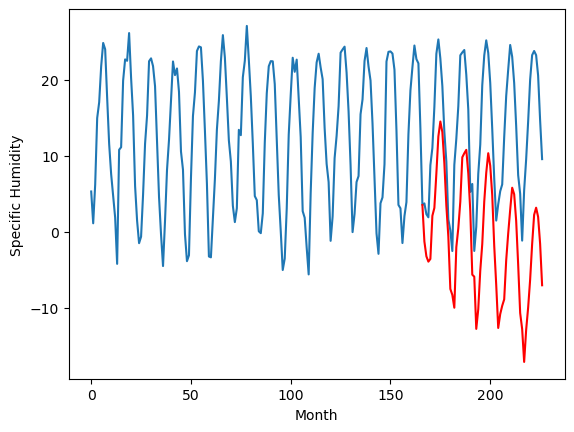

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-4.14		-0.63		3.51
-9.81		-2.58		7.23
-9.90		-3.28		6.62
-9.71		-2.92		6.79
-4.78		2.76		7.54
-1.80		3.80		5.60
5.31		8.33		3.02
9.52		13.20		3.68
11.51		15.17		3.66
12.26		13.78		1.52
6.76		9.68		2.92
3.02		4.10		1.08
-4.17		0.02		4.19
-9.87		-6.87		3.00
-9.60		-7.65		1.95
-9.50		-9.35		0.15
-6.53		-1.38		5.15
-1.75		1.13		2.88
3.30		4.62		1.32
10.69		10.46		-0.23
12.53		10.99		-1.54
10.61		11.44		0.83
8.74		8.34		-0.40
0.77		3.41		2.64
-1.97		-4.99		-3.02
-6.73		-5.26		1.47
-9.02		-12.13		-3.11
-10.74		-9.53		1.21
-6.20		-4.48		1.72
-1.88		-0.97		0.91
4.03		4.63		0.60
9.80		8.42		-1.38
11.72		11.00		-0.72
10.96		9.35		-1.61
8.80		5.49		-3.31
0.54		-1.19		-1.73
-7.14		-6.34		0.80
-9.31		-12.01		-2.70
-10.04		-10.19		-0.15
-10.01		-9.09		0.92
-8.22		-8.25		-0.03
-2.88		-3.10		-0.22
4.33		0.43		-3.90
8.91		3.54		-5.37
15.05		6.46		-8.59
12.46		5.60		-6.86
8.31		2.09		-6.22
2.18		-3.67		-5.85
-

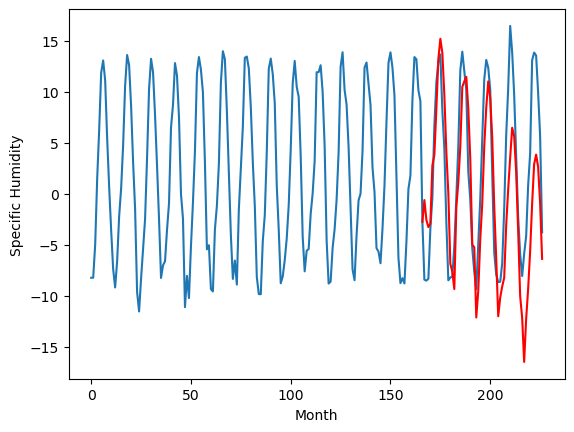

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.65		-1.71		-3.36
-3.08		-3.66		-0.58
-1.92		-4.36		-2.44
-0.41		-4.00		-3.59
2.70		1.68		-1.02
8.61		2.72		-5.89
15.88		7.25		-8.63
19.34		12.12		-7.22
23.57		14.09		-9.48
23.68		12.70		-10.98
18.87		8.60		-10.27
11.93		3.02		-8.91
3.12		-1.06		-4.18
-2.57		-7.95		-5.38
-2.02		-8.73		-6.71
0.83		-10.43		-11.26
2.43		-2.46		-4.89
10.40		0.05		-10.35
14.83		3.54		-11.29
22.47		9.38		-13.09
23.55		9.91		-13.64
22.32		10.36		-11.96
18.35		7.26		-11.09
8.00		2.33		-5.67
5.48		-6.07		-11.55
-1.79		-6.34		-4.55
-1.86		-13.21		-11.35
0.18		-10.61		-10.79
4.89		-5.56		-10.45
9.52		-2.05		-11.57
14.19		3.55		-10.64
20.67		7.34		-13.33
22.90		9.92		-12.98
21.31		8.27		-13.04
18.95		4.41		-14.54
11.06		-2.27		-13.33
-0.36		-7.42		-7.06
-2.69		-13.09		-10.40
-3.20		-11.27		-8.07
-2.29		-10.17		-7.88
0.54		-9.33		-9.87
8.49		-4.18		-12.67
14.29		-0.65		-14.94
16.79		2.46		-14.33
25.15		5.38		-19.77
20.52

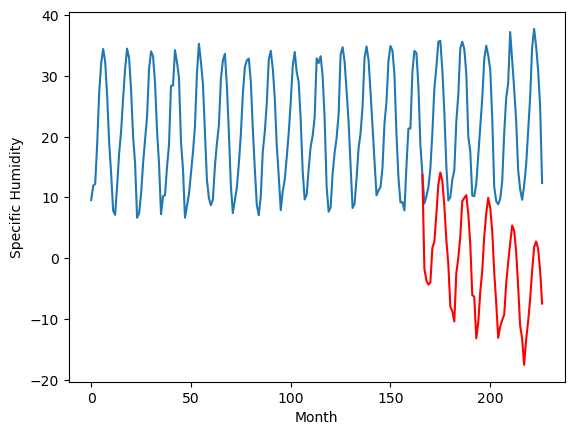

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.04		-4.03		-3.99
-1.29		-5.98		-4.69
-1.92		-6.68		-4.76
0.10		-6.32		-6.42
-0.46		-0.64		-0.18
3.16		0.40		-2.76
5.56		4.93		-0.63
8.10		9.80		1.70
7.29		11.77		4.48
9.17		10.38		1.21
8.59		6.28		-2.31
6.37		0.70		-5.67
-0.79		-3.38		-2.59
-2.84		-10.27		-7.43
-1.62		-11.05		-9.43
-0.69		-12.75		-12.06
-0.91		-4.78		-3.87
1.28		-2.27		-3.55
5.57		1.22		-4.35
7.27		7.06		-0.21
6.45		7.59		1.14
7.00		8.04		1.04
6.45		4.94		-1.51
3.69		0.01		-3.68
0.87		-8.39		-9.26
-2.83		-8.66		-5.83
-2.21		-15.53		-13.32
-1.25		-12.93		-11.68
0.98		-7.88		-8.86
2.42		-4.37		-6.79
5.41		1.23		-4.18
8.56		5.02		-3.54
6.91		7.60		0.69
8.33		5.95		-2.38
8.56		2.09		-6.47
3.83		-4.59		-8.42
-1.90		-9.74		-7.84
-3.10		-15.41		-12.31
-1.43		-13.59		-12.16
-3.23		-12.49		-9.26
-1.77		-11.65		-9.88
2.31		-6.50		-8.81
3.34		-2.97		-6.31
5.24		0.14		-5.10
8.25		3.06		-5.19
9.28		2.20		-7.08
6.67		-1.31		-7.98
5.21		

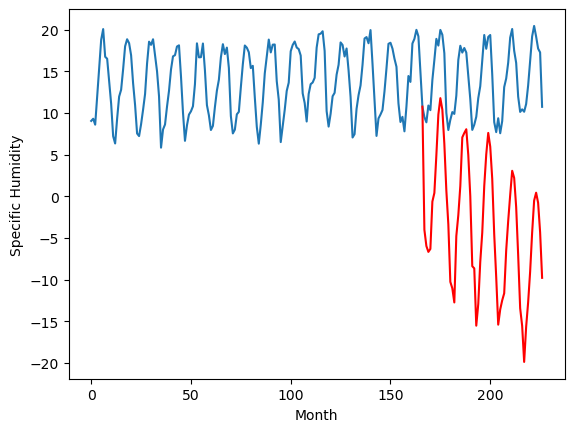

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-3.08		-2.95		0.13
-5.84		-4.90		0.94
-5.81		-5.60		0.21
-5.37		-5.24		0.13
-1.79		0.44		2.23
-0.35		1.48		1.83
5.21		6.01		0.80
12.19		10.88		-1.31
16.14		12.85		-3.29
14.96		11.46		-3.50
10.62		7.36		-3.26
5.30		1.78		-3.52
1.23		-2.30		-3.53
-5.11		-9.19		-4.08
-8.13		-9.97		-1.84
-8.25		-11.67		-3.42
-3.25		-3.70		-0.45
1.37		-1.19		-2.56
6.20		2.30		-3.90
12.07		8.14		-3.93
14.21		8.67		-5.54
14.83		9.12		-5.71
11.51		6.02		-5.49
7.07		1.09		-5.98
-1.85		-7.31		-5.46
-3.45		-7.58		-4.13
-10.00		-14.45		-4.45
-7.24		-11.85		-4.61
-3.28		-6.80		-3.52
1.01		-3.29		-4.30
6.80		2.31		-4.49
11.12		6.10		-5.02
15.67		8.68		-6.99
15.59		7.03		-8.56
10.68		3.17		-7.51
4.42		-3.51		-7.93
0.46		-8.66		-9.12
-5.90		-14.33		-8.43
-3.92		-12.51		-8.59
-5.65		-11.41		-5.76
-3.68		-10.57		-6.89
2.37		-5.42		-7.79
6.01		-1.89		-7.90
10.00		1.22		-8.78
15.68		4.14		-11.54
13.43		3.28		-10.15
10.86		-0.23

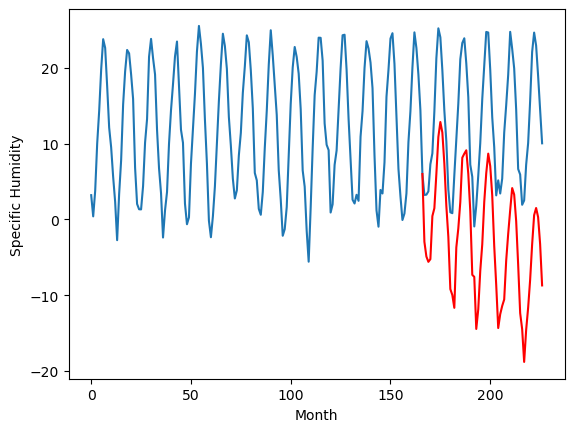

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-17.90		-16.52		1.38
-20.86		-18.47		2.39
-20.45		-19.17		1.28
-19.53		-18.81		0.72
-15.12		-13.13		1.99
-13.18		-12.09		1.09
-7.41		-7.56		-0.15
-0.69		-2.69		-2.00
3.08		-0.72		-3.80
1.21		-2.11		-3.32
-3.76		-6.21		-2.45
-9.25		-11.79		-2.54
-13.53		-15.87		-2.34
-20.35		-22.76		-2.41
-21.91		-23.54		-1.63
-22.71		-25.24		-2.53
-15.52		-17.27		-1.75
-10.65		-14.76		-4.11
-6.39		-11.27		-4.88
-0.22		-5.43		-5.21
1.42		-4.90		-6.32
1.15		-4.45		-5.60
-3.11		-7.55		-4.44
-7.23		-12.48		-5.25
-17.45		-20.88		-3.43
-17.86		-21.15		-3.29
-24.84		-28.02		-3.18
-21.03		-25.42		-4.39
-15.85		-20.37		-4.52
-12.03		-16.86		-4.83
-5.25		-11.26		-6.01
-1.26		-7.47		-6.21
2.52		-4.89		-7.41
1.65		-6.54		-8.19
-3.58		-10.40		-6.82
-11.19		-17.08		-5.89
-14.31		-22.23		-7.92
-21.34		-27.90		-6.56
-18.69		-26.08		-7.39
-18.48		-24.98		-6.50
-16.92		-24.14		-7.22
-9.35		-18.99		-9.64
-6.88		-15.46		-8.58
-

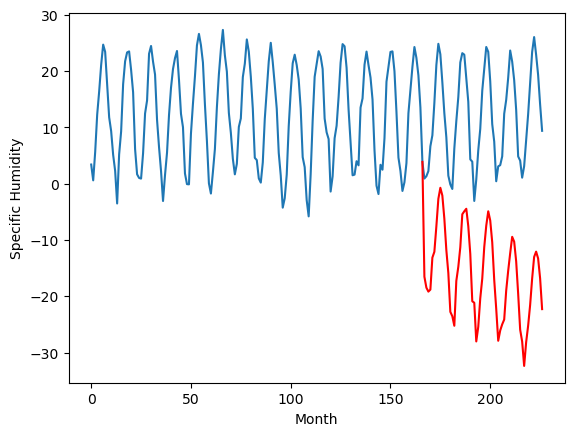

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-16.5207731628418, 1.2892268371582034, 0.7592268371582023, -5.080773162841797, 0.6192268371582035, -1.2607731628417973, -0.6307731628417965, -1.7107731628417966, -4.030773162841797, -2.950773162841797, -16.5207731628418]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -16.520773
1                 1    2.89   1.289227
2                 2    4.73   0.759227
3                 3   -7.31  -5.080773
4                 4    5.64   0.619227
5                 5   -3.05  -1.260773
6                 6   -4.14  -0.630773
7                 7    1.65  -1.710773
8                 8   -0.04  -4.030773
9                 9   -3.08  -2.950773
10               10  -17.90 -16.520773


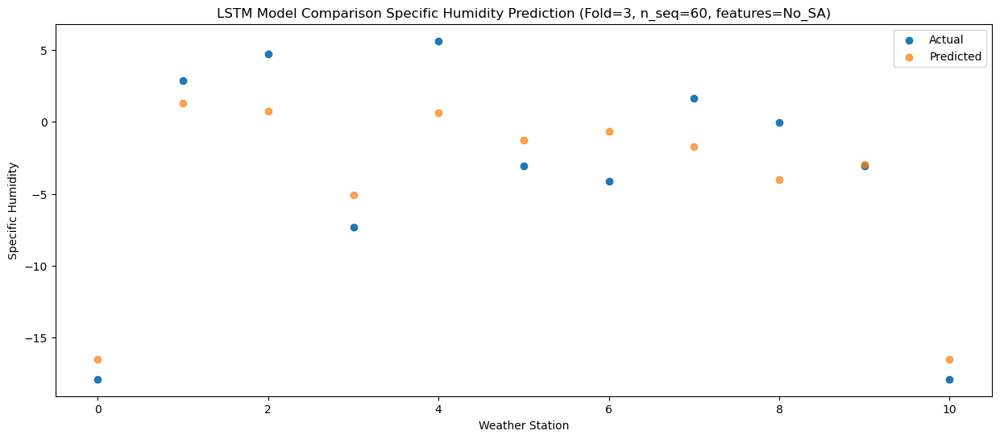

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -18.468987
1                 1    1.54  -0.658987
2                 2    2.20  -1.188987
3                 3   -7.30  -7.028987
4                 4    2.38  -1.328987
5                 5   -2.84  -3.208987
6                 6   -9.81  -2.578987
7                 7   -3.08  -3.658987
8                 8   -1.29  -5.978987
9                 9   -5.84  -4.898987
10               10  -20.86 -18.468987


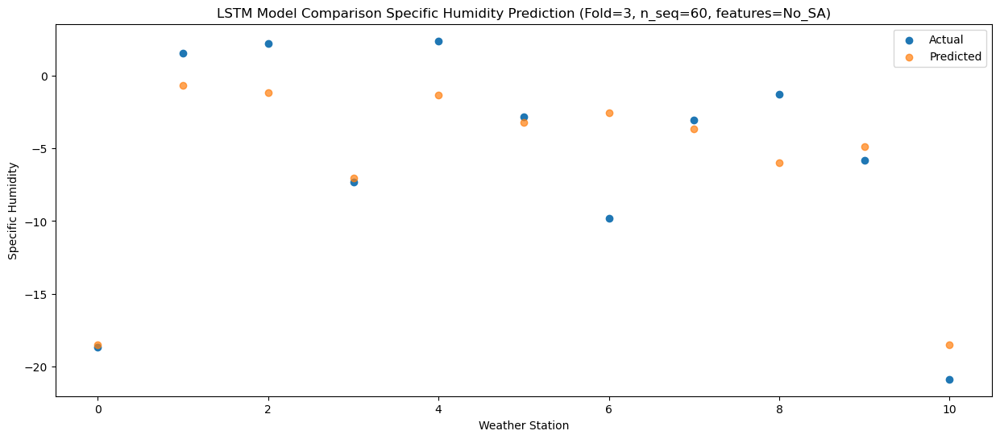

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -19.168421
1                 1    0.70  -1.358422
2                 2    0.98  -1.888422
3                 3   -7.85  -7.728422
4                 4   -0.49  -2.028422
5                 5   -4.26  -3.908422
6                 6   -9.90  -3.278421
7                 7   -1.92  -4.358422
8                 8   -1.92  -6.678421
9                 9   -5.81  -5.598422
10               10  -20.45 -19.168422


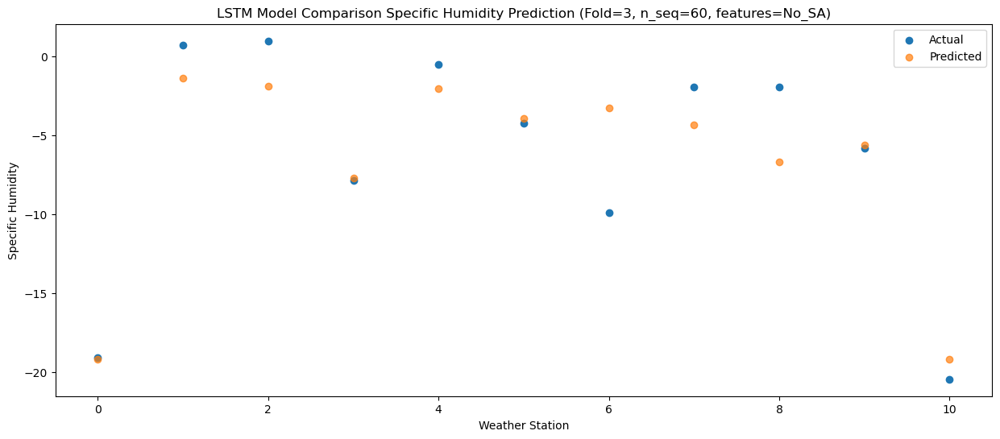

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -18.813449
1                 1    0.85  -1.003450
2                 2    3.40  -1.533450
3                 3   -8.20  -7.373450
4                 4    0.66  -1.673450
5                 5   -4.67  -3.553450
6                 6   -9.71  -2.923449
7                 7   -0.41  -4.003450
8                 8    0.10  -6.323449
9                 9   -5.37  -5.243450
10               10  -19.53 -18.813450


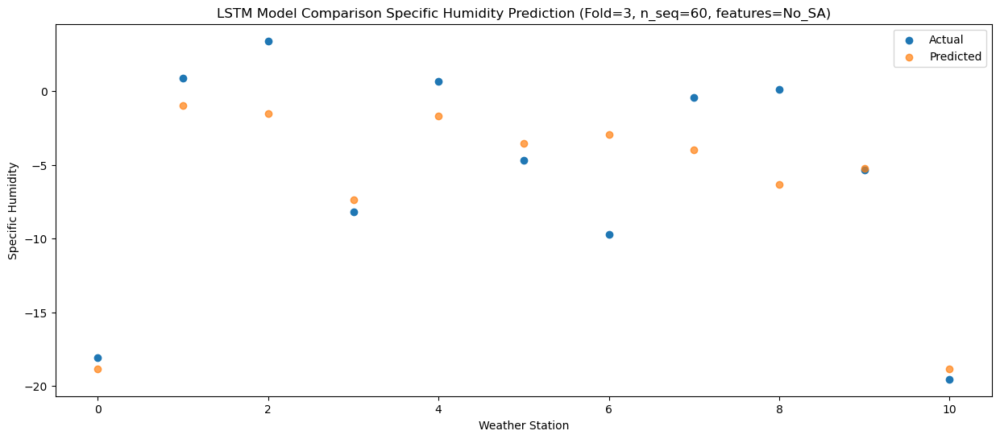

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -13.132919
1                 1    8.34   4.677080
2                 2    5.19   4.147078
3                 3   -1.29  -1.692920
4                 4    8.07   4.007080
5                 5    2.19   2.127080
6                 6   -4.78   2.757079
7                 7    2.70   1.677078
8                 8   -0.46  -0.642921
9                 9   -1.79   0.437080
10               10  -15.12 -13.132920


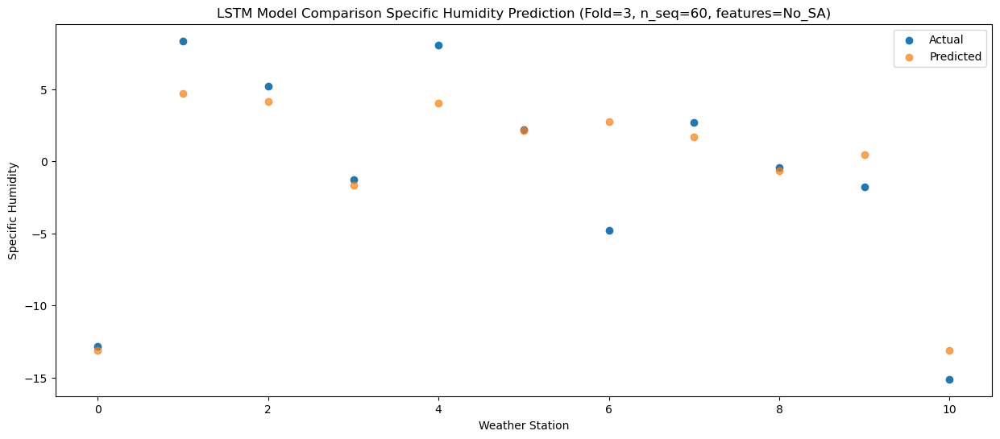

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76 -12.094915
1                 1    9.26   5.715084
2                 2    9.85   5.185083
3                 3   -0.65  -0.654916
4                 4   11.10   5.045084
5                 5    4.46   3.165084
6                 6   -1.80   3.795083
7                 7    8.61   2.715083
8                 8    3.16   0.395083
9                 9   -0.35   1.475084
10               10  -13.18 -12.094916


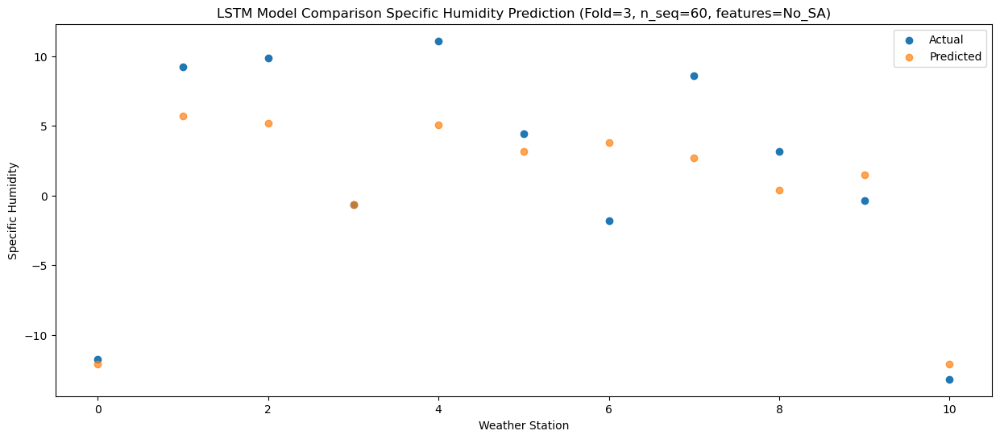

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -7.563203
1                 1   13.66  10.246796
2                 2   15.04   9.716795
3                 3    3.92   3.876796
4                 4   17.17   9.576796
5                 5    9.87   7.696796
6                 6    5.31   8.326796
7                 7   15.88   7.246795
8                 8    5.56   4.926796
9                 9    5.21   6.006796
10               10   -7.41  -7.563204


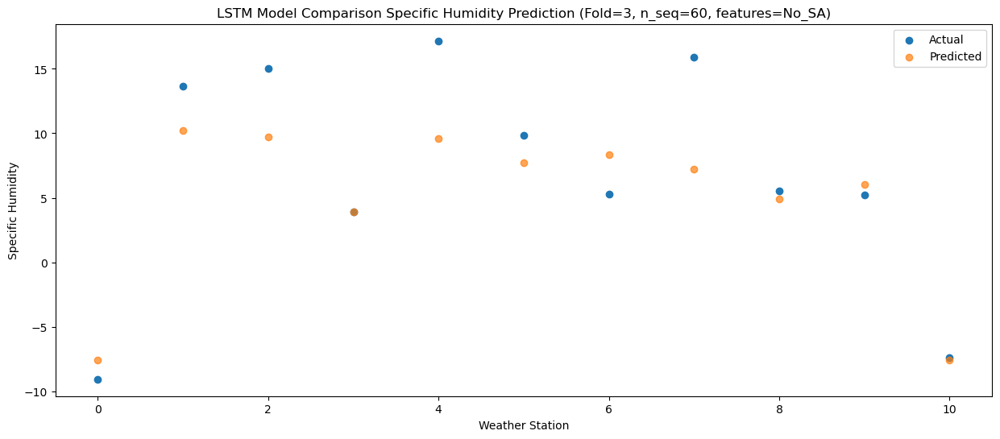

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -2.685396
1                 1   20.76  15.124603
2                 2   18.39  14.594601
3                 3    9.74   8.754603
4                 4   24.22  14.454603
5                 5   16.86  12.574603
6                 6    9.52  13.204602
7                 7   19.34  12.124601
8                 8    8.10   9.804602
9                 9   12.19  10.884603
10               10   -0.69  -2.685397


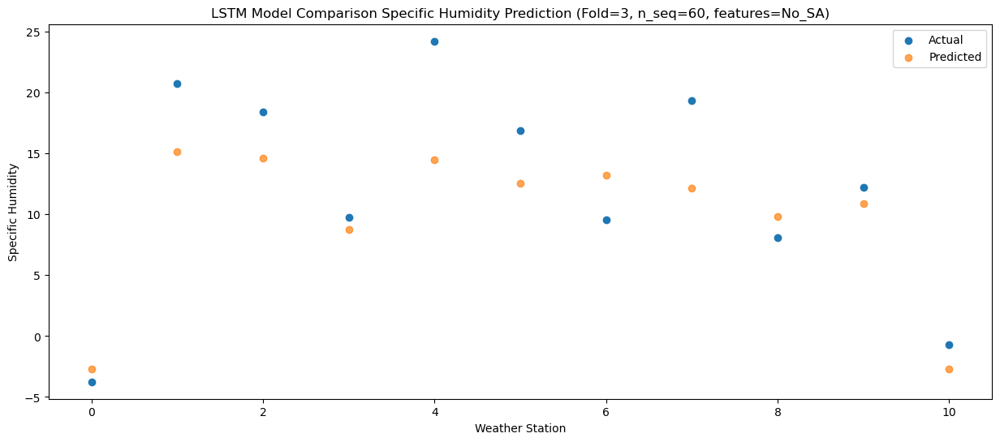

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89  -0.719386
1                 1   22.62  17.090613
2                 2   21.17  16.560611
3                 3   13.54  10.720613
4                 4   25.68  16.420613
5                 5   18.75  14.540613
6                 6   11.51  15.170612
7                 7   23.57  14.090611
8                 8    7.29  11.770612
9                 9   16.14  12.850613
10               10    3.08  -0.719387


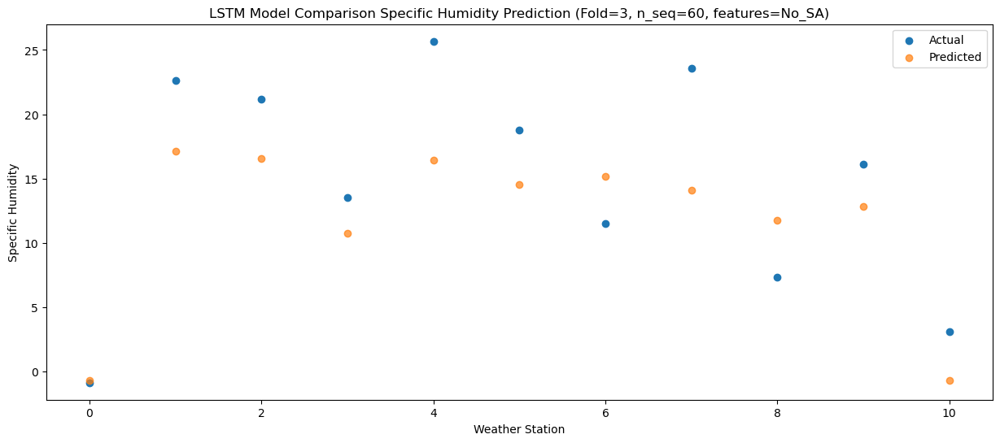

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12  -2.105362
1                 1   20.76  15.704637
2                 2   21.70  15.174636
3                 3   11.12   9.334637
4                 4   23.12  15.034638
5                 5   16.24  13.154637
6                 6   12.26  13.784636
7                 7   23.68  12.704636
8                 8    9.17  10.384636
9                 9   14.96  11.464636
10               10    1.21  -2.105363


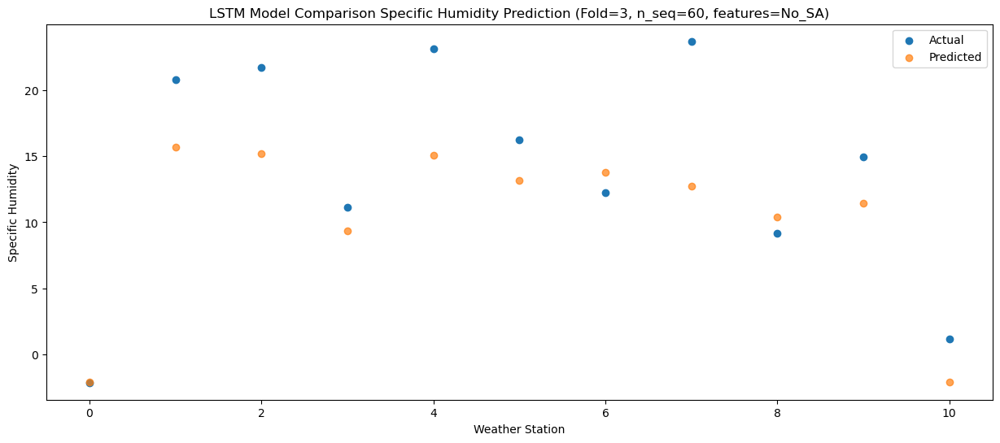

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -6.205515
1                 1   17.09  11.604484
2                 2   17.37  11.074483
3                 3    7.06   5.234484
4                 4   19.05  10.934485
5                 5   12.61   9.054484
6                 6    6.76   9.684483
7                 7   18.87   8.604483
8                 8    8.59   6.284483
9                 9   10.62   7.364483
10               10   -3.76  -6.205516


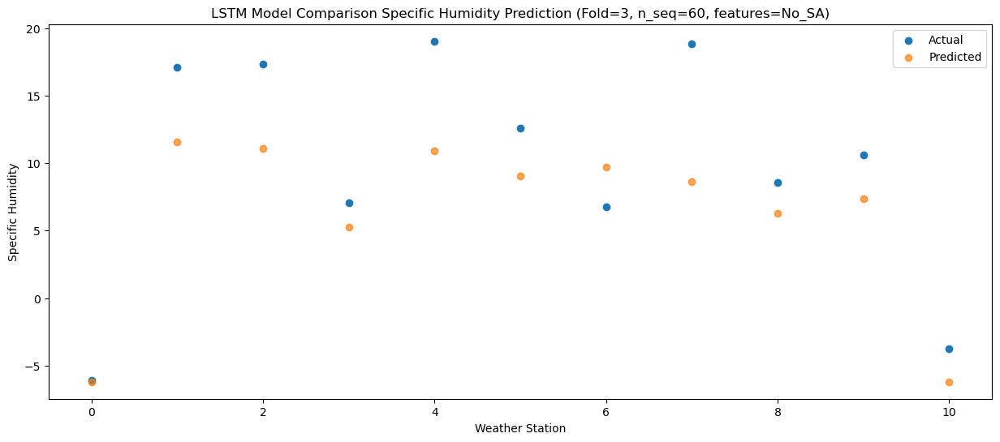

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66 -11.787995
1                 1    9.98   6.022004
2                 2   11.88   5.492003
3                 3    1.64  -0.347997
4                 4   11.32   5.352005
5                 5    6.61   3.472004
6                 6    3.02   4.102003
7                 7   11.93   3.022003
8                 8    6.37   0.702003
9                 9    5.30   1.782003
10               10   -9.25 -11.787997


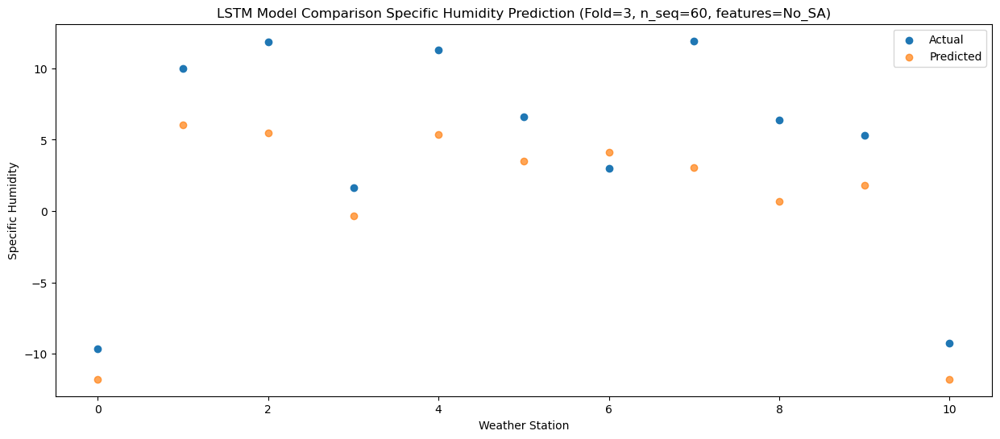

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -15.872939
1                 1    7.16   1.937060
2                 2    3.23   1.407059
3                 3   -2.28  -4.432941
4                 4    8.50   1.267061
5                 5    2.67  -0.612940
6                 6   -4.17   0.017059
7                 7    3.12  -1.062941
8                 8   -0.79  -3.382941
9                 9    1.23  -2.302941
10               10  -13.53 -15.872941


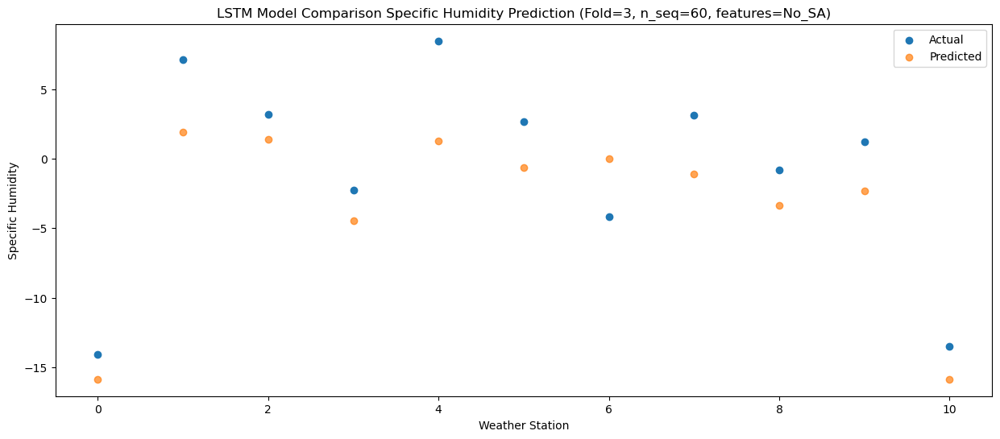

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -22.764140
1                 1    0.61  -4.954141
2                 2    0.03  -5.484143
3                 3   -9.48 -11.324142
4                 4    1.33  -5.624141
5                 5   -4.94  -7.504142
6                 6   -9.87  -6.874143
7                 7   -2.57  -7.954143
8                 8   -2.84 -10.274143
9                 9   -5.11  -9.194142
10               10  -20.35 -22.764142


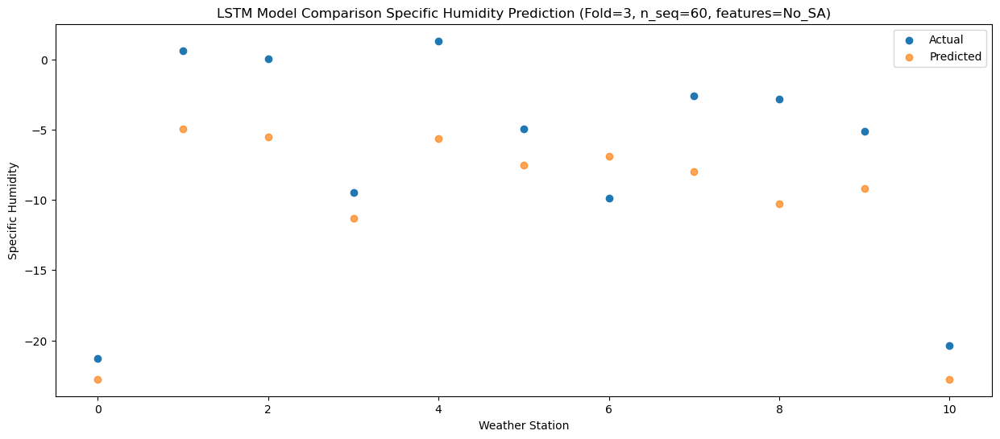

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -23.541958
1                 1   -0.54  -5.731959
2                 2    1.29  -6.261961
3                 3  -10.94 -12.101960
4                 4   -0.14  -6.401959
5                 5   -6.39  -8.281960
6                 6   -9.60  -7.651961
7                 7   -2.02  -8.731961
8                 8   -1.62 -11.051961
9                 9   -8.13  -9.971960
10               10  -21.91 -23.541960


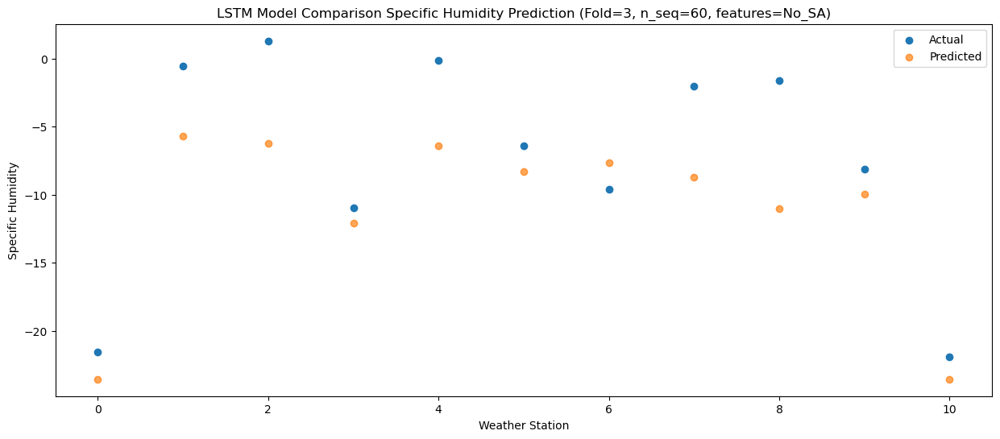

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -25.236518
1                 1   -4.26  -7.426519
2                 2    3.59  -7.956521
3                 3  -12.26 -13.796520
4                 4   -4.01  -8.096519
5                 5   -9.11  -9.976520
6                 6   -9.50  -9.346521
7                 7    0.83 -10.426521
8                 8   -0.69 -12.746521
9                 9   -8.25 -11.666520
10               10  -22.71 -25.236520


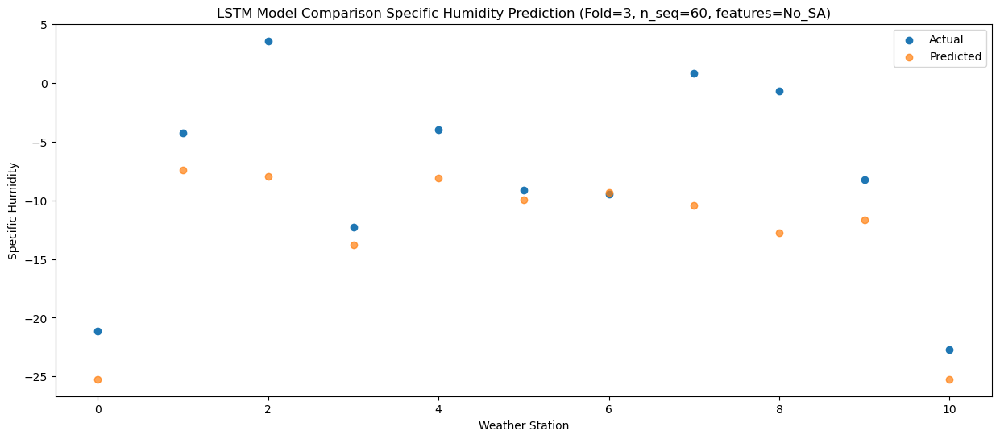

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -17.269258
1                 1    7.71   0.540741
2                 2    4.74   0.010739
3                 3   -2.05  -5.829260
4                 4    9.07  -0.129259
5                 5    2.22  -2.009260
6                 6   -6.53  -1.379261
7                 7    2.43  -2.459261
8                 8   -0.91  -4.779261
9                 9   -3.25  -3.699260
10               10  -15.52 -17.269260


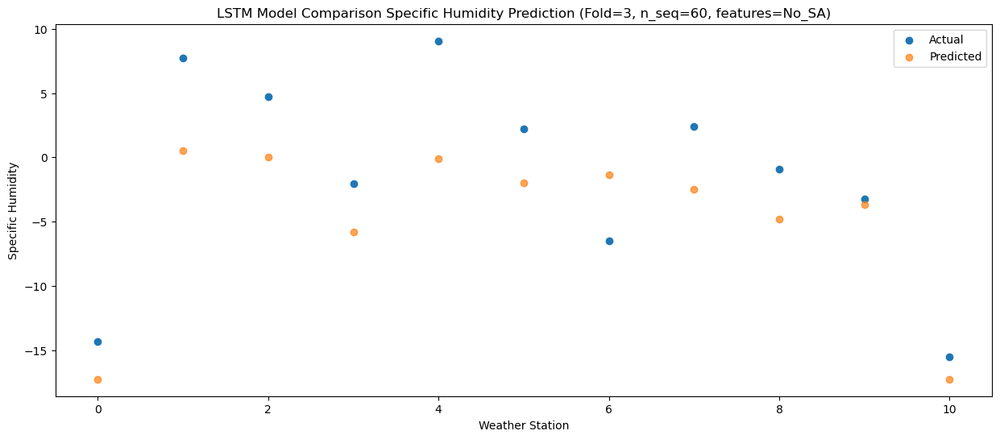

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21 -14.758107
1                 1    9.57   3.051892
2                 2   10.47   2.521890
3                 3    0.30  -3.318109
4                 4   12.36   2.381892
5                 5    5.67   0.501891
6                 6   -1.75   1.131890
7                 7   10.40   0.051890
8                 8    1.28  -2.268110
9                 9    1.37  -1.188109
10               10  -10.65 -14.758109


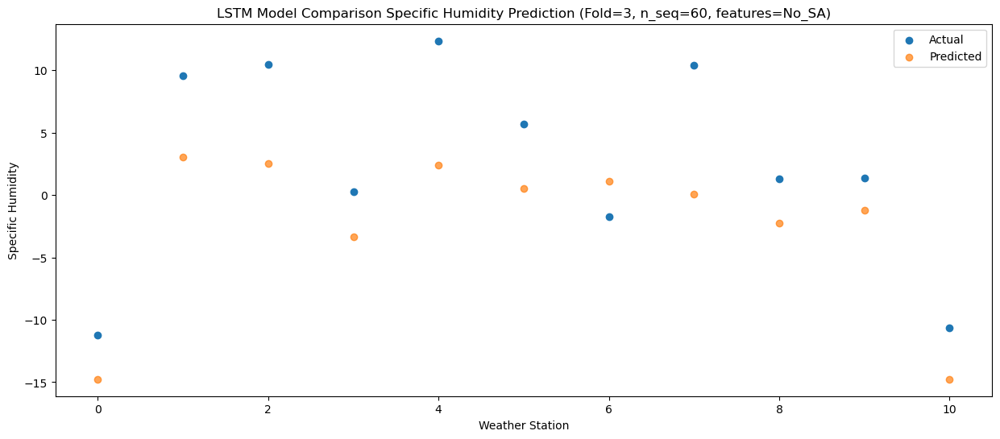

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55 -11.269542
1                 1   13.79   6.540457
2                 2   15.27   6.010455
3                 3    4.37   0.170456
4                 4   16.93   5.870457
5                 5    9.95   3.990456
6                 6    3.30   4.620455
7                 7   14.83   3.540455
8                 8    5.57   1.220455
9                 9    6.20   2.300456
10               10   -6.39 -11.269544


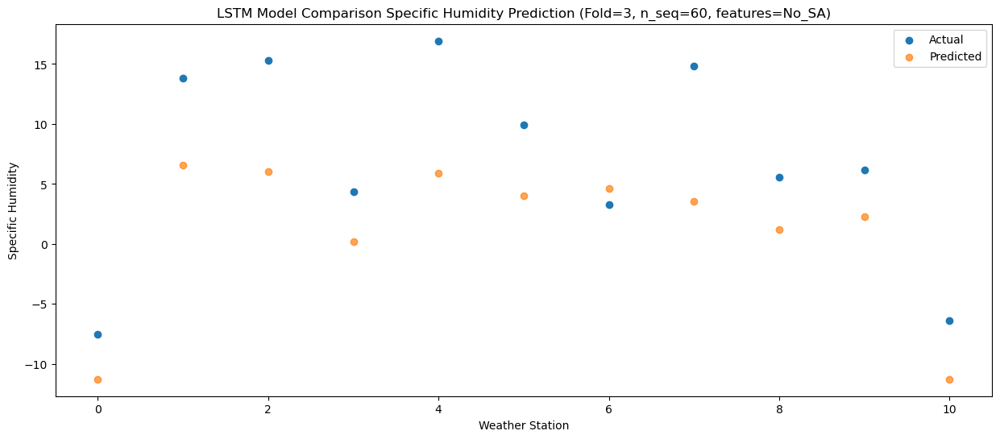

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49  -5.426053
1                 1   20.50  12.383946
2                 2   20.12  11.853945
3                 3   10.29   6.013946
4                 4   24.41  11.713946
5                 5   16.66   9.833946
6                 6   10.69  10.463945
7                 7   22.47   9.383945
8                 8    7.27   7.063945
9                 9   12.07   8.143946
10               10   -0.22  -5.426054


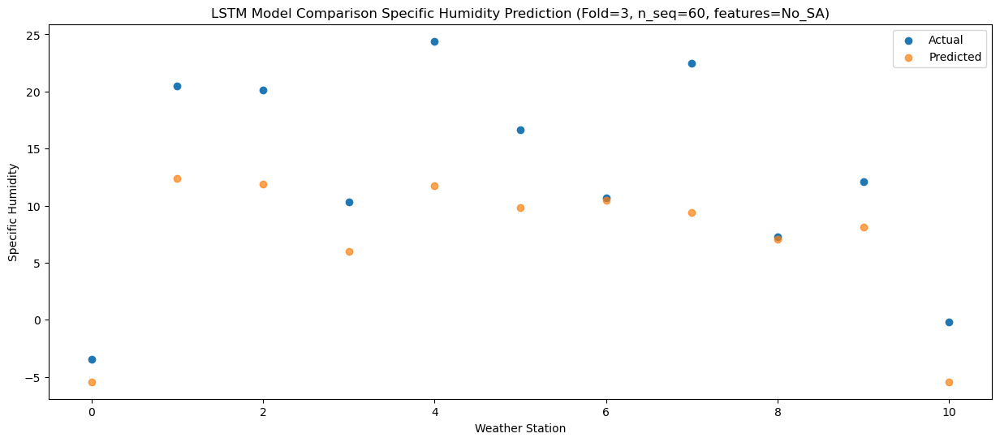

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -4.897670
1                 1   21.81  12.912329
2                 2   23.25  12.382327
3                 3   11.28   6.542328
4                 4   24.41  12.242329
5                 5   17.04  10.362328
6                 6   12.53  10.992327
7                 7   23.55   9.912327
8                 8    6.45   7.592327
9                 9   14.21   8.672328
10               10    1.42  -4.897672


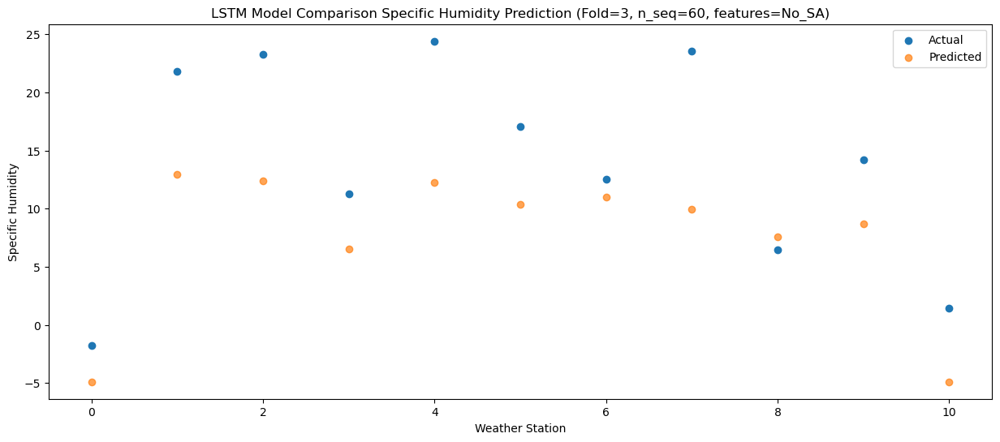

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -4.448577
1                 1   22.38  13.361422
2                 2   21.05  12.831419
3                 3   11.80   6.991421
4                 4   24.53  12.691422
5                 5   17.36  10.811421
6                 6   10.61  11.441419
7                 7   22.32  10.361419
8                 8    7.00   8.041420
9                 9   14.83   9.121421
10               10    1.15  -4.448579


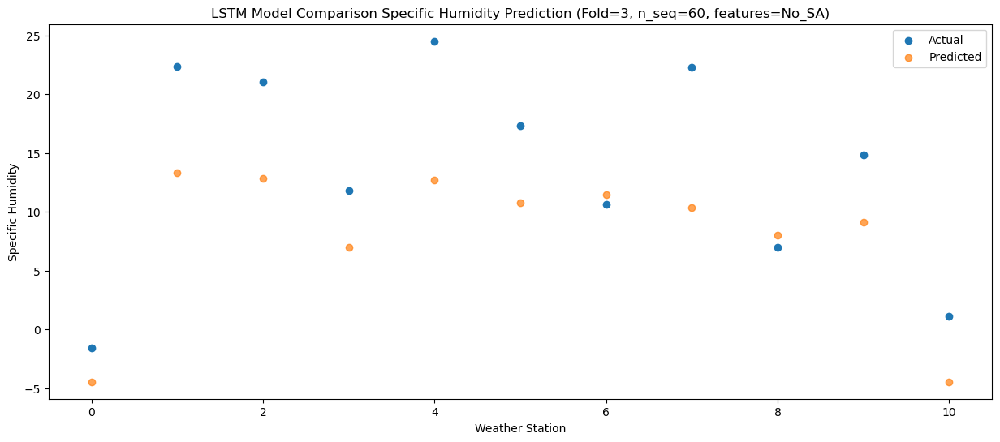

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -7.550002
1                 1   19.65  10.259997
2                 2   17.74   9.729994
3                 3    7.67   3.889996
4                 4   21.17   9.589997
5                 5   14.10   7.709996
6                 6    8.74   8.339994
7                 7   18.35   7.259994
8                 8    6.45   4.939995
9                 9   11.51   6.019996
10               10   -3.11  -7.550004


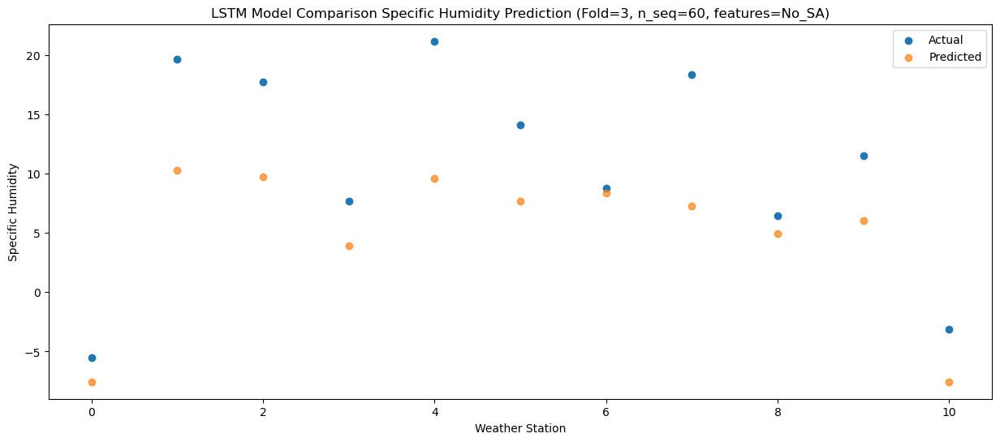

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78 -12.475768
1                 1   13.05   5.334231
2                 2    9.08   4.804228
3                 3    4.09  -1.035770
4                 4   15.75   4.664231
5                 5    9.52   2.784230
6                 6    0.77   3.414228
7                 7    8.00   2.334228
8                 8    3.69   0.014228
9                 9    7.07   1.094230
10               10   -7.23 -12.475770


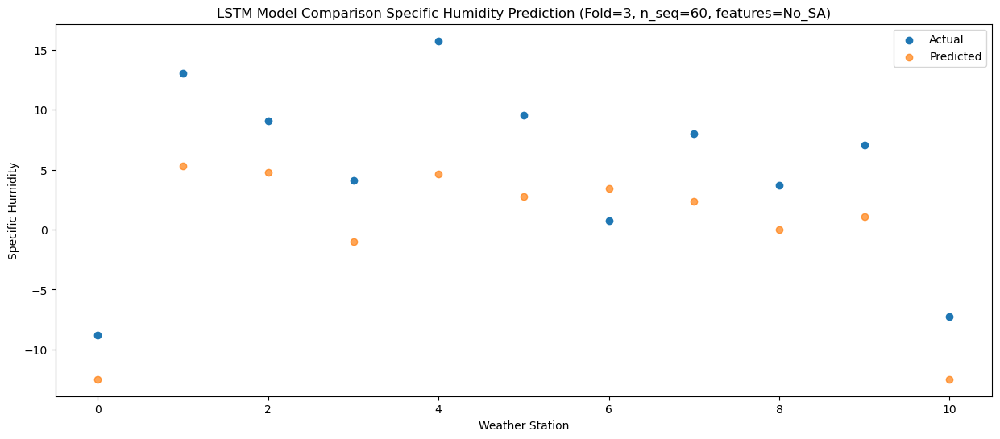

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -20.883491
1                 1    5.34  -3.073492
2                 2    4.74  -3.603496
3                 3   -5.57  -9.443493
4                 4    6.01  -3.743492
5                 5   -1.33  -5.623494
6                 6   -1.97  -4.993496
7                 7    5.48  -6.073496
8                 8    0.87  -8.393496
9                 9   -1.85  -7.313493
10               10  -17.45 -20.883493


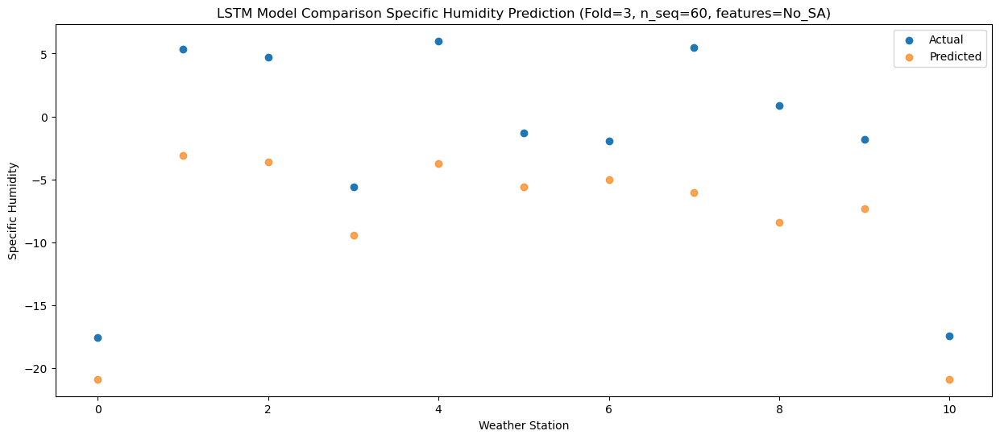

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -21.148275
1                 1    6.65  -3.338275
2                 2    0.82  -3.868280
3                 3   -4.08  -9.708276
4                 4    5.65  -4.008275
5                 5   -0.28  -5.888278
6                 6   -6.73  -5.258280
7                 7   -1.79  -6.338280
8                 8   -2.83  -8.658280
9                 9   -3.45  -7.578276
10               10  -17.86 -21.148276


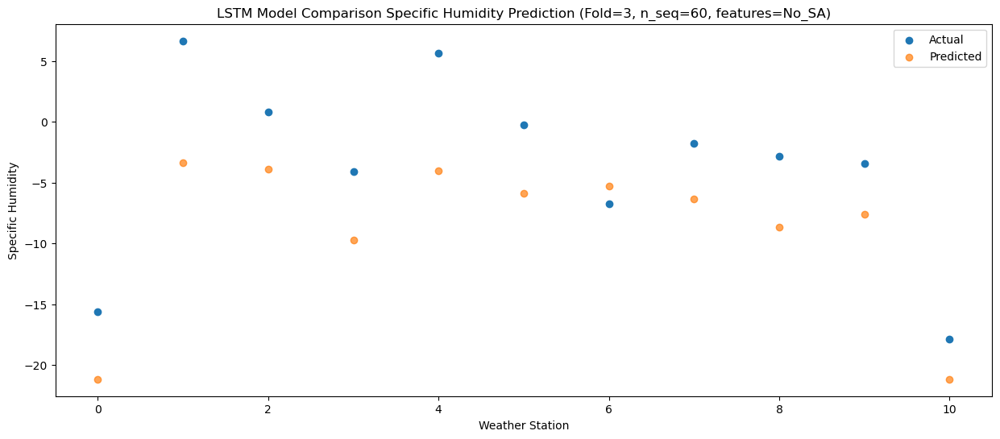

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -28.022706
1                 1   -2.18 -10.212707
2                 2    0.49 -10.742711
3                 3  -13.03 -16.582708
4                 4   -3.82 -10.882707
5                 5   -9.10 -12.762709
6                 6   -9.02 -12.132711
7                 7   -1.86 -13.212711
8                 8   -2.21 -15.532711
9                 9  -10.00 -14.452708
10               10  -24.84 -28.022708


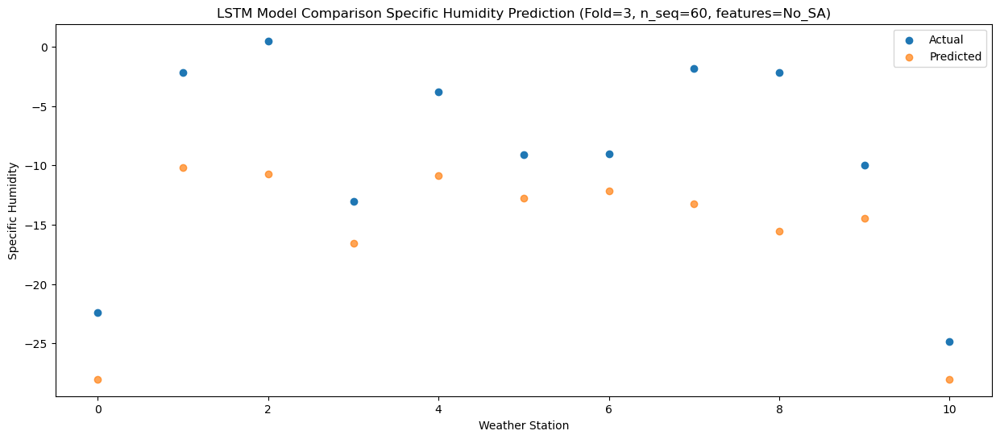

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -25.423280
1                 1   -0.96  -7.613281
2                 2    2.19  -8.143286
3                 3   -8.51 -13.983282
4                 4   -1.30  -8.283281
5                 5   -5.91 -10.163284
6                 6  -10.74  -9.533286
7                 7    0.18 -10.613286
8                 8   -1.25 -12.933286
9                 9   -7.24 -11.853282
10               10  -21.03 -25.423282


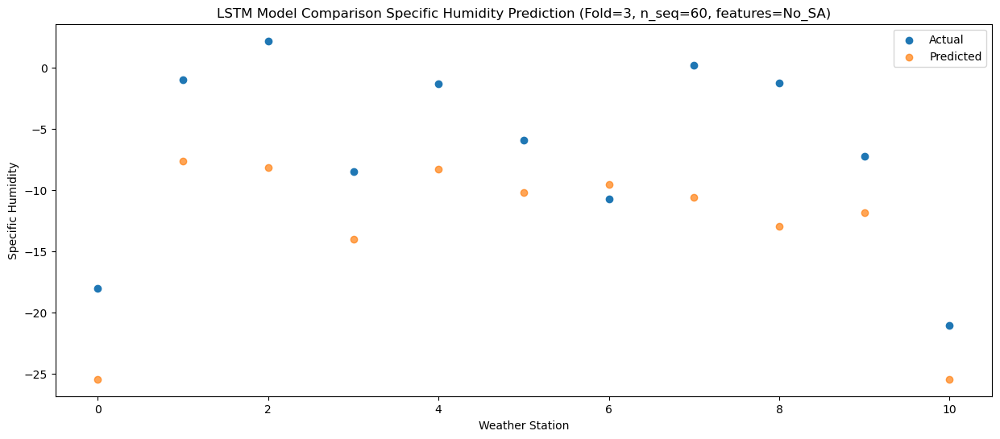

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -20.365732
1                 1    5.82  -2.555733
2                 2    6.90  -3.085740
3                 3   -2.76  -8.925734
4                 4    7.16  -3.225733
5                 5    1.05  -5.105738
6                 6   -6.20  -4.475740
7                 7    4.89  -5.555740
8                 8    0.98  -7.875740
9                 9   -3.28  -6.795734
10               10  -15.85 -20.365734


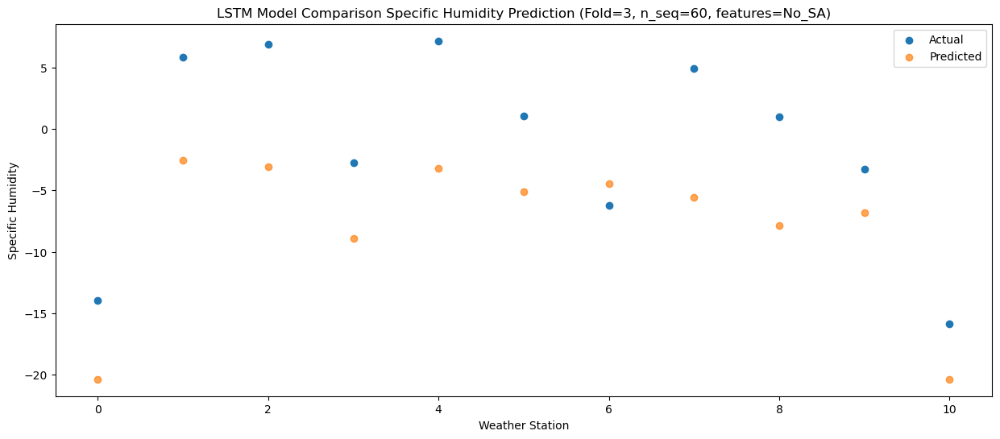

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88 -16.858952
1                 1   10.67   0.951047
2                 2    9.97   0.421041
3                 3    0.25  -5.418954
4                 4   11.29   0.281047
5                 5    4.90  -1.598957
6                 6   -1.88  -0.968959
7                 7    9.52  -2.048959
8                 8    2.42  -4.368959
9                 9    1.01  -3.288954
10               10  -12.03 -16.858954


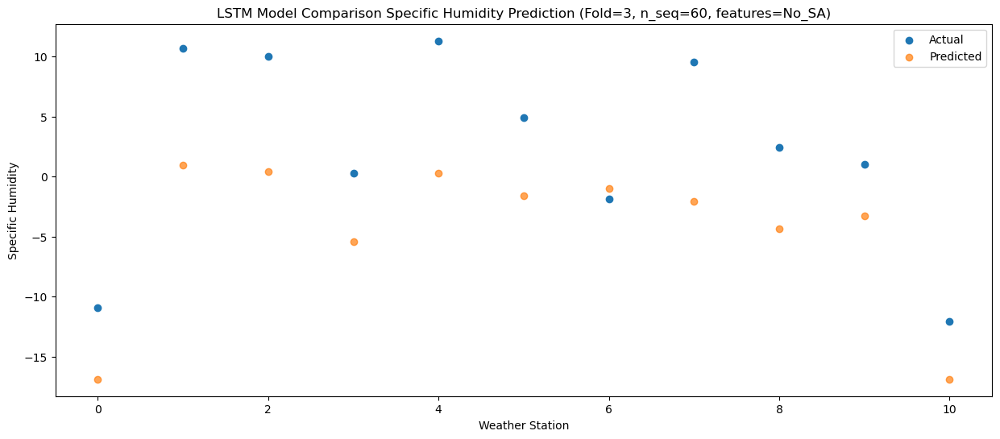

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04 -11.261540
1                 1   16.10   6.548460
2                 2   14.21   6.018453
3                 3    7.03   0.178459
4                 4   18.86   5.878460
5                 5   12.70   3.998455
6                 6    4.03   4.628453
7                 7   14.19   3.548453
8                 8    5.41   1.228453
9                 9    6.80   2.308459
10               10   -5.25 -11.261541


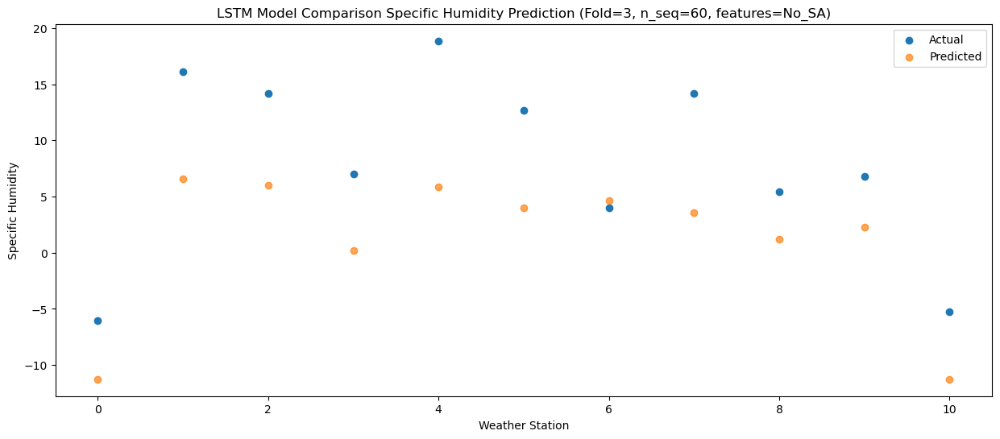

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08  -7.467698
1                 1   21.25  10.342301
2                 2   19.60   9.812295
3                 3   10.51   3.972300
4                 4   24.31   9.672301
5                 5   16.64   7.792297
6                 6    9.80   8.422295
7                 7   20.67   7.342295
8                 8    8.56   5.022295
9                 9   11.12   6.102300
10               10   -1.26  -7.467700


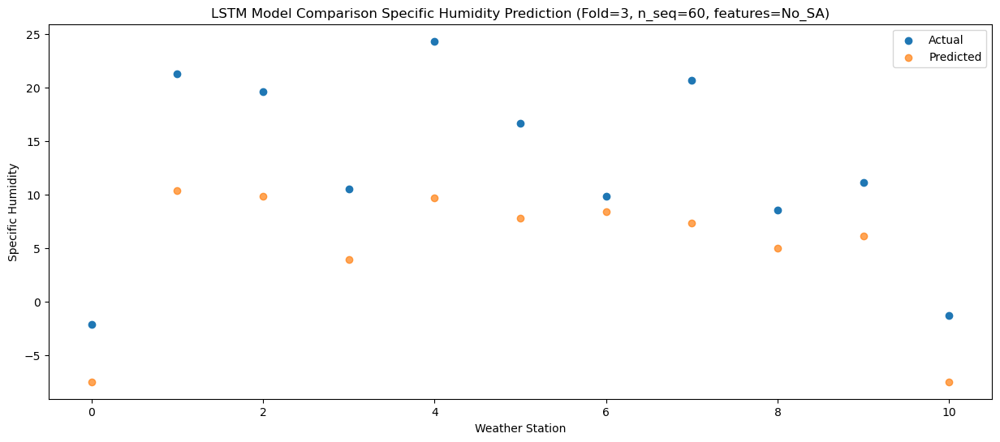

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -4.892298
1                 1   25.29  12.917701
2                 2   22.17  12.387694
3                 3   12.06   6.547700
4                 4   25.43  12.247701
5                 5   18.63  10.367696
6                 6   11.72  10.997694
7                 7   22.90   9.917694
8                 8    6.91   7.597694
9                 9   15.67   8.677700
10               10    2.52  -4.892300


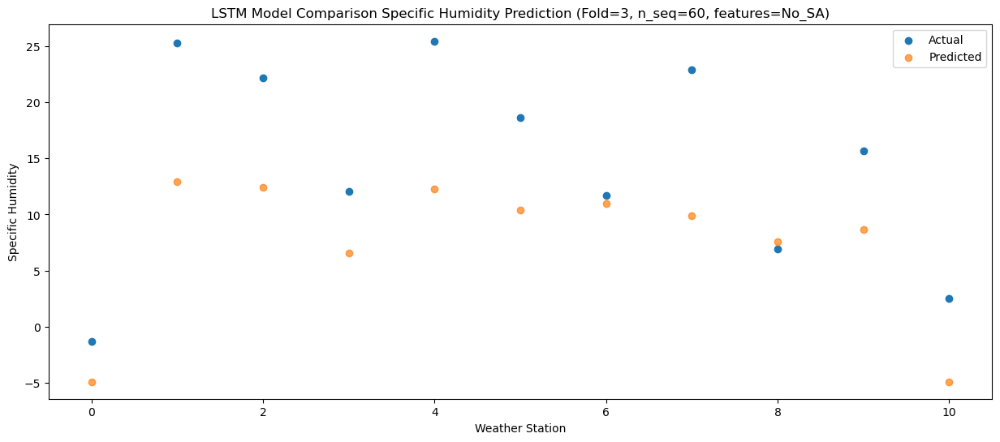

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22  -6.535718
1                 1   22.21  11.274281
2                 2   22.35  10.744274
3                 3   10.99   4.904280
4                 4   23.61  10.604281
5                 5   16.98   8.724276
6                 6   10.96   9.354274
7                 7   21.31   8.274274
8                 8    8.33   5.954274
9                 9   15.59   7.034280
10               10    1.65  -6.535720


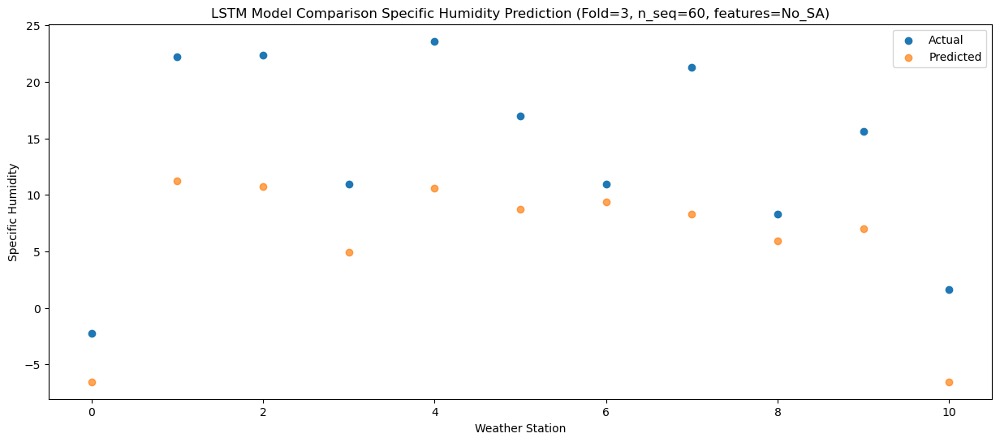

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43 -10.400419
1                 1   18.35   7.409581
2                 2   19.53   6.879574
3                 3    7.01   1.039580
4                 4   19.29   6.739581
5                 5   13.03   4.859576
6                 6    8.80   5.489573
7                 7   18.95   4.409573
8                 8    8.56   2.089574
9                 9   10.68   3.169580
10               10   -3.58 -10.400420


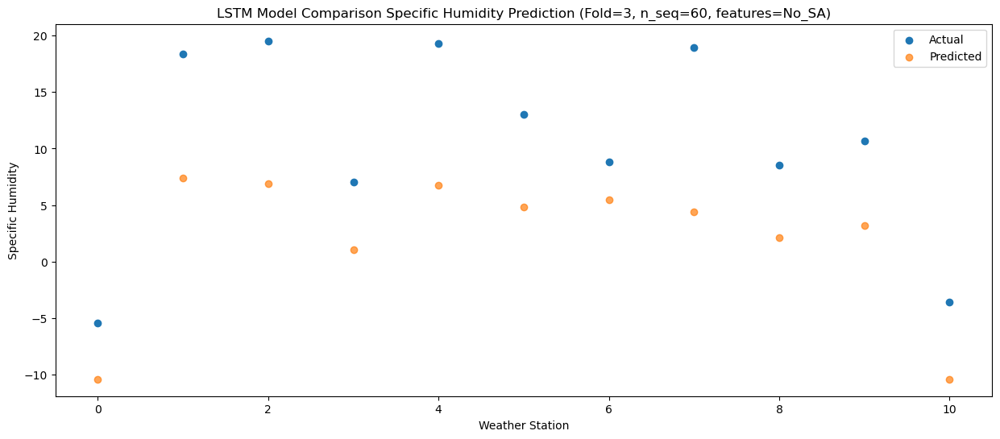

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44 -17.084981
1                 1   11.80   0.725019
2                 2   12.35   0.195012
3                 3   -0.26  -5.644982
4                 4   12.02   0.055019
5                 5    6.99  -1.824986
6                 6    0.54  -1.194989
7                 7   11.06  -2.274989
8                 8    3.83  -4.594988
9                 9    4.42  -3.514982
10               10  -11.19 -17.084983


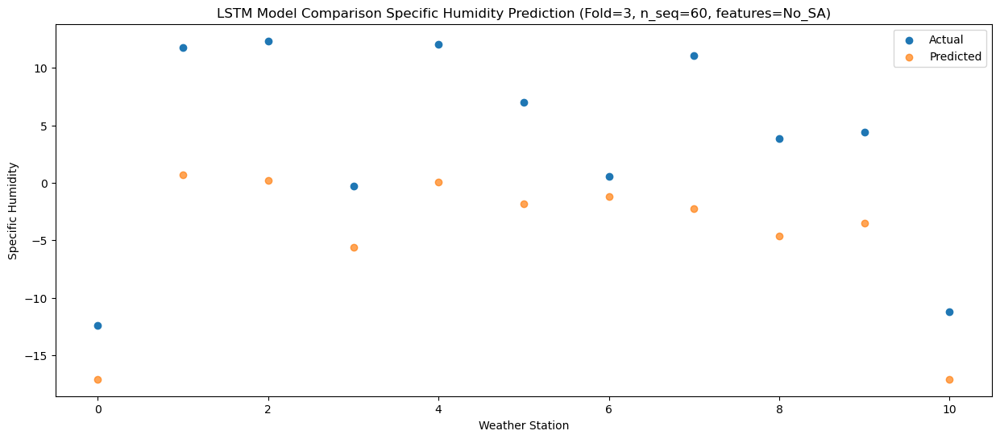

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -22.230293
1                 1    4.57  -4.420293
2                 2    1.62  -4.950298
3                 3   -3.38 -10.790294
4                 4    6.13  -5.090293
5                 5    0.44  -6.970297
6                 6   -7.14  -6.340300
7                 7   -0.36  -7.420299
8                 8   -1.90  -9.740298
9                 9    0.46  -8.660294
10               10  -14.31 -22.230295


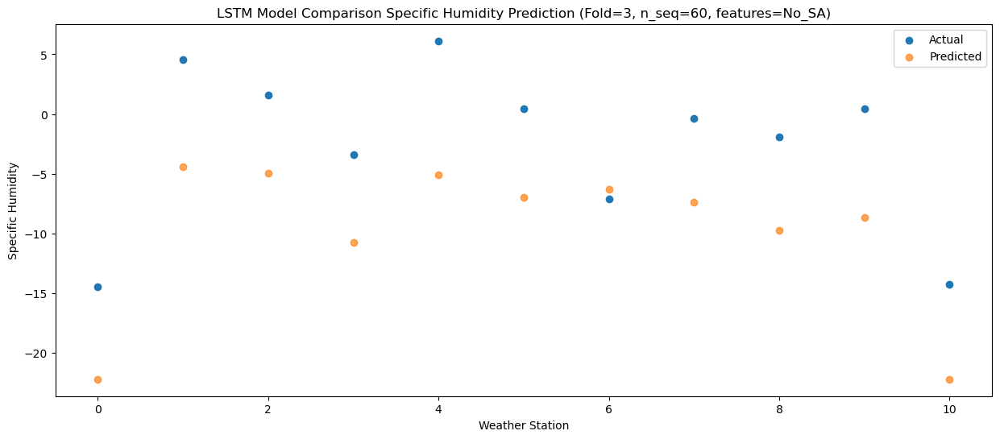

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -27.901141
1                 1    0.52 -10.091141
2                 2    0.66 -10.621146
3                 3   -8.65 -16.461141
4                 4    0.16 -10.761141
5                 5   -5.10 -12.641146
6                 6   -9.31 -12.011148
7                 7   -2.69 -13.091147
8                 8   -3.10 -15.411146
9                 9   -5.90 -14.331141
10               10  -21.34 -27.901142


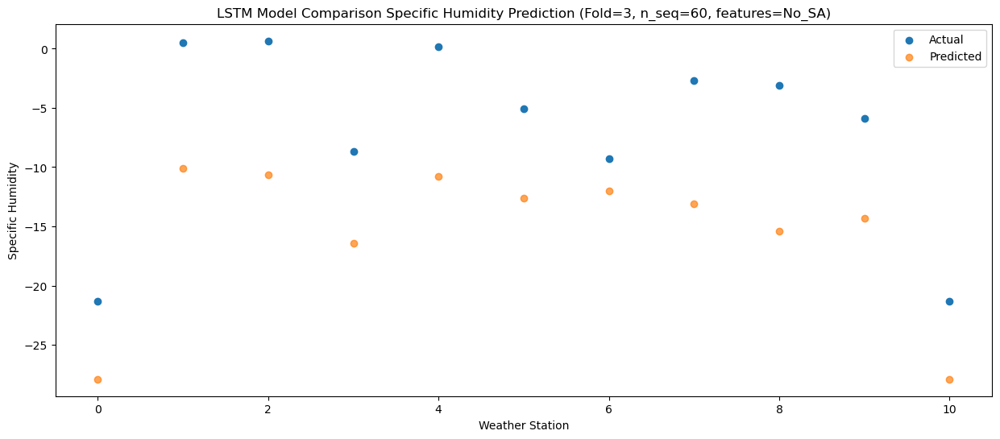

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -26.077654
1                 1    1.22  -8.267653
2                 2    2.05  -8.797659
3                 3   -6.90 -14.637654
4                 4    1.88  -8.937653
5                 5   -2.96 -10.817659
6                 6  -10.04 -10.187661
7                 7   -3.20 -11.267660
8                 8   -1.43 -13.587659
9                 9   -3.92 -12.507654
10               10  -18.69 -26.077655


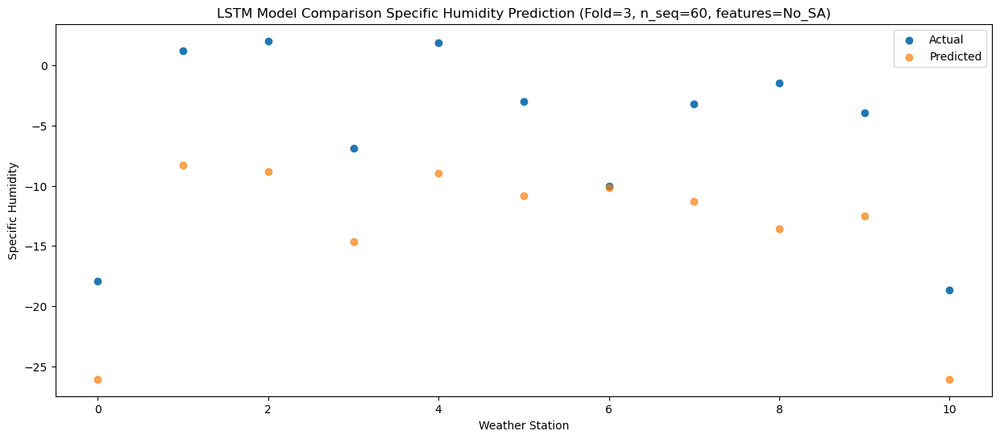

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -24.982616
1                 1    3.18  -7.172615
2                 2    1.20  -7.702621
3                 3   -4.56 -13.542616
4                 4    8.40  -7.842615
5                 5   -1.24  -9.722621
6                 6  -10.01  -9.092623
7                 7   -2.29 -10.172622
8                 8   -3.23 -12.492621
9                 9   -5.65 -11.412616
10               10  -18.48 -24.982617


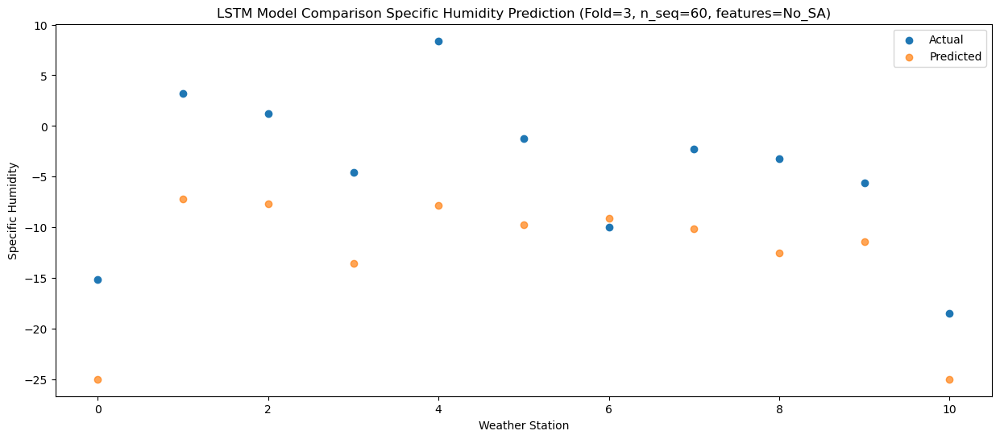

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -24.135536
1                 1    5.78  -6.325535
2                 2    4.07  -6.855541
3                 3   -4.32 -12.695536
4                 4    5.44  -6.995535
5                 5   -0.34  -8.875541
6                 6   -8.22  -8.245542
7                 7    0.54  -9.325542
8                 8   -1.77 -11.645541
9                 9   -3.68 -10.565536
10               10  -16.92 -24.135537


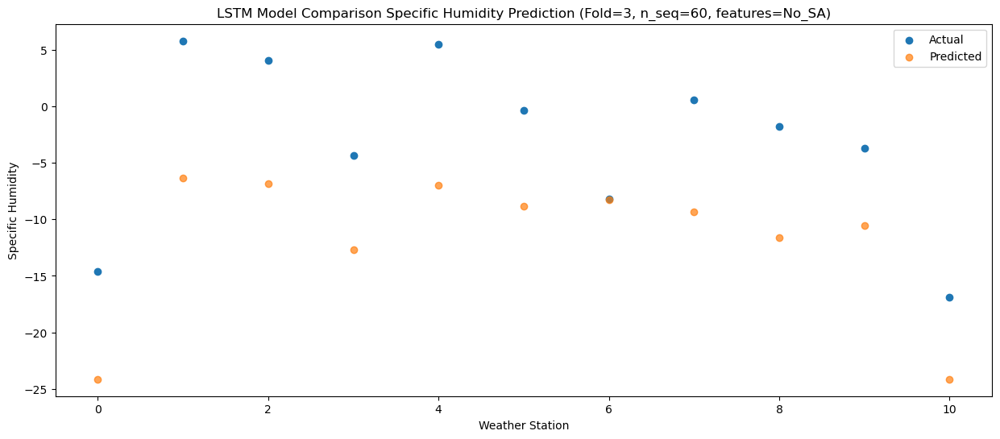

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97 -18.989986
1                 1   10.83  -1.179985
2                 2    9.70  -1.709991
3                 3    1.92  -7.549986
4                 4   12.65  -1.849985
5                 5    5.89  -3.729991
6                 6   -2.88  -3.099993
7                 7    8.49  -4.179992
8                 8    2.31  -6.499991
9                 9    2.37  -5.419986
10               10   -9.35 -18.989987


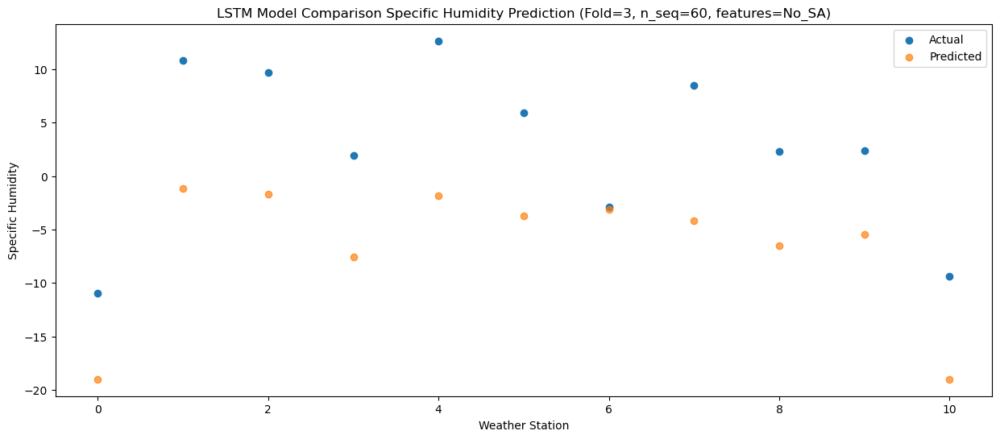

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61 -15.464225
1                 1   16.14   2.345776
2                 2   14.14   1.815770
3                 3    4.61  -4.024225
4                 4   18.65   1.675776
5                 5   11.30  -0.204230
6                 6    4.33   0.425768
7                 7   14.29  -0.654231
8                 8    3.34  -2.974230
9                 9    6.01  -1.894225
10               10   -6.88 -15.464226


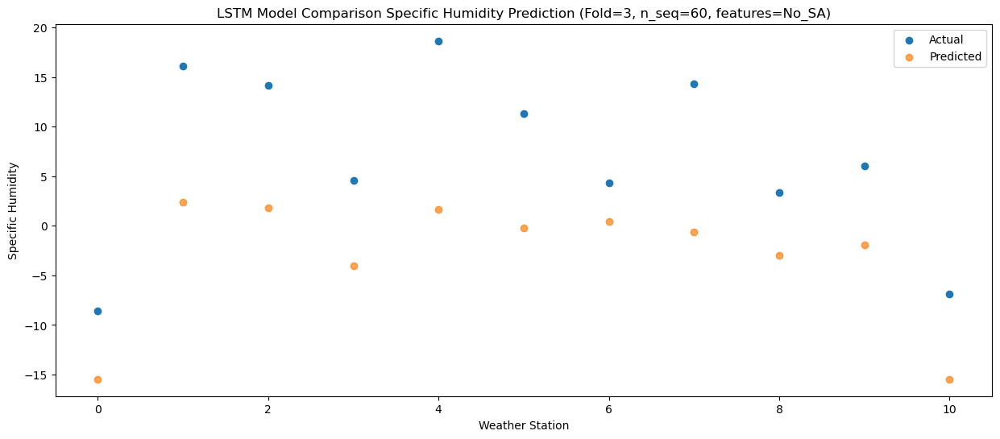

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84 -12.347312
1                 1   20.47   5.462691
2                 2   16.94   4.932685
3                 3    8.35  -0.907310
4                 4   22.75   4.792691
5                 5   14.76   2.912685
6                 6    8.91   3.542683
7                 7   16.79   2.462684
8                 8    5.24   0.142685
9                 9   10.00   1.222690
10               10   -2.95 -12.347311


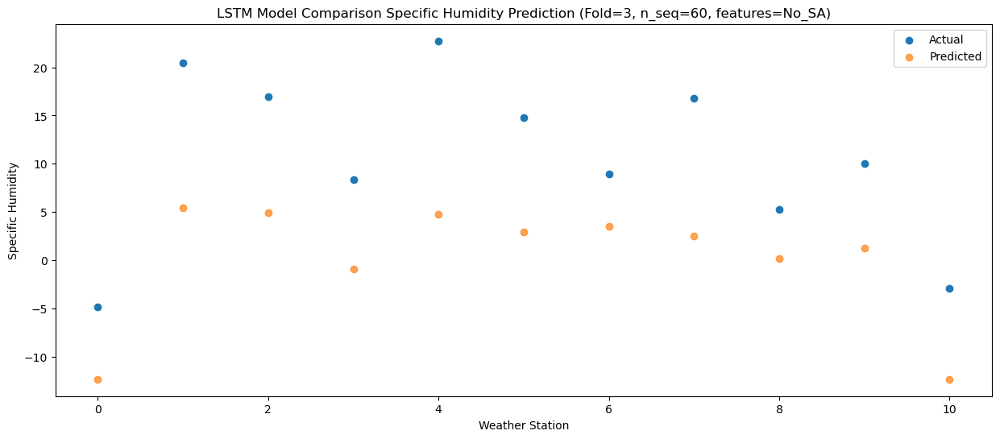

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -9.434221
1                 1   22.73   8.375782
2                 2   22.60   7.845776
3                 3   11.97   2.005781
4                 4   24.45   7.705782
5                 5   18.02   5.825776
6                 6   15.05   6.455774
7                 7   25.15   5.375775
8                 8    8.25   3.055776
9                 9   15.68   4.135781
10               10    1.89  -9.434220


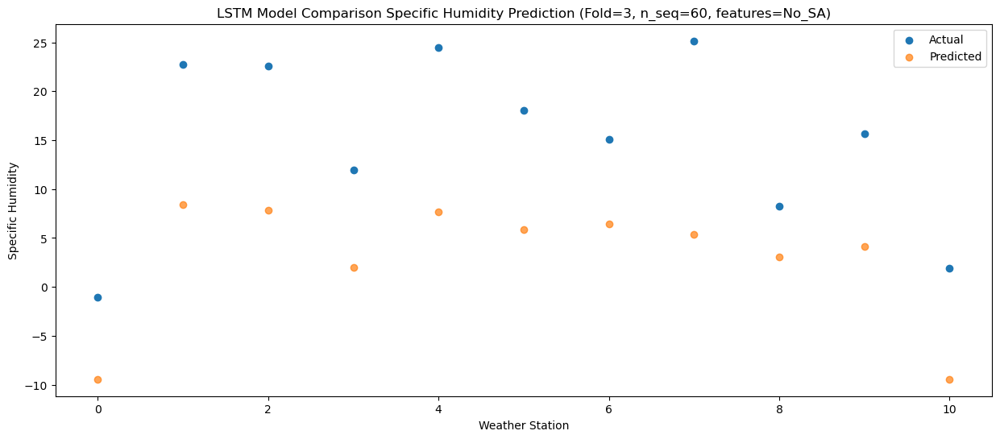

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57 -10.292109
1                 1   22.91   7.517893
2                 2   20.91   6.987887
3                 3   10.86   1.147893
4                 4   23.16   6.847894
5                 5   16.47   4.967888
6                 6   12.46   5.597886
7                 7   20.52   4.517886
8                 8    9.28   2.197887
9                 9   13.43   3.277893
10               10   -0.08 -10.292108


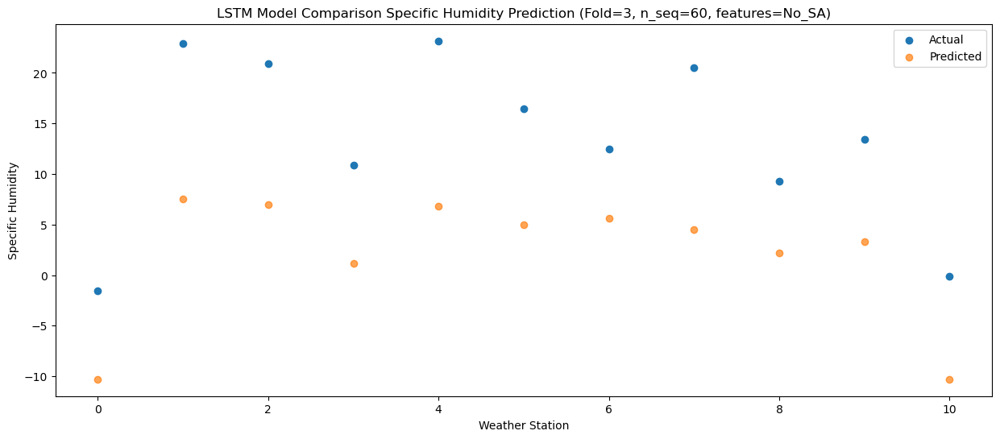

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71 -13.795386
1                 1   18.86   4.014616
2                 2   17.14   3.484611
3                 3    8.13  -2.355384
4                 4   19.80   3.344617
5                 5   13.01   1.464611
6                 6    8.31   2.094609
7                 7   15.82   1.014610
8                 8    6.67  -1.305389
9                 9   10.86  -0.225384
10               10   -3.37 -13.795385


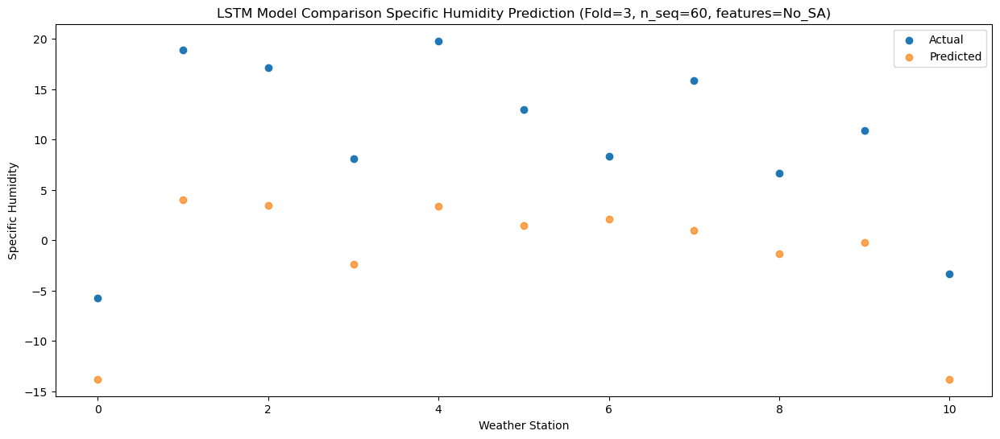

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74 -19.561701
1                 1   11.92  -1.751700
2                 2   11.83  -2.281704
3                 3    2.69  -8.121700
4                 4   13.34  -2.421699
5                 5    7.36  -4.301704
6                 6    2.18  -3.671706
7                 7   10.53  -4.751705
8                 8    5.21  -7.071704
9                 9    5.43  -5.991700
10               10   -8.66 -19.561701


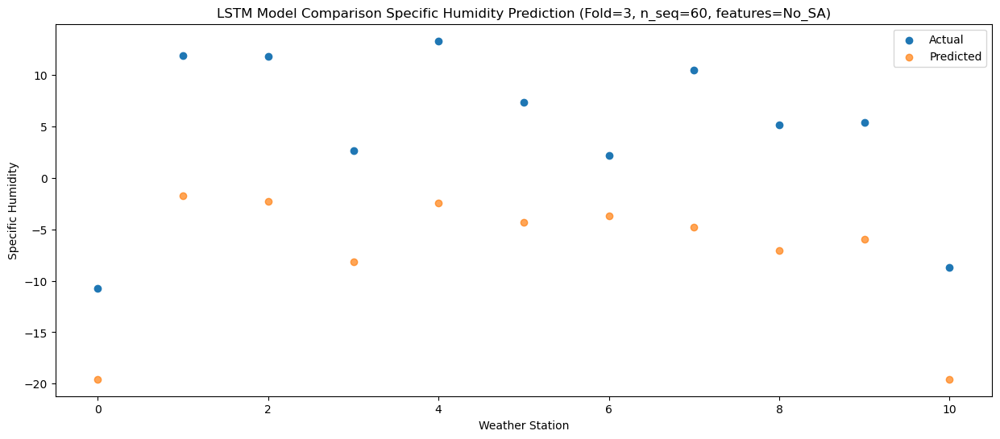

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -25.929272
1                 1    6.14  -8.119270
2                 2    4.92  -8.649275
3                 3   -3.70 -14.489270
4                 4    6.39  -8.789269
5                 5    0.88 -10.669275
6                 6   -3.68 -10.039277
7                 7    2.39 -11.119276
8                 8    1.17 -13.439275
9                 9   -2.42 -12.359270
10               10  -16.93 -25.929271


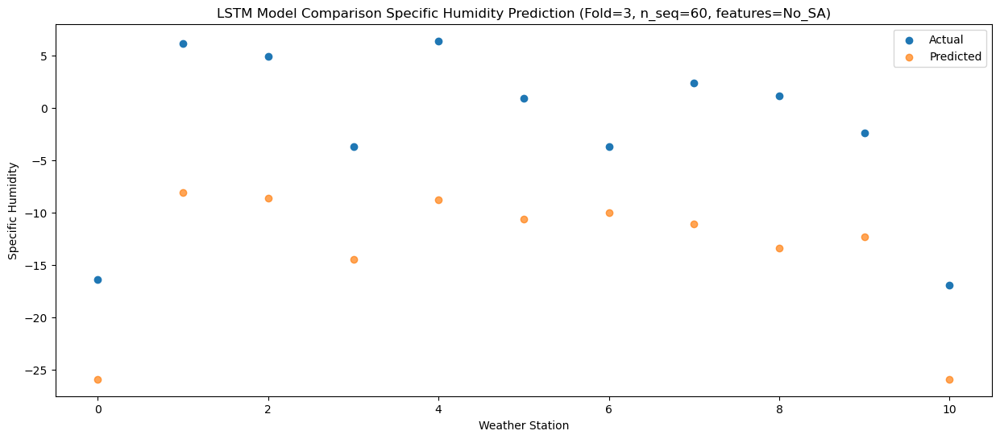

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -28.045595
1                 1    2.79 -10.235593
2                 2    3.08 -10.765598
3                 3   -5.53 -16.605593
4                 4    3.58 -10.905592
5                 5   -1.58 -12.785598
6                 6   -7.31 -12.155600
7                 7   -0.74 -13.235599
8                 8   -0.67 -15.555598
9                 9   -3.15 -14.475593
10               10  -17.68 -28.045594


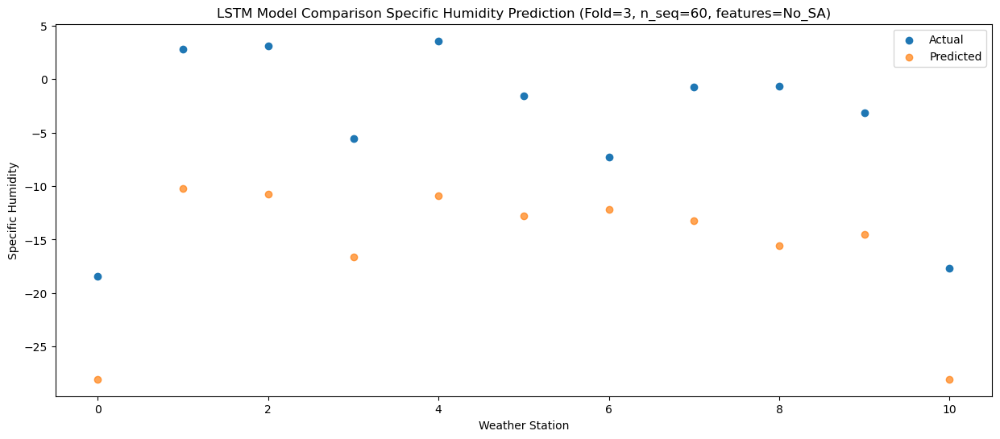

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -32.373440
1                 1   -3.82 -14.563438
2                 2    2.87 -15.093442
3                 3  -10.69 -20.933438
4                 4   -2.92 -15.233437
5                 5   -7.74 -17.113442
6                 6   -9.45 -16.483444
7                 7   -2.46 -17.563443
8                 8   -0.36 -19.883442
9                 9   -7.14 -18.803438
10               10  -20.70 -32.373439


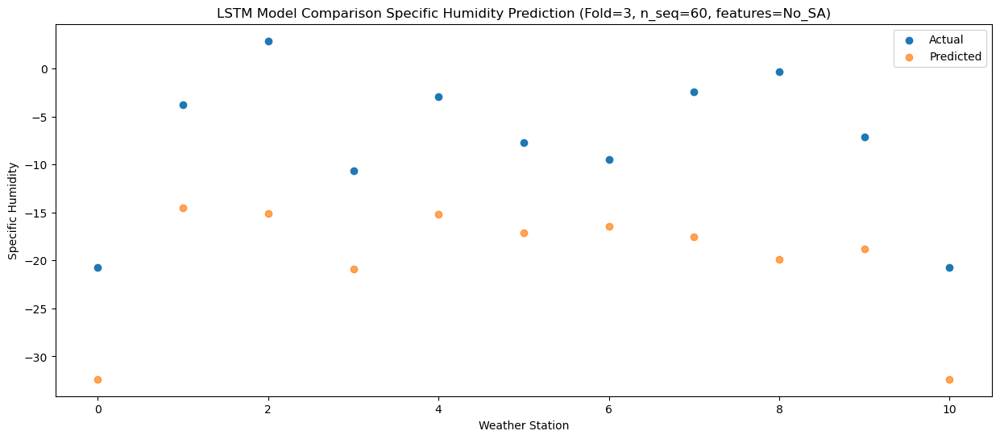

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -28.169148
1                 1    5.83 -10.359146
2                 2    4.36 -10.889151
3                 3   -5.01 -16.729146
4                 4    4.89 -11.029145
5                 5   -1.11 -12.909151
6                 6   -7.29 -12.279152
7                 7   -0.10 -13.359152
8                 8   -0.65 -15.679151
9                 9   -6.57 -14.599146
10               10  -18.66 -28.169147


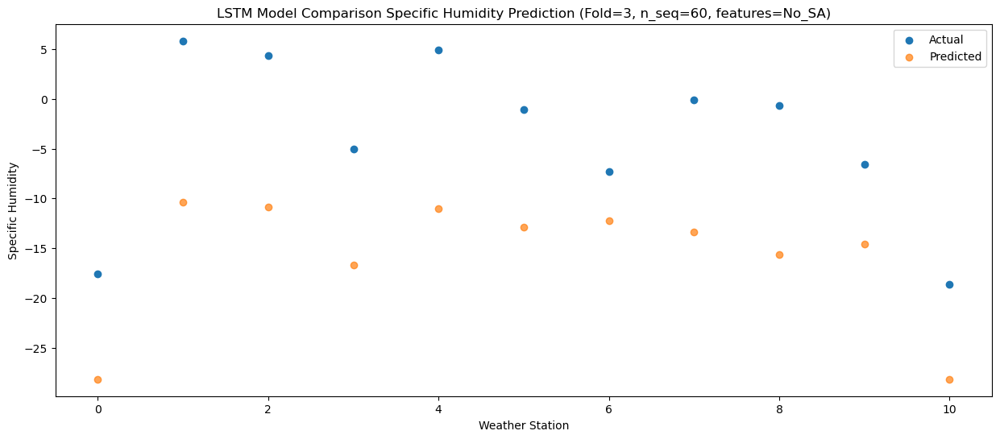

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -25.216498
1                 1    8.31  -7.406496
2                 2    6.39  -7.936500
3                 3   -1.36 -13.776496
4                 4    9.00  -8.076495
5                 5    2.96  -9.956500
6                 6   -5.55  -9.326502
7                 7    3.26 -10.406501
8                 8    0.28 -12.726500
9                 9   -1.87 -11.646496
10               10  -14.00 -25.216497


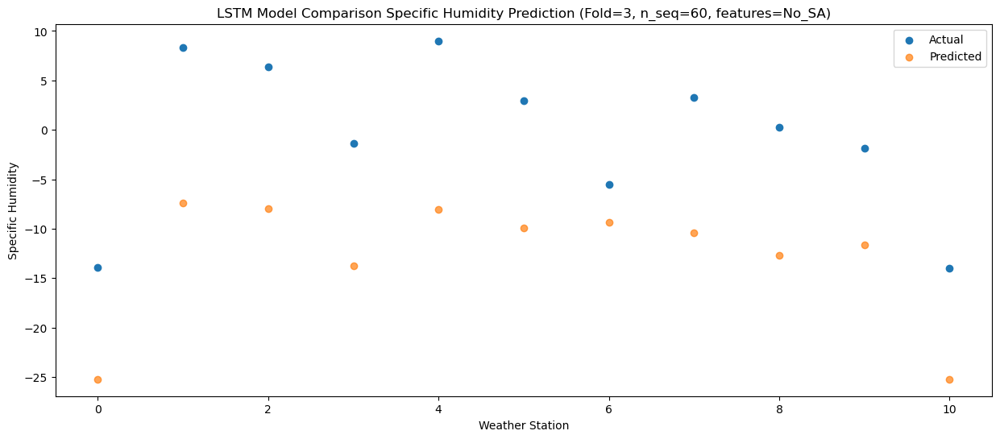

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93 -21.535934
1                 1   12.48  -3.725932
2                 2    9.58  -4.255937
3                 3    3.70 -10.095932
4                 4   13.75  -4.395931
5                 5    7.93  -6.275937
6                 6   -0.57  -5.645938
7                 7    8.76  -6.725938
8                 8    2.51  -9.045937
9                 9    1.00  -7.965932
10               10   -9.42 -21.535933


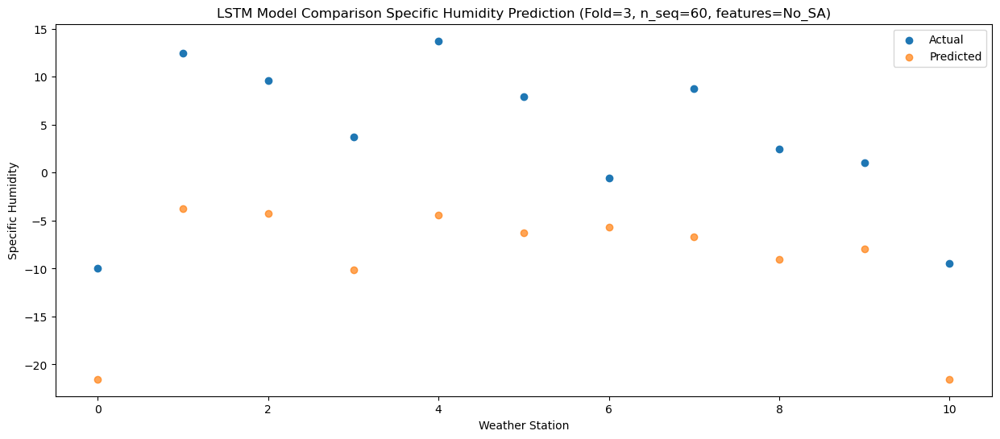

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66 -16.874201
1                 1   17.25   0.935800
2                 2   14.97   0.405796
3                 3    7.89  -5.434200
4                 4   19.91   0.265801
5                 5   13.45  -1.614204
6                 6    2.54  -0.984206
7                 7   14.39  -2.064205
8                 8    5.48  -4.384204
9                 9    6.55  -3.304200
10               10   -3.75 -16.874201


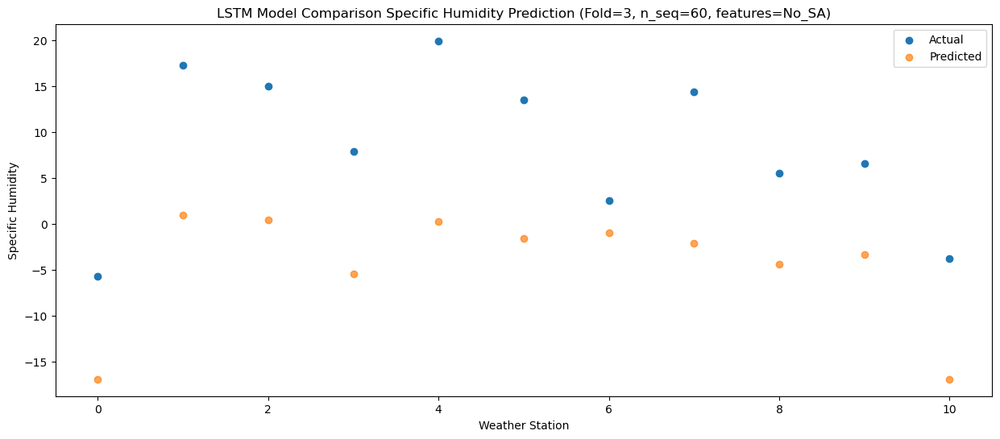

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00 -13.011944
1                 1   21.81   4.798058
2                 2   20.92   4.268054
3                 3   11.79  -1.571942
4                 4   24.78   4.128059
5                 5   16.68   2.248054
6                 6   11.69   2.878052
7                 7   22.57   1.798053
8                 8    8.39  -0.521946
9                 9   13.02   0.558058
10               10    1.62 -13.011943


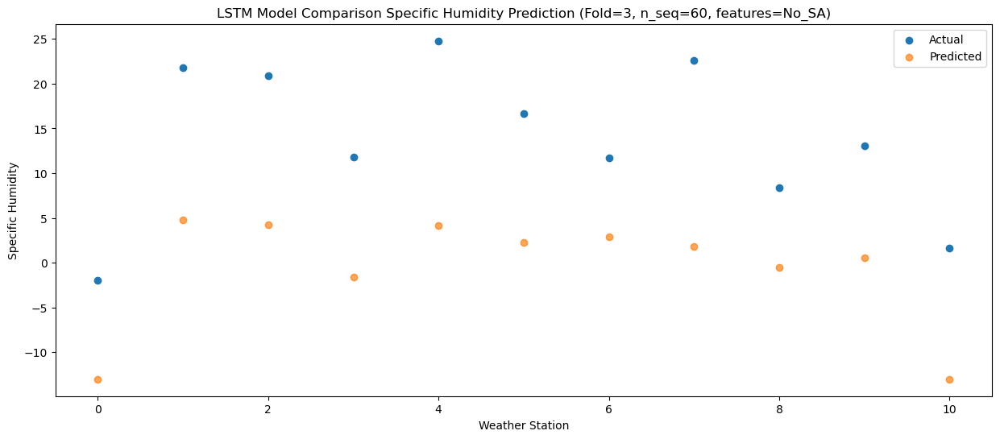

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11 -12.064129
1                 1   22.33   5.745873
2                 2   24.49   5.215869
3                 3   13.50  -0.624127
4                 4   23.94   5.075874
5                 5   17.23   3.195869
6                 6   12.44   3.825867
7                 7   25.65   2.745868
8                 8    9.65   0.425869
9                 9   15.58   1.505873
10               10    4.28 -12.064128


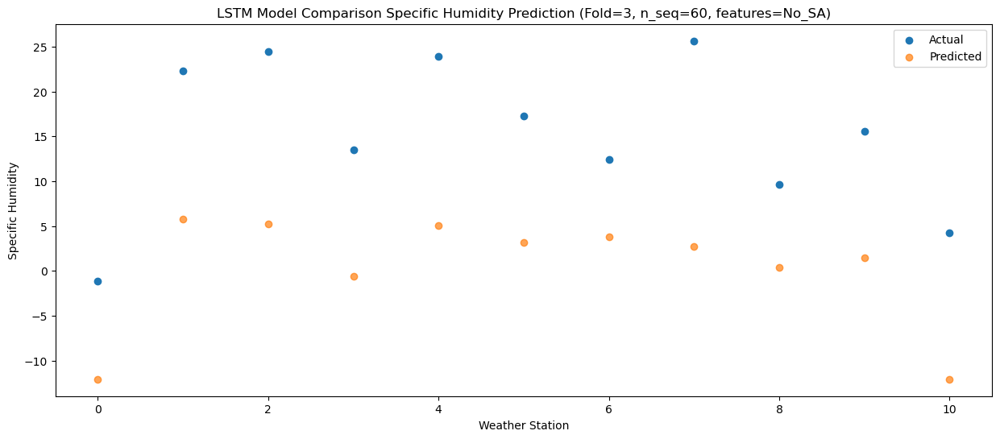

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51 -13.276899
1                 1   22.61   4.533103
2                 2   21.52   4.003098
3                 3   12.48  -1.836897
4                 4   23.39   3.863104
5                 5   16.68   1.983098
6                 6   12.15   2.613096
7                 7   22.79   1.533097
8                 8    8.37  -0.786902
9                 9   13.86   0.293103
10               10    1.14 -13.276898


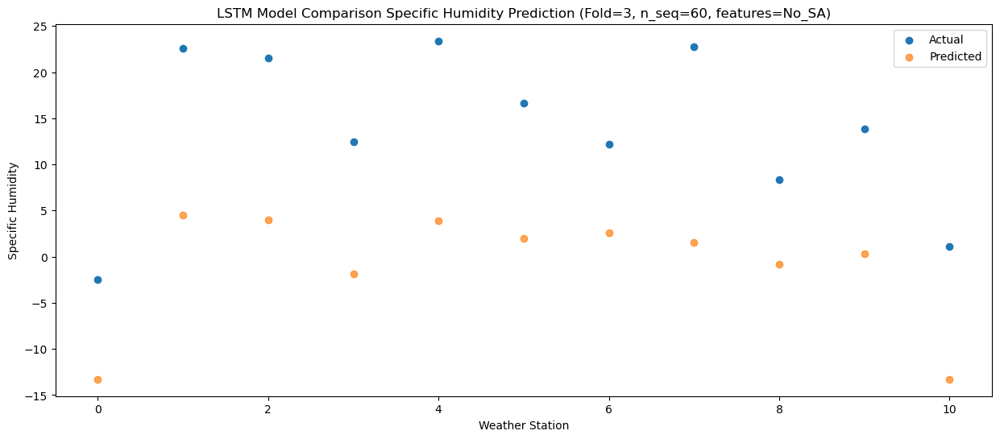

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20 -16.814312
1                 1   18.57   0.995690
2                 2   18.49   0.465685
3                 3    9.51  -5.374310
4                 4   20.13   0.325691
5                 5   13.99  -1.554315
6                 6    8.53  -0.924317
7                 7   18.84  -2.004316
8                 8    6.93  -4.324315
9                 9    9.85  -3.244310
10               10   -2.45 -16.814311


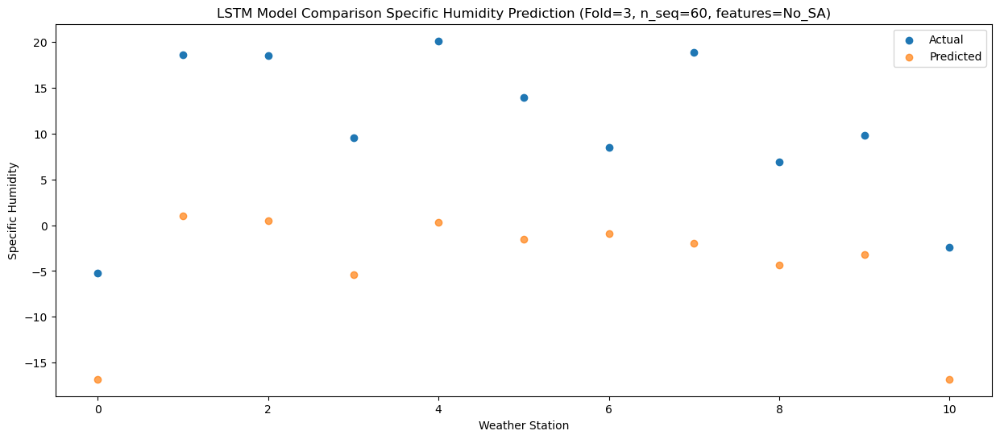

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51 -22.280983
1                 1   15.18  -4.470981
2                 2   13.46  -5.000986
3                 3    3.01 -10.840981
4                 4   14.50  -5.140980
5                 5    8.11  -7.020986
6                 6    4.30  -6.390988
7                 7   12.95  -7.470987
8                 8    6.47  -9.790986
9                 9    5.32  -8.710981
10               10   -7.69 -22.280982


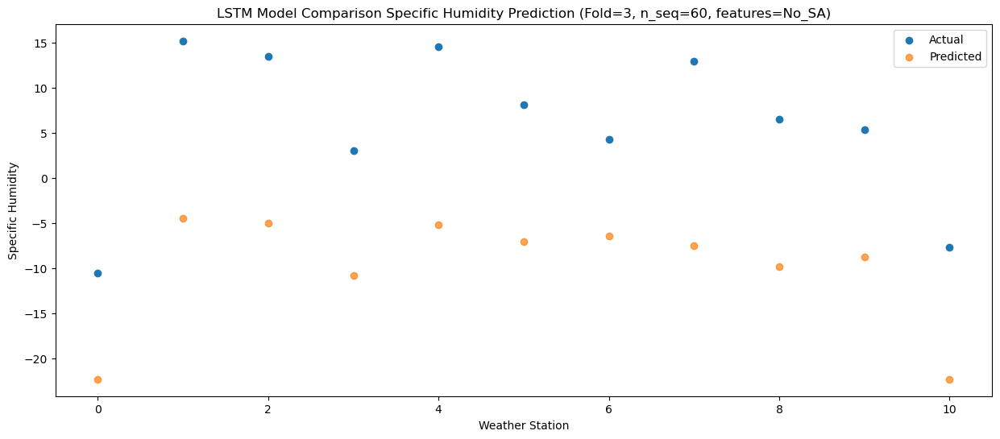

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (1, 1, 512)               4767744   
                                                                 
 dropout_6 (Dropout)         (1, 1, 512)               0         
                                                                 
 lstm_7 (LSTM)               (1, 512)                  2099200   
                                                                 
 dropout_7 (Dropout)         (1, 512)                  0         
                                                                 
 dense_9 (Dense)             (1, 256)                  131328    
                                                                 
 dense_10 (Dense)            (1, 128)                  32896     
                                                                 
 dense_11 (Dense)            (1, 60)                  

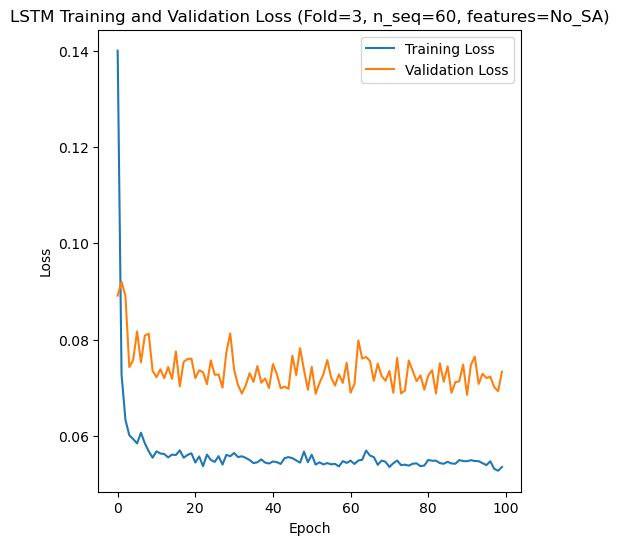

Epoch 1/100
84/84 [==============================] - 31s 141ms/step - loss: 0.1448 - accuracy: 0.1905 - mae: 0.1173 - rmse: 0.1448 - mape: inf - pearson: 0.5668 - val_loss: 0.0967 - val_accuracy: 0.6000 - val_mae: 0.0765 - val_rmse: 0.0967 - val_mape: 18.0436 - val_pearson: 0.7647
Epoch 2/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0697 - accuracy: 0.4286 - mae: 0.0554 - rmse: 0.0697 - mape: inf - pearson: 0.8149 - val_loss: 0.0669 - val_accuracy: 0.6000 - val_mae: 0.0540 - val_rmse: 0.0669 - val_mape: 12.2222 - val_pearson: 0.8417
Epoch 3/100
84/84 [==============================] - 7s 81ms/step - loss: 0.0606 - accuracy: 0.5000 - mae: 0.0480 - rmse: 0.0606 - mape: inf - pearson: 0.8319 - val_loss: 0.0801 - val_accuracy: 0.6000 - val_mae: 0.0635 - val_rmse: 0.0801 - val_mape: 15.3095 - val_pearson: 0.7833
Epoch 4/100
84/84 [==============================] - 6s 68ms/step - loss: 0.0630 - accuracy: 0.4286 - mae: 0.0498 - rmse: 0.0630 - mape: inf - pearson: 0.8290

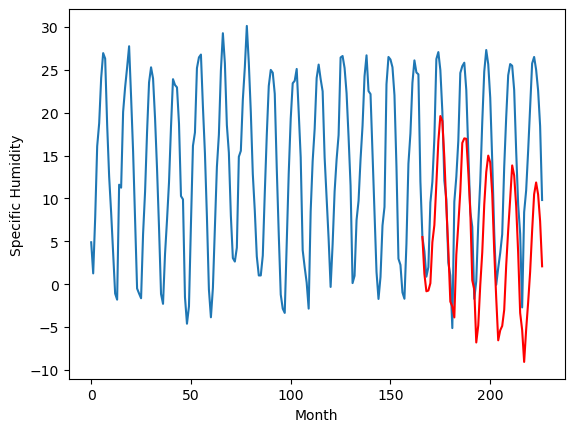

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.37		-0.48		-0.85
0.19		-2.51		-2.70
-1.27		-2.42		-1.15
0.28		-1.57		-1.85
4.35		3.22		-1.13
6.03		5.22		-0.81
7.43		10.05		2.62
9.19		15.01		5.82
9.51		17.94		8.43
9.36		17.35		7.99
8.78		13.08		4.30
7.28		7.38		0.10
3.89		2.37		-1.52
-3.86		-3.71		0.15
-3.16		-4.28		-1.12
0.27		-5.56		-5.83
1.87		1.75		-0.12
3.31		5.27		1.96
7.35		9.13		1.78
8.98		14.80		5.82
9.35		15.33		5.98
9.63		15.28		5.65
8.34		11.43		3.09
6.50		6.87		0.37
-0.66		-1.23		-0.57
1.14		-2.29		-3.43
-3.62		-8.48		-4.86
-0.19		-6.49		-6.30
2.63		-1.79		-4.42
4.97		2.02		-2.95
7.79		7.60		-0.19
9.51		11.39		1.88
9.88		13.32		3.44
9.83		12.52		2.69
8.39		8.85		0.46
4.56		2.18		-2.38
3.10		-3.29		-6.39
-1.75		-8.23		-6.48
-1.90		-7.07		-5.17
1.40		-6.55		-7.95
3.12		-4.68		-7.80
5.84		0.50		-5.34
6.62		4.62		-2.00
8.83		8.27		-0.56
10.44		12.17		1.73
10.95		11.00		0.05
8.85		7.45		-1.40
5.20		1.96		-3.24
1.49		-5.03		-6.52
-

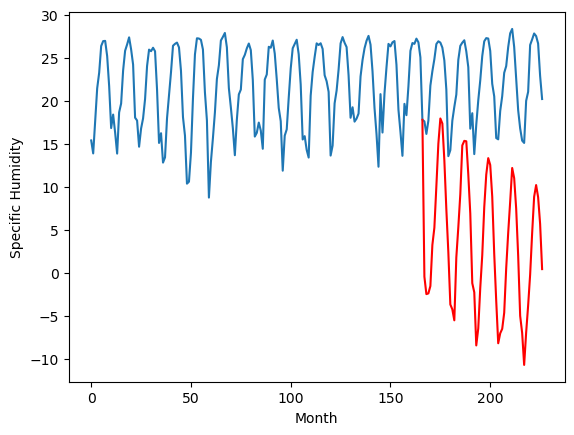

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-4.37		-3.86		0.51
-4.31		-5.89		-1.58
-4.50		-5.80		-1.30
-4.24		-4.95		-0.71
3.56		-0.16		-3.72
2.61		1.84		-0.77
6.49		6.67		0.18
10.58		11.63		1.05
12.15		14.56		2.41
11.32		13.97		2.65
9.22		9.70		0.48
3.88		4.00		0.12
-0.12		-1.01		-0.89
-6.37		-7.09		-0.72
-6.34		-7.66		-1.32
-8.26		-8.94		-0.68
1.07		-1.63		-2.70
2.14		1.89		-0.25
6.61		5.75		-0.86
10.87		11.42		0.55
11.53		11.95		0.42
12.18		11.90		-0.28
9.06		8.05		-1.01
5.67		3.49		-2.18
-3.00		-4.61		-1.61
0.51		-5.67		-6.18
-7.77		-11.86		-4.09
-5.41		-9.87		-4.46
-0.67		-5.17		-4.50
3.54		-1.36		-4.90
9.34		4.22		-5.12
12.63		8.01		-4.62
12.83		9.94		-2.89
11.29		9.14		-2.15
9.22		5.47		-3.75
3.09		-1.20		-4.29
-1.50		-6.67		-5.17
-3.93		-11.61		-7.68
-3.52		-10.45		-6.93
-1.58		-9.93		-8.35
0.57		-8.06		-8.63
2.32		-2.88		-5.20
7.18		1.24		-5.94
10.77		4.89		-5.88
12.55		8.79		-3.76
14.63		7.62		-7.01
10.88		4.07		-6.81
4.77		-

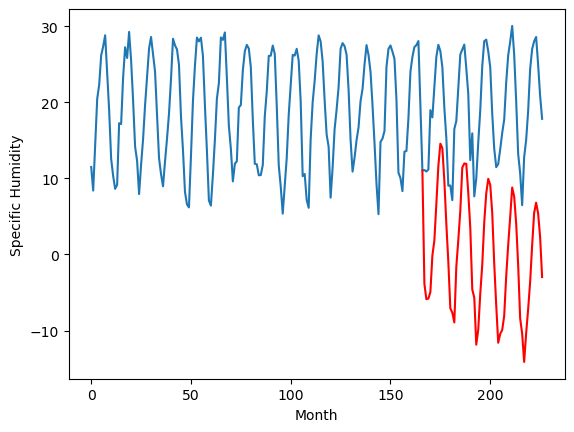

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-3.64		-4.50		-0.86
-5.29		-6.53		-1.24
-5.05		-6.44		-1.39
-5.38		-5.59		-0.21
2.08		-0.80		-2.88
2.74		1.20		-1.54
7.87		6.03		-1.84
12.83		10.99		-1.84
14.69		13.92		-0.77
14.44		13.33		-1.11
8.66		9.06		0.40
2.93		3.36		0.43
0.32		-1.65		-1.97
-5.96		-7.73		-1.77
-6.88		-8.30		-1.42
-10.34		-9.58		0.76
0.62		-2.27		-2.89
2.31		1.25		-1.06
6.47		5.11		-1.36
12.15		10.78		-1.37
13.74		11.31		-2.43
14.11		11.26		-2.85
11.32		7.41		-3.91
6.67		2.85		-3.82
-1.33		-5.25		-3.92
0.67		-6.31		-6.98
-7.80		-12.50		-4.70
-7.54		-10.51		-2.97
-1.36		-5.81		-4.45
4.69		-2.00		-6.69
9.40		3.58		-5.82
13.95		7.37		-6.58
17.25		9.30		-7.95
14.52		8.50		-6.02
11.09		4.83		-6.26
4.22		-1.84		-6.06
-2.83		-7.31		-4.48
-5.52		-12.25		-6.73
-4.53		-11.09		-6.56
-4.47		-10.57		-6.10
0.06		-8.70		-8.76
2.66		-3.52		-6.18
8.34		0.60		-7.74
12.53		4.25		-8.28
15.08		8.15		-6.93
17.63		6.98		-10.65
12.93		3.43		-9

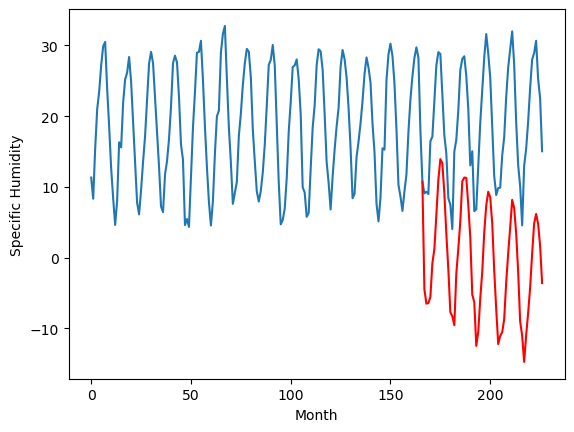

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.77		-3.23		-0.46
-4.55		-5.26		-0.71
-3.93		-5.17		-1.24
-4.31		-4.32		-0.01
3.57		0.47		-3.10
4.26		2.47		-1.79
9.91		7.30		-2.61
14.62		12.26		-2.36
17.06		15.19		-1.87
16.38		14.60		-1.78
10.08		10.33		0.25
4.33		4.63		0.30
1.57		-0.38		-1.95
-5.00		-6.46		-1.46
-5.60		-7.03		-1.43
-9.49		-8.31		1.18
1.43		-1.00		-2.43
3.61		2.52		-1.09
7.14		6.38		-0.76
13.99		12.05		-1.94
15.48		12.58		-2.90
15.85		12.53		-3.32
12.42		8.68		-3.74
7.55		4.12		-3.43
-0.29		-3.98		-3.69
1.45		-5.04		-6.49
-7.45		-11.23		-3.78
-6.83		-9.24		-2.41
0.09		-4.54		-4.63
6.78		-0.73		-7.51
11.61		4.85		-6.76
16.28		8.64		-7.64
19.70		10.57		-9.13
16.86		9.77		-7.09
12.77		6.10		-6.67
5.62		-0.57		-6.19
-1.47		-6.04		-4.57
-4.44		-10.98		-6.54
-3.67		-9.82		-6.15
-3.44		-9.30		-5.86
1.41		-7.43		-8.84
4.06		-2.25		-6.31
10.22		1.87		-8.35
15.33		5.52		-9.81
18.41		9.42		-8.99
20.28		8.25		-12.03
15.19		4.70		-10

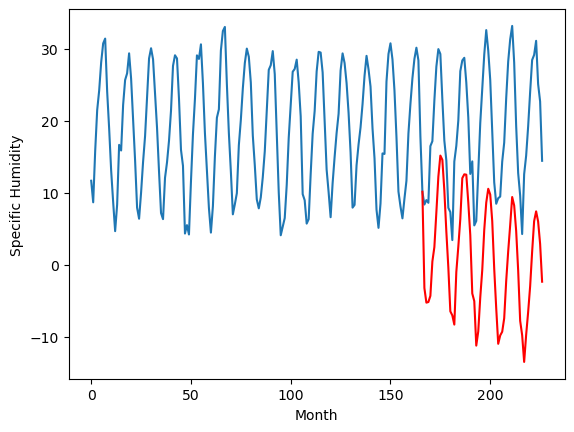

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
8.81		7.26		-1.55
7.17		5.23		-1.94
6.44		5.32		-1.12
5.68		6.17		0.49
13.24		10.96		-2.28
16.21		12.96		-3.25
22.78		17.79		-4.99
26.11		22.75		-3.36
28.94		25.68		-3.26
28.32		25.09		-3.23
20.59		20.82		0.23
16.63		15.12		-1.51
12.75		10.11		-2.64
5.77		4.03		-1.74
4.67		3.46		-1.21
3.10		2.18		-0.92
12.35		9.49		-2.86
14.58		13.01		-1.57
20.07		16.87		-3.20
25.03		22.54		-2.49
24.77		23.07		-1.70
25.09		23.02		-2.07
24.40		19.17		-5.23
18.70		14.61		-4.09
11.76		6.51		-5.25
12.17		5.45		-6.72
4.80		-0.74		-5.54
4.60		1.25		-3.35
11.92		5.95		-5.97
19.43		9.76		-9.67
25.12		15.34		-9.78
27.49		19.13		-8.36
29.39		21.06		-8.33
26.09		20.26		-5.83
23.19		16.59		-6.60
16.38		9.92		-6.46
8.53		4.45		-4.08
6.93		-0.49		-7.42
7.30		0.67		-6.63
7.47		1.19		-6.28
12.54		3.06		-9.48
16.76		8.24		-8.52
21.68		12.36		-9.32
28.16		16.01		-12.15
29.62		19.91		-9.71
29.71		18.74		-10.97
26.23		15.19		-11

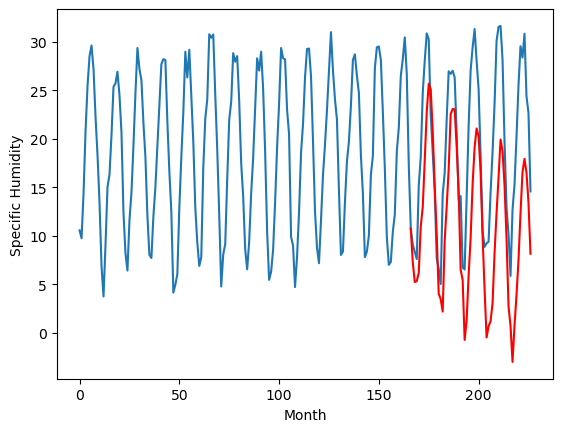

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.79		3.37		1.58
1.44		1.34		-0.10
1.27		1.43		0.16
1.74		2.28		0.54
7.35		7.07		-0.28
8.62		9.07		0.45
11.41		13.90		2.49
16.00		18.86		2.86
19.04		21.79		2.75
17.84		21.20		3.36
14.04		16.93		2.89
10.22		11.23		1.01
5.91		6.22		0.31
-1.34		0.14		1.48
-1.11		-0.43		0.68
-0.44		-1.71		-1.27
5.96		5.60		-0.36
8.69		9.12		0.43
12.14		12.98		0.84
16.16		18.65		2.49
17.90		19.18		1.28
18.03		19.13		1.10
14.06		15.28		1.22
10.26		10.72		0.46
2.10		2.62		0.52
4.01		1.56		-2.45
-2.05		-4.63		-2.58
2.23		-2.64		-4.87
5.79		2.06		-3.73
8.45		5.87		-2.58
14.43		11.45		-2.98
17.64		15.24		-2.40
18.91		17.17		-1.74
17.39		16.37		-1.02
14.30		12.70		-1.60
7.43		6.03		-1.40
4.73		0.56		-4.17
-1.22		-4.38		-3.16
1.80		-3.22		-5.02
5.22		-2.70		-7.92
5.70		-0.83		-6.53
8.81		4.35		-4.46
11.43		8.47		-2.96
15.07		12.12		-2.95
18.94		16.02		-2.92
18.38		14.85		-3.53
14.54		11.30		-3.24
9.10		5.81		-3.29
3.37		

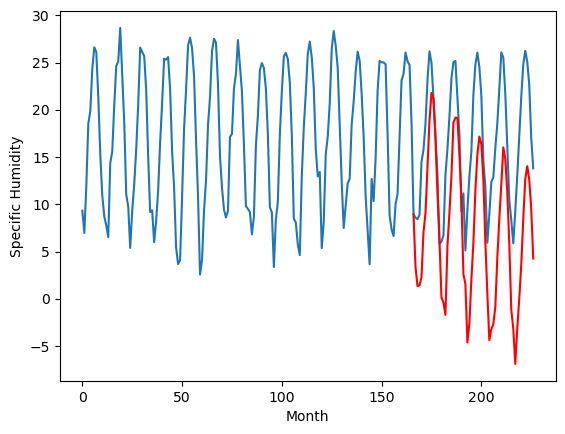

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.00		3.19		-0.81
3.19		1.16		-2.03
1.54		1.25		-0.29
2.11		2.10		-0.01
9.04		6.89		-2.15
10.62		8.89		-1.73
14.72		13.72		-1.00
21.07		18.68		-2.39
23.61		21.61		-2.00
21.62		21.02		-0.60
18.04		16.75		-1.29
11.11		11.05		-0.06
8.56		6.04		-2.52
2.03		-0.04		-2.07
0.36		-0.61		-0.97
-3.25		-1.89		1.36
9.02		5.42		-3.60
10.92		8.94		-1.98
14.96		12.80		-2.16
21.26		18.47		-2.79
22.55		19.00		-3.55
23.07		18.95		-4.12
20.03		15.10		-4.93
14.26		10.54		-3.72
6.32		2.44		-3.88
7.78		1.38		-6.40
-1.29		-4.81		-3.52
0.77		-2.82		-3.59
7.43		1.88		-5.55
11.29		5.69		-5.60
16.96		11.27		-5.69
22.28		15.06		-7.22
25.98		16.99		-8.99
22.46		16.19		-6.27
18.87		12.52		-6.35
12.50		5.85		-6.65
5.95		0.38		-5.57
1.10		-4.56		-5.66
2.75		-3.40		-6.15
4.89		-2.88		-7.77
6.61		-1.01		-7.62
12.23		4.17		-8.06
17.01		8.29		-8.72
21.09		11.94		-9.15
23.05		15.84		-7.21
22.86		14.67		-8.19
18.92		11.12		-7.80
1

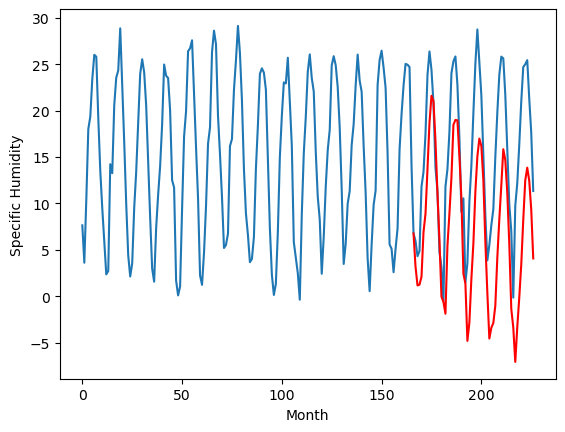

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.41		3.57		2.16
0.59		1.54		0.95
-0.34		1.63		1.97
-1.17		2.48		3.65
5.65		7.27		1.62
8.64		9.27		0.63
14.22		14.10		-0.12
21.51		19.06		-2.45
23.55		21.99		-1.56
21.35		21.40		0.05
17.59		17.13		-0.46
10.75		11.43		0.68
6.91		6.42		-0.49
-0.60		0.34		0.94
-2.18		-0.23		1.95
-5.54		-1.51		4.03
6.43		5.80		-0.63
10.08		9.32		-0.76
14.49		13.18		-1.31
21.73		18.85		-2.88
22.30		19.38		-2.92
23.16		19.33		-3.83
19.67		15.48		-4.19
14.32		10.92		-3.40
3.46		2.82		-0.64
3.78		1.76		-2.02
-5.06		-4.43		0.63
-2.04		-2.44		-0.40
5.43		2.26		-3.17
9.21		6.07		-3.14
17.71		11.65		-6.06
22.19		15.44		-6.75
24.13		17.37		-6.76
21.90		16.57		-5.33
17.99		12.90		-5.09
10.50		6.23		-4.27
4.71		0.76		-3.95
-1.07		-4.18		-3.11
0.89		-3.02		-3.91
2.48		-2.50		-4.98
3.75		-0.63		-4.38
10.25		4.55		-5.70
15.96		8.67		-7.29
19.84		12.32		-7.52
22.57		16.22		-6.35
21.41		15.05		-6.36
18.32		11.50		-6.82
12.18		6.

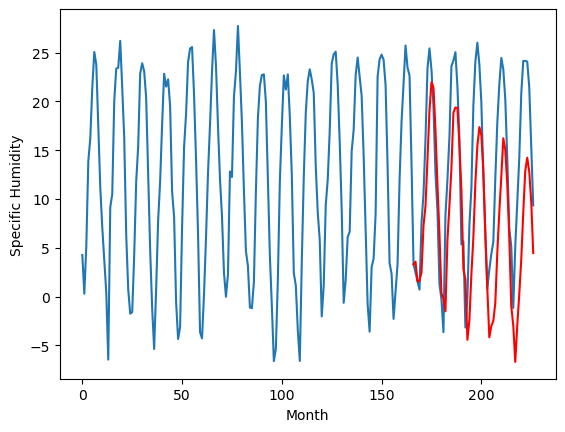

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.42		2.44		1.02
1.10		0.41		-0.69
-1.34		0.50		1.84
-1.59		1.35		2.94
6.01		6.14		0.13
9.12		8.14		-0.98
15.00		12.97		-2.03
22.73		17.93		-4.80
23.94		20.86		-3.08
21.34		20.27		-1.07
17.44		16.00		-1.44
10.10		10.30		0.20
7.46		5.29		-2.17
-0.42		-0.79		-0.37
-2.45		-1.36		1.09
-6.89		-2.64		4.25
6.97		4.67		-2.30
10.68		8.19		-2.49
15.46		12.05		-3.41
22.85		17.72		-5.13
22.56		18.25		-4.31
22.84		18.20		-4.64
19.73		14.35		-5.38
14.27		9.79		-4.48
3.96		1.69		-2.27
3.71		0.63		-3.08
-5.77		-5.56		0.21
-2.94		-3.57		-0.63
5.27		1.13		-4.14
9.39		4.94		-4.45
17.92		10.52		-7.40
22.53		14.31		-8.22
23.35		16.24		-7.11
22.05		15.44		-6.61
17.91		11.77		-6.14
10.44		5.10		-5.34
4.90		-0.37		-5.27
-1.83		-5.31		-3.48
0.41		-4.15		-4.56
1.60		-3.63		-5.23
4.14		-1.76		-5.90
11.47		3.42		-8.05
17.23		7.54		-9.69
21.54		11.19		-10.35
23.07		15.09		-7.98
21.81		13.92		-7.89
18.77		10.37		-8.40
12

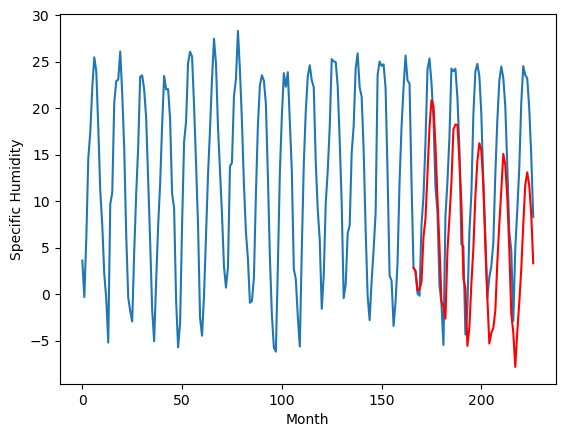

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.09		1.20		2.29
-1.87		-0.83		1.04
-3.07		-0.74		2.33
-3.88		0.11		3.99
2.28		4.90		2.62
3.66		6.90		3.24
10.40		11.73		1.33
16.89		16.69		-0.20
20.33		19.62		-0.71
17.92		19.03		1.11
13.93		14.76		0.83
7.77		9.06		1.29
4.54		4.05		-0.49
-3.02		-2.03		0.99
-4.94		-2.60		2.34
-7.18		-3.88		3.30
2.71		3.43		0.72
6.51		6.95		0.44
11.04		10.81		-0.23
17.93		16.48		-1.45
18.09		17.01		-1.08
19.29		16.96		-2.33
15.00		13.11		-1.89
11.47		8.55		-2.92
1.07		0.45		-0.62
0.21		-0.61		-0.82
-8.62		-6.80		1.82
-5.06		-4.81		0.25
0.91		-0.11		-1.02
4.91		3.70		-1.21
13.49		9.28		-4.21
16.76		13.07		-3.69
19.36		15.00		-4.36
18.29		14.20		-4.09
14.24		10.53		-3.71
7.38		3.86		-3.52
3.30		-1.61		-4.91
-3.41		-6.55		-3.14
-1.78		-5.39		-3.61
-1.64		-4.87		-3.23
-0.76		-3.00		-2.24
7.71		2.18		-5.53
11.40		6.30		-5.10
15.71		9.95		-5.76
18.80		13.85		-4.95
17.47		12.68		-4.79
15.13		9.13		-6.00
9.87		3.64	

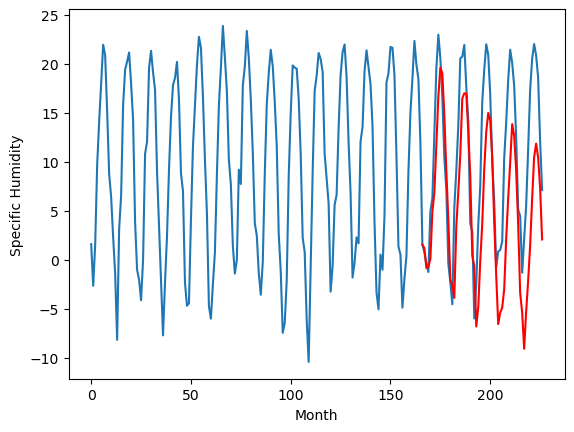

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[1.2029402923583987, -0.4770597076416019, -3.8570597076416018, -4.4970597076416015, -3.227059707641602, 7.262940292358399, 3.3729402923583987, 3.192940292358399, 3.572940292358398, 2.442940292358399, 1.2029402923583987]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84    1.20294
1                 1    0.37   -0.47706
2                 2   -4.37   -3.85706
3                 3   -3.64   -4.49706
4                 4   -2.77   -3.22706
5                 5    8.81    7.26294
6                 6    1.79    3.37294
7                 7    4.00    3.19294
8                 8    1.41    3.57294
9                 9    1.42    2.44294
10               10   -1.09    1.20294


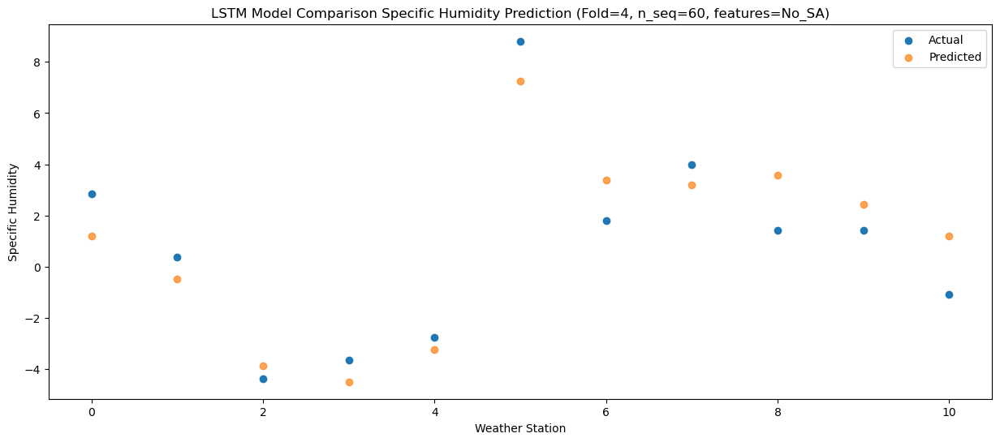

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.827882
1                 1    0.19  -2.507881
2                 2   -4.31  -5.887881
3                 3   -5.29  -6.527882
4                 4   -4.55  -5.257882
5                 5    7.17   5.232118
6                 6    1.44   1.342119
7                 7    3.19   1.162118
8                 8    0.59   1.542118
9                 9    1.10   0.412118
10               10   -1.87  -0.827882


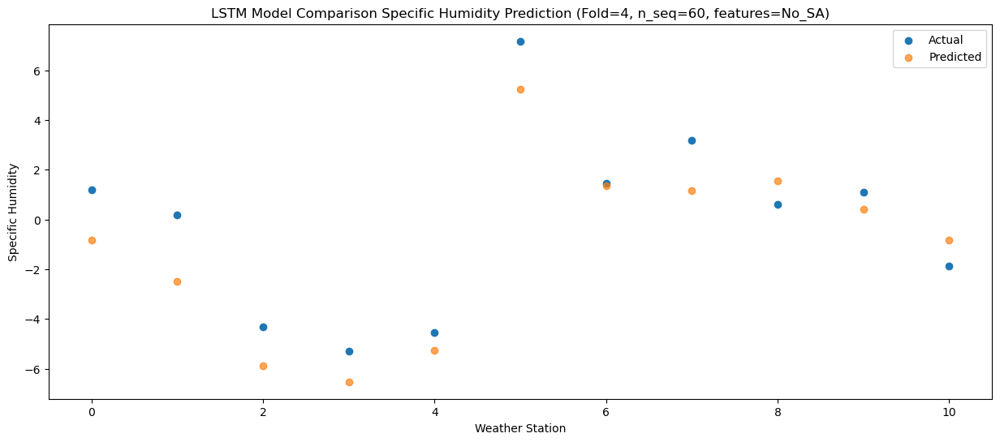

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -0.740690
1                 1   -1.27  -2.420689
2                 2   -4.50  -5.800689
3                 3   -5.05  -6.440690
4                 4   -3.93  -5.170690
5                 5    6.44   5.319310
6                 6    1.27   1.429311
7                 7    1.54   1.249310
8                 8   -0.34   1.629310
9                 9   -1.34   0.499310
10               10   -3.07  -0.740690


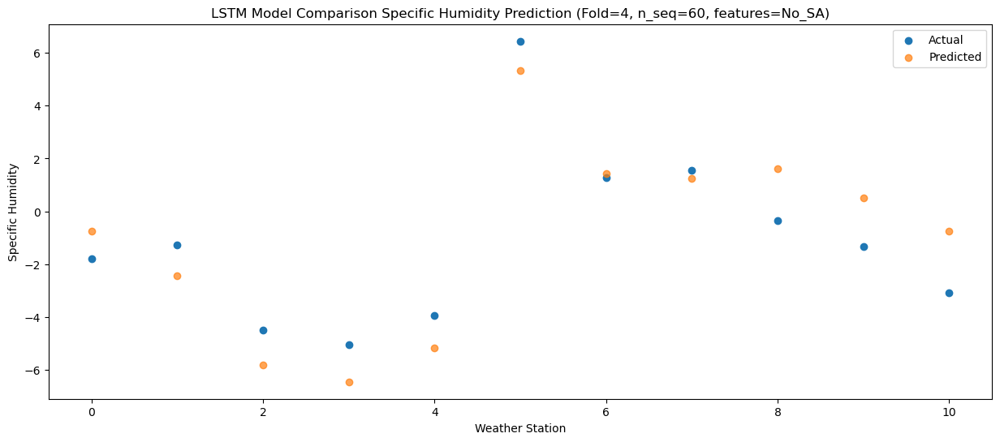

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67   0.113163
1                 1    0.28  -1.566836
2                 2   -4.24  -4.946836
3                 3   -5.38  -5.586837
4                 4   -4.31  -4.316837
5                 5    5.68   6.173163
6                 6    1.74   2.283164
7                 7    2.11   2.103163
8                 8   -1.17   2.483163
9                 9   -1.59   1.353163
10               10   -3.88   0.113163


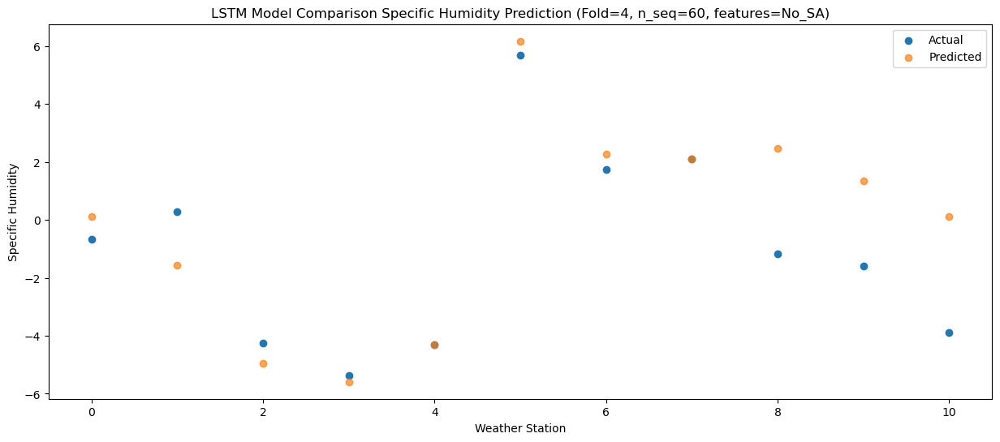

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   4.897432
1                 1    4.35   3.217433
2                 2    3.56  -0.162567
3                 3    2.08  -0.802568
4                 4    3.57   0.467432
5                 5   13.24  10.957432
6                 6    7.35   7.067433
7                 7    9.04   6.887432
8                 8    5.65   7.267432
9                 9    6.01   6.137432
10               10    2.28   4.897432


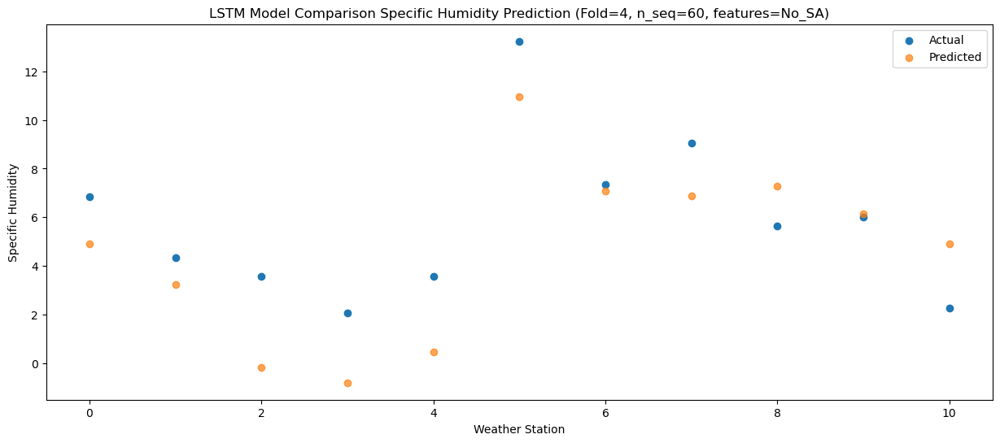

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   6.896165
1                 1    6.03   5.216166
2                 2    2.61   1.836166
3                 3    2.74   1.196165
4                 4    4.26   2.466165
5                 5   16.21  12.956165
6                 6    8.62   9.066166
7                 7   10.62   8.886165
8                 8    8.64   9.266165
9                 9    9.12   8.136165
10               10    3.66   6.896165


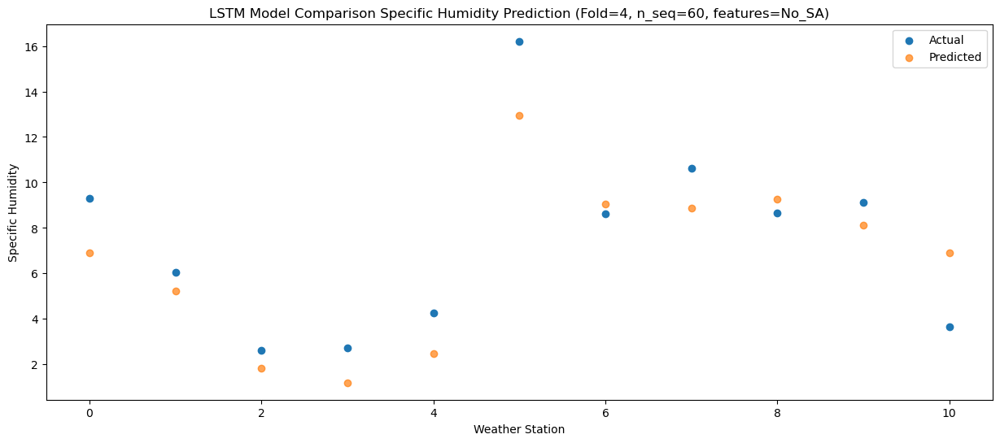

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  11.734558
1                 1    7.43  10.054559
2                 2    6.49   6.674559
3                 3    7.87   6.034558
4                 4    9.91   7.304558
5                 5   22.78  17.794558
6                 6   11.41  13.904559
7                 7   14.72  13.724558
8                 8   14.22  14.104558
9                 9   15.00  12.974558
10               10   10.40  11.734558


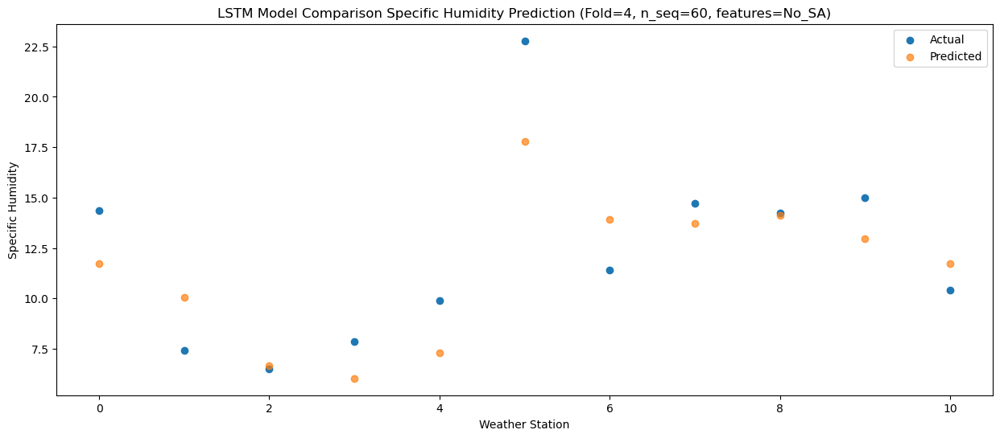

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  16.691644
1                 1    9.19  15.011644
2                 2   10.58  11.631644
3                 3   12.83  10.991644
4                 4   14.62  12.261644
5                 5   26.11  22.751644
6                 6   16.00  18.861644
7                 7   21.07  18.681644
8                 8   21.51  19.061644
9                 9   22.73  17.931644
10               10   16.89  16.691644


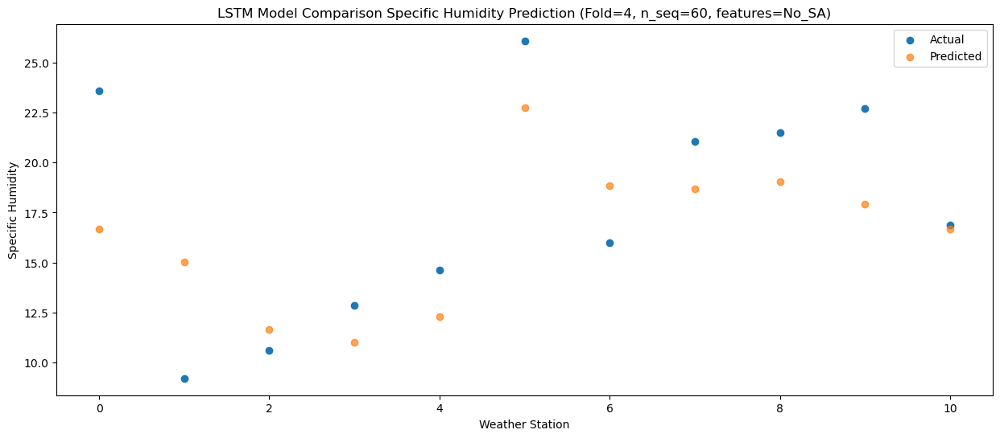

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  19.617353
1                 1    9.51  17.937354
2                 2   12.15  14.557354
3                 3   14.69  13.917353
4                 4   17.06  15.187353
5                 5   28.94  25.677353
6                 6   19.04  21.787354
7                 7   23.61  21.607353
8                 8   23.55  21.987353
9                 9   23.94  20.857353
10               10   20.33  19.617353


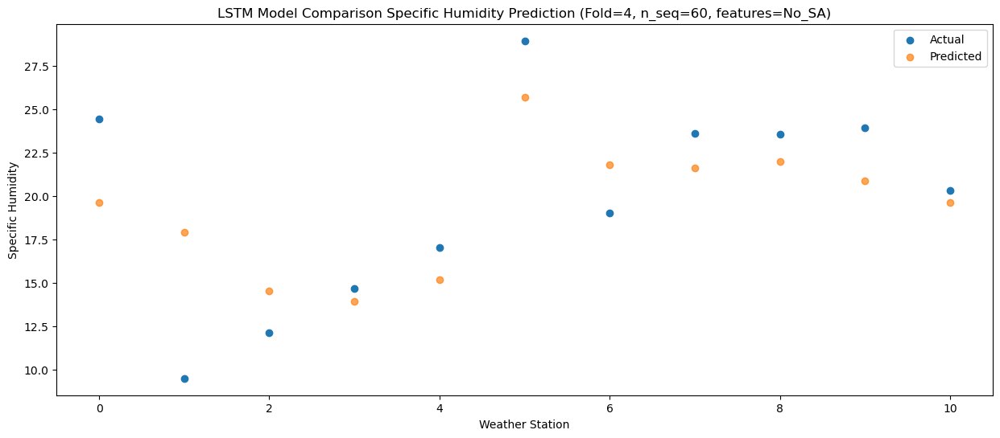

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  19.030155
1                 1    9.36  17.350156
2                 2   11.32  13.970156
3                 3   14.44  13.330155
4                 4   16.38  14.600155
5                 5   28.32  25.090155
6                 6   17.84  21.200156
7                 7   21.62  21.020155
8                 8   21.35  21.400155
9                 9   21.34  20.270155
10               10   17.92  19.030155


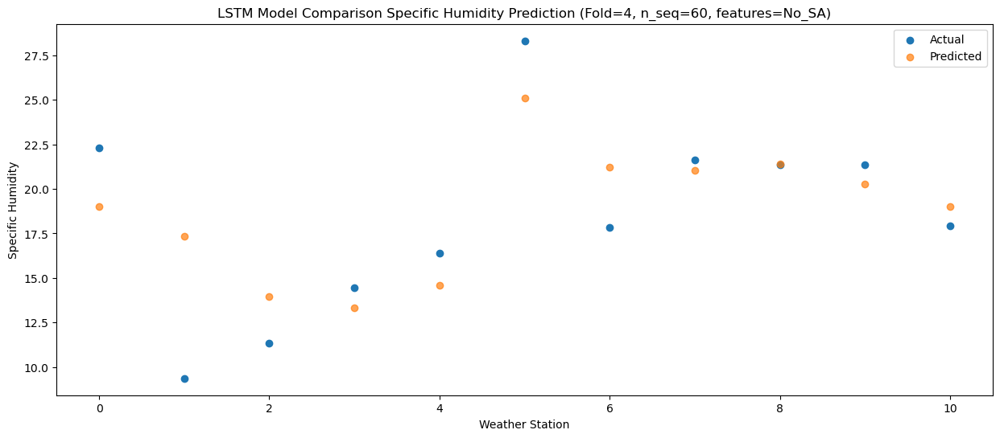

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  14.763522
1                 1    8.78  13.083523
2                 2    9.22   9.703523
3                 3    8.66   9.063522
4                 4   10.08  10.333522
5                 5   20.59  20.823522
6                 6   14.04  16.933523
7                 7   18.04  16.753522
8                 8   17.59  17.133522
9                 9   17.44  16.003522
10               10   13.93  14.763522


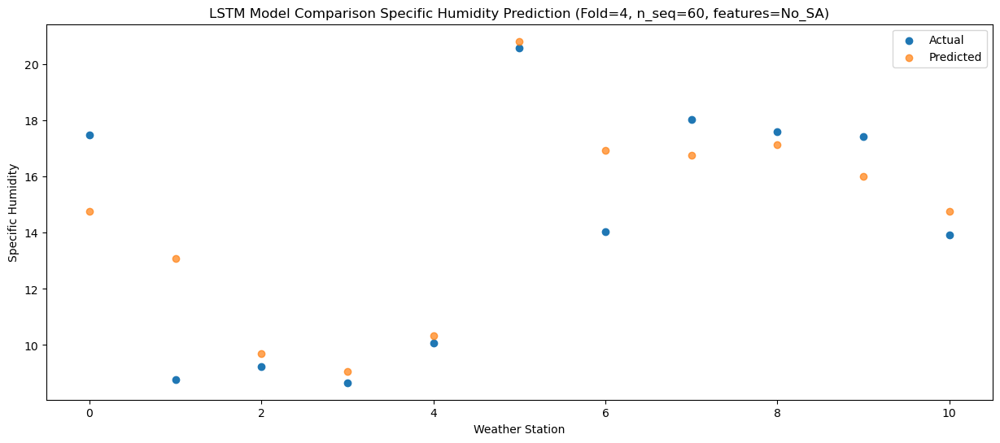

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   9.057967
1                 1    7.28   7.377967
2                 2    3.88   3.997967
3                 3    2.93   3.357967
4                 4    4.33   4.627967
5                 5   16.63  15.117967
6                 6   10.22  11.227967
7                 7   11.11  11.047967
8                 8   10.75  11.427967
9                 9   10.10  10.297967
10               10    7.77   9.057967


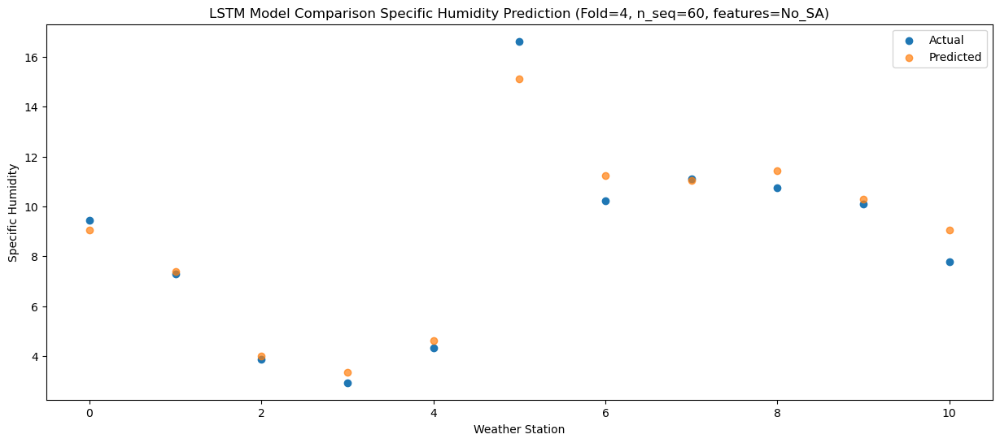

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   4.054248
1                 1    3.89   2.374249
2                 2   -0.12  -1.005751
3                 3    0.32  -1.645752
4                 4    1.57  -0.375752
5                 5   12.75  10.114248
6                 6    5.91   6.224249
7                 7    8.56   6.044248
8                 8    6.91   6.424248
9                 9    7.46   5.294248
10               10    4.54   4.054248


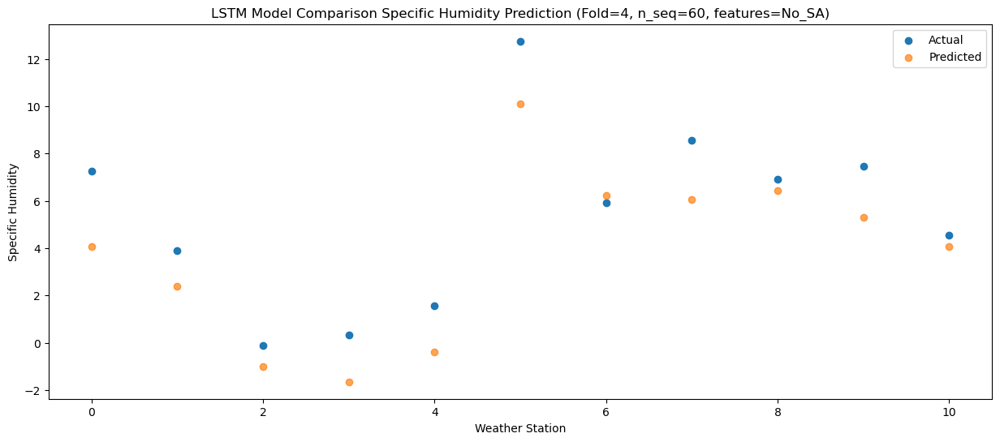

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -2.033320
1                 1   -3.86  -3.713319
2                 2   -6.37  -7.093319
3                 3   -5.96  -7.733320
4                 4   -5.00  -6.463320
5                 5    5.77   4.026680
6                 6   -1.34   0.136681
7                 7    2.03  -0.043320
8                 8   -0.60   0.336680
9                 9   -0.42  -0.793320
10               10   -3.02  -2.033320


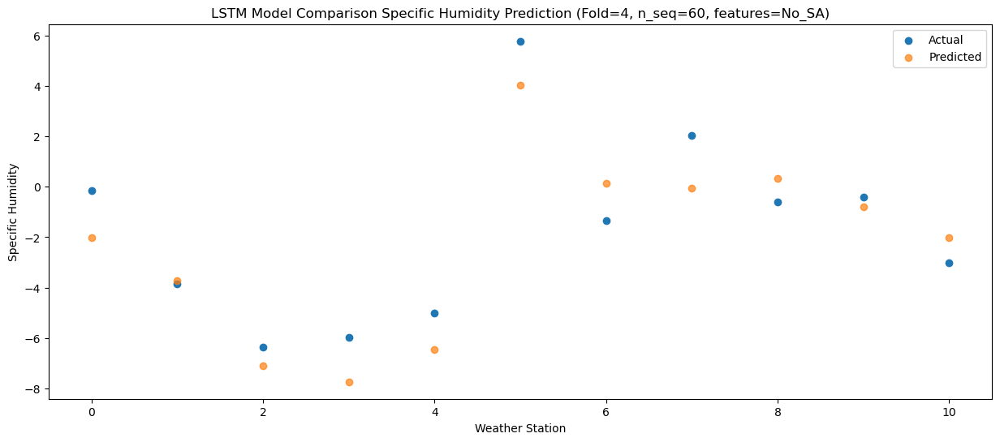

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -2.597807
1                 1   -3.16  -4.277806
2                 2   -6.34  -7.657806
3                 3   -6.88  -8.297807
4                 4   -5.60  -7.027807
5                 5    4.67   3.462193
6                 6   -1.11  -0.427806
7                 7    0.36  -0.607807
8                 8   -2.18  -0.227807
9                 9   -2.45  -1.357807
10               10   -4.94  -2.597807


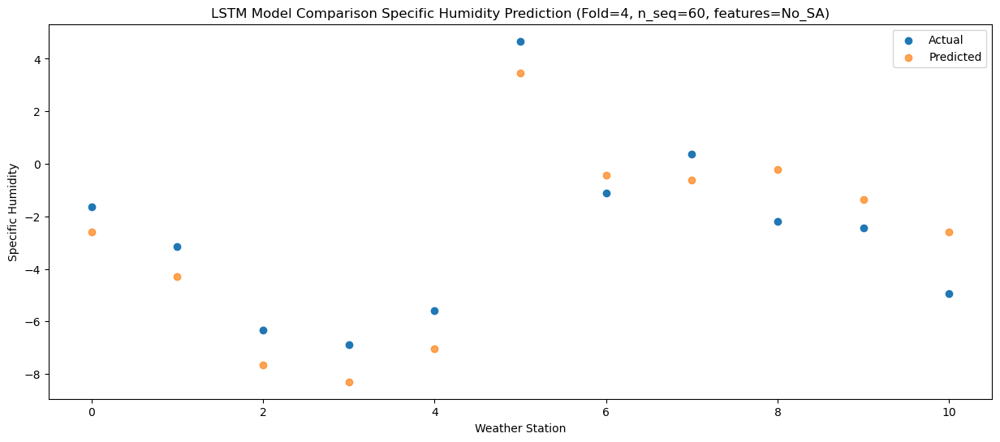

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -3.875870
1                 1    0.27  -5.555868
2                 2   -8.26  -8.935868
3                 3  -10.34  -9.575870
4                 4   -9.49  -8.305870
5                 5    3.10   2.184130
6                 6   -0.44  -1.705868
7                 7   -3.25  -1.885870
8                 8   -5.54  -1.505870
9                 9   -6.89  -2.635870
10               10   -7.18  -3.875870


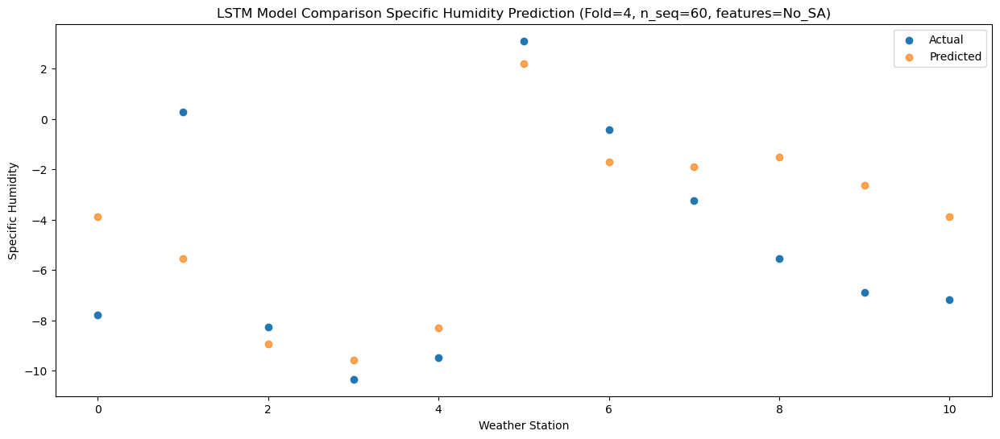

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   3.434599
1                 1    1.87   1.754601
2                 2    1.07  -1.625399
3                 3    0.62  -2.265401
4                 4    1.43  -0.995401
5                 5   12.35   9.494599
6                 6    5.96   5.604601
7                 7    9.02   5.424599
8                 8    6.43   5.804599
9                 9    6.97   4.674599
10               10    2.71   3.434599


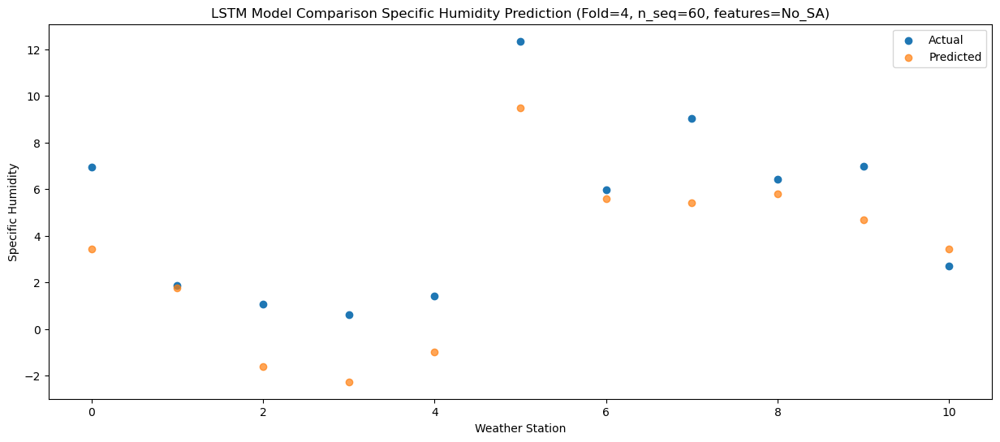

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   6.946415
1                 1    3.31   5.266417
2                 2    2.14   1.886417
3                 3    2.31   1.246415
4                 4    3.61   2.516415
5                 5   14.58  13.006415
6                 6    8.69   9.116417
7                 7   10.92   8.936415
8                 8   10.08   9.316415
9                 9   10.68   8.186415
10               10    6.51   6.946415


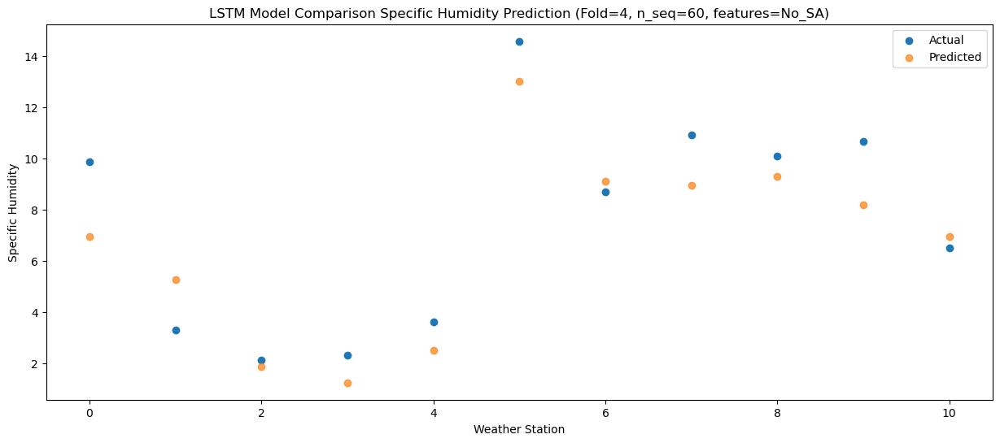

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  10.811633
1                 1    7.35   9.131635
2                 2    6.61   5.751635
3                 3    6.47   5.111633
4                 4    7.14   6.381633
5                 5   20.07  16.871633
6                 6   12.14  12.981635
7                 7   14.96  12.801633
8                 8   14.49  13.181633
9                 9   15.46  12.051633
10               10   11.04  10.811633


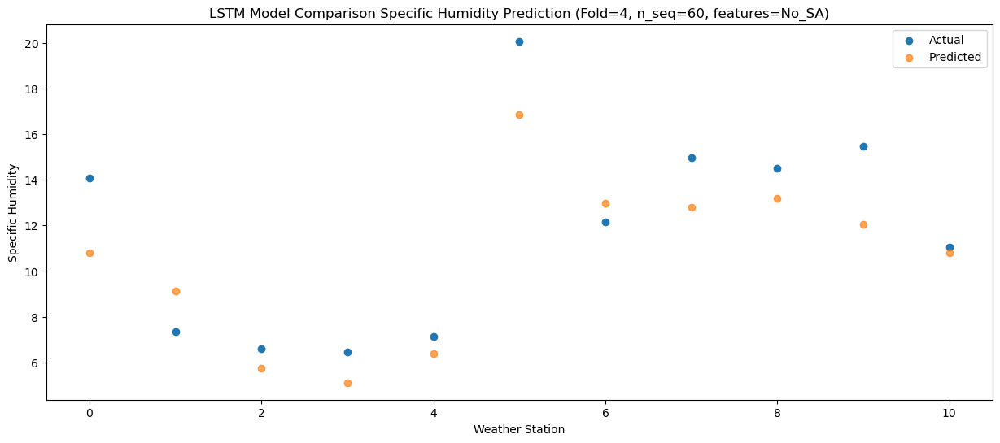

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  16.482414
1                 1    8.98  14.802416
2                 2   10.87  11.422416
3                 3   12.15  10.782414
4                 4   13.99  12.052414
5                 5   25.03  22.542414
6                 6   16.16  18.652416
7                 7   21.26  18.472414
8                 8   21.73  18.852414
9                 9   22.85  17.722414
10               10   17.93  16.482414


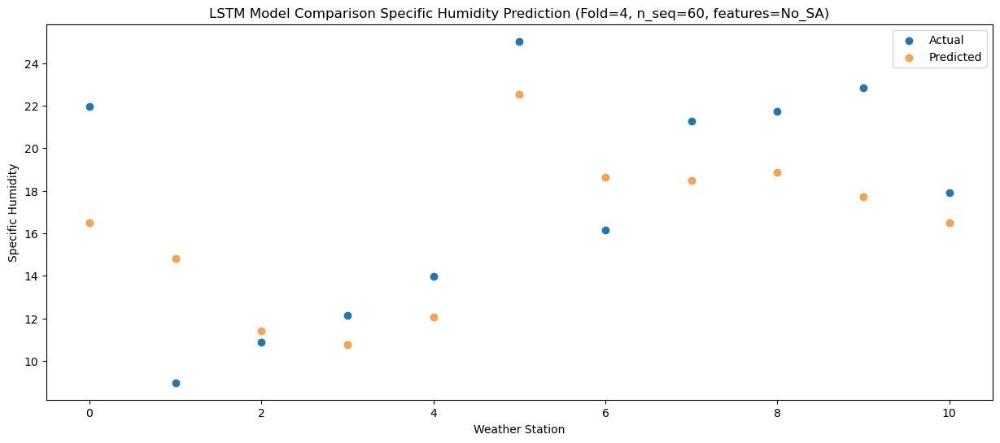

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  17.012094
1                 1    9.35  15.332096
2                 2   11.53  11.952096
3                 3   13.74  11.312094
4                 4   15.48  12.582094
5                 5   24.77  23.072094
6                 6   17.90  19.182096
7                 7   22.55  19.002094
8                 8   22.30  19.382094
9                 9   22.56  18.252094
10               10   18.09  17.012094


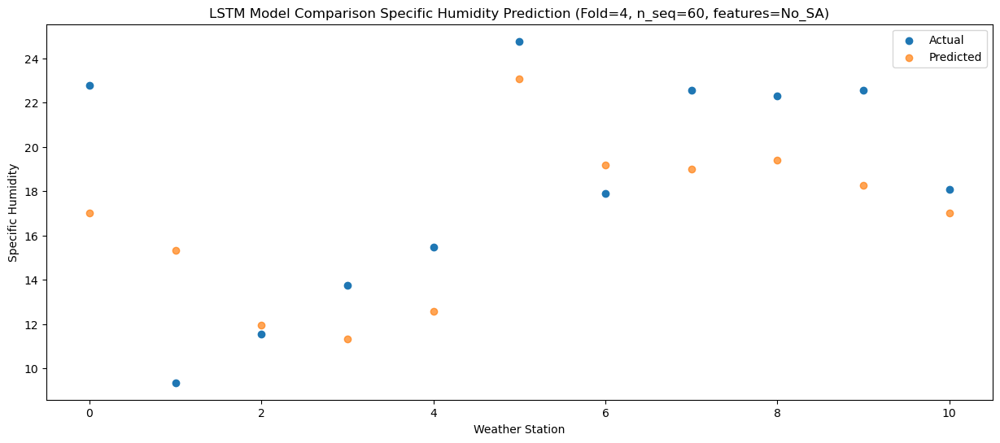

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  16.963381
1                 1    9.63  15.283383
2                 2   12.18  11.903383
3                 3   14.11  11.263381
4                 4   15.85  12.533381
5                 5   25.09  23.023381
6                 6   18.03  19.133383
7                 7   23.07  18.953381
8                 8   23.16  19.333381
9                 9   22.84  18.203381
10               10   19.29  16.963381


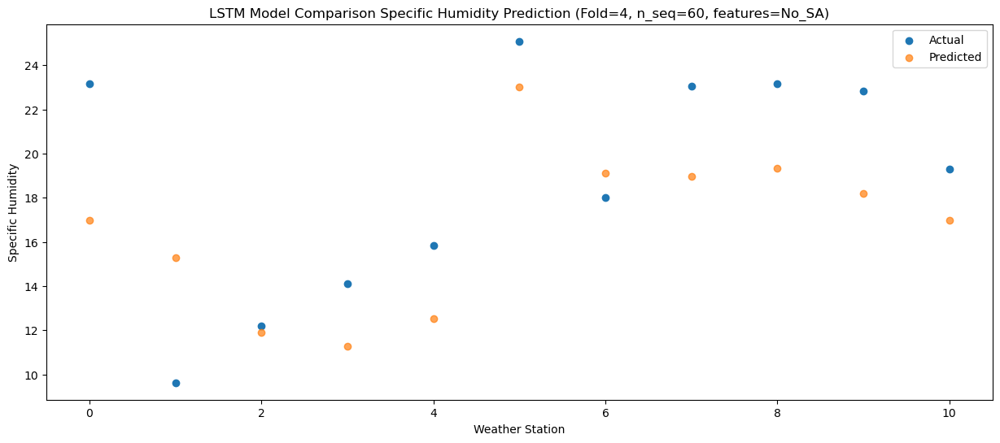

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  13.108751
1                 1    8.34  11.428753
2                 2    9.06   8.048753
3                 3   11.32   7.408751
4                 4   12.42   8.678751
5                 5   24.40  19.168751
6                 6   14.06  15.278753
7                 7   20.03  15.098751
8                 8   19.67  15.478751
9                 9   19.73  14.348751
10               10   15.00  13.108751


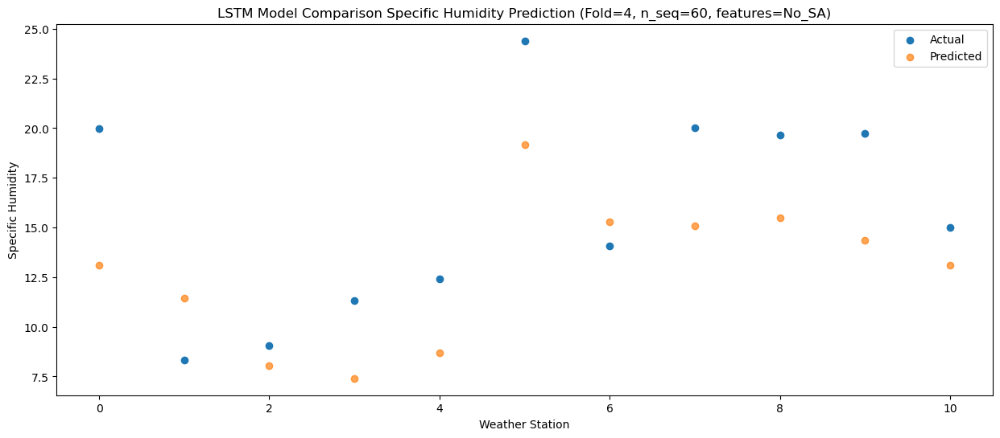

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86   8.553146
1                 1    6.50   6.873148
2                 2    5.67   3.493148
3                 3    6.67   2.853146
4                 4    7.55   4.123146
5                 5   18.70  14.613146
6                 6   10.26  10.723148
7                 7   14.26  10.543146
8                 8   14.32  10.923146
9                 9   14.27   9.793146
10               10   11.47   8.553146


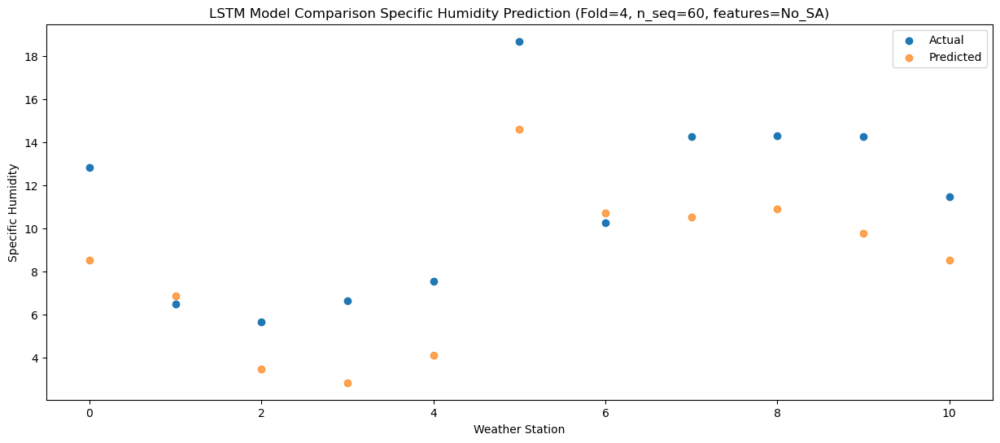

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   0.445396
1                 1   -0.66  -1.234602
2                 2   -3.00  -4.614602
3                 3   -1.33  -5.254604
4                 4   -0.29  -3.984604
5                 5   11.76   6.505396
6                 6    2.10   2.615398
7                 7    6.32   2.435396
8                 8    3.46   2.815396
9                 9    3.96   1.685396
10               10    1.07   0.445396


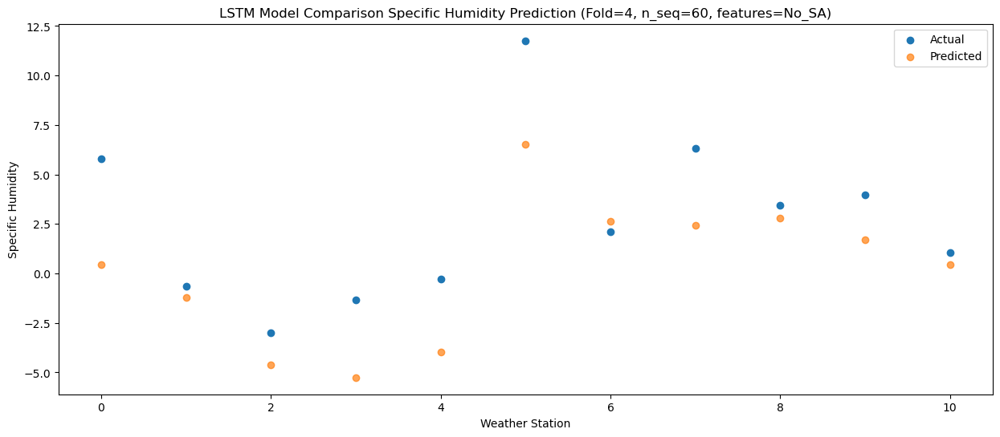

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01  -0.612233
1                 1    1.14  -2.292231
2                 2    0.51  -5.672231
3                 3    0.67  -6.312233
4                 4    1.45  -5.042233
5                 5   12.17   5.447767
6                 6    4.01   1.557769
7                 7    7.78   1.377767
8                 8    3.78   1.757767
9                 9    3.71   0.627767
10               10    0.21  -0.612233


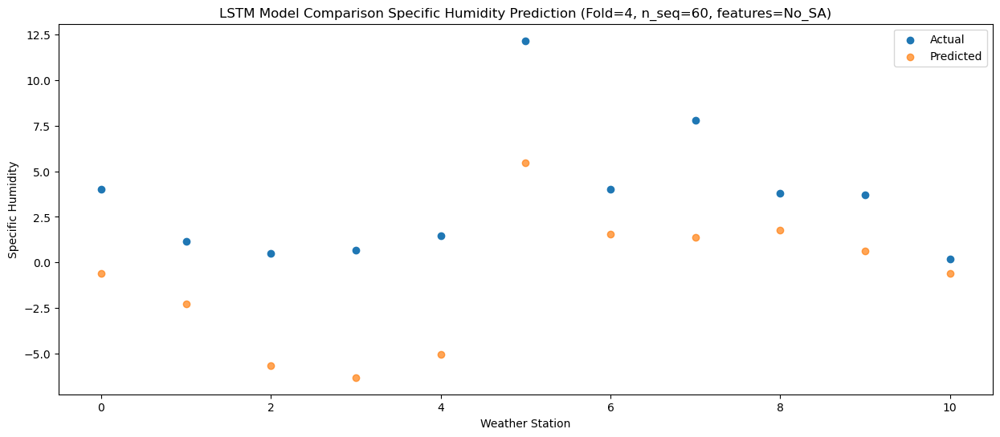

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -6.798240
1                 1   -3.62  -8.478238
2                 2   -7.77 -11.858238
3                 3   -7.80 -12.498240
4                 4   -7.45 -11.228240
5                 5    4.80  -0.738240
6                 6   -2.05  -4.628238
7                 7   -1.29  -4.808240
8                 8   -5.06  -4.428240
9                 9   -5.77  -5.558240
10               10   -8.62  -6.798240


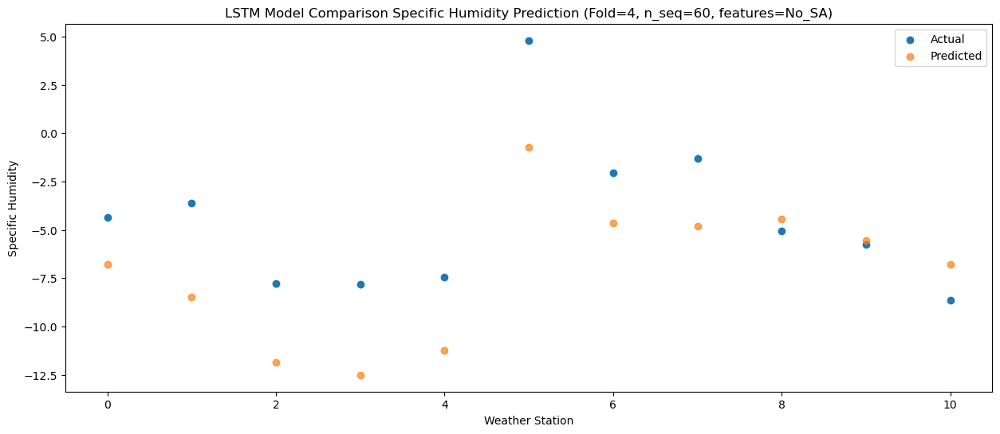

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -4.811389
1                 1   -0.19  -6.491387
2                 2   -5.41  -9.871387
3                 3   -7.54 -10.511389
4                 4   -6.83  -9.241389
5                 5    4.60   1.248611
6                 6    2.23  -2.641387
7                 7    0.77  -2.821389
8                 8   -2.04  -2.441389
9                 9   -2.94  -3.571389
10               10   -5.06  -4.811389


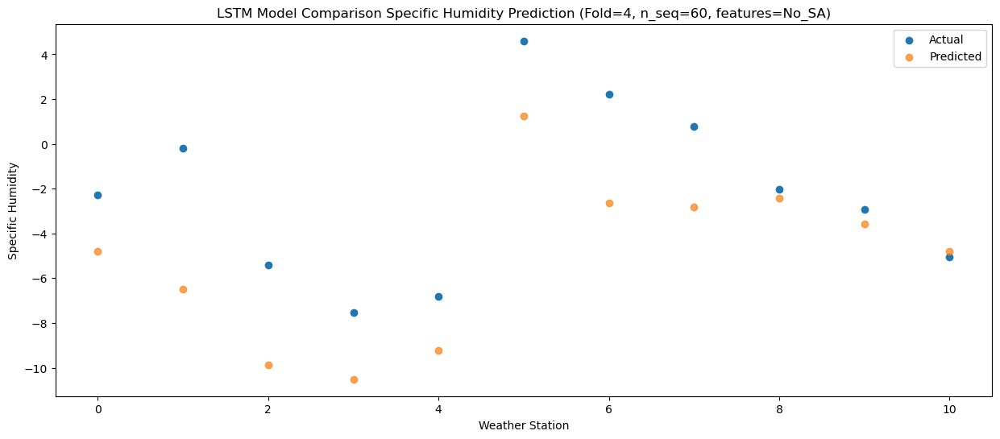

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41  -0.107288
1                 1    2.63  -1.787286
2                 2   -0.67  -5.167286
3                 3   -1.36  -5.807288
4                 4    0.09  -4.537288
5                 5   11.92   5.952712
6                 6    5.79   2.062714
7                 7    7.43   1.882712
8                 8    5.43   2.262712
9                 9    5.27   1.132712
10               10    0.91  -0.107288


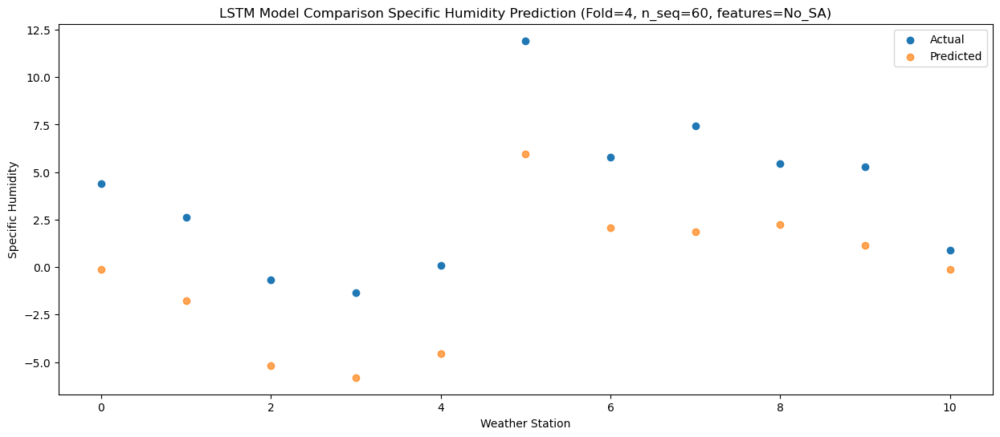

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   3.704100
1                 1    4.97   2.024102
2                 2    3.54  -1.355898
3                 3    4.69  -1.995900
4                 4    6.78  -0.725900
5                 5   19.43   9.764100
6                 6    8.45   5.874102
7                 7   11.29   5.694100
8                 8    9.21   6.074100
9                 9    9.39   4.944100
10               10    4.91   3.704100


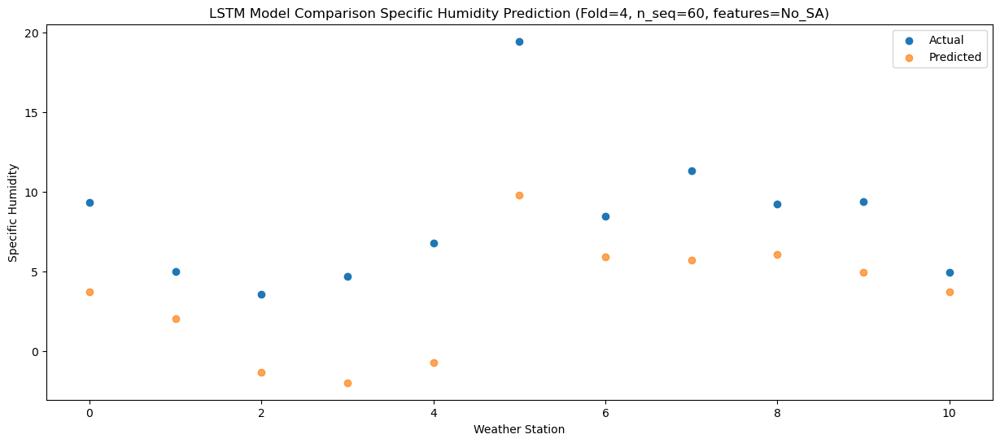

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23   9.283522
1                 1    7.79   7.603524
2                 2    9.34   4.223524
3                 3    9.40   3.583522
4                 4   11.61   4.853522
5                 5   25.12  15.343522
6                 6   14.43  11.453524
7                 7   16.96  11.273522
8                 8   17.71  11.653522
9                 9   17.92  10.523522
10               10   13.49   9.283522


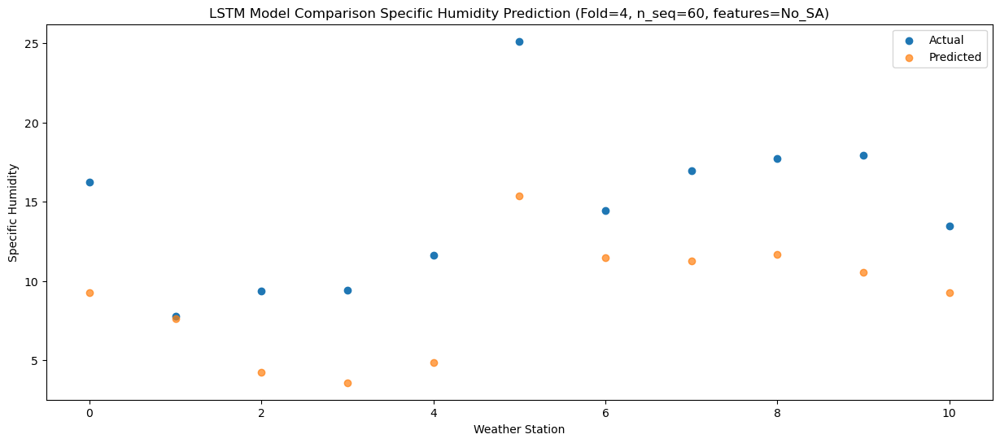

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  13.074683
1                 1    9.51  11.394685
2                 2   12.63   8.014685
3                 3   13.95   7.374683
4                 4   16.28   8.644683
5                 5   27.49  19.134683
6                 6   17.64  15.244685
7                 7   22.28  15.064683
8                 8   22.19  15.444683
9                 9   22.53  14.314683
10               10   16.76  13.074683


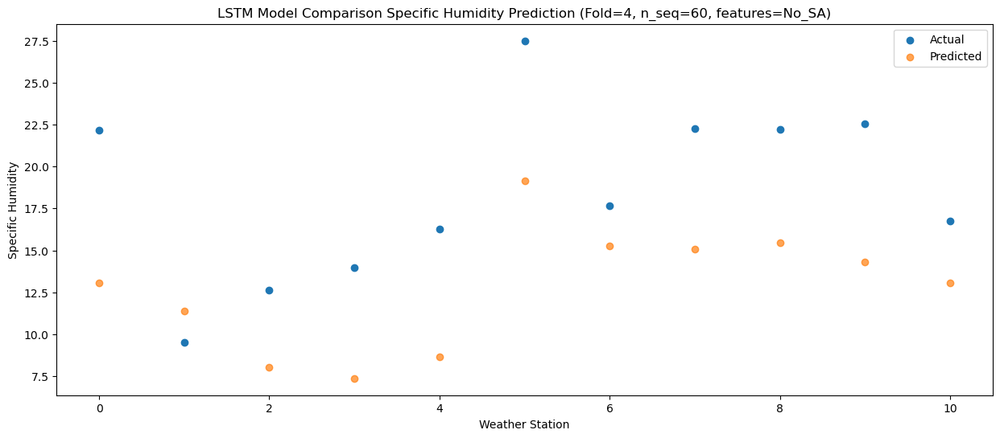

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  15.002137
1                 1    9.88  13.322139
2                 2   12.83   9.942139
3                 3   17.25   9.302137
4                 4   19.70  10.572137
5                 5   29.39  21.062137
6                 6   18.91  17.172139
7                 7   25.98  16.992137
8                 8   24.13  17.372137
9                 9   23.35  16.242137
10               10   19.36  15.002137


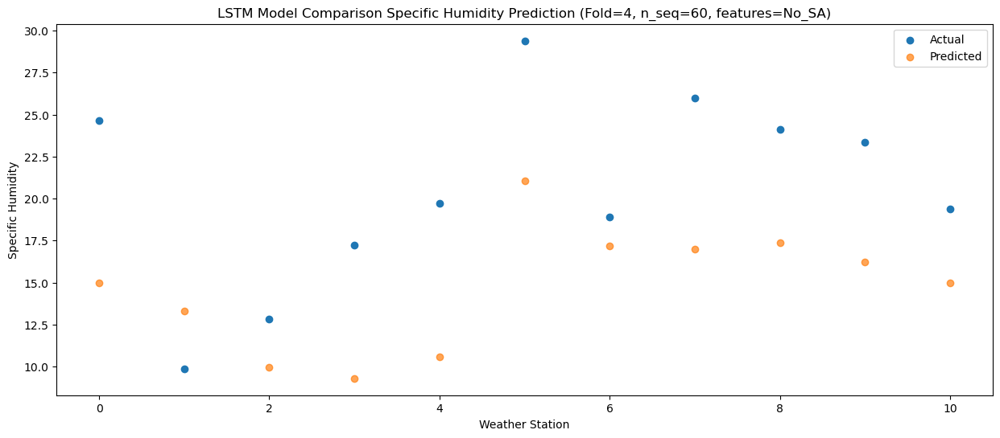

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  14.199789
1                 1    9.83  12.519791
2                 2   11.29   9.139791
3                 3   14.52   8.499789
4                 4   16.86   9.769789
5                 5   26.09  20.259789
6                 6   17.39  16.369791
7                 7   22.46  16.189789
8                 8   21.90  16.569789
9                 9   22.05  15.439789
10               10   18.29  14.199789


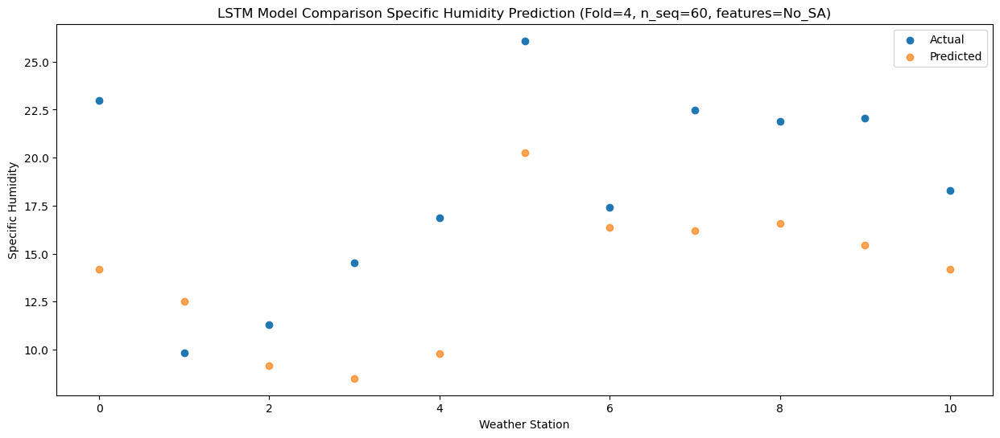

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  10.525797
1                 1    8.39   8.845799
2                 2    9.22   5.465799
3                 3   11.09   4.825797
4                 4   12.77   6.095797
5                 5   23.19  16.585797
6                 6   14.30  12.695799
7                 7   18.87  12.515797
8                 8   17.99  12.895797
9                 9   17.91  11.765797
10               10   14.24  10.525797


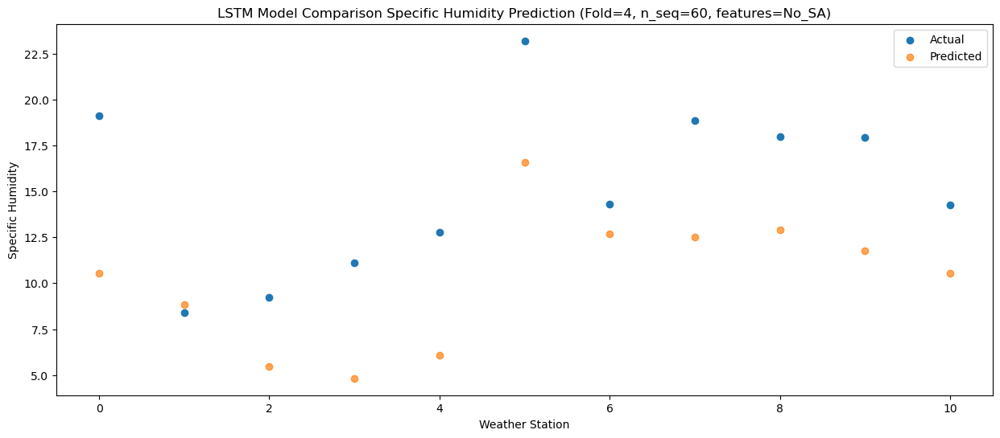

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   3.858942
1                 1    4.56   2.178944
2                 2    3.09  -1.201056
3                 3    4.22  -1.841058
4                 4    5.62  -0.571057
5                 5   16.38   9.918943
6                 6    7.43   6.028944
7                 7   12.50   5.848943
8                 8   10.50   6.228942
9                 9   10.44   5.098942
10               10    7.38   3.858942


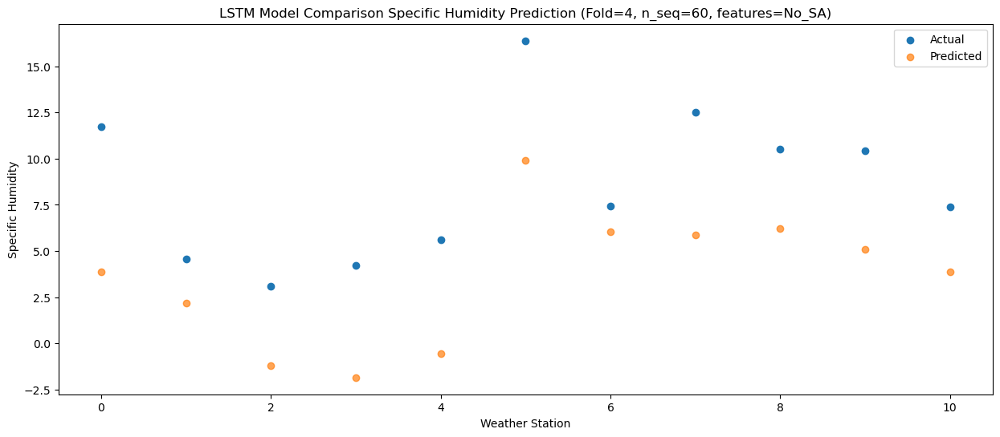

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41  -1.609434
1                 1    3.10  -3.289432
2                 2   -1.50  -6.669432
3                 3   -2.83  -7.309434
4                 4   -1.47  -6.039433
5                 5    8.53   4.450567
6                 6    4.73   0.560568
7                 7    5.95   0.380567
8                 8    4.71   0.760566
9                 9    4.90  -0.369434
10               10    3.30  -1.609434


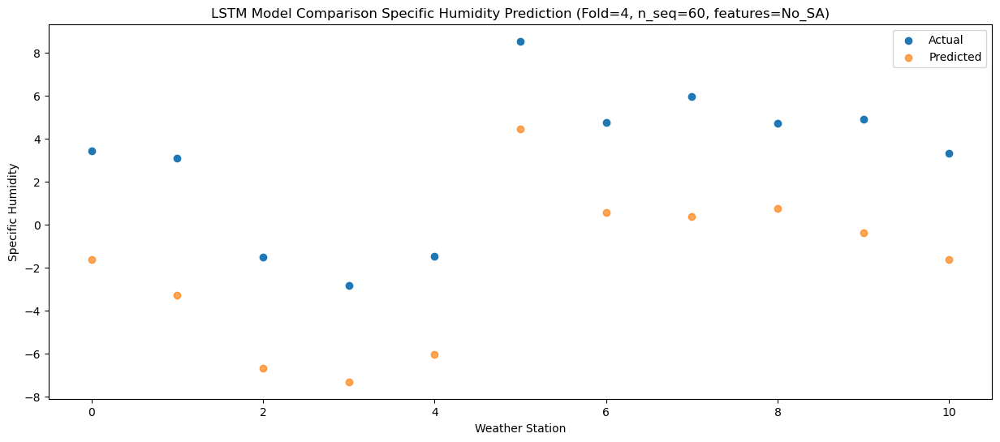

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -6.546367
1                 1   -1.75  -8.226365
2                 2   -3.93 -11.606365
3                 3   -5.52 -12.246367
4                 4   -4.44 -10.976366
5                 5    6.93  -0.486366
6                 6   -1.22  -4.376365
7                 7    1.10  -4.556366
8                 8   -1.07  -4.176367
9                 9   -1.83  -5.306367
10               10   -3.41  -6.546367


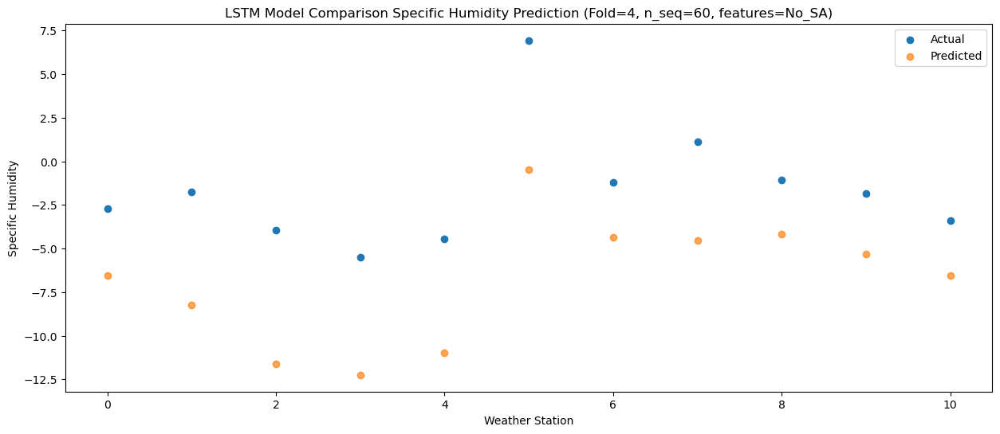

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77  -5.387026
1                 1   -1.90  -7.067026
2                 2   -3.52 -10.447026
3                 3   -4.53 -11.087028
4                 4   -3.67  -9.817027
5                 5    7.30   0.672973
6                 6    1.80  -3.217026
7                 7    2.75  -3.397027
8                 8    0.89  -3.017026
9                 9    0.41  -4.147026
10               10   -1.78  -5.387028


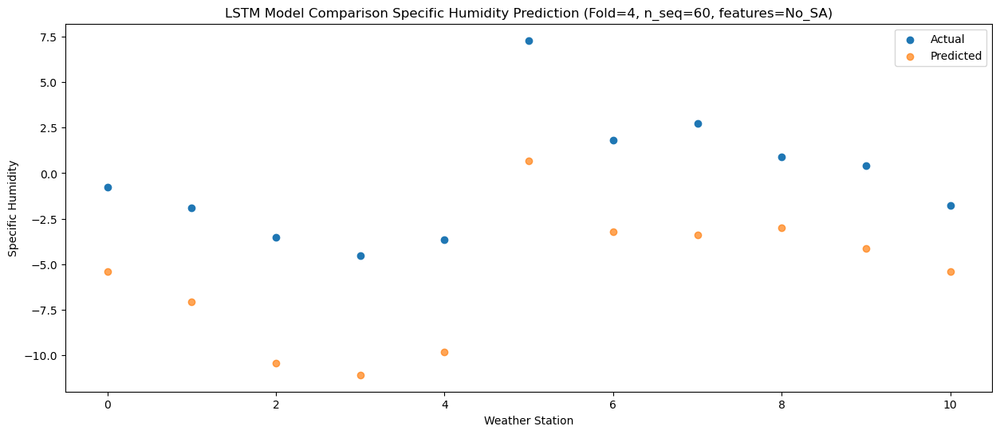

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98  -4.869774
1                 1    1.40  -6.549774
2                 2   -1.58  -9.929774
3                 3   -4.47 -10.569776
4                 4   -3.44  -9.299775
5                 5    7.47   1.190225
6                 6    5.22  -2.699774
7                 7    4.89  -2.879775
8                 8    2.48  -2.499774
9                 9    1.60  -3.629774
10               10   -1.64  -4.869776


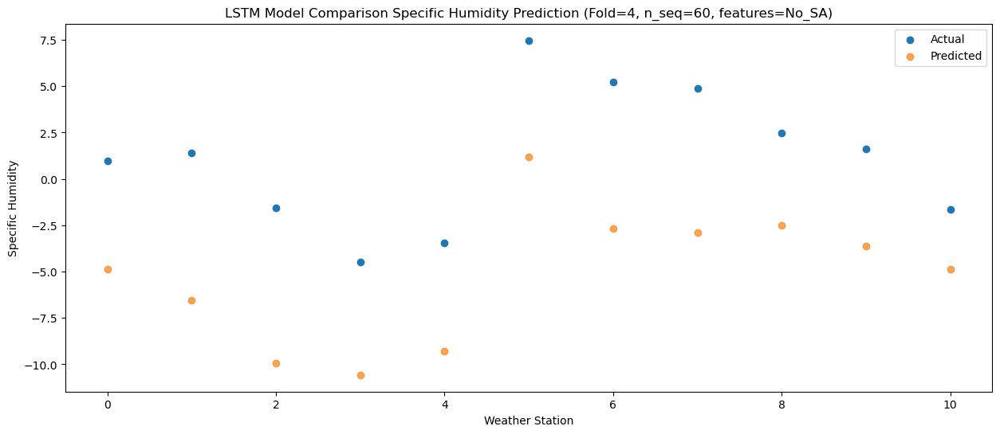

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16  -2.999839
1                 1    3.12  -4.679839
2                 2    0.57  -8.059839
3                 3    0.06  -8.699841
4                 4    1.41  -7.429840
5                 5   12.54   3.060160
6                 6    5.70  -0.829839
7                 7    6.61  -1.009840
8                 8    3.75  -0.629839
9                 9    4.14  -1.759839
10               10   -0.76  -2.999841


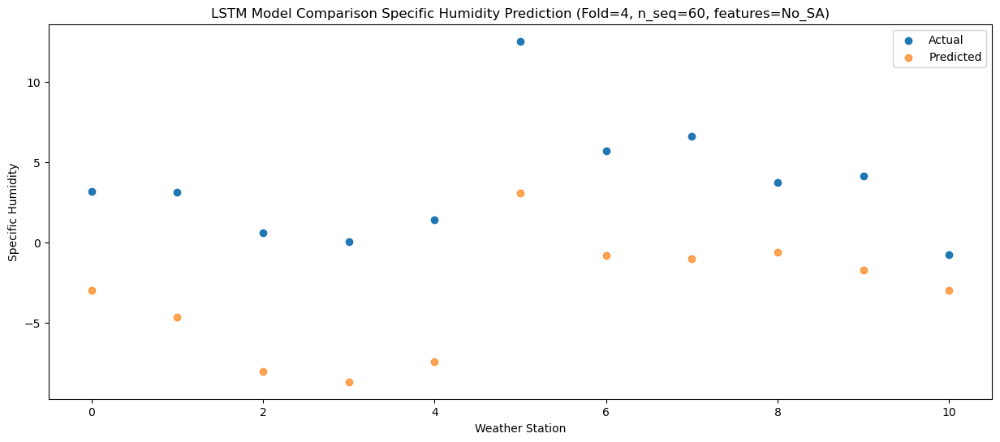

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   2.178080
1                 1    5.84   0.498080
2                 2    2.32  -2.881920
3                 3    2.66  -3.521922
4                 4    4.06  -2.251921
5                 5   16.76   8.238079
6                 6    8.81   4.348080
7                 7   12.23   4.168079
8                 8   10.25   4.548080
9                 9   11.47   3.418080
10               10    7.71   2.178078


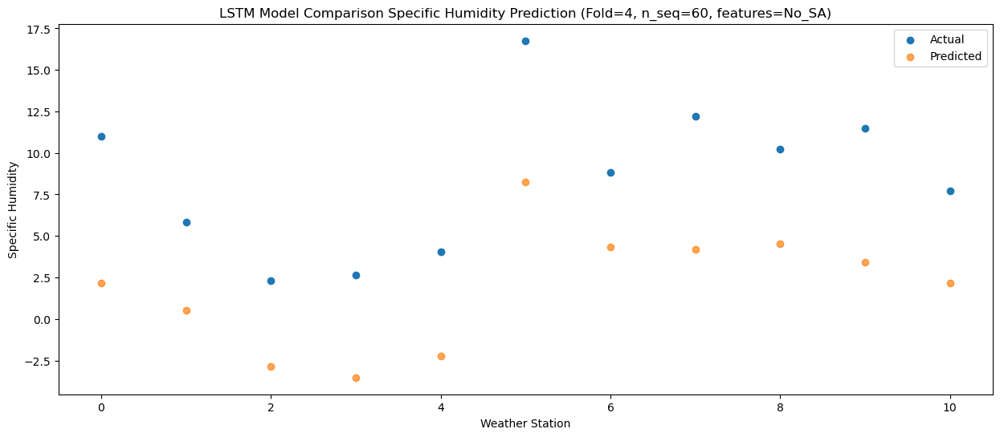

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80   6.298909
1                 1    6.62   4.618910
2                 2    7.18   1.238910
3                 3    8.34   0.598908
4                 4   10.22   1.868909
5                 5   21.68  12.358909
6                 6   11.43   8.468910
7                 7   17.01   8.288909
8                 8   15.96   8.668909
9                 9   17.23   7.538909
10               10   11.40   6.298908


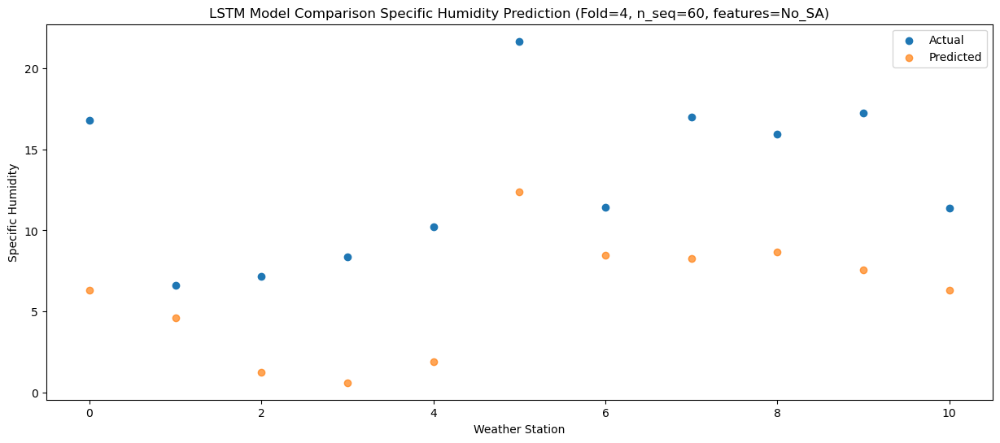

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71   9.949939
1                 1    8.83   8.269939
2                 2   10.77   4.889939
3                 3   12.53   4.249937
4                 4   15.33   5.519938
5                 5   28.16  16.009938
6                 6   15.07  12.119939
7                 7   21.09  11.939938
8                 8   19.84  12.319939
9                 9   21.54  11.189939
10               10   15.71   9.949937


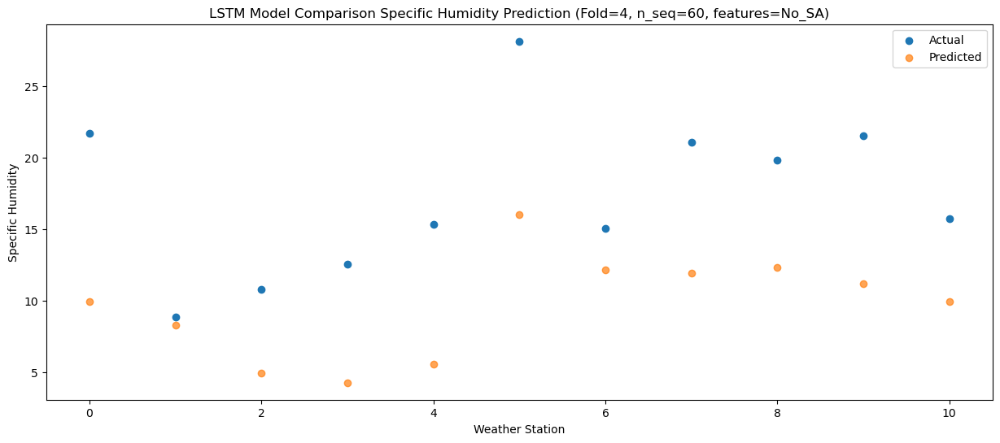

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  13.854261
1                 1   10.44  12.174261
2                 2   12.55   8.794261
3                 3   15.08   8.154259
4                 4   18.41   9.424260
5                 5   29.62  19.914260
6                 6   18.94  16.024261
7                 7   23.05  15.844258
8                 8   22.57  16.224261
9                 9   23.07  15.094261
10               10   18.80  13.854257


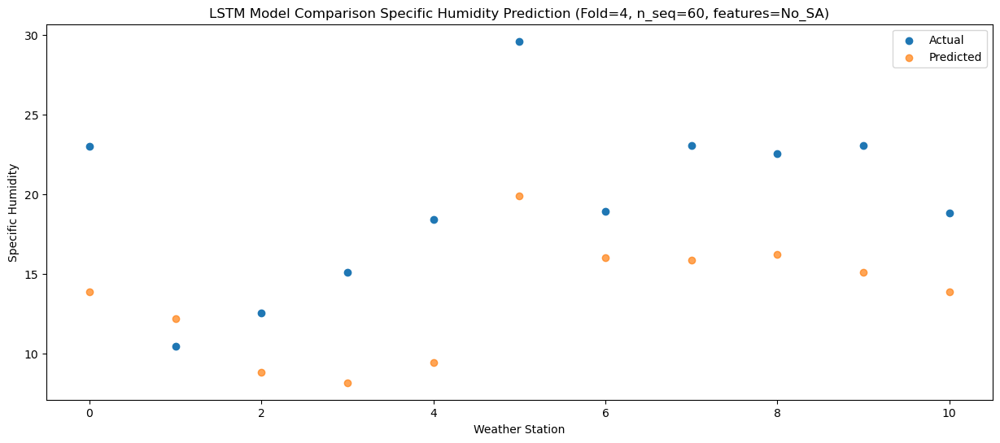

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  12.675434
1                 1   10.95  10.995434
2                 2   14.63   7.615434
3                 3   17.63   6.975432
4                 4   20.28   8.245433
5                 5   29.71  18.735433
6                 6   18.38  14.845434
7                 7   22.86  14.665431
8                 8   21.41  15.045434
9                 9   21.81  13.915434
10               10   17.47  12.675430


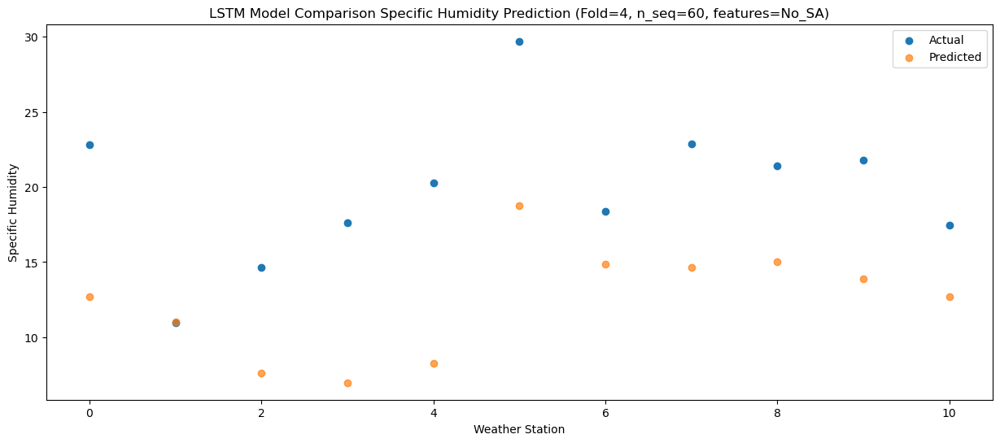

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99   9.131080
1                 1    8.85   7.451080
2                 2   10.88   4.071081
3                 3   12.93   3.431078
4                 4   15.19   4.701079
5                 5   26.23  15.191079
6                 6   14.54  11.301081
7                 7   18.92  11.121077
8                 8   18.32  11.501080
9                 9   18.77  10.371080
10               10   15.13   9.131076


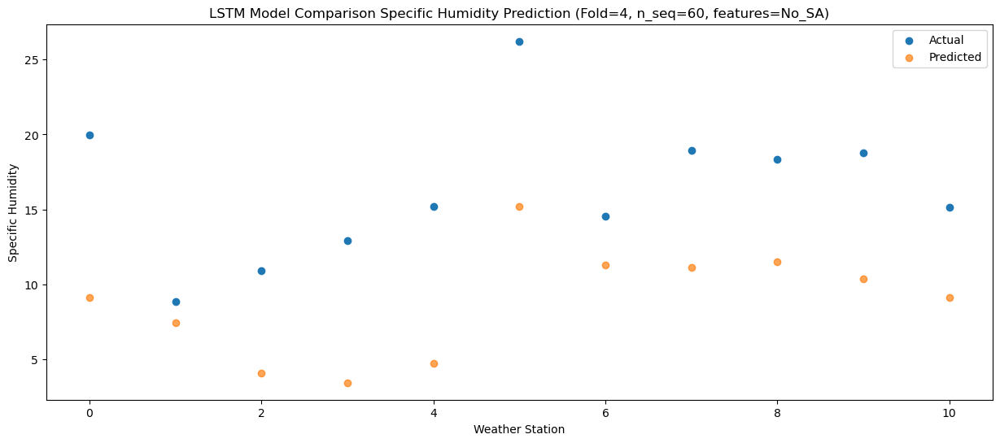

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87   3.642804
1                 1    5.20   1.962804
2                 2    4.77  -1.417195
3                 3    4.80  -2.057198
4                 4    6.36  -0.787197
5                 5   17.70   9.702803
6                 6    9.10   5.812805
7                 7   13.02   5.632801
8                 8   12.18   6.012804
9                 9   12.36   4.882804
10               10    9.87   3.642800


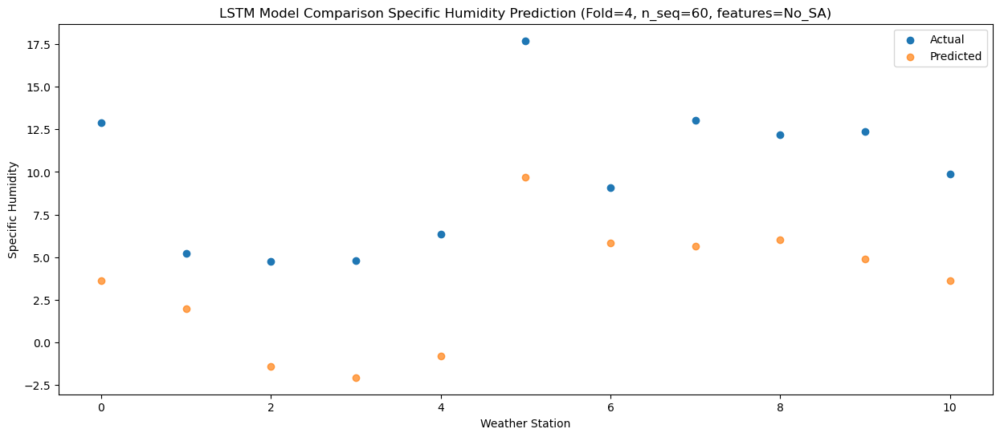

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62  -3.354706
1                 1    1.49  -5.034706
2                 2   -2.19  -8.414705
3                 3   -1.27  -9.054708
4                 4   -0.17  -7.784707
5                 5   10.99   2.705293
6                 6    3.37  -1.184705
7                 7    7.12  -1.364709
8                 8    5.11  -0.984706
9                 9    5.27  -2.114706
10               10    2.48  -3.354710


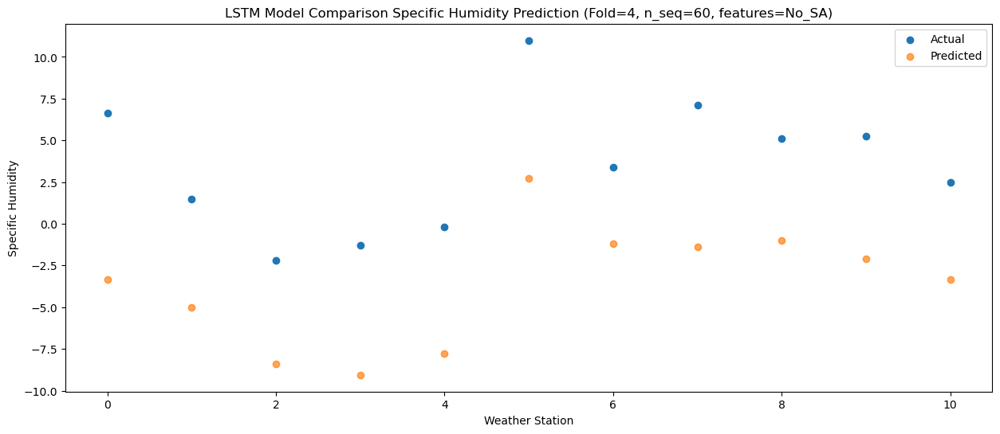

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22  -5.350849
1                 1   -0.63  -7.030849
2                 2   -4.74 -10.410848
3                 3   -4.29 -11.050851
4                 4   -3.30  -9.780850
5                 5    8.19   0.709150
6                 6    1.16  -3.180848
7                 7    4.24  -3.360852
8                 8    3.22  -2.980849
9                 9    3.28  -4.110849
10               10    1.82  -5.350853


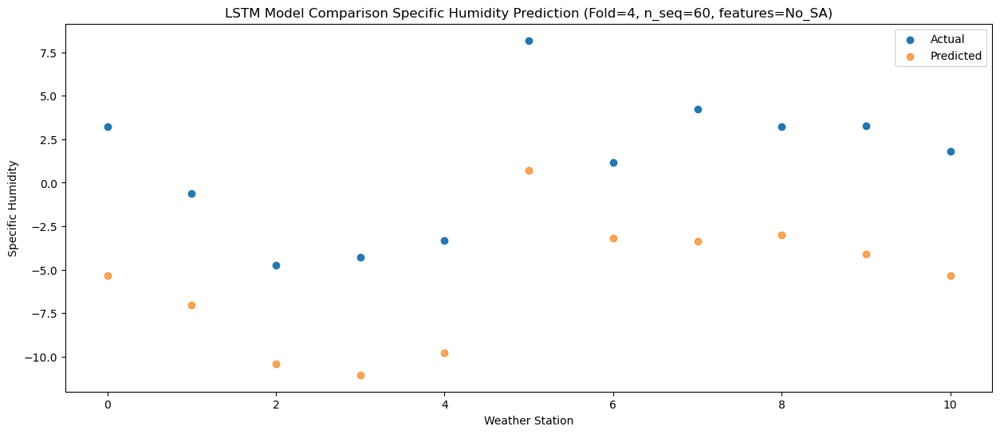

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -9.066696
1                 1   -2.05 -10.746696
2                 2   -8.93 -14.126695
3                 3   -9.81 -14.766698
4                 4   -8.65 -13.496697
5                 5    3.94  -3.006697
6                 6   -1.28  -6.896695
7                 7   -2.92  -7.076699
8                 8   -3.06  -6.696696
9                 9   -4.30  -7.826696
10               10   -3.95  -9.066700


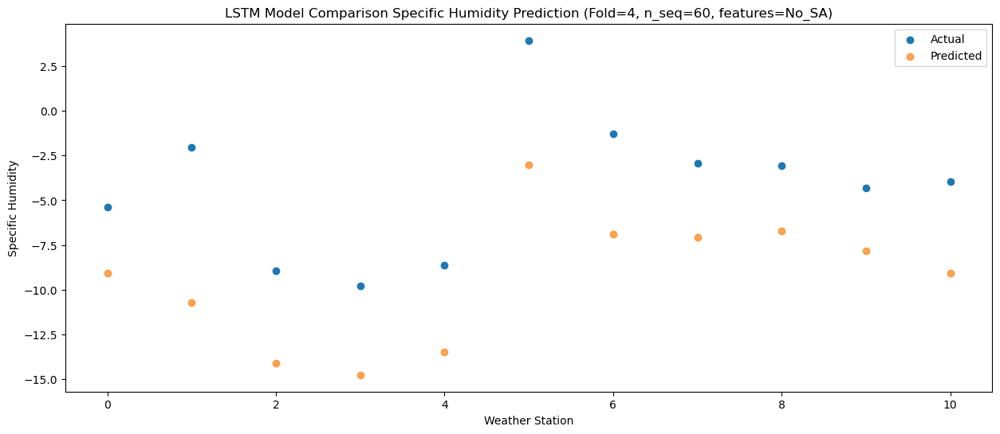

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74  -5.309822
1                 1   -2.32  -6.989822
2                 2   -2.61 -10.369821
3                 3   -1.40 -11.009824
4                 4   -0.33  -9.739823
5                 5   10.76   0.750177
6                 6    2.13  -3.139821
7                 7    6.99  -3.319825
8                 8    3.28  -2.939822
9                 9    3.47  -4.069822
10               10   -0.47  -5.309826


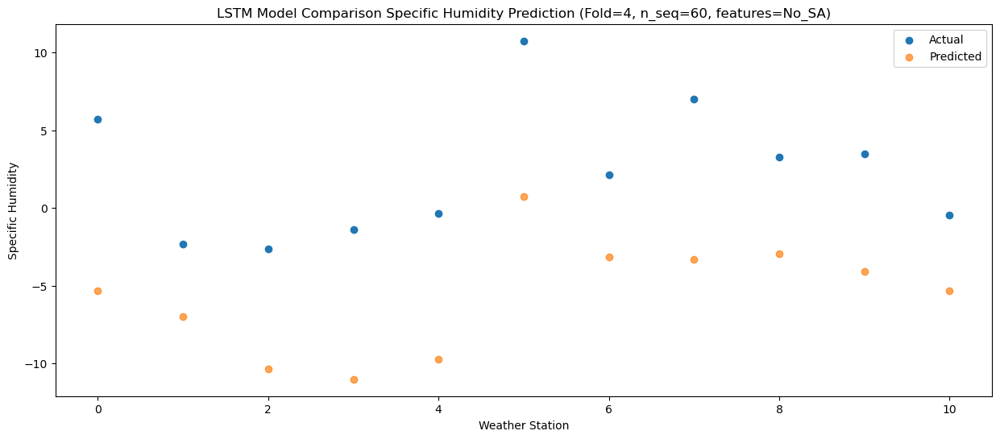

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27  -2.139288
1                 1    2.58  -3.819288
2                 2   -0.38  -7.199287
3                 3    1.01  -7.839290
4                 4    2.24  -6.569289
5                 5   13.36   3.920711
6                 6    5.92   0.030713
7                 7    9.42  -0.149291
8                 8    7.72   0.230712
9                 9    7.62  -0.899288
10               10    2.88  -2.139292


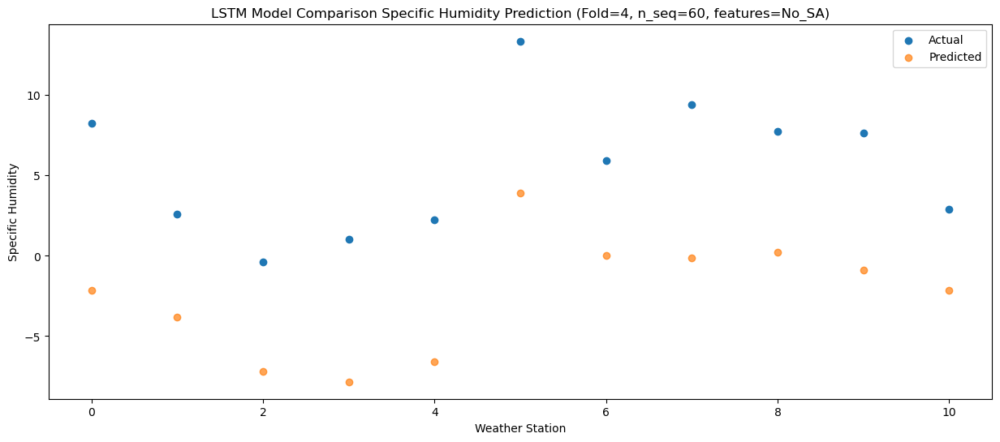

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   1.445837
1                 1    3.63  -0.234162
2                 2    3.44  -3.614161
3                 3    4.86  -4.254164
4                 4    6.29  -2.984164
5                 5   18.32   7.505836
6                 6   10.15   3.615839
7                 7   13.56   3.435835
8                 8   12.30   3.815837
9                 9   12.11   2.685837
10               10    8.60   1.445834


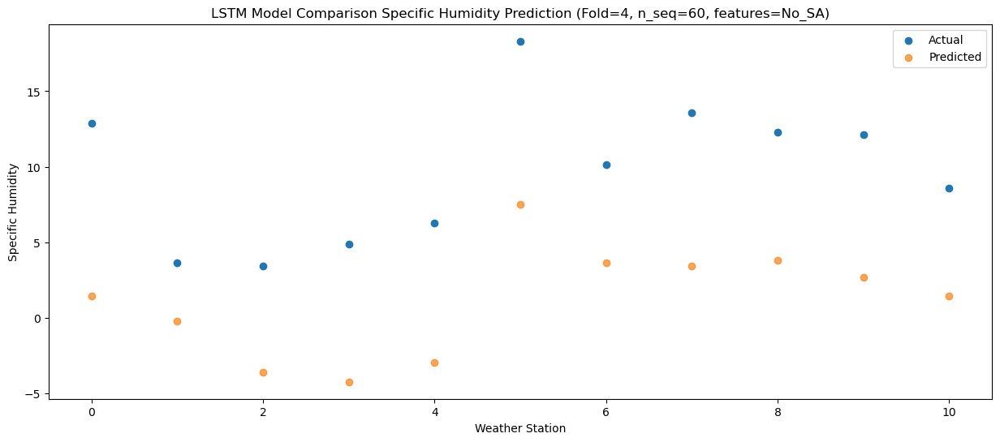

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90   6.236559
1                 1    9.08   4.556559
2                 2    8.96   1.176560
3                 3    9.62   0.536557
4                 4   11.09   1.806558
5                 5   23.61  12.296558
6                 6   14.22   8.406560
7                 7   18.21   8.226556
8                 8   18.90   8.606559
9                 9   19.14   7.476559
10               10   14.70   6.236555


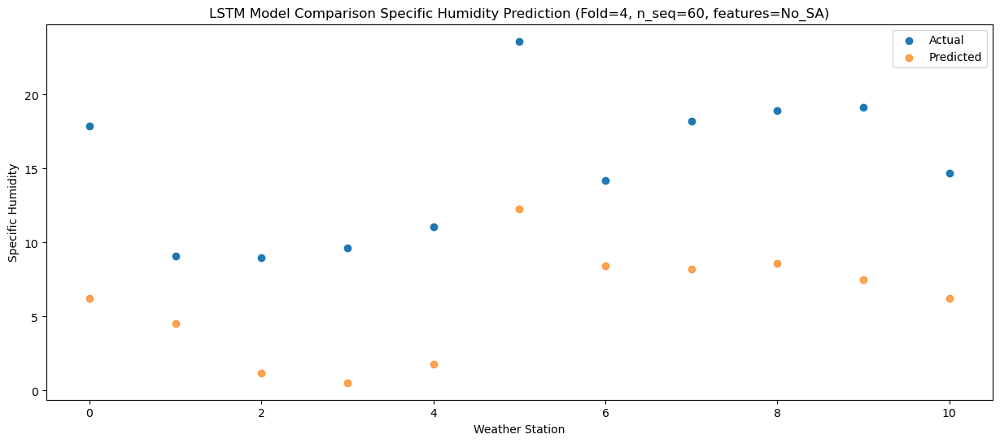

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  10.494590
1                 1    9.73   8.814590
2                 2   11.59   5.434589
3                 3   13.65   4.794586
4                 4   15.54   6.064589
5                 5   27.62  16.554589
6                 6   17.64  12.664591
7                 7   21.93  12.484587
8                 8   22.26  12.864588
9                 9   23.11  11.734588
10               10   17.86  10.494586


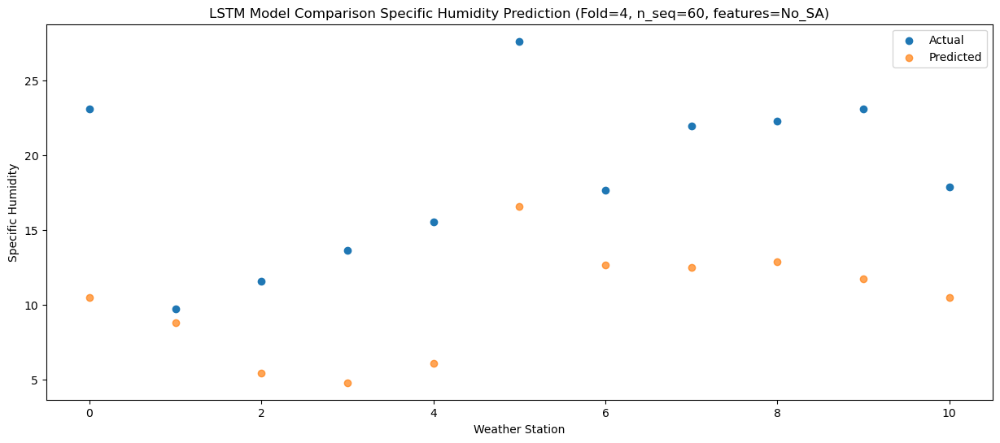

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  11.865734
1                 1   10.42  10.185734
2                 2   12.61   6.805733
3                 3   14.55   6.165730
4                 4   16.25   7.435733
5                 5   26.45  17.925733
6                 6   19.10  14.035735
7                 7   22.23  13.855731
8                 8   22.27  14.235732
9                 9   22.14  13.105732
10               10   19.38  11.865730


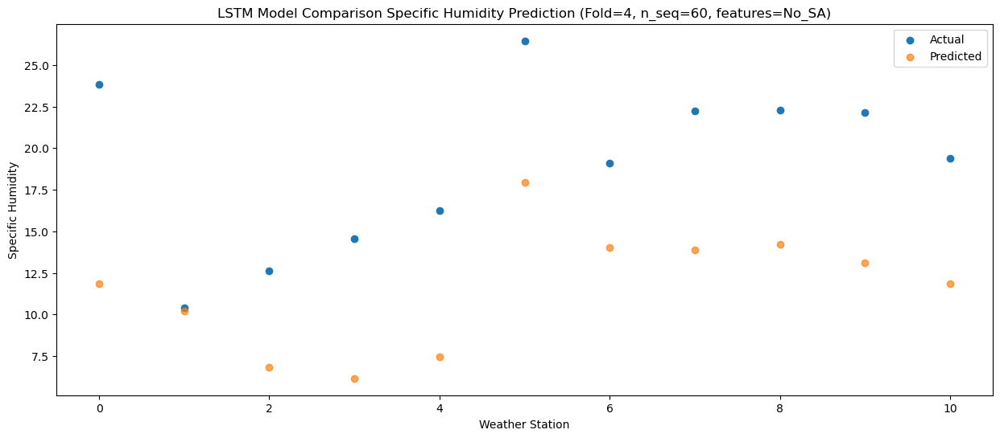

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  10.454918
1                 1   10.12   8.774919
2                 2   13.18   5.394918
3                 3   16.30   4.754914
4                 4   18.21   6.024917
5                 5   28.91  16.514917
6                 6   17.94  12.624920
7                 7   22.67  12.444915
8                 8   22.19  12.824917
9                 9   21.80  11.694916
10               10   18.24  10.454914


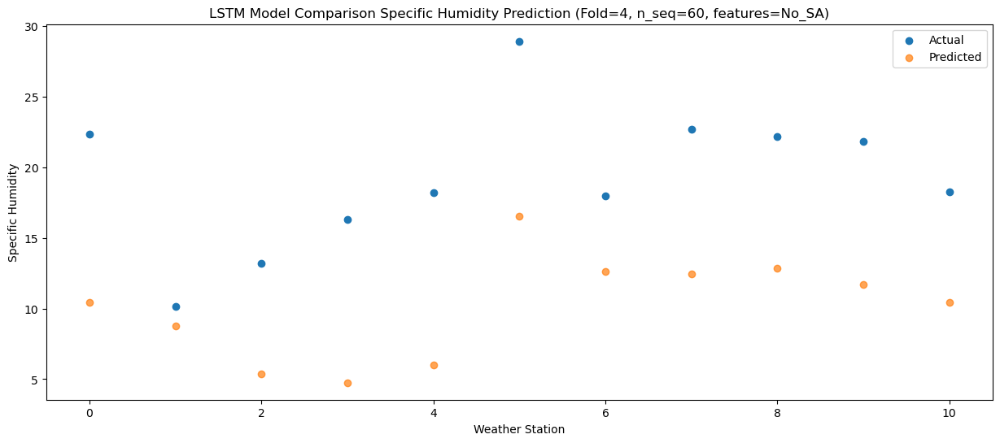

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93   7.350513
1                 1    9.25   5.670514
2                 2    9.57   2.290513
3                 3   10.91   1.650509
4                 4   12.20   2.920512
5                 5   22.46  13.410512
6                 6   15.50   9.520515
7                 7   18.53   9.340510
8                 8   19.58   9.720512
9                 9   18.57   8.590511
10               10   15.97   7.350509


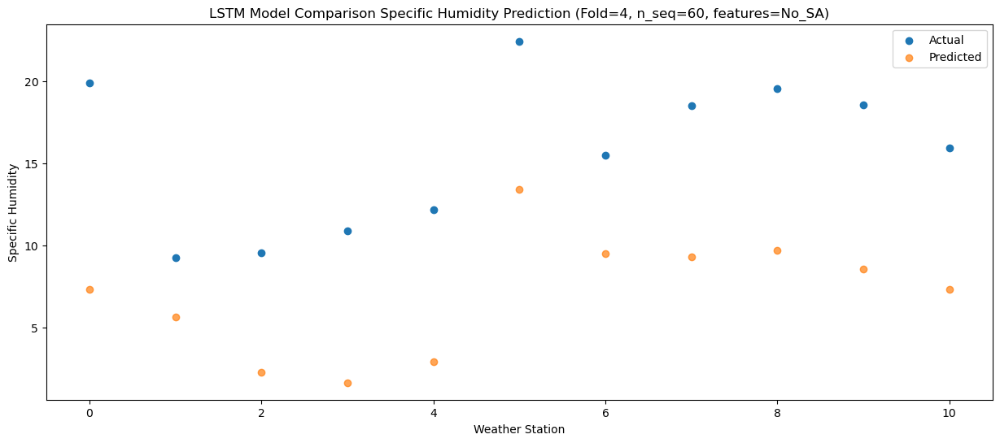

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80   2.085137
1                 1    5.48   0.405138
2                 2    5.43  -2.974863
3                 3    8.16  -3.614867
4                 4    9.78  -2.344864
5                 5   20.75   8.145136
6                 6    9.88   4.255139
7                 7   14.85   4.075134
8                 8   13.65   4.455136
9                 9   13.50   3.325135
10               10    9.50   2.085133


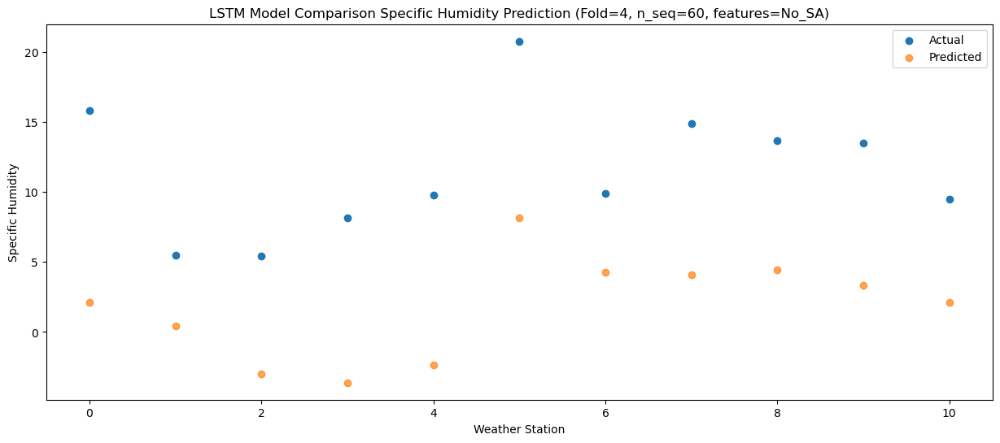

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (1, 1, 512)               4767744   
                                                                 
 dropout_8 (Dropout)         (1, 1, 512)               0         
                                                                 
 lstm_9 (LSTM)               (1, 512)                  2099200   
                                                                 
 dropout_9 (Dropout)         (1, 512)                  0         
                                                                 
 dense_12 (Dense)            (1, 256)                  131328    
                                                                 
 dense_13 (Dense)            (1, 128)                  32896     
                                                                 
 dense_14 (Dense)            (1, 60)                  

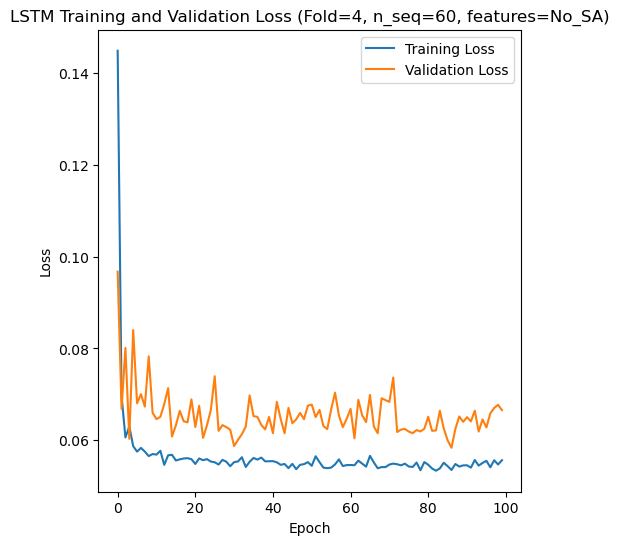

[[1.3077690099563046, 1.363860756400057, 1.6482416816515877, 1.8622208251268417, 2.358285624070668, 1.4681710769216836, 2.5199360485063216, 4.375635452309412, 5.20172245768603, 3.831924605059084, 3.0916021680010646, 1.4784751343877927, 1.4978915467493898, 1.675684456266651, 1.515420039039894, 2.110794825173179, 1.6110656997344277, 2.8314994905709296, 3.631586192408208, 5.7595376840451875, 5.804962946754206, 5.475952299629374, 5.205692734632181, 3.8271953034039576, 3.299996977781881, 2.1847404504945613, 2.170253069829663, 1.5861221956187255, 1.6449088906426423, 2.411132006057755, 3.4445112174663404, 4.111063858931754, 5.6155370125928314, 5.701483185861821, 4.3860467854817395, 3.7528352970762526, 2.436183813284112, 2.378459004661135, 2.1140112582919874, 1.3026934062897417, 2.267272210423603, 3.4495801700380824, 4.792898731489416, 4.803550854256701, 5.850449728504082, 4.357573365737574, 4.832275353873395, 4.547172449413203, 3.4813014806515263, 3.6606922582151458, 2.990759739758563, 3.1453

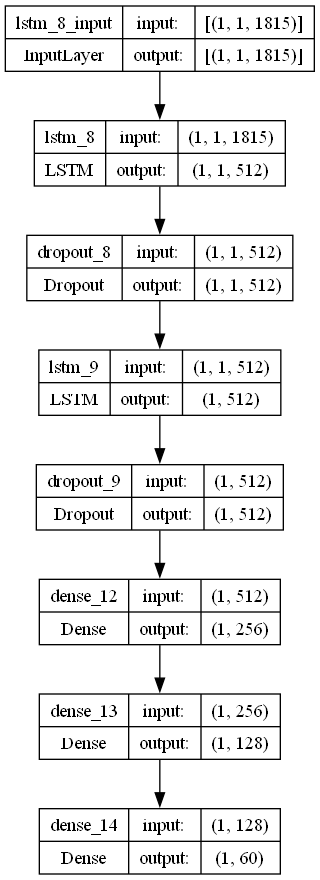

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr =  0.003786634333593054 
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.19620543896566228

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)